In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!cp -r /content/drive/MyDrive/Datathon_2024_Datasets /content/

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import IsolationForest
from sklearn.metrics import mean_absolute_error, mean_squared_error, confusion_matrix, accuracy_score
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from sklearn.model_selection import train_test_split
from dateutil.parser import parse
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from sklearn.linear_model import HuberRegressor

import warnings
warnings.filterwarnings('ignore')

# Data Preprocessing

In [ ]:
sensor_data = pd.read_csv('/content/Datathon_2024_Datasets/solar_sensor_data.csv')
weather_data = pd.read_csv('/content/Datathon_2024_Datasets/weather_sensor_data.csv')

In [ ]:
display(sensor_data)

,LOCATION,DATE_TIME,SENSOR_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD
0,A,15-05-2020 00:00,sensor 1,0.0,0.0,0.0,6259559.0
1,A,15-05-2020 00:00,sensor 2,0.0,0.0,0.0,6183645.0
2,A,15-05-2020 00:00,sensor 3,0.0,0.0,0.0,6987759.0
3,A,15-05-2020 00:00,sensor 5,0.0,0.0,0.0,7602960.0
4,A,15-05-2020 00:00,sensor 12,0.0,0.0,0.0,7158964.0
...,...,...,...,...,...,...,...
136471,B,2020-06-17 23:45:00,sensor 33,0.0,0.0,4157.0,520758.0
136472,B,2020-06-17 23:45:00,sensor 35,0.0,0.0,3931.0,121131356.0
136473,B,2020-06-17 23:45:00,sensor 38,0.0,0.0,4322.0,2427691.0
136474,B,2020-06-17 23:45:00,sensor 40,0.0,0.0,4218.0,106896394.0


In [ ]:
display(weather_data)

,LOCATION,DATE_TIME,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION
0,A,2020-05-15 00:00:00,25.184316,22.857507,0.0
1,A,2020-05-15 00:15:00,25.084589,22.761668,0.0
2,A,2020-05-15 00:30:00,24.935753,22.592306,0.0
3,A,2020-05-15 00:45:00,24.846130,22.360852,0.0
4,A,2020-05-15 01:00:00,24.621525,22.165423,0.0
...,...,...,...,...,...
6436,B,2020-06-17 22:45:00,23.511703,22.856201,0.0
6437,B,2020-06-17 23:00:00,23.482282,22.744190,0.0
6438,B,2020-06-17 23:15:00,23.354743,22.492245,0.0
6439,B,2020-06-17 23:30:00,23.291048,22.373909,0.0


* **By looking at the data we detected that in the sensor_data there are two types of DATE_TIME formats, which are DD-MM-YYYY TIME in Location A and YYYY-MM-DD TIME in Location B. We have to make them into one type to further analysis.**
* **This problem was not there in the weather_data, all of them was in YYYY-MM-DD TIME format.**

In [ ]:
def detect_format(date_str, day_first, year_first):
    try:
        parsed = parse(date_str, dayfirst=day_first, yearfirst=year_first)
        return parsed.strftime('%Y-%m-%d %H:%M:%S')  # Parsed into a standard format
    except Exception:
        print('Invalid format :' + str(date_str))

In [ ]:
location_A_sensor_data = sensor_data[sensor_data['LOCATION'] == 'A']
location_B_sensor_data = sensor_data[sensor_data['LOCATION'] == 'B']
location_A_sensor_data['DATE_TIME'] = location_A_sensor_data['DATE_TIME'].apply(detect_format, args=(True, False))
location_B_sensor_data['DATE_TIME'] = location_B_sensor_data['DATE_TIME'].apply(detect_format, args=(False, True))
sensor_data = pd.concat([location_A_sensor_data, location_B_sensor_data], ignore_index=True)
sensor_data = sensor_data.sort_values(by=['LOCATION', 'DATE_TIME'])
sensor_data['DATE_TIME'] = pd.to_datetime(sensor_data['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

weather_data['DATE_TIME'] = weather_data['DATE_TIME'].apply(detect_format, args=(False, True))
weather_data['DATE_TIME'] = pd.to_datetime(weather_data['DATE_TIME'], format='%Y-%m-%d %H:%M:%S')

**For further analysis and for our own ease we made merged_data by merging weather_data and sensor_data into merged_data dataset based on LOCATION and DATE_TIME.**

In [ ]:
# Merge datasets on LOCATION and DATE_TIME
merged_data = pd.merge(sensor_data, weather_data, how='left', on=['LOCATION', 'DATE_TIME'])
merged_data['DATE'] = merged_data['DATE_TIME'].dt.strftime('%Y-%m-%d')
merged_data['TIME'] = merged_data['DATE_TIME'].dt.strftime('%H:%M:%S')

print(merged_data.dtypes)

LOCATION                       object
DATE_TIME              datetime64[ns]
SENSOR_ID                      object
DC_POWER                      float64
AC_POWER                      float64
DAILY_YIELD                   float64
TOTAL_YIELD                   float64
AMBIENT_TEMPERATURE           float64
MODULE_TEMPERATURE            float64
IRRADIATION                   float64
DATE                           object
TIME                           object
dtype: object


In [ ]:
# sensor_data['DATE_TIME'] = pd.to_datetime(sensor_data['DATE_TIME'], errors='coerce', dayfirst=True)
# weather_data['DATE_TIME'] = pd.to_datetime(weather_data['DATE_TIME'], errors='coerce', dayfirst=True)

# if sensor_data['DATE_TIME'].isnull().any():
#     print("Some date_time entries could not be converted in sensor_data")

# if weather_data['DATE_TIME'].isnull().any():
#     print("Some date_time entries could not be converted in weather data")

In [ ]:
print("Sensor Data\n===============")
print(sensor_data.dtypes)

print("\nWeather Data\n===============")
print(weather_data.dtypes)

Sensor Data
LOCATION               object
DATE_TIME      datetime64[ns]
SENSOR_ID              object
DC_POWER              float64
AC_POWER              float64
DAILY_YIELD           float64
TOTAL_YIELD           float64
dtype: object

Weather Data
LOCATION                       object
DATE_TIME              datetime64[ns]
AMBIENT_TEMPERATURE           float64
MODULE_TEMPERATURE            float64
IRRADIATION                   float64
dtype: object


In [ ]:
print("Sensor Data\n===============")
print(sensor_data.isnull().sum())

print("\nWeather Data\n===============")
print(weather_data.isnull().sum())

Sensor Data
LOCATION       0
DATE_TIME      0
SENSOR_ID      0
DC_POWER       0
AC_POWER       0
DAILY_YIELD    0
TOTAL_YIELD    0
dtype: int64

Weather Data
LOCATION               0
DATE_TIME              0
AMBIENT_TEMPERATURE    0
MODULE_TEMPERATURE     0
IRRADIATION            0
dtype: int64


**Here as a preprocessing step we try to find duplicates in the datasets.**

In [ ]:
duplicates_sensor_data = sensor_data[sensor_data.duplicated()]

print("Duplicate Rows of Sensor Data:")
print(duplicates_sensor_data)

Duplicate Rows of Sensor Data:
Empty DataFrame
Columns: [LOCATION, DATE_TIME, SENSOR_ID, DC_POWER, AC_POWER, DAILY_YIELD, TOTAL_YIELD]
Index: []


In [ ]:
duplicates_weather_data = weather_data[weather_data.duplicated()]

print("Duplicate Rows of Weather Data:")
print(duplicates_weather_data)

Duplicate Rows of Weather Data:
Empty DataFrame
Columns: [LOCATION, DATE_TIME, AMBIENT_TEMPERATURE, MODULE_TEMPERATURE, IRRADIATION]
Index: []


In [ ]:
display(merged_data)

,LOCATION,DATE_TIME,SENSOR_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME
0,A,2020-05-15 00:00:00,sensor 1,0.0,0.0,0.0,6259559.0,25.184316,22.857507,0.0,2020-05-15,00:00:00
1,A,2020-05-15 00:00:00,sensor 2,0.0,0.0,0.0,6183645.0,25.184316,22.857507,0.0,2020-05-15,00:00:00
2,A,2020-05-15 00:00:00,sensor 3,0.0,0.0,0.0,6987759.0,25.184316,22.857507,0.0,2020-05-15,00:00:00
3,A,2020-05-15 00:00:00,sensor 5,0.0,0.0,0.0,7602960.0,25.184316,22.857507,0.0,2020-05-15,00:00:00
4,A,2020-05-15 00:00:00,sensor 12,0.0,0.0,0.0,7158964.0,25.184316,22.857507,0.0,2020-05-15,00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...
136471,B,2020-06-17 23:45:00,sensor 33,0.0,0.0,4157.0,520758.0,23.202871,22.535908,0.0,2020-06-17,23:45:00
136472,B,2020-06-17 23:45:00,sensor 35,0.0,0.0,3931.0,121131356.0,23.202871,22.535908,0.0,2020-06-17,23:45:00
136473,B,2020-06-17 23:45:00,sensor 38,0.0,0.0,4322.0,2427691.0,23.202871,22.535908,0.0,2020-06-17,23:45:00
136474,B,2020-06-17 23:45:00,sensor 40,0.0,0.0,4218.0,106896394.0,23.202871,22.535908,0.0,2020-06-17,23:45:00


# Exploratory data analysis

## Correation between features of weather data

### Correlation matrices

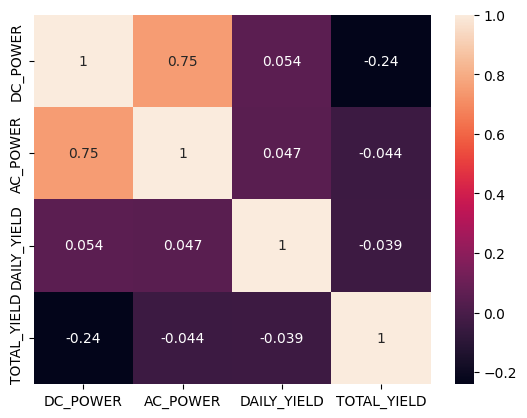

In [ ]:
senosr_data_for_corr = sensor_data.drop('LOCATION', axis=1)
senosr_data_for_corr = senosr_data_for_corr.drop('DATE_TIME', axis=1)
senosr_data_for_corr = senosr_data_for_corr.drop('SENSOR_ID', axis=1)

matrix = senosr_data_for_corr.corr()
sns.heatmap(matrix, annot=True)
plt.show()

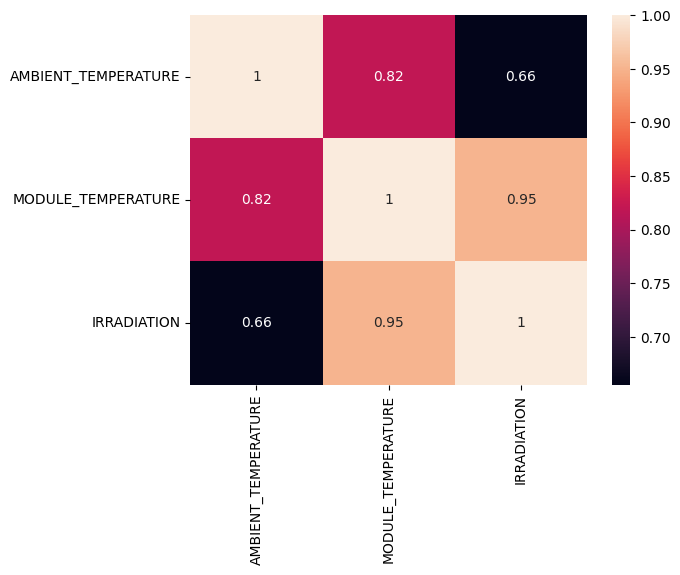

In [ ]:
weather_data_for_corr = weather_data.drop('LOCATION', axis=1)
weather_data_for_corr = weather_data_for_corr.drop('DATE_TIME', axis=1)

matrix = weather_data_for_corr.corr()
sns.heatmap(matrix, annot=True)
plt.show()

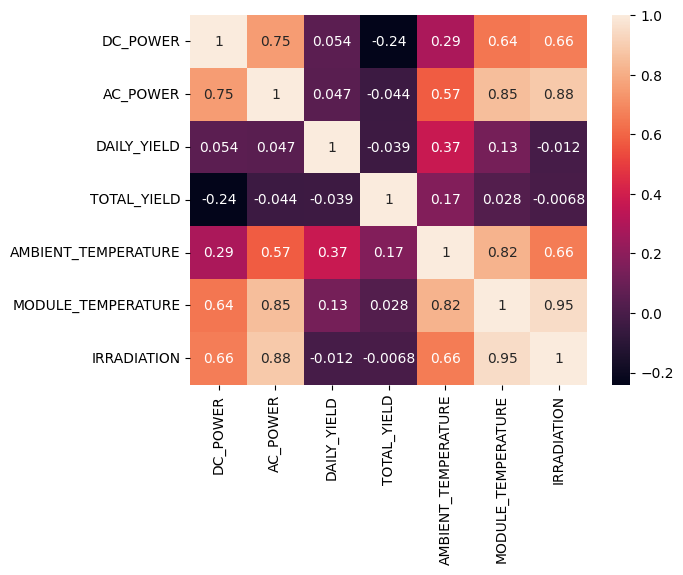

In [ ]:
merged_data_for_corr = merged_data.drop('LOCATION', axis=1)
merged_data_for_corr = merged_data_for_corr.drop('DATE_TIME', axis=1)
merged_data_for_corr = merged_data_for_corr.drop('SENSOR_ID', axis=1)
merged_data_for_corr = merged_data_for_corr.drop('DATE', axis=1)
merged_data_for_corr = merged_data_for_corr.drop('TIME', axis=1)

matrix = merged_data_for_corr.corr()
sns.heatmap(matrix, annot=True)
plt.show()

### Scatter plots

In [ ]:
location_A_weather_data = weather_data[weather_data['LOCATION'] == 'A']
location_B_weather_data = weather_data[weather_data['LOCATION'] == 'B']

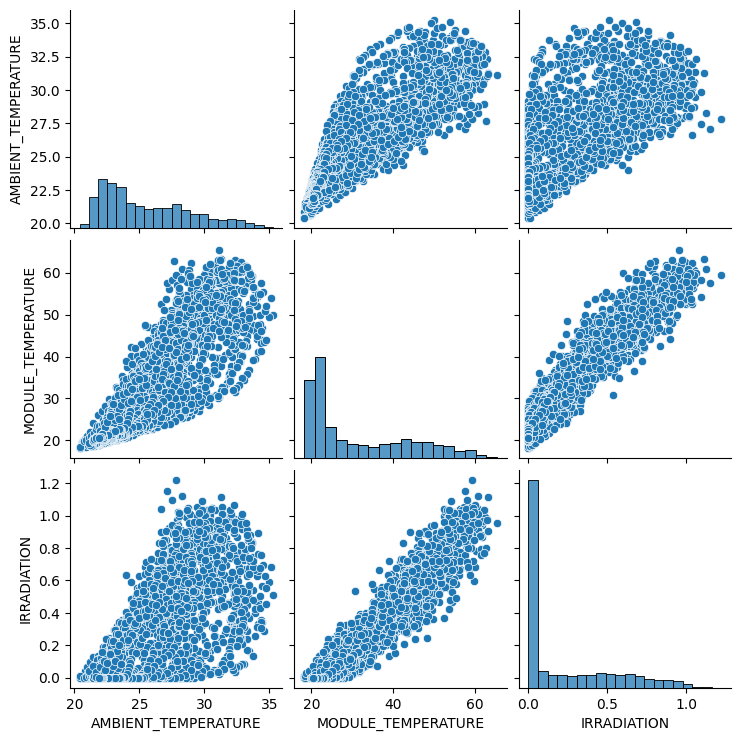

In [ ]:
sns.pairplot(location_A_weather_data)

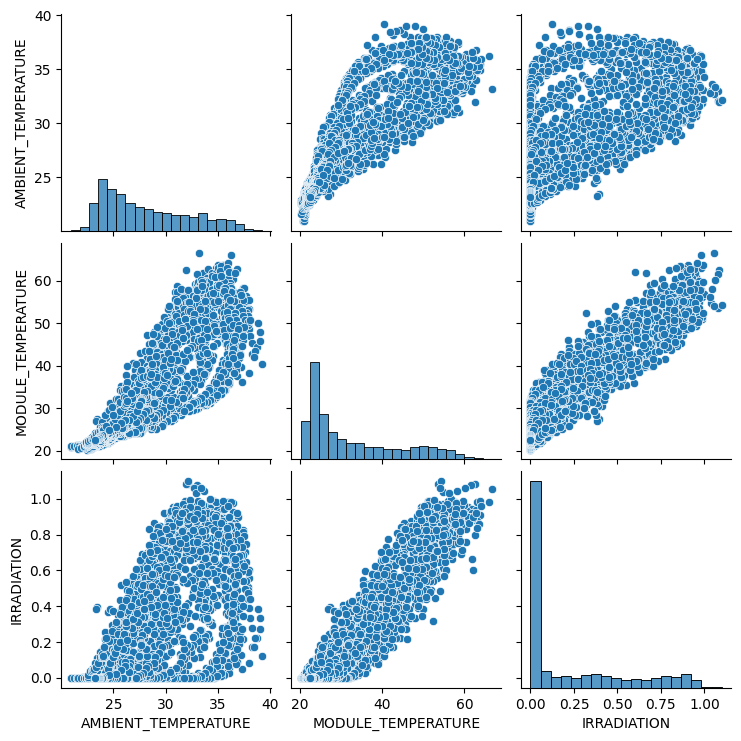

In [ ]:
sns.pairplot(location_B_weather_data)

## Check if the two locations have 22 sensors each

In [ ]:
print(merged_data[merged_data['LOCATION'] == 'A']['SENSOR_ID'].unique())
len(merged_data[merged_data['LOCATION'] == 'A']['SENSOR_ID'].unique())

['sensor 1' 'sensor 2' 'sensor 3' 'sensor 5' 'sensor 12' 'sensor 19'
 'sensor 20' 'sensor 23' 'sensor 24' 'sensor 25' 'sensor 26' 'sensor 27'
 'sensor 28' 'sensor 32' 'sensor 34' 'sensor 36' 'sensor 37' 'sensor 39'
 'sensor 42' 'sensor 43' 'sensor 44' 'sensor 22']


22

In [ ]:
print(merged_data[merged_data['LOCATION'] == 'B']['SENSOR_ID'].unique())
len(merged_data[merged_data['LOCATION'] == 'B']['SENSOR_ID'].unique())

['sensor 4' 'sensor 6' 'sensor 7' 'sensor 8' 'sensor 9' 'sensor 10'
 'sensor 11' 'sensor 13' 'sensor 14' 'sensor 15' 'sensor 16' 'sensor 17'
 'sensor 18' 'sensor 21' 'sensor 29' 'sensor 30' 'sensor 31' 'sensor 33'
 'sensor 35' 'sensor 38' 'sensor 40' 'sensor 41']


22

## Correlation between DC_POWER and IRRADIATION

<Axes: xlabel='IRRADIATION', ylabel='DC_POWER'>

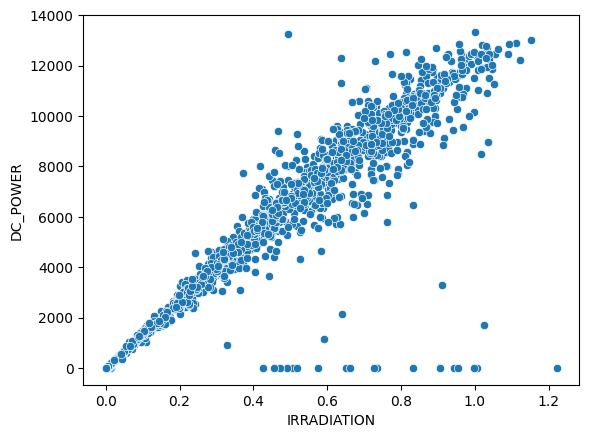

In [ ]:
sns.scatterplot(x="IRRADIATION", y="DC_POWER",data=merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')])

**We can see that there is a strong linear relationship between IRRADIATION and the DC_POWER. Therefore, DC_POWER is a linear function of IRRIDIATION.**

## Correlation between AC_POWER and IRRADIATION

<Axes: xlabel='IRRADIATION', ylabel='AC_POWER'>

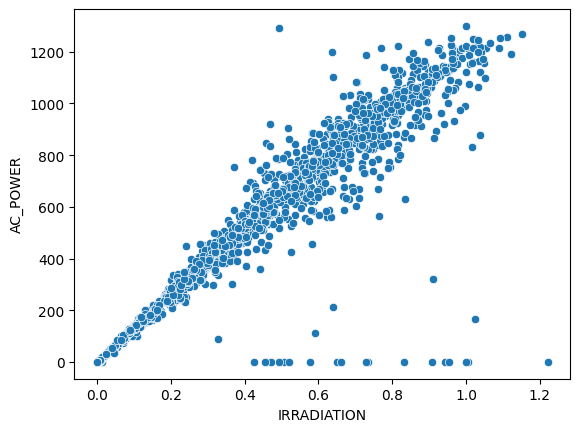

In [ ]:
sns.scatterplot(x="IRRADIATION", y="AC_POWER",data=merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')])

**We can see that AC_POWER also exhibit a strong linear relationship with IRRIDIATION, and this relationship is almost identical to the relationship between DC_POWER and IRRADIATION. Therefor we can assume that AC_POWER and DC_POWER has a very strong correlation.**

## Correlation Between DC_POWER and AC_POWER

<Axes: xlabel='DC_POWER', ylabel='AC_POWER'>

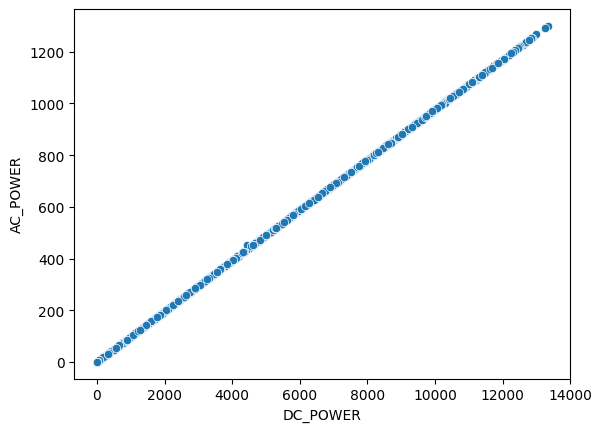

In [ ]:
sns.scatterplot(x="DC_POWER", y="AC_POWER",data=merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')])

**There is a very stong correlation between AC_POWER and DC_POWER**

## Correlation between AMBIENT_TEMPERATURE and DC_POWER

<Axes: xlabel='AMBIENT_TEMPERATURE', ylabel='DC_POWER'>

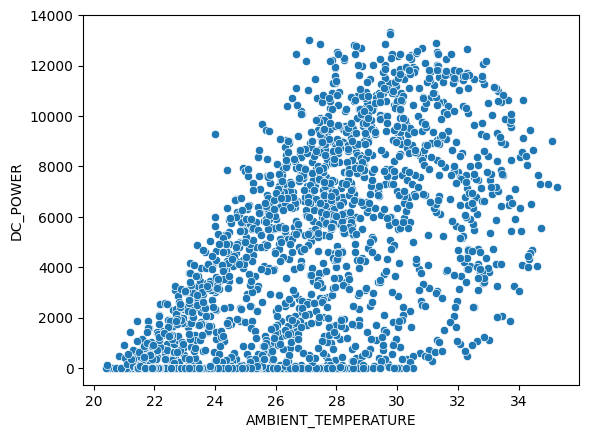

In [ ]:
sns.scatterplot(x="AMBIENT_TEMPERATURE", y="DC_POWER",data=merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')])

**There is no linear correlation between AMBIENT_TEMPERATURE and DC_POWER. But we can deduce that there is a clear upper limit of DC_POWER produced for a specific value of AMBIENT_TEMPERATURE.**

## Correlation between MODULE_TEMPERATURE and DC_POWER



<Axes: xlabel='MODULE_TEMPERATURE', ylabel='DC_POWER'>

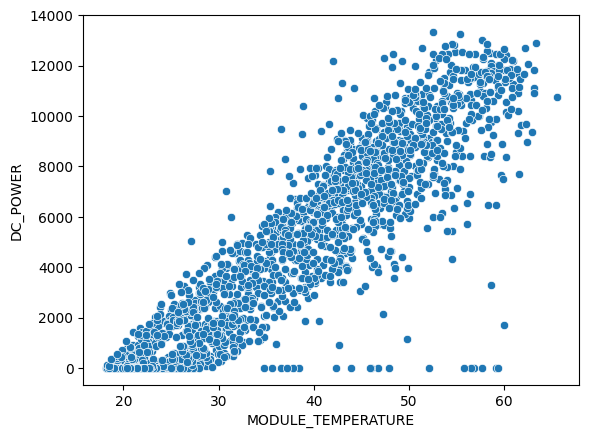

In [ ]:
sns.scatterplot(x="MODULE_TEMPERATURE", y="DC_POWER",data=merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')])

**We can see that there is a parallel region where there is a lower and an upper bound for DC_POWER for a specific value of MODULE_TEMPERATURE**

## Correlation between YIELD and AC_POWER

**First to get the yield for 15 min intervals, we shift the DAILY_YIELD up by one cell and get the difference with the value in above cell. We name it YIELD**

,LOCATION,DATE_TIME,SENSOR_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,DATE,TIME,YIELD
0,A,2020-05-15 00:00:00,sensor 1,0.0,0.0,0.0,6259559.0,25.184316,22.857507,0.0,2020-05-15,00:00:00,NaN
21,A,2020-05-15 00:15:00,sensor 1,0.0,0.0,0.0,6259559.0,25.084589,22.761668,0.0,2020-05-15,00:15:00,0.0
42,A,2020-05-15 00:30:00,sensor 1,0.0,0.0,0.0,6259559.0,24.935753,22.592306,0.0,2020-05-15,00:30:00,0.0
63,A,2020-05-15 00:45:00,sensor 1,0.0,0.0,0.0,6259559.0,24.846130,22.360852,0.0,2020-05-15,00:45:00,0.0
84,A,2020-05-15 01:00:00,sensor 1,0.0,0.0,0.0,6259559.0,24.621525,22.165423,0.0,2020-05-15,01:00:00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1822,A,2020-05-15 21:45:00,sensor 1,0.0,0.0,5754.0,6265313.0,22.236828,20.914417,0.0,2020-05-15,21:45:00,0.0
1844,A,2020-05-15 22:00:00,sensor 1,0.0,0.0,5754.0,6265313.0,22.221858,20.895704,0.0,2020-05-15,22:00:00,0.0
1866,A,2020-05-15 22:15:00,sensor 1,0.0,0.0,5754.0,6265313.0,22.149313,20.732186,0.0,2020-05-15,22:15:00,0.0
1888,A,2020-05-15 22:30:00,sensor 1,0.0,0.0,5754.0,6265313.0,22.104714,20.829852,0.0,2020-05-15,22:30:00,0.0


<Axes: xlabel='AC_POWER', ylabel='YIELD'>

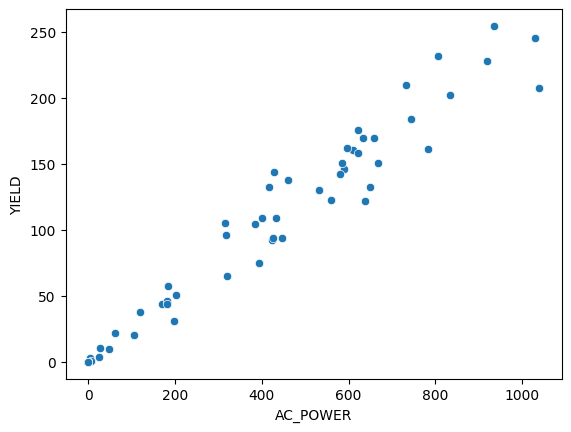

In [ ]:
x = merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1') & (merged_data['DATE'] == '2020-05-15')]
# x = merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')]
x['DAILY_YIELD'] = x['DAILY_YIELD'].shift(-1).fillna(0)
x['YIELD'] = x['DAILY_YIELD'].diff()
x = x.iloc[:-1]
display(x)
sns.scatterplot(x="AC_POWER", y="YIELD",data=x)

**We can see that there is a strong linear relationship between AC_POWER and YIELD. This is because the YIELD is the acculamted AC_POWER for 15 mins intervals.**

## Daily_YIELD as a time series

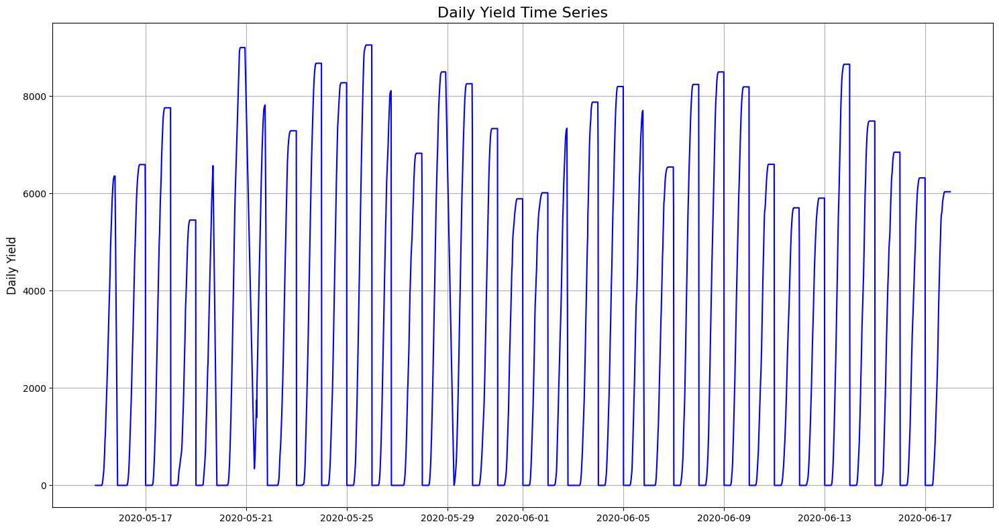

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Set datetime as index (optional but useful for time series data)
x = merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 2')].set_index('DATE_TIME')

# Plot the time series
plt.figure(figsize=(15, 8))
plt.plot(x.index, x['DAILY_YIELD'], linestyle='-', color='b')
plt.title('Daily Yield Time Series', fontsize=16)
#plt.xlabel('Datetime', fontsize=12)
plt.ylabel('Daily Yield', fontsize=12)
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Models

## Regression for Outlier Detection

<ipython-input-8-faa6070d34fb>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['Residuals'] = y - y_pred
<ipython-input-8-faa6070d34fb>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  merged_data['Anomaly'] = (np.abs(merged_data['Residuals']) > threshold).astype(int)


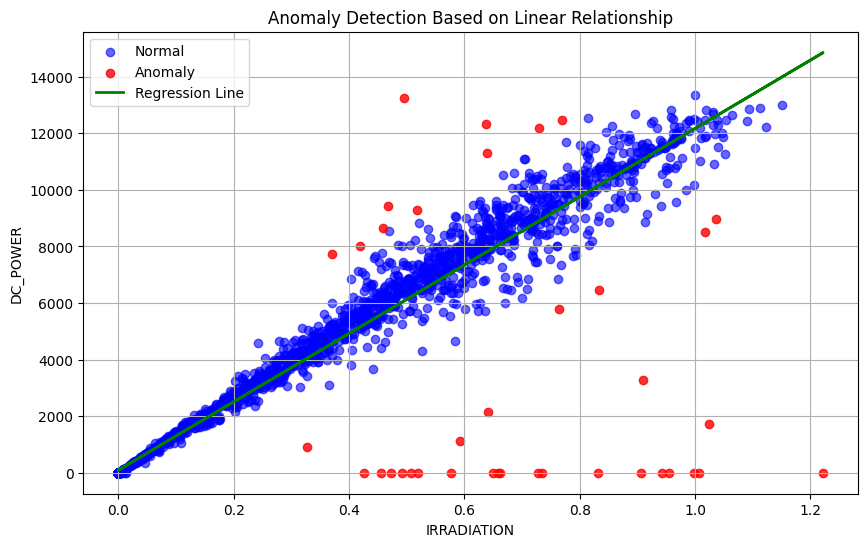

Number of anomalies detected: 38
       IRRADIATION      DC_POWER     Residuals
1014      0.467987   9420.285714   3675.867976
12368     0.458561   8653.857143   3023.290062
14044     0.638545  11312.285710   3507.845382
17942     0.418877   8002.714286   2851.451010
18360     0.833393   6450.428571  -3707.409475
24428     1.036561   8985.750000  -3625.980990
31908     0.729715  12185.857140   3280.254797
31996     0.636582  12313.285710   4532.551978
32018     0.769238  12462.625000   3079.659566
32040     0.518191   9282.428571   2931.634659
34080     1.016641   8495.428571  -3875.713684
34102     0.494515  13262.625000   7197.799205
34146     0.371275   7732.500000   3156.184289
46668     1.024229   1715.000000 -10747.787323
46690     1.006504      0.000000 -12248.700242
46712     0.998540      0.000000 -12152.508021
46734     0.943433      0.000000 -11486.915748
46756     0.954715      0.000000 -11623.184079
46778     0.832460      0.000000 -10146.570900
46800     0.591769   1134.7

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

merged_data = merged_data[(merged_data['LOCATION'] == 'A') & (merged_data['SENSOR_ID'] == 'sensor 1')]


# Select the features
X = merged_data[['IRRADIATION']]  # Independent variable
y = merged_data['DC_POWER']      # Dependent variable

# Fit a linear regression model
model = LinearRegression()
model.fit(X, y)

# Predict DC_POWER
y_pred = model.predict(X)

# Calculate residuals
merged_data['Residuals'] = y - y_pred


std_residuals = np.std(merged_data['Residuals'])
threshold = 3 * std_residuals

# Flag anomalies
merged_data['Anomaly'] = (np.abs(merged_data['Residuals']) > threshold).astype(int)

# Separate normal and anomalous points
normal = merged_data[merged_data['Anomaly'] == 0]
anomalous = merged_data[merged_data['Anomaly'] == 1]

# Plot the results
plt.figure(figsize=(10, 6))
plt.scatter(normal['IRRADIATION'], normal['DC_POWER'], color='blue', label='Normal', alpha=0.6)
plt.scatter(anomalous['IRRADIATION'], anomalous['DC_POWER'], color='red', label='Anomaly', alpha=0.8)

# Plot the regression line
plt.plot(X, y_pred, color='green', linewidth=2, label='Regression Line')

# Add labels and legend
plt.title('Anomaly Detection Based on Linear Relationship')
plt.xlabel('IRRADIATION')
plt.ylabel('DC_POWER')
plt.legend()
plt.grid(True)
plt.show()

# Output anomalies
print(f"Number of anomalies detected: {len(anomalous)}")
print(anomalous[['IRRADIATION', 'DC_POWER', 'Residuals']])

**Since IRRADIATION vs. DC_POWER, AC_POWER vs. YIELD, and DC_POWER vs. AC_POWER are all linear relationships we can use linear regression, huber regression to detect the oultiers unsupervised.**

**This make the models light weight and in correspondence to the real world relationships.**

**If we assume that yield is a function of time, that is representing the real world relationships wrongly. yeild is a function of ac power and ac power is a function of dc power and dc power is a function of irradiation and the module temperature.**

**In the following regression models, we first remove clear ouliers from the data using IQR, then remove outlier such that have a considerable dc_power output when irradiation is 0 and such.**

**Then we try to fit the best linear line using Linear Regression or Huber Regression.**

**Then we concatnate the removed outliers with the data used to get the best fit line and predict values. Then the residuals are calculated and if absolute value of residual is greater than a specified multiple of standard deviation of the residuals, we mark those points as outliers.**

## IRRADIATION vs. DC_POWER Model

In [ ]:
# from sklearn.linear_model import HuberRegressor
# from sklearn.model_selection import GridSearchCV

# irridiation_vs_dc_pwer_model_dict = {}

# # Parameter grid for tuning
# param_grid = {
#     'epsilon': [1.2, 1.35, 1.5, 2.0],
#     'alpha': [0.0001, 0.001, 0.01, 0.1],
#     'max_iter': [50, 100, 200]
# }

# # Function to calculate IQR and detect anomalies
# def detect_anomalies_iqr(x):
#     # Calculate IQR for DC_POWER
#     Q1 = x['DC_POWER'].quantile(0.25)
#     Q3 = x['DC_POWER'].quantile(0.75)
#     IQR = Q3 - Q1
#     lower_bound = Q1 - 1.5 * IQR
#     upper_bound = Q3 + 1.5 * IQR

#     # Detect outliers based on IQR
#     outliers = x[(x['DC_POWER'] < lower_bound) | (x['DC_POWER'] > upper_bound)]

#     # Return cleaned data and outliers
#     x_cleaned = x[(x['DC_POWER'] >= lower_bound) & (x['DC_POWER'] <= upper_bound)]
#     return x_cleaned, outliers

# for location in ['A', 'B']:
#   Location_SENSORS = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
#   irridiation_vs_dc_pwer_model_dict[location] = {}
#   for sensor in Location_SENSORS:
#       x = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor)]
#       # x.dropna(inplace=True)

#       # Step 1: Train model with all data (including DC_POWER = 0)
#       X_full = x[['IRRADIATION']].values
#       y_full = x['DC_POWER'].values

#       # Perform grid search for optimal hyperparameters
#       huber = HuberRegressor()
#       grid_search = GridSearchCV(estimator=huber, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
#       grid_search.fit(X_full, y_full)
#       best_params = grid_search.best_params_

#       # Train the Huber regression model with the best parameters
#       tuned_huber = HuberRegressor(epsilon=best_params['epsilon'],
#                                   alpha=best_params['alpha'],
#                                   max_iter=best_params['max_iter'])
#       tuned_huber.fit(X_full, y_full)

#       # Step 2: Use IQR-based outlier detection (without DC_POWER = 0 points)
#       x_cleaned, outliers = detect_anomalies_iqr(x)

#       # Step 3: Remove both DC_POWER = 0 points and IQR-based outliers
#       x_without_zeros_and_outliers = x_cleaned[x_cleaned['DC_POWER'] != 0]

#       # Train the model again on the cleaned data (no DC_POWER = 0 and no IQR outliers)
#       X_cleaned = x_without_zeros_and_outliers[['IRRADIATION']].values
#       y_cleaned = x_without_zeros_and_outliers['DC_POWER'].values
#       tuned_huber.fit(X_cleaned, y_cleaned)

#       # Step 4: Add back the removed `DC_POWER = 0` and IQR-based outliers
#       x_restored = pd.concat([x_cleaned, outliers])

#       # Step 5: Predict and detect anomalies (using residuals)
#       y_pred_full = tuned_huber.predict(x_restored[['IRRADIATION']].values)
#       y_pred_cleaned = tuned_huber.predict(X_cleaned)
#       residuals_full = y_cleaned - y_pred_cleaned
#       residuals = x_restored['DC_POWER'] - y_pred_full
#       std_residuals_full = np.std(residuals_full)
#       threshold_full = 2 * std_residuals_full
#       anomalies_full = np.abs(residuals) > threshold_full
#       x_restored['Residuals'] = residuals
#       x_restored['Anomaly'] = anomalies_full.astype(int)

#       # Plotting: Comparison of anomalies detected
#       plt.figure(figsize=(14, 7))
#       plt.scatter(x_restored['IRRADIATION'], x_restored['DC_POWER'], c=x_restored['Anomaly'], cmap='coolwarm', label='Anomalies', alpha=0.6)
#       plt.title(f'Sensor {sensor} - Anomaly Detection After Model with DC_POWER = 0 and IQR-based Outliers')
#       plt.xlabel('IRRADIATION')
#       plt.ylabel('DC_POWER')
#       plt.colorbar(label='Anomaly')
#       plt.show()

#       # Output anomalies detected
#       print(f"Sensor {sensor} - Anomalies detected: {x_restored['Anomaly'].sum()}")
#       print(x_restored[x_restored['Anomaly'] == 1][['IRRADIATION', 'DC_POWER', 'Residuals']])

#       irridiation_vs_dc_pwer_model_dict[location][sensor] = {
#              'intercept': tuned_huber.intercept_,
#              'slope': tuned_huber.coef_,
#              'std_residuals': std_residuals_full
#          }

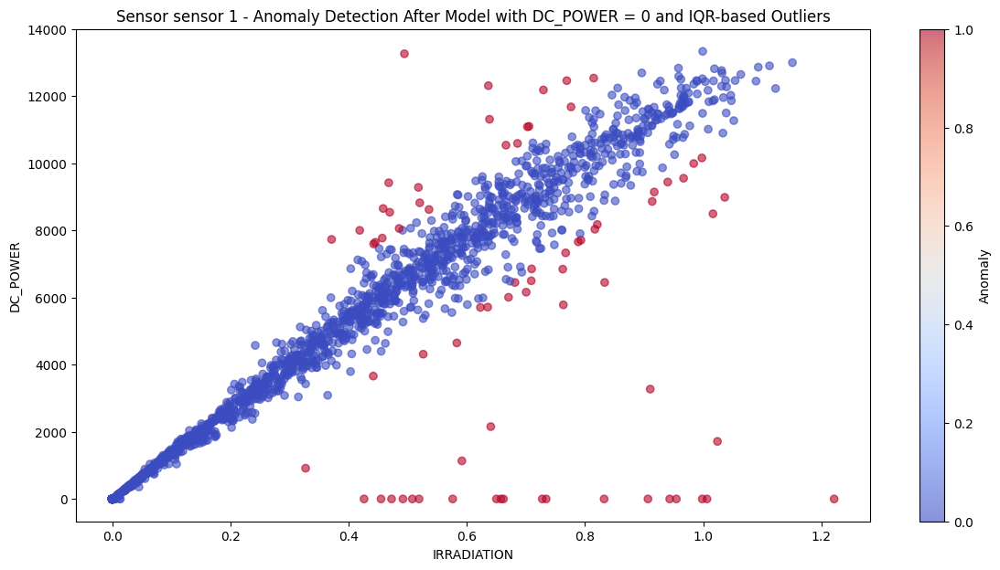

Sensor sensor 1 - Anomalies detected: 73
       IRRADIATION      DC_POWER     Residuals
772       0.623153   5706.714286  -2042.714311
860       0.670675   6008.375000  -2300.427442
1014      0.467987   9420.285714   3497.260833
4812      0.685882  10591.750000   2103.960187
4878      0.997904  10160.142860  -2000.352398
...            ...           ...           ...
61562     0.727764      0.000000  -8980.767574
61584     0.906615      0.000000 -11085.966543
61606     1.221652      0.000000 -14794.159493
61628     0.910489   3272.875000  -7858.695311
63454     0.702748  11087.375000   2401.056141

[73 rows x 3 columns]


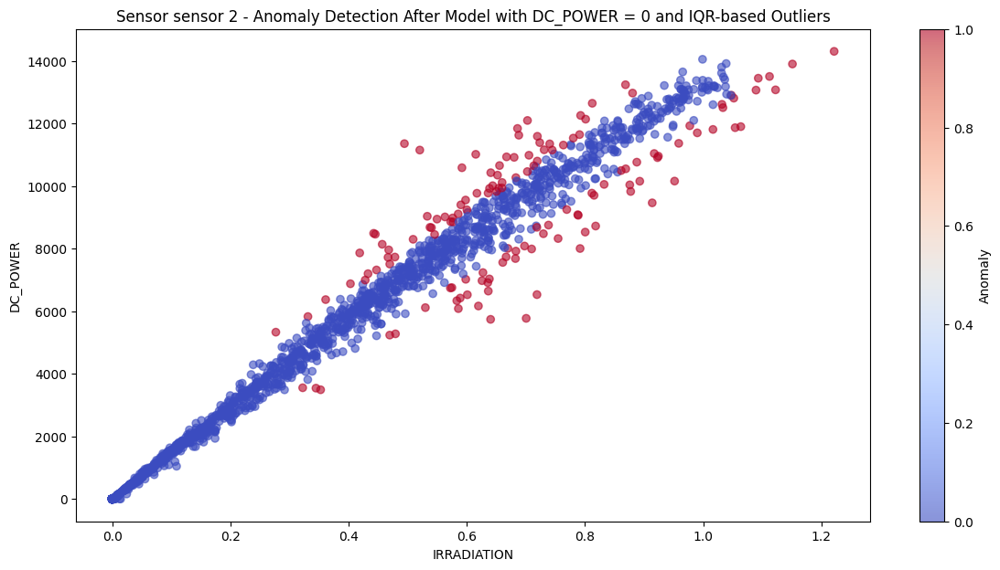

Sensor sensor 2 - Anomalies detected: 136
       IRRADIATION      DC_POWER    Residuals
795       0.344884   3541.000000 -1332.878927
883       0.572283   6741.250000 -1052.915943
971       0.585787   6082.375000 -1885.207322
1015      0.467987   7959.000000  1504.221818
1059      0.787866   9083.250000 -1479.449256
...            ...           ...          ...
63279     0.572937   8859.857143  1057.295958
63411     0.680174  10915.857140  1736.146931
63455     0.702748  12094.500000  2624.894789
63763     0.652057  10347.500000  1528.876395
67855     0.659398   9940.125000  1027.220548

[136 rows x 3 columns]


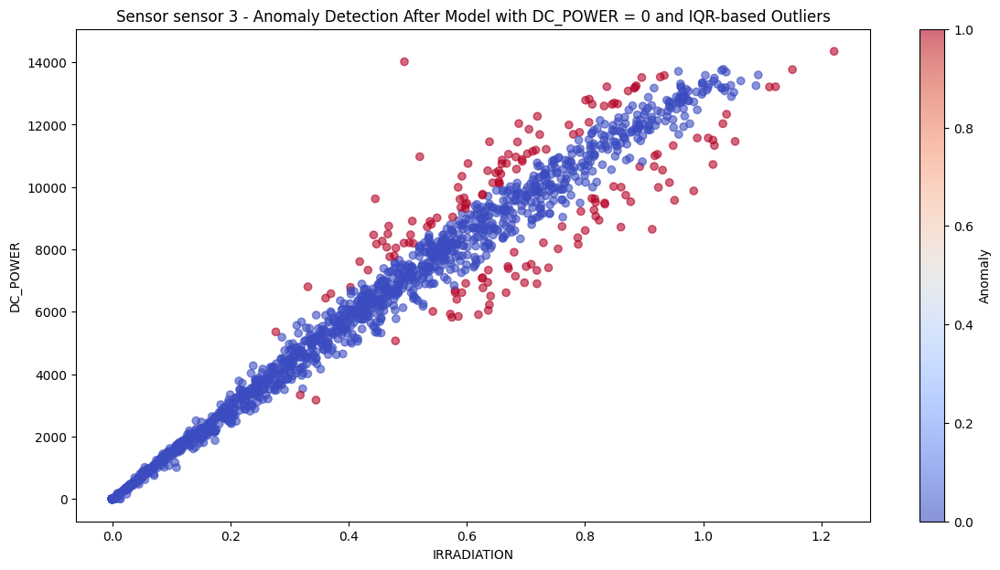

Sensor sensor 3 - Anomalies detected: 160
       IRRADIATION      DC_POWER    Residuals
796       0.344884   3170.142857 -1702.301782
862       0.670675   7384.625000 -1637.686045
884       0.572283   5928.857143 -1840.157158
950       0.636561   7337.428571 -1250.338756
972       0.585787   5851.750000 -2089.272264
...            ...           ...          ...
63786     0.477277   7798.428571  1239.593061
65568     0.918285  11003.375000 -1172.941959
65722     0.502883   8216.857143  1331.856829
67834     0.602172  10755.857140  2606.134059
67856     0.659398  10748.375000  1869.708118

[160 rows x 3 columns]


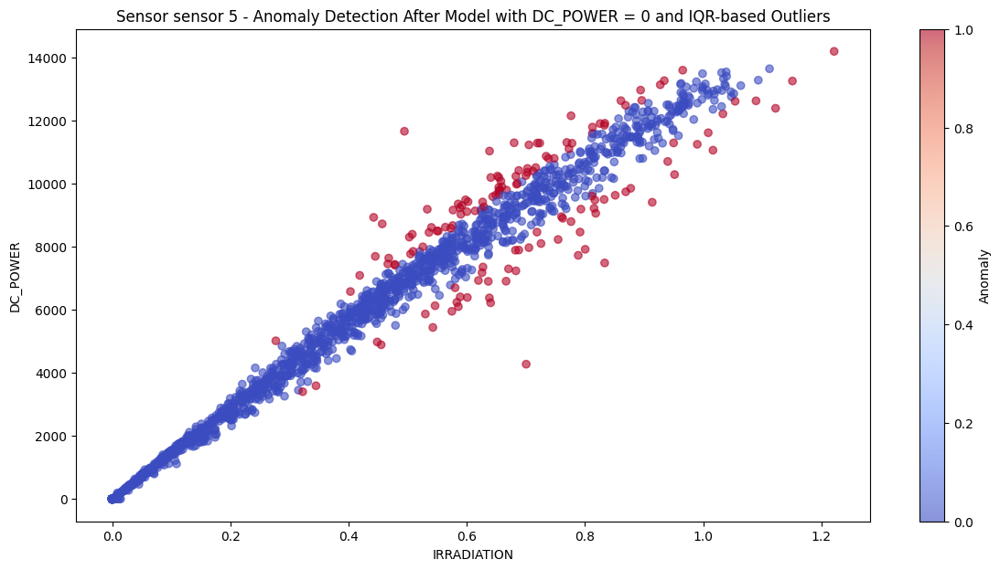

Sensor sensor 5 - Anomalies detected: 138
       IRRADIATION      DC_POWER    Residuals
797       0.344884   3592.285714 -1151.583322
863       0.670675   7301.375000 -1542.358250
907       0.455148   4893.000000 -1238.471475
973       0.585787   6103.250000 -1672.223035
1017      0.467987   7643.625000  1350.589838
...            ...           ...          ...
65723     0.502883   8309.428571  1577.253363
65899     0.525764   8001.142857   981.027554
67791     0.700175  10263.000000  1048.035105
67835     0.602172   9432.142857  1450.483664
67857     0.659398   9910.500000  1208.680130

[138 rows x 3 columns]


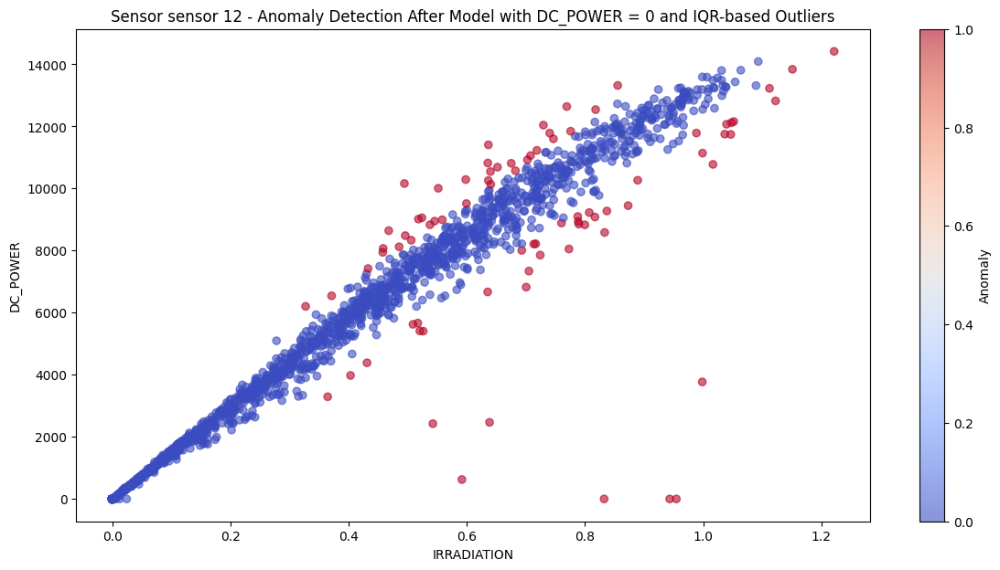

Sensor sensor 12 - Anomalies detected: 81
       IRRADIATION      DC_POWER    Residuals
952       0.636561  10257.857140  1613.116347
1018      0.467987   8642.875000  2173.697700
1062      0.787866   9099.500000 -1497.937717
4948      0.635451   6669.857143 -1960.559378
5014      0.837124   9275.750000 -1957.400246
...            ...           ...          ...
61346     0.640661  10134.714290  1437.054475
61610     1.221652  14418.428570 -1777.313287
63458     0.702748  10925.750000  1426.818509
63766     0.652057  10688.571430  1843.844717
67880     0.599461   9515.285714  1349.349871

[81 rows x 3 columns]


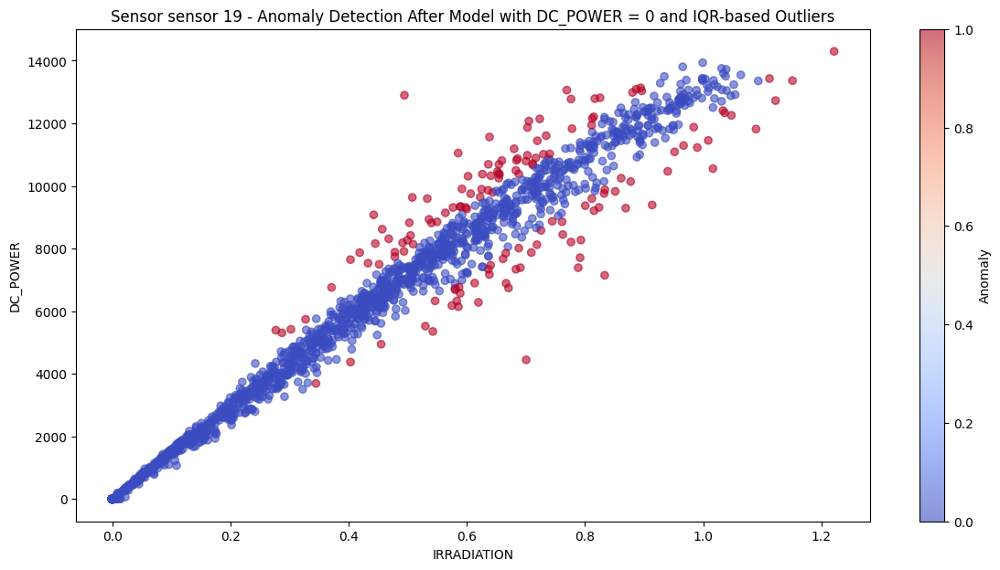

Sensor sensor 19 - Anomalies detected: 143
       IRRADIATION      DC_POWER    Residuals
799       0.344884   3690.428571 -1172.326090
865       0.670675   6739.500000 -2293.921963
909       0.455148   4944.000000 -1330.320464
975       0.585787   6141.750000 -1804.963302
1019      0.467987   8312.000000  1873.325707
...            ...           ...          ...
63767     0.652057  10459.428570  1664.354651
65725     0.502883   8824.714286  1939.316166
67793     0.700175  10792.571430  1381.506793
67837     0.602172  10310.714290  2154.254074
67859     0.659398  10810.625000  1921.567207

[143 rows x 3 columns]


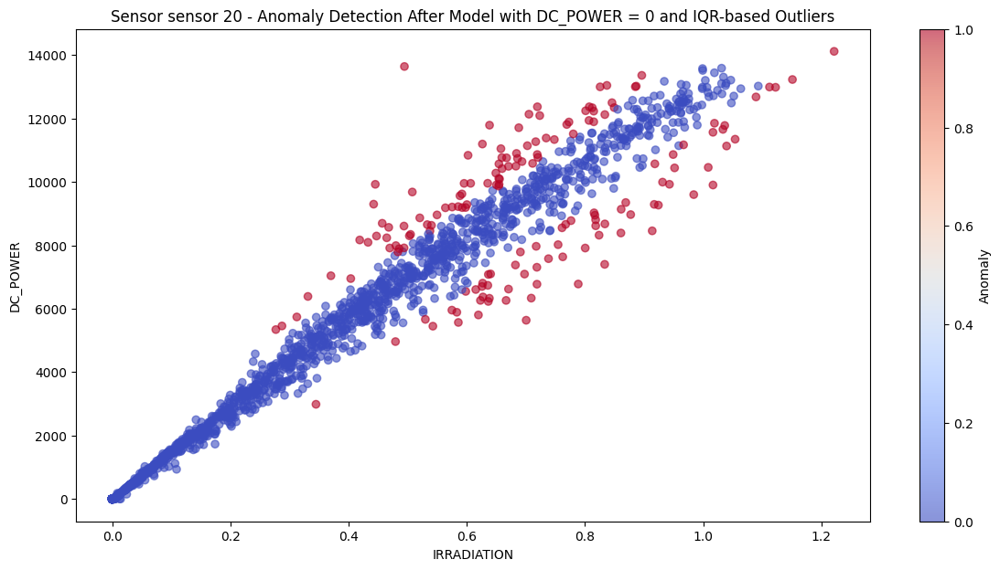

Sensor sensor 20 - Anomalies detected: 158
       IRRADIATION      DC_POWER    Residuals
756       0.312427   5739.714286  1359.293514
778       0.623153   6262.375000 -1959.810457
800       0.344884   2986.000000 -1795.716894
866       0.670675   6619.250000 -2190.498796
954       0.636561   7080.428571 -1307.534127
...            ...           ...          ...
65572     0.918285  10568.125000 -1303.032332
65704     0.483400   7792.000000  1297.695887
65726     0.502883   8298.571429  1563.384792
67838     0.602172  10839.000000  2876.221157
67860     0.659398  10767.500000  2097.178168

[158 rows x 3 columns]


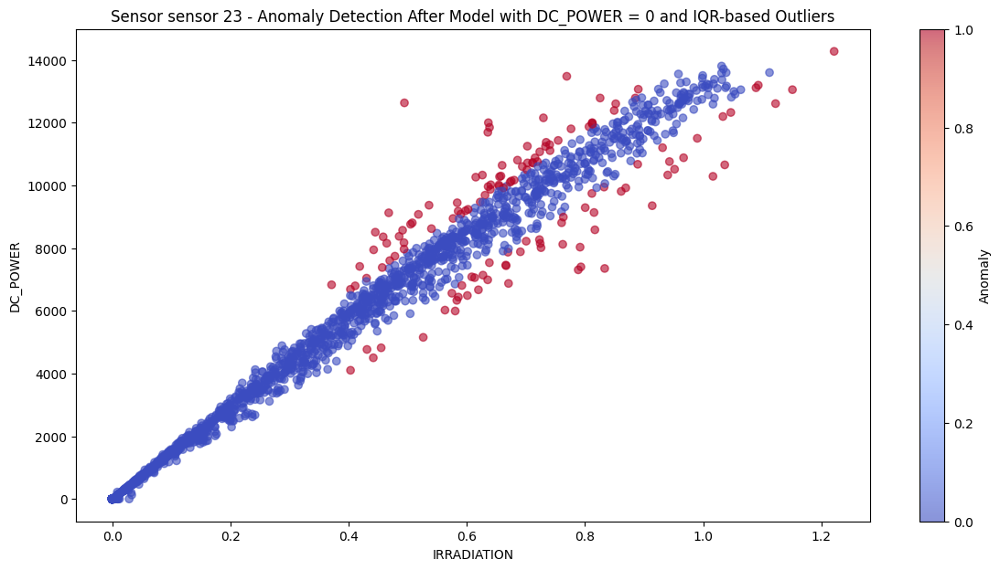

Sensor sensor 23 - Anomalies detected: 133
       IRRADIATION      DC_POWER    Residuals
868       0.670675   6873.000000 -2118.590356
912       0.455148   4820.428571 -1420.199841
978       0.585787   6437.857143 -1470.230424
1022      0.467987   9124.625000  2720.127614
2664      0.491453   8569.142857  1865.126171
...            ...           ...          ...
61548     0.734369  11373.125000  1568.558955
61614     1.221652  14273.285710 -1750.905636
63418     0.680174  10166.250000  1053.417191
63462     0.702748  10715.875000  1314.912838
67840     0.602172   9235.857143  1118.641431

[133 rows x 3 columns]


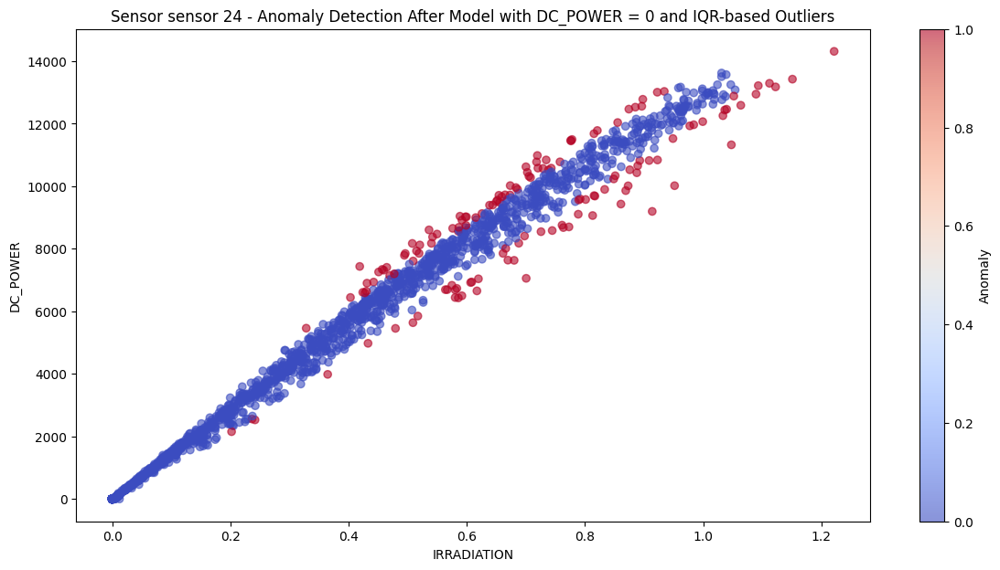

Sensor sensor 24 - Anomalies detected: 140
       IRRADIATION      DC_POWER    Residuals
979       0.585787   6429.142857 -1350.218974
1045      0.514963   7931.500000  1046.804744
1111      0.761243   8755.000000 -1240.747762
1287      0.542138   8377.375000  1149.389867
2709      0.654437   9710.714286  1064.160765
...            ...           ...          ...
67643     0.450858   7258.000000  1183.086361
67797     0.700175  10622.000000  1397.676961
67863     0.659398   9661.375000   952.146680
67885     0.599461   9020.857143  1068.771497
67951     0.586605   8686.500000   896.802597

[140 rows x 3 columns]


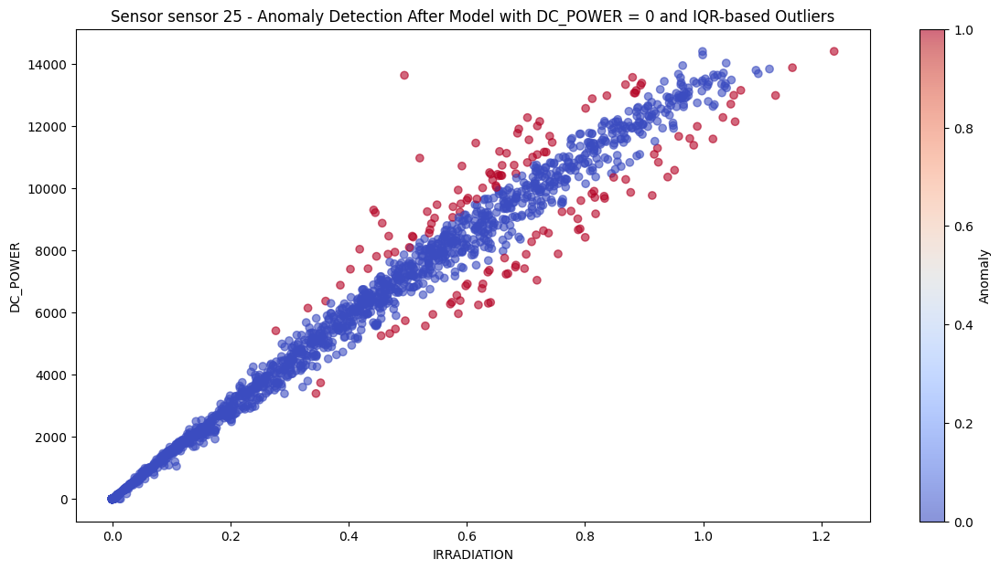

Sensor sensor 25 - Anomalies detected: 143
       IRRADIATION      DC_POWER    Residuals
804       0.344884   3395.714286 -1539.019279
892       0.572283   6276.875000 -1606.632865
914       0.455148   5257.571429 -1107.001511
980       0.585787   5966.875000 -2091.740914
1024      0.467987   8465.375000  1934.320571
...            ...           ...          ...
63530     0.664058   7759.714286 -1313.866848
63772     0.652057  10456.750000  1538.790929
65730     0.502883   8103.125000  1119.563634
67842     0.602172   9690.857143  1419.779015
67864     0.659398  10415.625000  1402.465376

[143 rows x 3 columns]


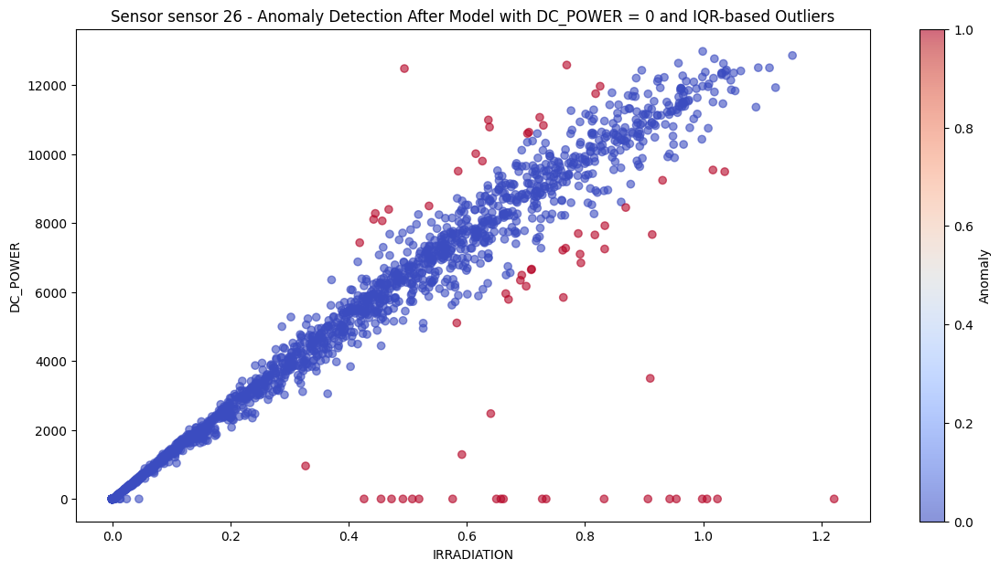

Sensor sensor 26 - Anomalies detected: 65
       IRRADIATION      DC_POWER     Residuals
871       0.670675   5785.125000  -2418.660828
1025      0.467987   8394.428571   2551.418424
11983     0.700566   6167.428571  -2384.506839
12071     0.723534  11064.285710   2244.835257
14055     0.638545  10780.285710   2950.734010
...            ...           ...           ...
61573     0.727764      0.000000  -8868.709067
61595     0.906615      0.000000 -10951.846493
61617     1.221652      0.000000 -14621.179243
61639     0.910489   3496.750000  -7500.222355
63465     0.702748  10594.625000   2017.278958

[65 rows x 3 columns]


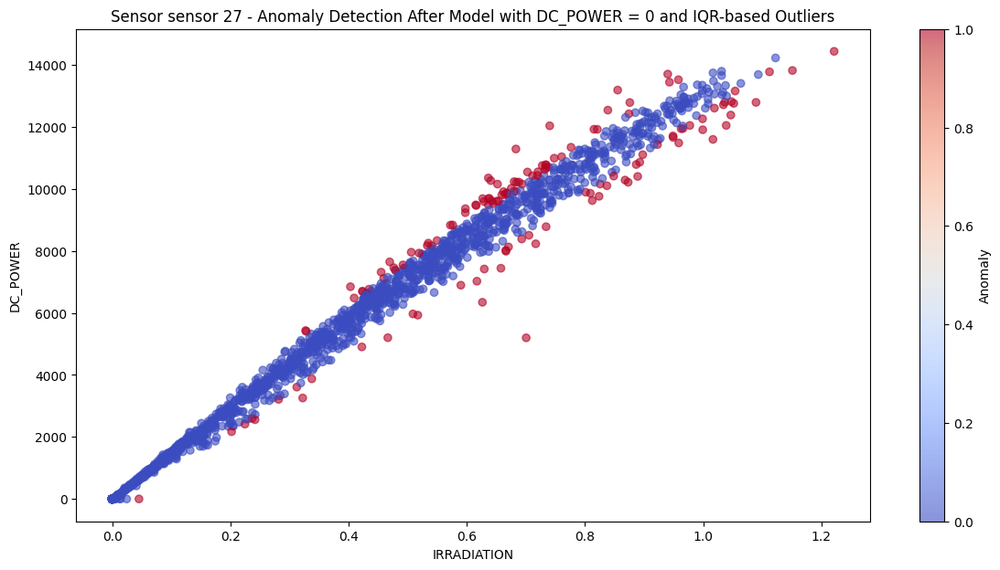

Sensor sensor 27 - Anomalies detected: 133
       IRRADIATION      DC_POWER    Residuals
762       0.312427   3607.285714  -799.492479
916       0.455148   7315.714286  1073.632793
960       0.636561  10353.000000  1778.076217
2954      0.733244  10772.625000   954.426722
4868      0.812389   9625.125000 -1210.830402
...            ...           ...          ...
65512     0.720425  10550.500000   897.141896
65820     0.409413   6481.750000   827.797122
67272     0.045348      0.000000  -972.319309
67866     0.659398   9804.875000   936.276439
67976     0.535012   8250.428571   981.355210

[133 rows x 3 columns]


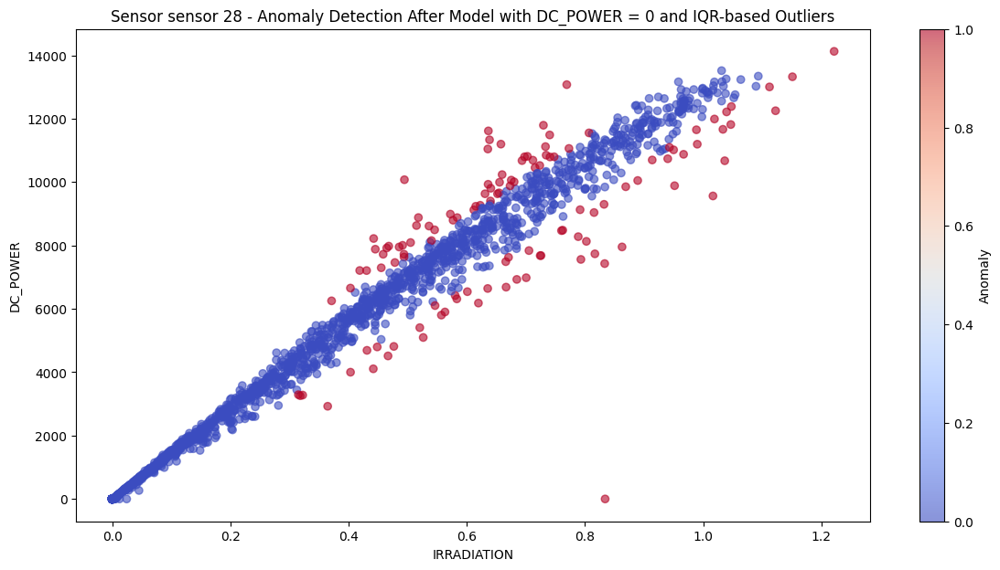

Sensor sensor 28 - Anomalies detected: 119
       IRRADIATION      DC_POWER    Residuals
873       0.670675   7627.750000 -1119.337480
895       0.572283   8989.000000  1466.601467
1005      0.557069   5802.142857 -1530.885080
1027      0.467987   7978.857143  1754.643808
1049      0.514963   8629.000000  1820.077512
...            ...           ...          ...
61355     0.640661   9806.000000  1432.498917
61553     0.734369  10849.750000  1309.867144
61619     1.221652  14126.428570 -1478.691230
63423     0.680174  10009.875000  1144.554642
63775     0.652057   9630.428571  1115.086985

[119 rows x 3 columns]


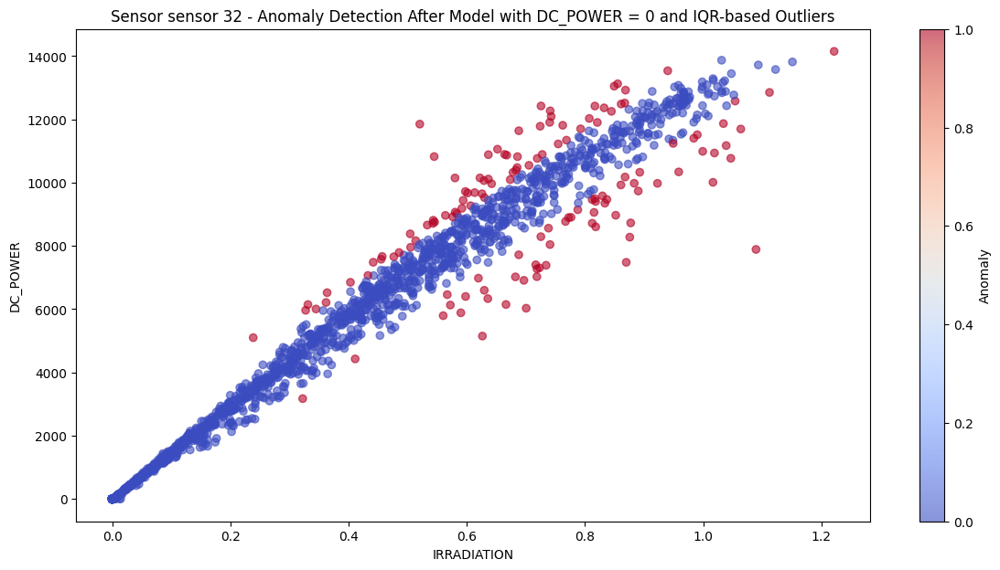

Sensor sensor 32 - Anomalies detected: 134
       IRRADIATION      DC_POWER    Residuals
808       0.344884   6005.428571  1203.803693
896       0.572283   6130.125000 -1523.548166
918       0.455148   7577.428571  1392.866063
940       0.361962   6211.875000  1196.062295
962       0.636561  10114.571430  1654.729783
...            ...           ...          ...
61620     1.221652  14149.875000 -1648.189111
63446     0.860845   9927.250000 -1345.565736
63534     0.664058  10893.000000  2088.290477
63578     0.432797   7065.000000  1160.765222
63776     0.652057  11056.750000  2402.557808

[134 rows x 3 columns]


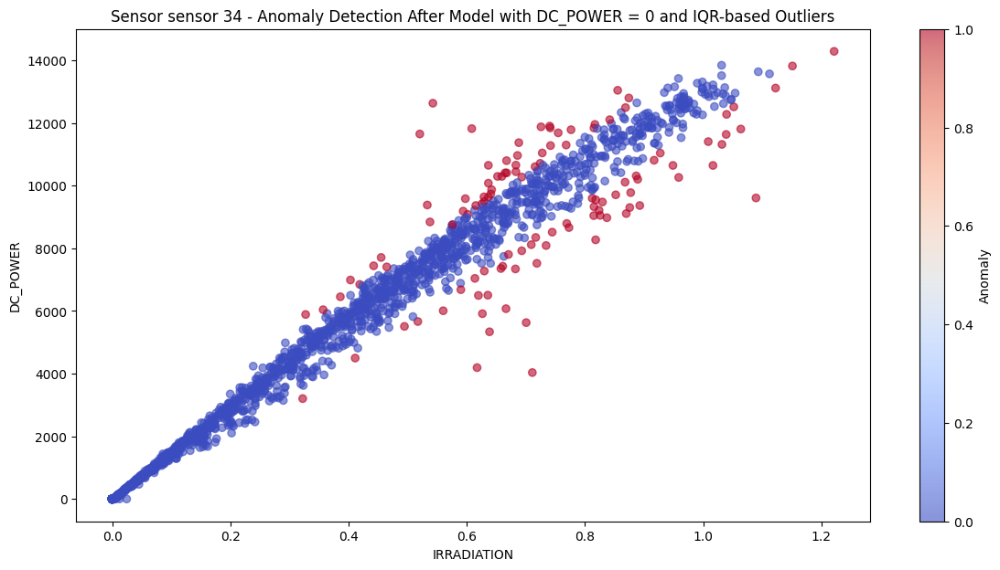

Sensor sensor 34 - Anomalies detected: 112
       IRRADIATION      DC_POWER    Residuals
919       0.455148   7707.571429  1530.134253
963       0.636561  10648.857140  2191.271831
2913      0.812241   9598.750000 -1066.929466
4827      0.685882  10962.875000  1885.384500
4937      0.869909   9108.428571 -2282.075819
...            ...           ...          ...
61533     0.576180   8760.714286  1062.043504
61577     0.727764  11043.571430  1439.673086
61621     1.221652  14285.714290 -1525.796946
63777     0.652057  10295.000000  1642.648245
67869     0.659398  10295.375000  1550.748429

[112 rows x 3 columns]


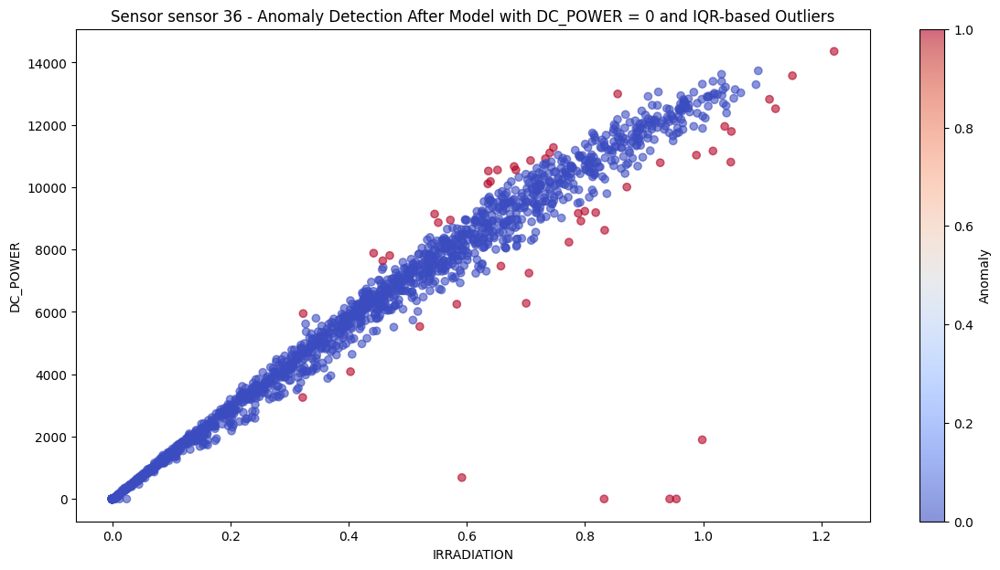

Sensor sensor 36 - Anomalies detected: 47
       IRRADIATION      DC_POWER     Residuals
898       0.572283   8947.125000   1287.875524
2958      0.733244  10916.625000   1221.309280
11790     0.322396   3255.600000  -1242.696629
11988     0.700566   6277.000000  -3004.964750
12230     0.746644  11274.000000   1409.177054
14192     1.047775  11788.625000  -1885.357767
16132     1.112297  12820.375000  -1669.774666
18332     0.793158   8914.375000  -1538.831369
18376     0.833393   8620.000000  -2342.151221
22284     0.988618  11027.875000  -1897.802329
22350     0.705264   7244.285714  -2097.101277
24444     1.036561  11949.375000  -1582.753510
26364     0.818236   9185.857143  -1584.570901
26496     0.927457  10785.142860  -1366.880355
26694     0.403313   4082.875000  -1438.986470
26716     0.551827   8865.000000   1464.509056
28058     0.870920  10005.285710  -1431.571972
29966     1.151102  13576.375000  -1404.647096
29988     0.799824   9229.285714  -1308.234507
30010     1.122550

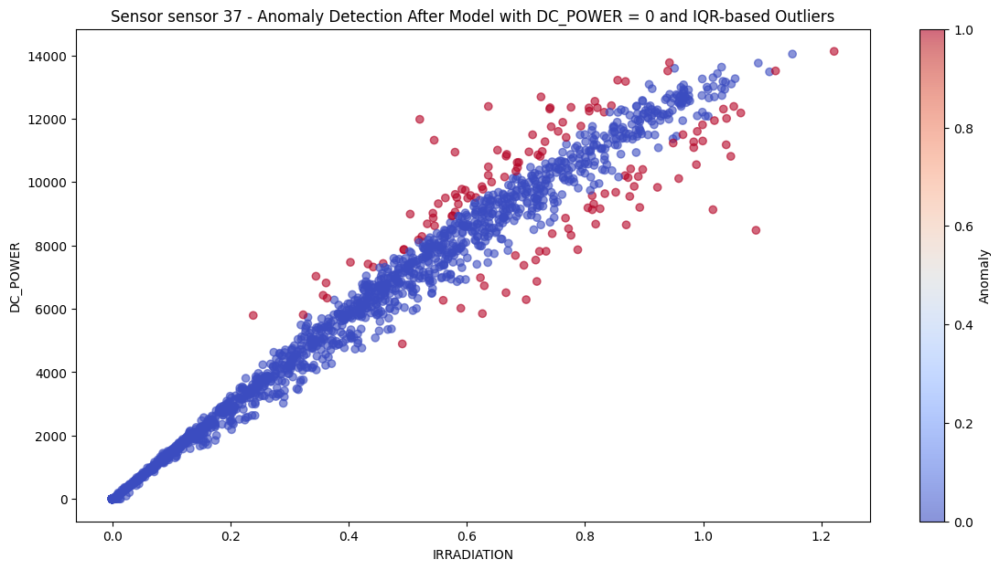

Sensor sensor 37 - Anomalies detected: 131
       IRRADIATION     DC_POWER    Residuals
789       0.623153   6981.87500 -1369.440469
811       0.344884   7028.00000  2187.004892
943       0.361962   6817.50000  1761.073082
965       0.636561  10481.14286  1960.684377
987       0.585787   9303.75000  1423.794367
...            ...          ...          ...
61623     1.221652  14125.62500 -1775.675709
63537     0.664058  10161.62500  1294.295678
63647     0.732408  11275.14286  1545.585652
63779     0.652057  11008.37500  2292.437200
65517     0.720425  10859.14286  1280.751644

[131 rows x 3 columns]


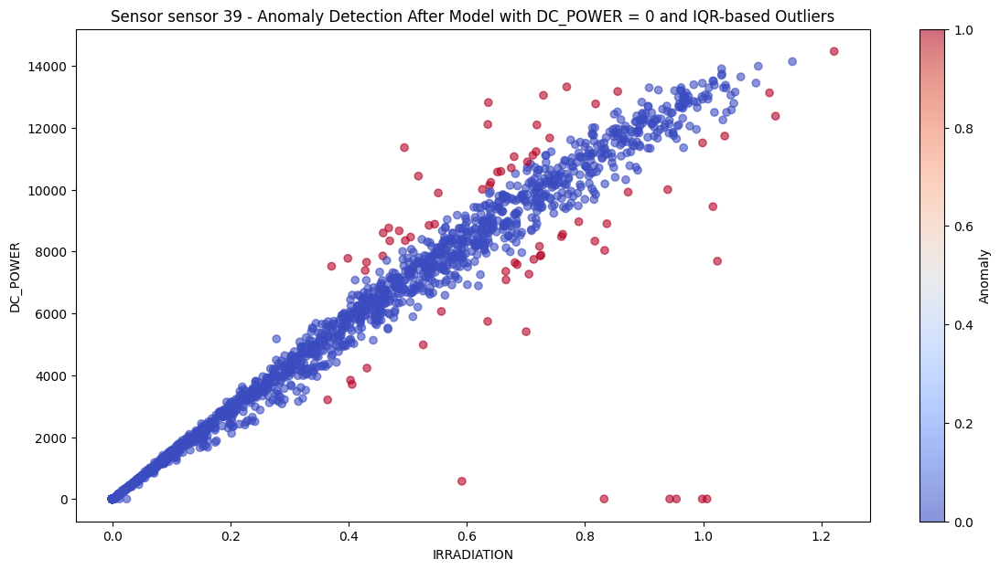

Sensor sensor 39 - Anomalies detected: 72
       IRRADIATION      DC_POWER    Residuals
1010      0.557069   6061.428571 -1469.896928
1032      0.467987   8761.428571  2372.818488
1318      0.398889   7779.000000  2276.756038
4962      0.635451   5739.285714 -2797.487816
5028      0.837124   8897.875000 -2225.885383
...            ...           ...          ...
61360     0.640661  10237.714290  1634.104297
61624     1.221652  14471.125000 -1585.202680
63428     0.680174  11067.875000  1957.408886
63472     0.702748  10900.250000  1500.216127
63780     0.652057  10571.285710  1821.498592

[72 rows x 3 columns]


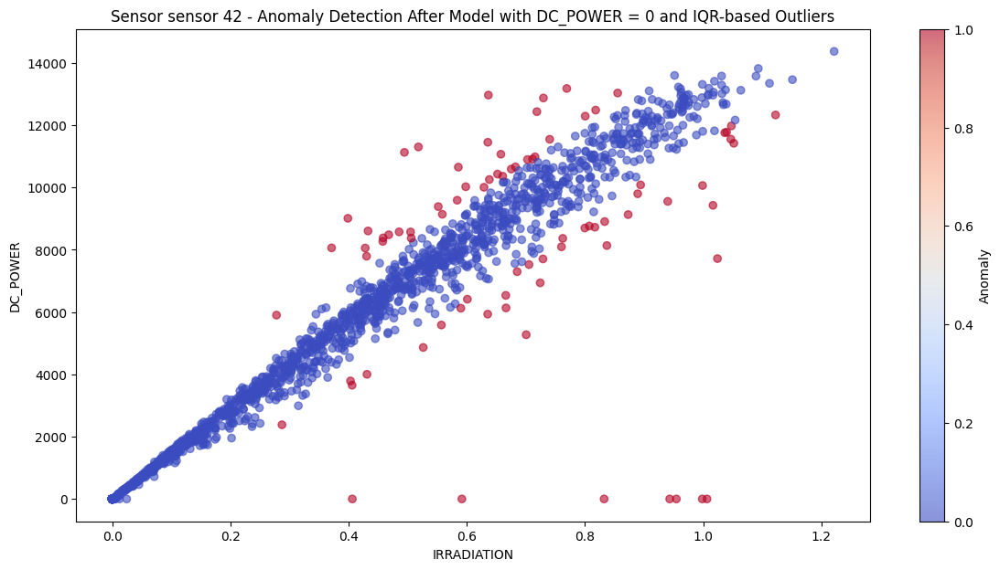

Sensor sensor 42 - Anomalies detected: 81
       IRRADIATION      DC_POWER    Residuals
989       0.585787  10653.625000  2862.129788
1011      0.557069   5585.571429 -1845.770615
1033      0.467987   8481.285714  2167.136345
1319      0.398889   9010.500000  3562.919615
2983      0.583865   9591.285714  1823.900452
...            ...           ...          ...
59227     0.740382  11547.285710  1817.006418
59293     0.855400  13033.500000  1860.762651
59359     0.889302   9798.857143 -1799.050067
63473     0.702748  10897.375000  1639.062497
63781     0.652057  10431.000000  1808.410882

[81 rows x 3 columns]


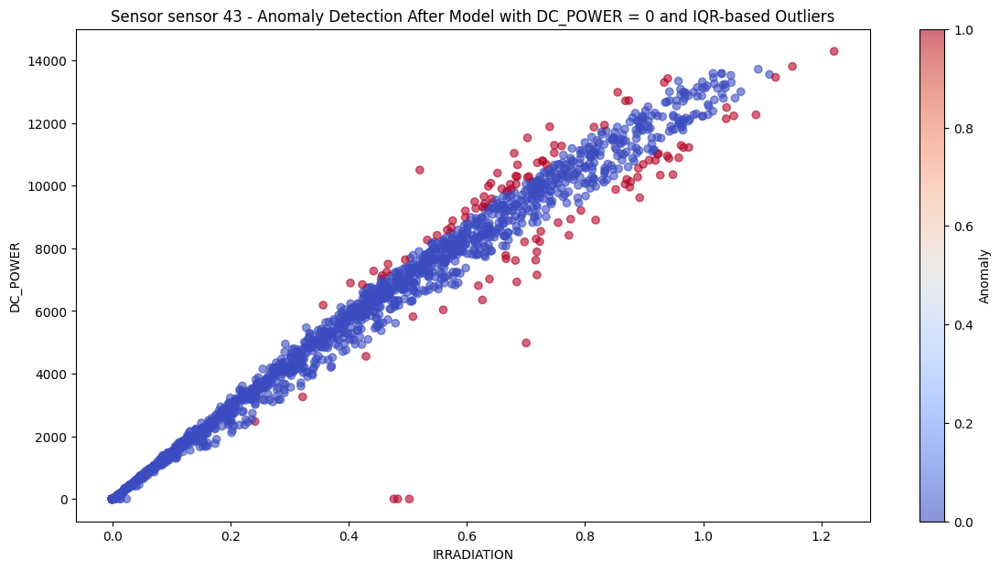

Sensor sensor 43 - Anomalies detected: 108
       IRRADIATION      DC_POWER    Residuals
968       0.636561   9982.000000  1536.247334
1276      0.466789   7498.625000  1203.966649
4832      0.685882  10667.125000  1596.454880
5140      0.697773   8210.285714 -1011.048806
5228      0.683636  10056.285710  1014.065905
...            ...           ...          ...
63826     0.423315   6847.428571  1103.610680
65696     0.429469   4553.250000 -1268.547166
65718     0.483400      0.000000 -6505.127981
65740     0.502883      0.000000 -6751.984820
67874     0.659398   9904.625000  1169.510191

[108 rows x 3 columns]


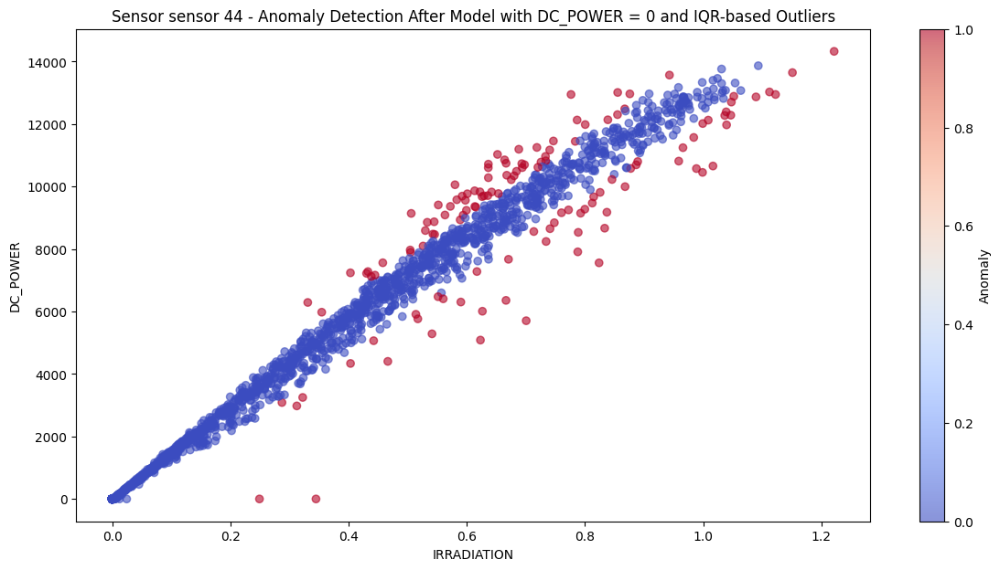

Sensor sensor 44 - Anomalies detected: 128
       IRRADIATION      DC_POWER    Residuals
771       0.312427   2978.750000 -1423.843197
793       0.623153   5085.857143 -3288.177180
815       0.344884      0.000000 -4817.434826
837       0.249248      0.000000 -3595.099147
859       0.541206   5286.500000 -2040.159677
...            ...           ...          ...
63585     0.432797   7279.000000  1337.930466
63783     0.652057  11030.000000  2286.536262
65521     0.720425  10619.142860  1001.855348
67897     0.599461   9240.571429  1169.349612
67919     0.438458   7122.875000  1109.457879

[128 rows x 3 columns]


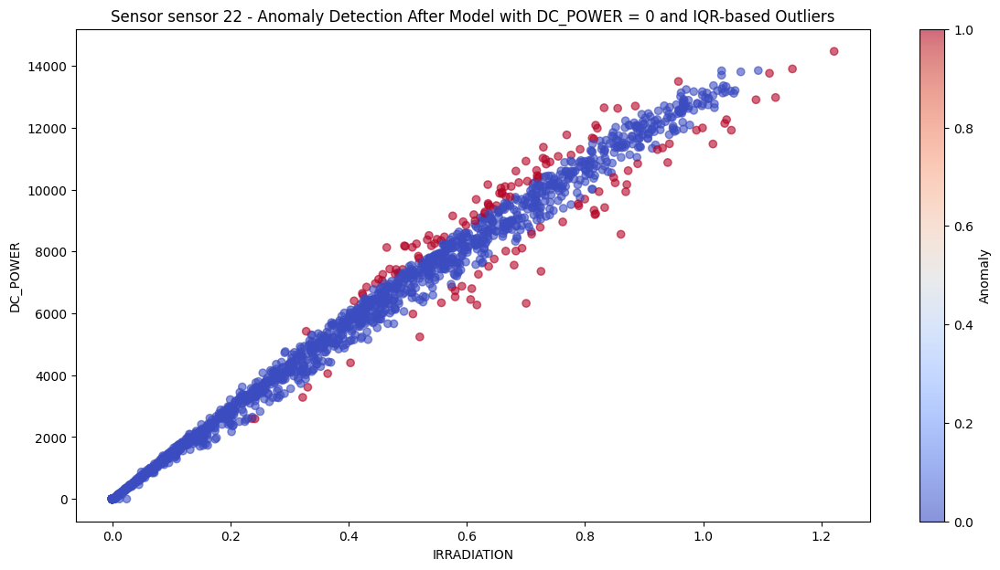

Sensor sensor 22 - Anomalies detected: 132
       IRRADIATION      DC_POWER    Residuals
999       0.557069   6340.500000 -1129.277049
1043      0.514963   8245.625000  1312.918397
2663      0.491453   7418.875000   786.031920
2905      0.812241  11666.000000   941.524133
2927      0.636165   9550.428571  1071.795491
...            ...           ...          ...
65815     0.409413   6403.500000   817.076432
65881     0.718147  10619.714290  1095.405125
67641     0.450858   7100.571429   985.519735
67795     0.700175  10917.571430  1622.489465
67861     0.659398   9866.500000  1091.520883

[132 rows x 3 columns]


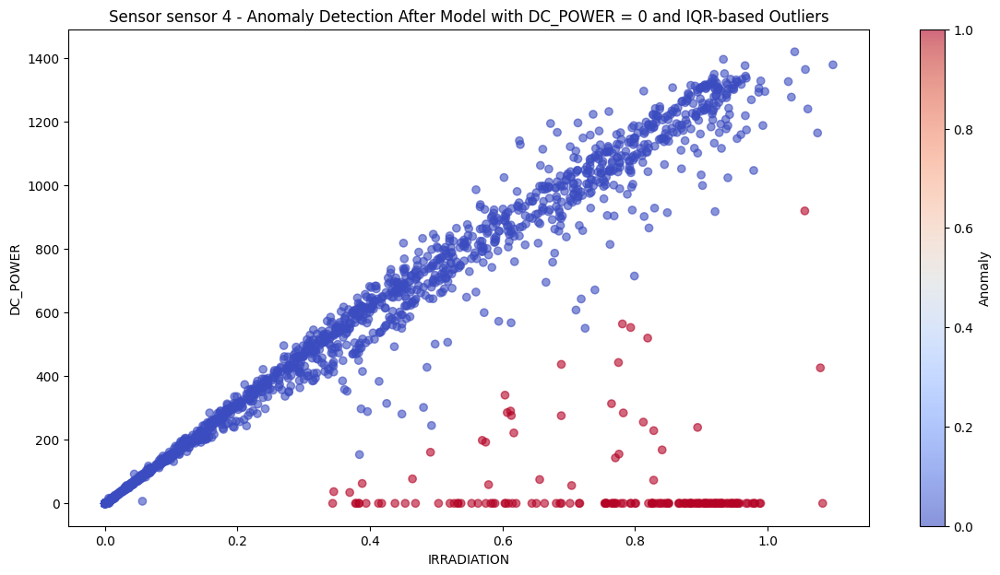

Sensor sensor 4 - Anomalies detected: 157
        IRRADIATION   DC_POWER    Residuals
69658      0.828096  72.906667 -1048.417967
69680      0.874834   0.000000 -1181.858062
69702      0.908056   0.000000 -1224.886408
69724      0.943353   0.000000 -1270.601464
69746      0.957900   0.000000 -1289.442781
...             ...        ...          ...
131394     0.345276  36.726667  -459.265590
133286     0.614951   0.000000  -845.266285
133308     0.520605   0.000000  -723.072895
133528     0.562944   0.000000  -777.909040
135574     0.578941  58.720000  -739.907647

[157 rows x 3 columns]


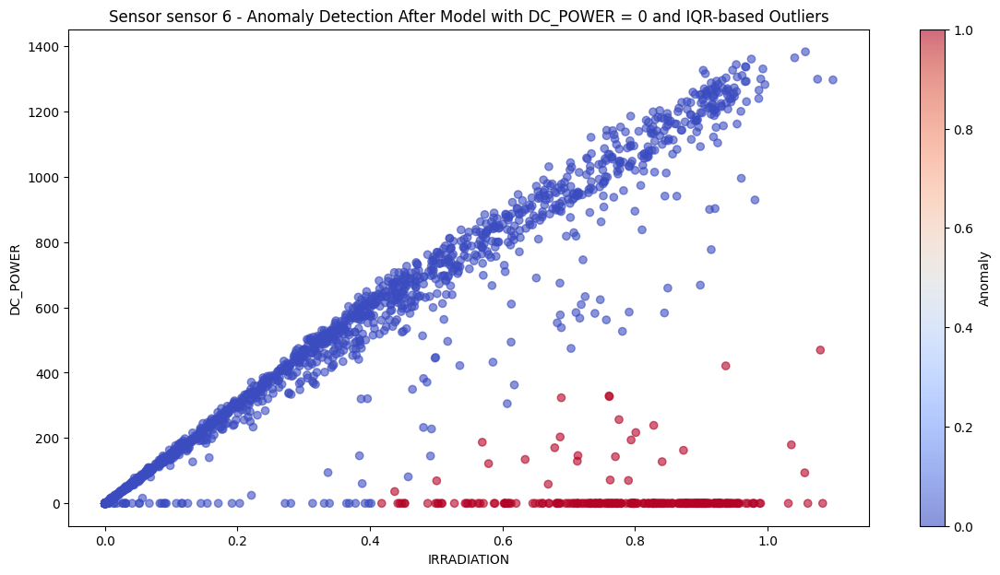

Sensor sensor 6 - Anomalies detected: 258
        IRRADIATION    DC_POWER    Residuals
69637      0.799746    0.000000  -994.655159
69659      0.828096    0.000000 -1027.484557
69681      0.874834    0.000000 -1081.607327
69703      0.908056    0.000000 -1120.078852
69725      0.943353    0.000000 -1160.952557
...             ...         ...          ...
122749     0.620565    0.000000  -787.162569
126841     0.794066  193.992857  -794.084389
126863     0.503415    0.000000  -651.501820
133529     0.562944    0.000000  -720.437627
135575     0.578941  121.613333  -617.348742

[258 rows x 3 columns]


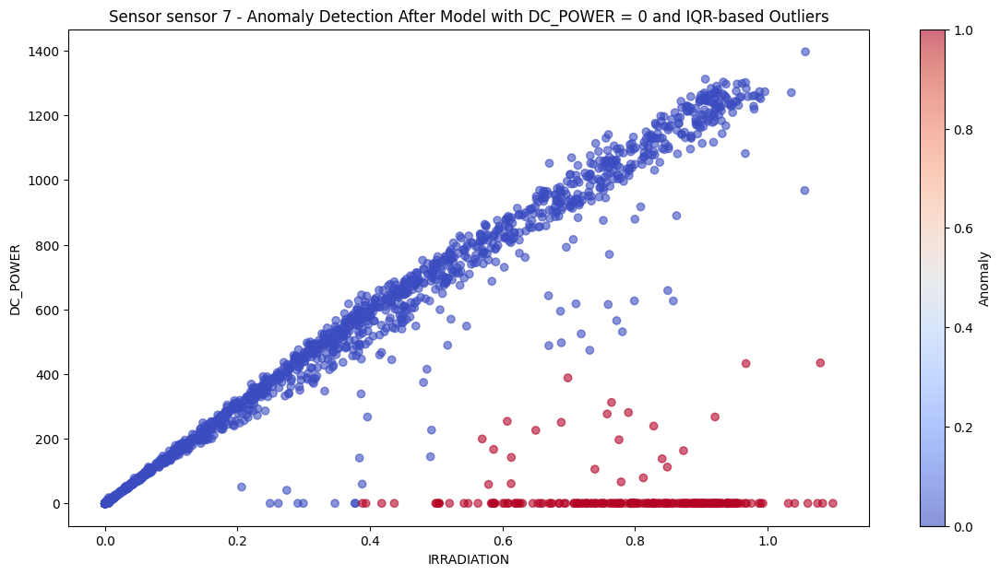

Sensor sensor 7 - Anomalies detected: 223
        IRRADIATION    DC_POWER    Residuals
74214      0.778989   66.260000  -958.295189
78108      0.775781  196.773333  -823.744169
78262      0.967463  432.313333  -829.419318
79729      0.849222    0.000000 -1112.936665
79741      0.912170    0.000000 -1192.150807
...             ...         ...          ...
127172     0.436580    0.000000  -593.665081
127194     0.793398    0.000000 -1042.687096
127216     0.388632    0.000000  -533.326620
133530     0.562944    0.000000  -752.682788
135576     0.578941   58.480000  -714.333353

[223 rows x 3 columns]


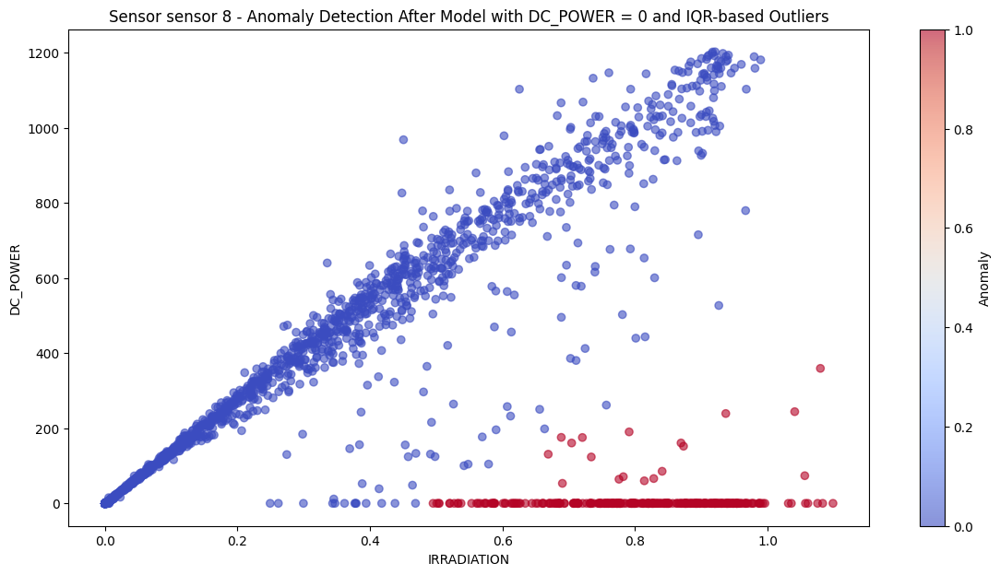

Sensor sensor 8 - Anomalies detected: 310
        IRRADIATION    DC_POWER   Residuals
69639      0.799746    0.000000 -790.010341
69661      0.828096    0.000000 -814.770205
69683      0.874834    0.000000 -855.589485
69705      0.908056    0.000000 -884.604629
69727      0.943353    0.000000 -915.431492
...             ...         ...         ...
131243     0.553322    0.000000 -574.792311
131375     0.704287  160.742857 -545.897132
133289     0.614951    0.000000 -628.616809
133311     0.520605    0.000000 -546.218597
133531     0.562944    0.000000 -583.196050

[310 rows x 3 columns]


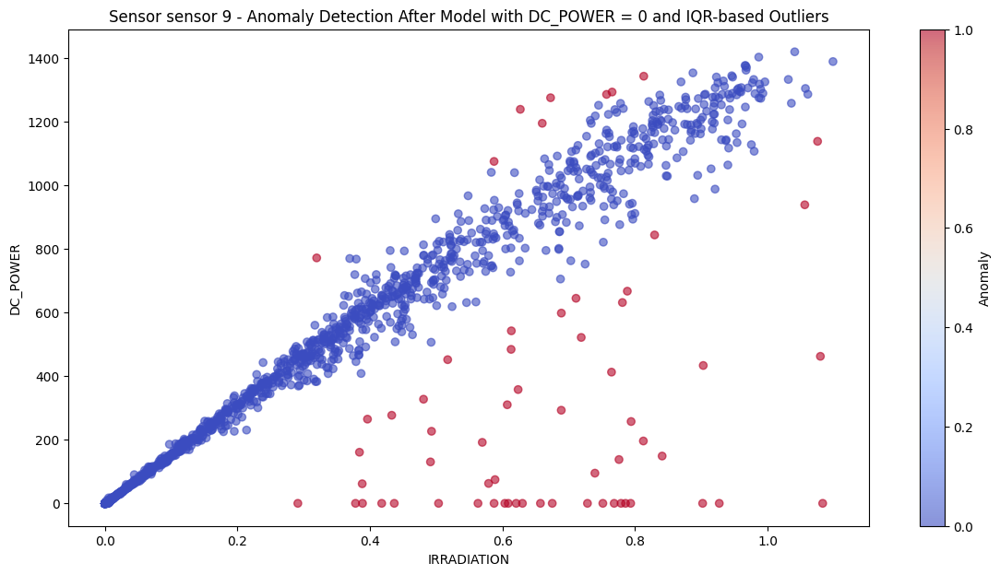

Sensor sensor 9 - Anomalies detected: 63
        IRRADIATION     DC_POWER   Residuals
74172      0.688748   597.853333 -334.986336
78110      0.775781   137.628571 -906.744616
99608      0.319459   771.273333  311.682437
101478     0.788344   666.713333 -393.760413
101676     1.079779   461.960000 -971.990982
...             ...          ...         ...
133510     0.492803   226.460000 -455.272962
133532     0.562944     0.000000 -771.620547
135578     0.578941    62.564286 -729.556459
135600     0.480736   327.206667 -339.062772
99564      0.813154  1342.253333  249.985403

[63 rows x 3 columns]


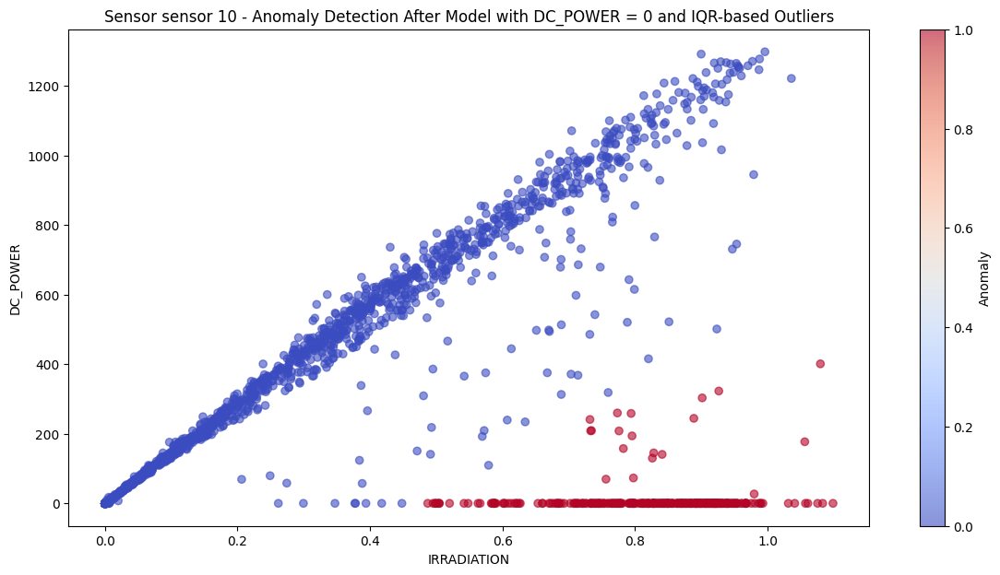

Sensor sensor 10 - Anomalies detected: 329
        IRRADIATION  DC_POWER   Residuals
69927      0.926438    322.78 -700.947107
70037      0.826129    129.84 -791.905466
71753      0.821055      0.00 -916.587178
71775      0.850826      0.00 -946.854922
71797      0.894438      0.00 -991.193364
...             ...       ...         ...
120751     0.504455      0.00 -594.709917
122753     0.620565      0.00 -712.755478
126845     0.794066    258.38 -630.768059
126867     0.503415      0.00 -593.652434
133533     0.562944      0.00 -654.174468

[329 rows x 3 columns]


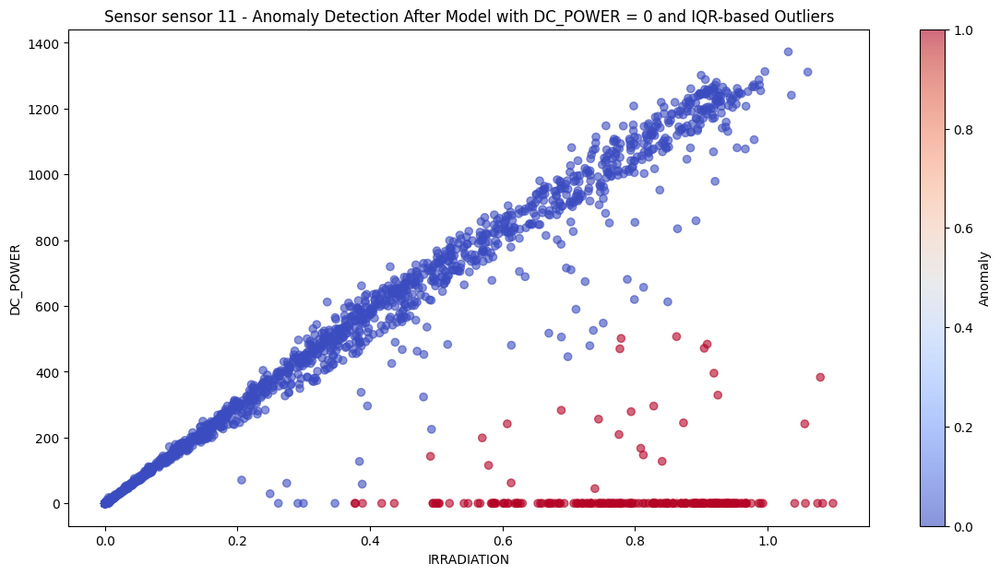

Sensor sensor 11 - Anomalies detected: 219
        IRRADIATION  DC_POWER    Residuals
74218      0.778989    501.28  -512.052847
76220      0.744953    255.88  -715.129574
76242      0.759819      0.00  -989.494623
76264      0.838826      0.00 -1087.738772
76286      0.831370      0.00 -1078.467830
...             ...       ...          ...
127176     0.436580      0.00  -587.550477
127198     0.793398      0.00 -1031.249820
127220     0.388632      0.00  -527.927263
133534     0.562944      0.00  -744.683201
135580     0.578941    115.44  -649.135139

[219 rows x 3 columns]


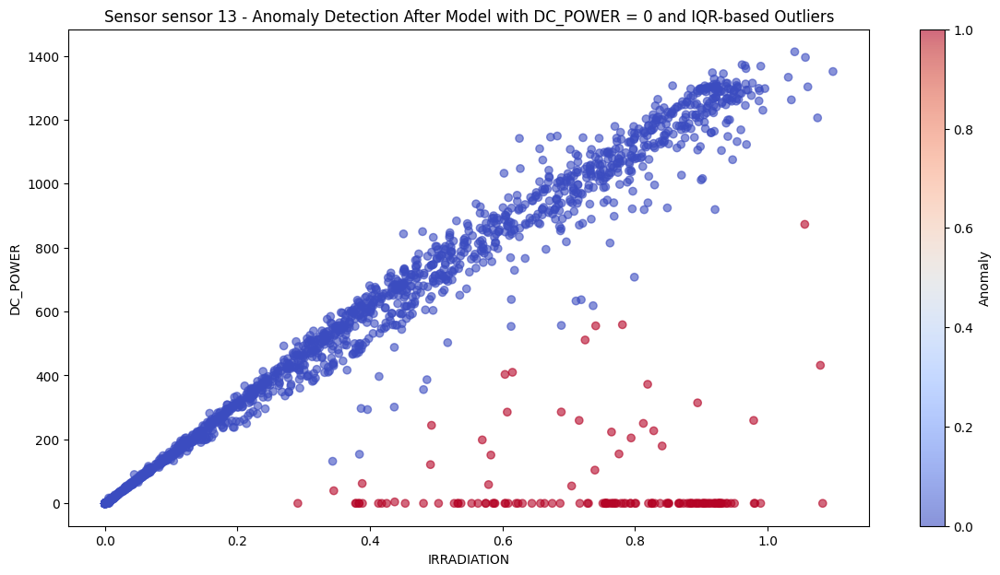

Sensor sensor 13 - Anomalies detected: 136
        IRRADIATION    DC_POWER    Residuals
69907      0.979090  259.373333 -1065.016549
69929      0.926438    0.000000 -1255.637034
69951      0.904247    0.000000 -1226.659674
69973      0.895474    0.000000 -1215.204078
69995      0.866027    0.000000 -1176.752613
...             ...         ...          ...
131401     0.345276   39.393333  -457.366844
133293     0.614951  409.973333  -438.926124
133513     0.492803  244.050000  -445.349159
133535     0.562944    0.000000  -780.989652
135581     0.578941   58.606667  -743.271556

[136 rows x 3 columns]


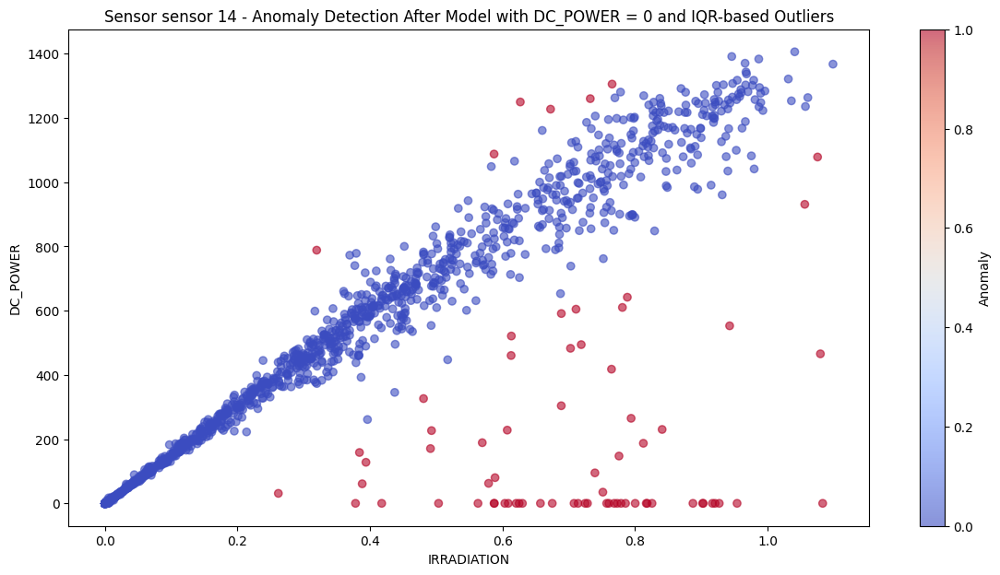

Sensor sensor 14 - Anomalies detected: 72
        IRRADIATION     DC_POWER   Residuals
74176      0.688748   591.080000 -317.157616
78114      0.775781   147.292857 -869.007040
99612      0.319459   788.380000  338.662325
101482     0.788344   641.873333 -390.026028
101680     1.079779   465.533333 -928.219602
...             ...          ...         ...
133536     0.562944     0.000000 -752.036086
135582     0.578941    62.271429 -709.626832
135604     0.480736   326.213333 -323.750467
110150     0.765351  1305.540000  302.190421
112372     0.732432  1260.246667  297.769680

[72 rows x 3 columns]


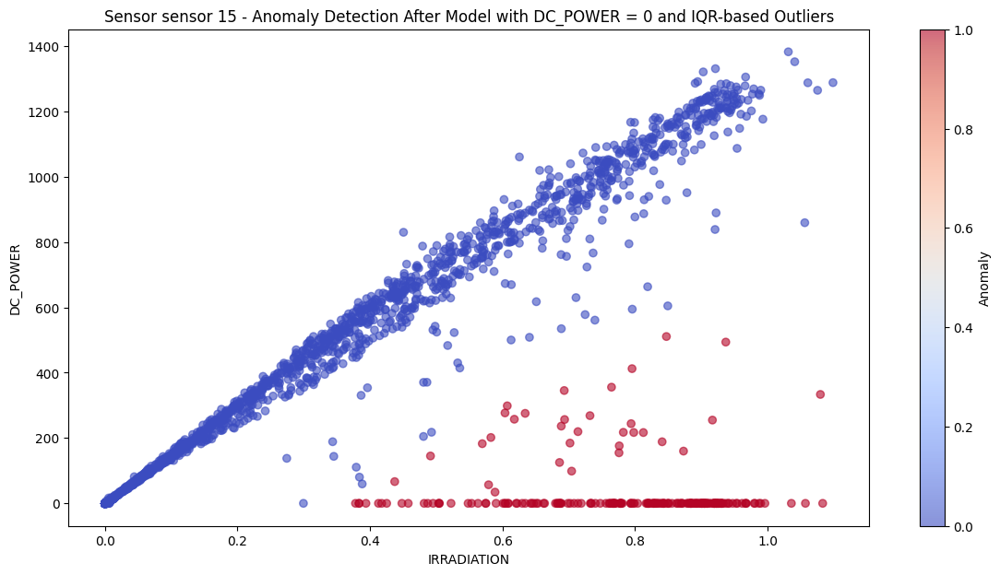

Sensor sensor 15 - Anomalies detected: 210
        IRRADIATION   DC_POWER    Residuals
71757      0.821055   0.000000 -1054.169270
71779      0.850826   0.000000 -1090.684768
71801      0.894438   0.000000 -1144.175385
71823      0.884239   0.000000 -1131.666653
71845      0.919857   0.000000 -1175.352307
...             ...        ...          ...
131271     0.383334   0.000000  -517.293579
131293     0.425117   0.000000  -568.541161
131381     0.704287  98.573333  -812.377529
133537     0.562944   0.000000  -737.590316
135583     0.578941  56.766667  -700.444196

[210 rows x 3 columns]


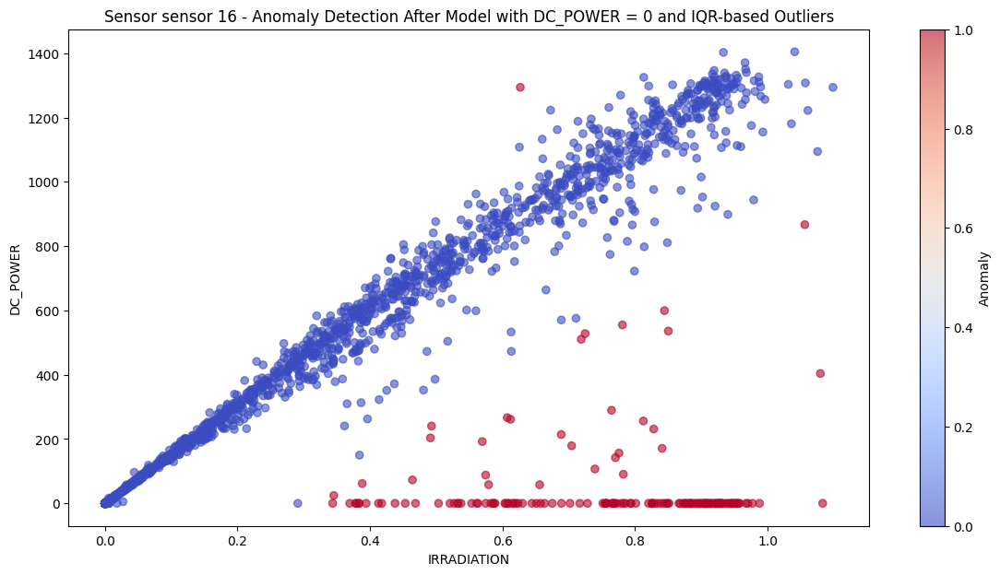

Sensor sensor 16 - Anomalies detected: 151
        IRRADIATION     DC_POWER    Residuals
69690      0.874834     0.000000 -1174.119341
69712      0.908056     0.000000 -1216.867574
69734      0.943353     0.000000 -1262.285028
69756      0.957900     0.000000 -1281.003689
69778      0.970448     0.000000 -1297.149202
...             ...          ...          ...
133318     0.520605     0.000000  -718.320840
133516     0.492803   240.500000  -442.046156
133538     0.562944     0.000000  -772.800005
135584     0.578941    58.053333  -735.330402
107996     0.626813  1294.035714   439.053197

[151 rows x 3 columns]


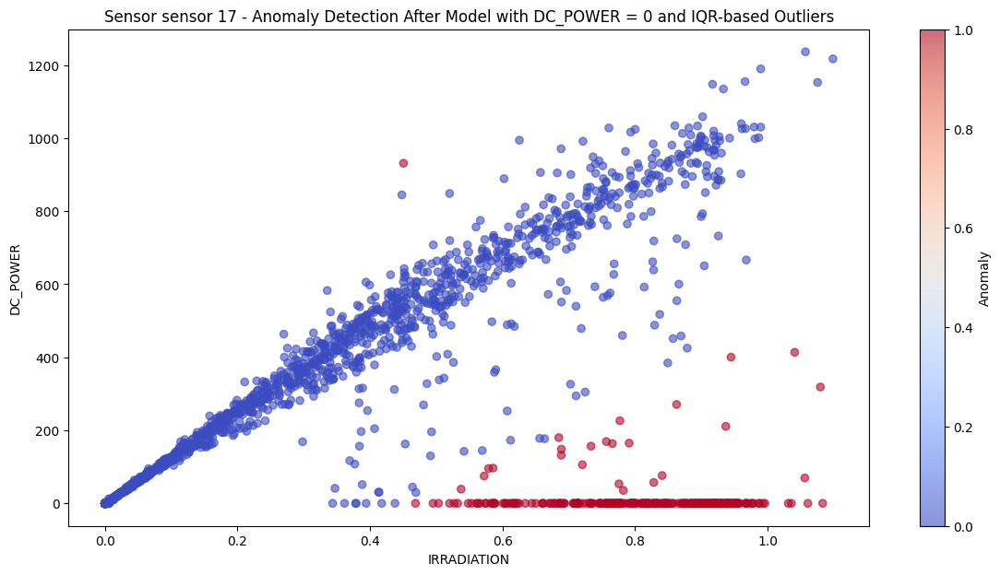

Sensor sensor 17 - Anomalies detected: 296
        IRRADIATION    DC_POWER   Residuals
69625      0.756683  169.171429 -533.453920
69647      0.799746    0.000000 -738.175400
69669      0.828096    0.000000 -761.579105
69691      0.874834    0.000000 -800.162614
69713      0.908056    0.000000 -827.588528
...             ...         ...         ...
131251     0.553322    0.000000 -534.745385
133297     0.614951    0.000000 -585.621785
133539     0.562944    0.000000 -542.688831
135585     0.578941   95.240000 -460.654701
99549      0.450506  931.486667  481.619333

[296 rows x 3 columns]


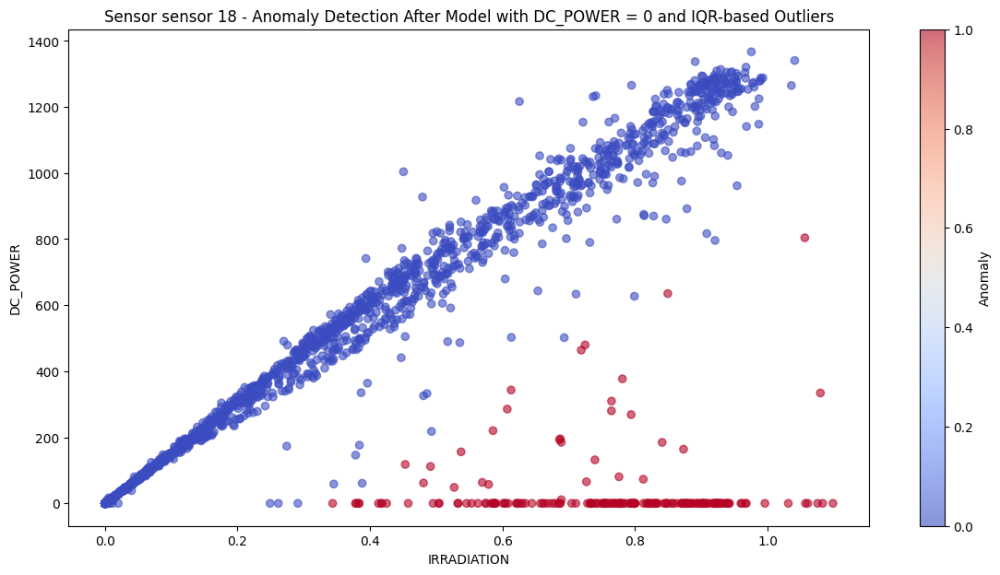

Sensor sensor 18 - Anomalies detected: 196
        IRRADIATION   DC_POWER    Residuals
74158      0.799829   0.000000 -1059.316826
74180      0.688748  10.806667  -908.162077
74202      0.761283   0.000000 -1010.615803
74224      0.778989   0.000000 -1032.986749
74246      0.732284   0.000000  -973.975487
...             ...        ...          ...
131274     0.383334   0.000000  -533.083894
131296     0.425117   0.000000  -585.875588
131384     0.704287   0.000000  -938.602241
133540     0.562944   0.000000  -760.018266
135586     0.578941  57.246667  -722.983322

[196 rows x 3 columns]


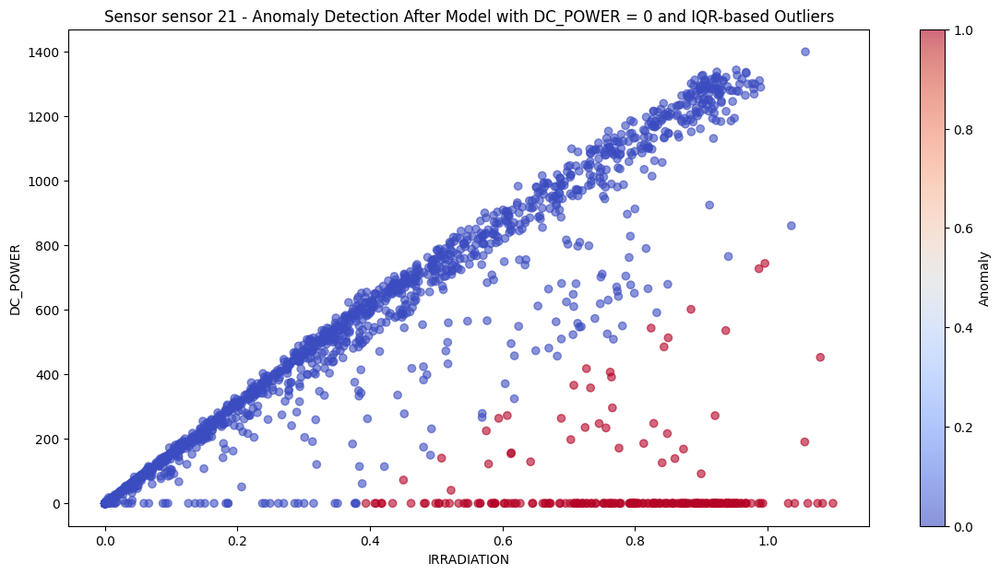

Sensor sensor 21 - Anomalies detected: 227
        IRRADIATION    DC_POWER    Residuals
78119      0.775781  170.913333  -856.183811
81465      0.828202  247.671429  -846.095732
83139      0.713910    0.000000  -948.410090
83157      0.760793    0.000000 -1008.036186
83175      0.802964    0.000000 -1061.669205
...             ...         ...          ...
126809     0.613296  156.566667  -663.880948
126853     0.794066    0.000000 -1050.352050
126875     0.503415    0.000000  -680.700565
133541     0.562944    0.000000  -756.410856
135587     0.578941  121.933333  -654.822413

[227 rows x 3 columns]


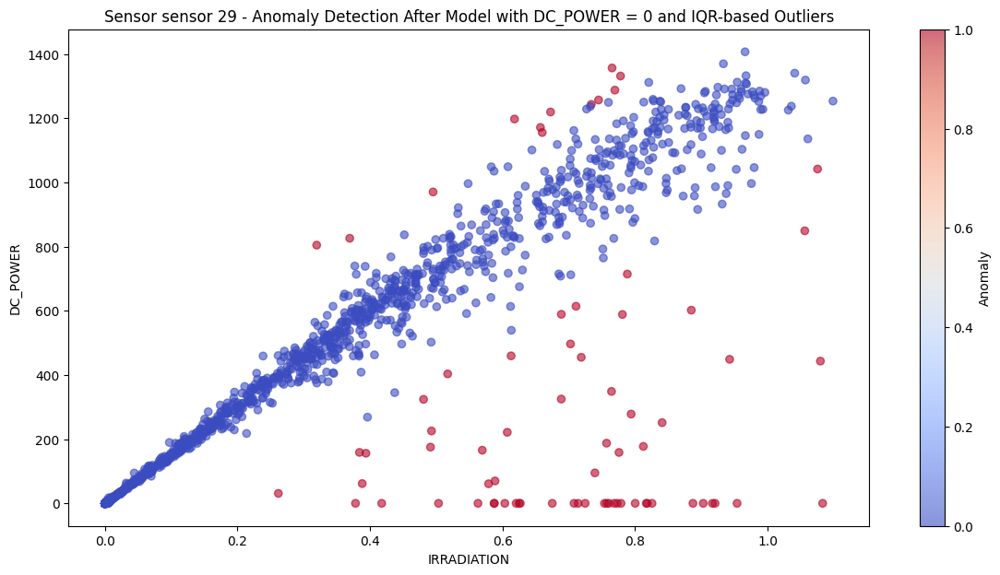

Sensor sensor 29 - Anomalies detected: 74
        IRRADIATION     DC_POWER   Residuals
74182      0.688748   589.180000 -315.801511
78120      0.775781   158.571429 -852.995100
99618      0.319459   804.760000  352.030242
101488     0.788344   714.553333 -312.399408
101686     1.079779   443.313333 -940.546270
...             ...          ...         ...
135610     0.480736   324.066667 -326.171756
76228      0.744953  1257.080000  283.266309
78362      0.769576  1287.873333  283.905901
110156     0.765351  1356.886667  358.093418
112092     0.778104  1331.673333  317.261130

[74 rows x 3 columns]


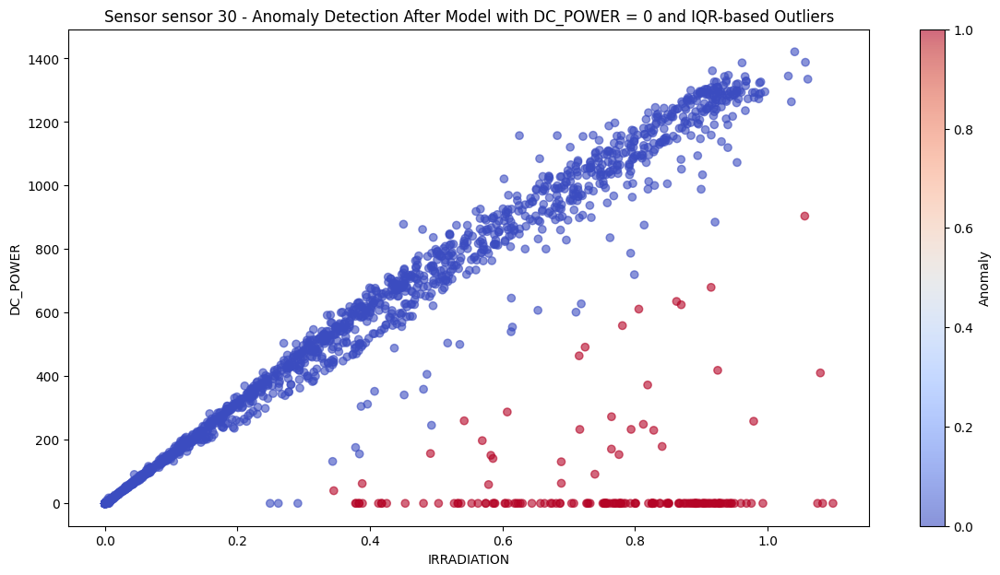

Sensor sensor 30 - Anomalies detected: 163
        IRRADIATION    DC_POWER    Residuals
69915      0.979090  258.386667 -1066.011319
69937      0.926438    0.000000 -1255.809364
69959      0.904247    0.000000 -1226.901222
69981      0.895474    0.000000 -1215.472989
70003      0.866027    0.000000 -1177.113371
...             ...         ...          ...
131299     0.425117    0.000000  -602.751303
131387     0.704287    0.000000  -966.419267
131409     0.345276   39.753333  -458.991874
133543     0.562944    0.000000  -782.295754
135589     0.578941   59.040000  -744.094429

[163 rows x 3 columns]


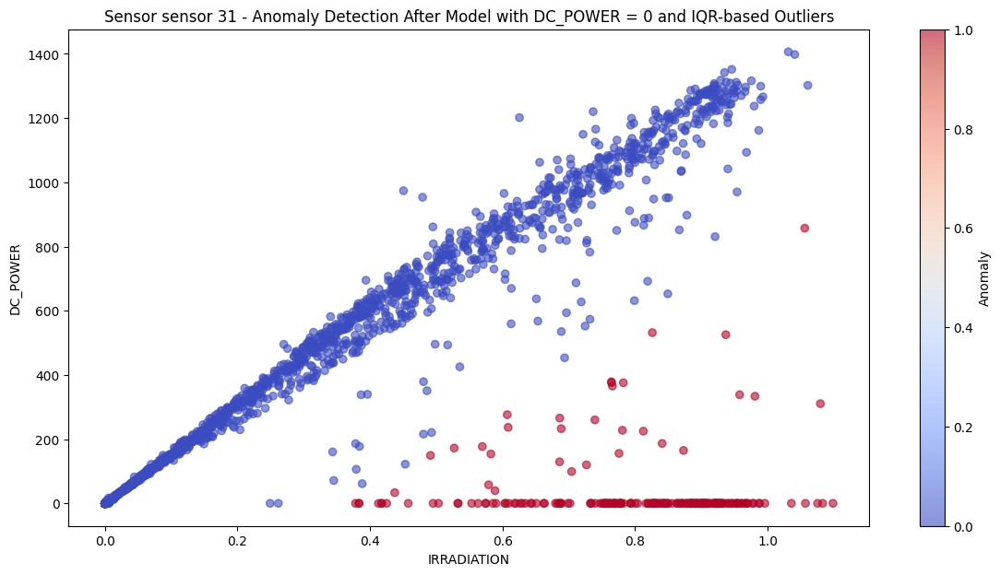

Sensor sensor 31 - Anomalies detected: 207
        IRRADIATION    DC_POWER    Residuals
69762      0.957900  338.226667  -917.566703
69784      0.970448    0.000000 -1271.566346
69806      0.987932    0.000000 -1293.544864
69828      0.953345    0.000000 -1250.066785
69850      0.946920    0.000000 -1241.991113
...             ...         ...          ...
131278     0.383334    0.000000  -533.537208
131300     0.425117    0.000000  -586.060040
131388     0.704287   99.013333  -837.976961
133544     0.562944    0.000000  -759.315828
135590     0.578941   57.733333  -721.691282

[207 rows x 3 columns]


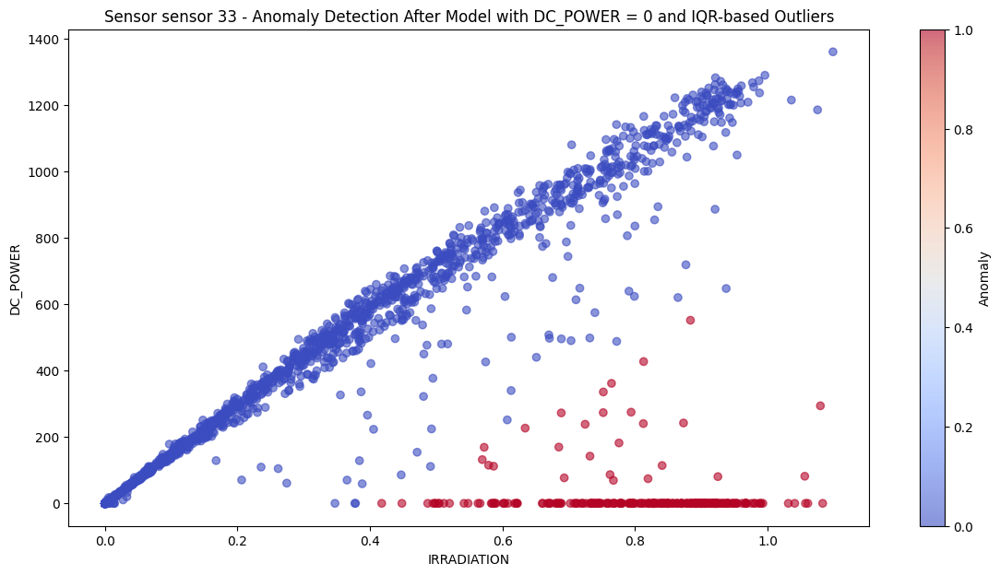

Sensor sensor 33 - Anomalies detected: 262
        IRRADIATION    DC_POWER    Residuals
71765      0.821055    0.000000 -1029.242792
71787      0.850826    0.000000 -1064.496979
71809      0.894438    0.000000 -1116.139932
71831      0.884239    0.000000 -1104.063274
71853      0.919857    0.000000 -1146.239946
...             ...         ...          ...
122765     0.620565    0.000000  -791.830956
126857     0.794066  274.506667  -722.776565
126879     0.503415    0.000000  -653.106349
133545     0.562944    0.000000  -723.599051
135591     0.578941  114.793333  -627.748536

[262 rows x 3 columns]


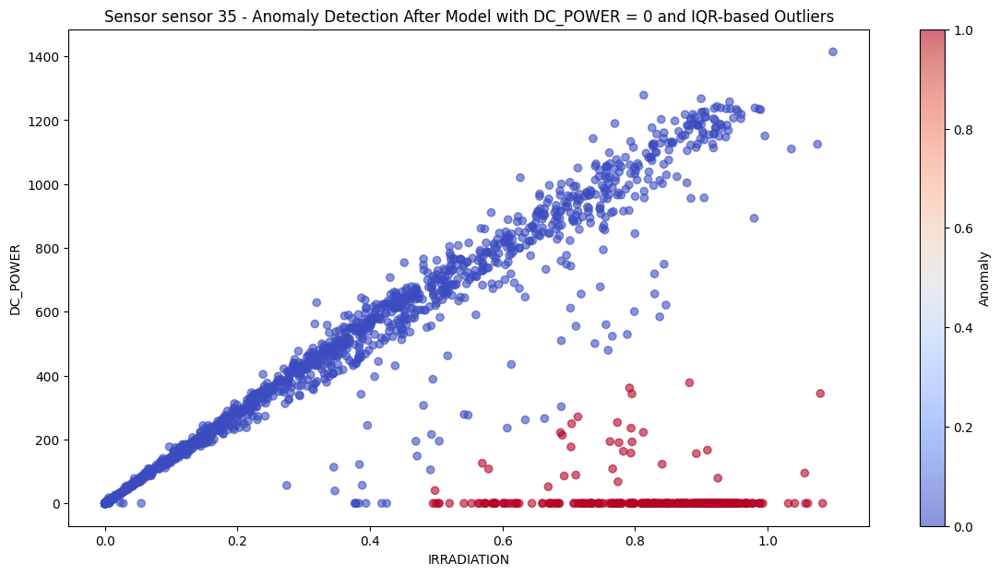

Sensor sensor 35 - Anomalies detected: 290
        IRRADIATION    DC_POWER    Residuals
69698      0.874834    0.000000 -1002.984550
69720      0.908056    0.000000 -1038.412053
69742      0.943353    0.000000 -1076.051666
69764      0.957900    0.000000 -1091.564715
69786      0.970448    0.000000 -1104.945272
...             ...         ...          ...
131236     0.820264    0.000000  -944.792452
131258     0.553322    0.000000  -660.131078
131390     0.704287  249.233333  -571.883817
133546     0.562944    0.000000  -670.392047
135592     0.578941  107.740000  -579.710767

[290 rows x 3 columns]


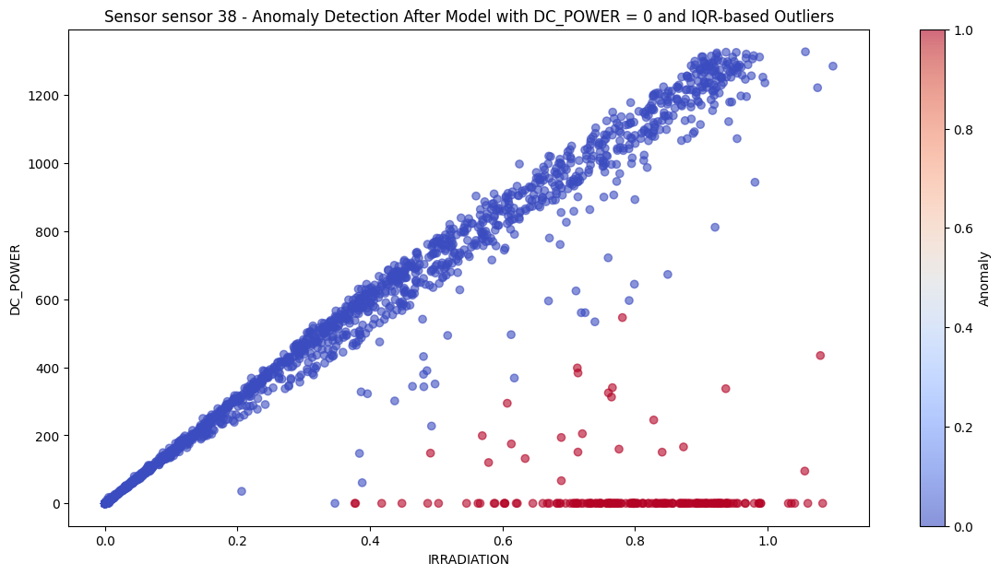

Sensor sensor 38 - Anomalies detected: 188
        IRRADIATION    DC_POWER    Residuals
71921      0.989619    0.000000 -1314.841537
71943      0.979794    0.000000 -1302.238475
71965      0.603740    0.000000  -819.847588
71987      0.731962    0.000000  -984.327466
72009      0.487049    0.000000  -670.160449
...             ...         ...          ...
126815     0.613296  174.646667  -657.459067
126859     0.794066    0.000000 -1063.991721
126881     0.503415    0.000000  -691.154201
133547     0.562944    0.000000  -767.517041
135593     0.578941  119.960000  -668.077284

[188 rows x 3 columns]


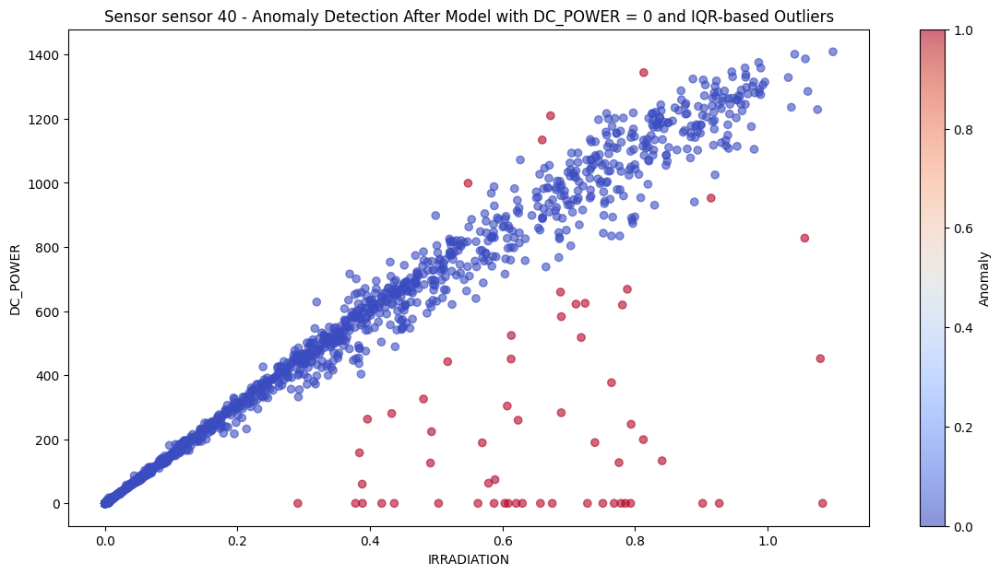

Sensor sensor 40 - Anomalies detected: 59
        IRRADIATION     DC_POWER    Residuals
74188      0.688748   582.540000  -337.533721
78126      0.775781   127.014286  -903.222356
101494     0.788344   668.040000  -378.099347
101692     1.079779   451.553333  -963.473715
103716     0.688645   282.653333  -637.289872
103804     0.687474   659.160000  -259.301568
103826     1.083227     0.000000 -1419.391260
103848     1.056204   827.400000  -557.786528
104156     0.378067     0.000000  -526.824090
104178     0.417623     0.000000  -576.892171
105784     0.840877   132.726667  -979.906889
105806     0.612939   450.340000  -373.777713
112428     0.603447     0.000000  -812.102290
112450     0.780935   619.046667  -417.714179
112472     0.718780   517.533333  -440.553162
114078     0.710892   621.600000  -326.502909
114100     0.812559   198.833333  -877.956198
114606     0.588650    73.926667  -719.446132
114628     0.569397   189.033333  -579.969617
116256     0.659905  1133.866667   250

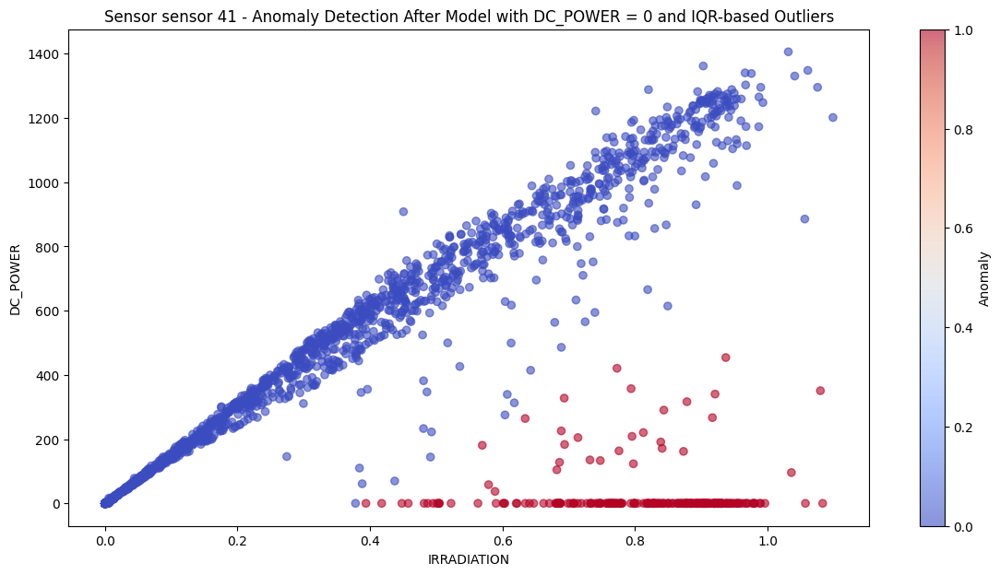

Sensor sensor 41 - Anomalies detected: 231
        IRRADIATION    DC_POWER    Residuals
69657      0.799746    0.000000 -1015.281133
69679      0.828096    0.000000 -1049.165344
69701      0.874834    0.000000 -1105.027088
69723      0.908056    0.000000 -1144.734709
69745      0.943353    0.000000 -1186.921693
...             ...         ...          ...
122769     0.620565    0.000000  -801.121772
126861     0.794066  357.166667  -651.325204
126883     0.503415    0.000000  -661.102221
133549     0.562944    0.000000  -732.252947
135595     0.578941   58.086667  -693.285923

[231 rows x 3 columns]
  LOCATION  DATE_TIME  SENSOR_ID  DC_POWER  AC_POWER  DAILY_YIELD  \
0        A 2020-05-15   sensor 1       0.0       0.0          0.0   
1        A 2020-05-15   sensor 2       0.0       0.0          0.0   
2        A 2020-05-15   sensor 3       0.0       0.0          0.0   
3        A 2020-05-15   sensor 5       0.0       0.0          0.0   
4        A 2020-05-15  sensor 12       0.0      

In [ ]:
from sklearn.linear_model import HuberRegressor
from sklearn.model_selection import GridSearchCV

irridiation_vs_dc_pwer_model_dict = {}

# Parameter grid for tuning
param_grid = {
    'epsilon': [1.2, 1.35, 1.5, 2.0],
    'alpha': [0.0001, 0.001, 0.01, 0.1],
    'max_iter': [50, 100, 200]
}

# Function to calculate IQR and detect anomalies
def detect_anomalies_iqr(x):
    # Calculate IQR for DC_POWER
    Q1 = x['DC_POWER'].quantile(0.25)
    Q3 = x['DC_POWER'].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Detect outliers based on IQR
    outliers = x[(x['DC_POWER'] < lower_bound) | (x['DC_POWER'] > upper_bound)]

    # Return cleaned data and outliers
    x_cleaned = x[(x['DC_POWER'] >= lower_bound) & (x['DC_POWER'] <= upper_bound)]
    return x_cleaned, outliers

# Initialize the new columns with default values
merged_data['power_gen_anomaly'] = np.nan
merged_data['power_gen_anomaly_res'] = np.nan
merged_data['power_gen_anomaly_std_res'] = np.nan

for location in ['A', 'B']:
    Location_SENSORS = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
    irridiation_vs_dc_pwer_model_dict[location] = {}

    for sensor in Location_SENSORS:
        x = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor)]

        # Step 1: Train model with all data (including DC_POWER = 0)
        X_full = x[['IRRADIATION']].values
        y_full = x['DC_POWER'].values

        # Perform grid search for optimal hyperparameters
        huber = HuberRegressor()
        grid_search = GridSearchCV(estimator=huber, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
        grid_search.fit(X_full, y_full)
        best_params = grid_search.best_params_

        # Train the Huber regression model with the best parameters
        tuned_huber = HuberRegressor(epsilon=best_params['epsilon'],
                                    alpha=best_params['alpha'],
                                    max_iter=best_params['max_iter'])
        tuned_huber.fit(X_full, y_full)

        # Step 2: Use IQR-based outlier detection (without DC_POWER = 0 points)
        x_cleaned, outliers = detect_anomalies_iqr(x)

        # Step 3: Remove both DC_POWER = 0 points and IQR-based outliers
        x_without_zeros_and_outliers = x_cleaned[x_cleaned['DC_POWER'] != 0]

        # Train the model again on the cleaned data (no DC_POWER = 0 and no IQR outliers)
        X_cleaned = x_without_zeros_and_outliers[['IRRADIATION']].values
        y_cleaned = x_without_zeros_and_outliers['DC_POWER'].values
        tuned_huber.fit(X_cleaned, y_cleaned)

        # Step 4: Add back the removed `DC_POWER = 0` and IQR-based outliers
        x_restored = pd.concat([x_cleaned, outliers])

        # Step 5: Predict and detect anomalies (using residuals)
        y_pred_full = tuned_huber.predict(x_restored[['IRRADIATION']].values)
        residuals = x_restored['DC_POWER'] - y_pred_full
        std_residuals_full = np.std(residuals)
        threshold_full = 2 * std_residuals_full
        anomalies_full = np.abs(residuals) > threshold_full

        x_restored['Residuals'] = residuals
        x_restored['Anomaly'] = anomalies_full.astype(int)

        # Update the merged_data DataFrame
        indices = x_restored.index
        merged_data.loc[indices, 'power_gen_anomaly'] = x_restored['Anomaly']
        merged_data.loc[indices, 'power_gen_anomaly_res'] = x_restored['Residuals']
        merged_data.loc[indices, 'power_gen_anomaly_std_res'] = std_residuals_full

        # Plotting: Comparison of anomalies detected
        plt.figure(figsize=(14, 7))
        plt.scatter(x_restored['IRRADIATION'], x_restored['DC_POWER'], c=x_restored['Anomaly'], cmap='coolwarm', label='Anomalies', alpha=0.6)
        plt.title(f'Sensor {sensor} - Anomaly Detection After Model with DC_POWER = 0 and IQR-based Outliers')
        plt.xlabel('IRRADIATION')
        plt.ylabel('DC_POWER')
        plt.colorbar(label='Anomaly')
        plt.show()

        # Output anomalies detected
        print(f"Sensor {sensor} - Anomalies detected: {x_restored['Anomaly'].sum()}")
        print(x_restored[x_restored['Anomaly'] == 1][['IRRADIATION', 'DC_POWER', 'Residuals']])

        irridiation_vs_dc_pwer_model_dict[location][sensor] = {
            'intercept': tuned_huber.intercept_,
            'slope': tuned_huber.coef_,
            'std_residuals': std_residuals_full
        }

# Check updated merged_data
print(merged_data.head())


In [ ]:
merged_data.isna().sum()

,0
LOCATION,0
DATE_TIME,0
SENSOR_ID,0
DC_POWER,0
AC_POWER,0
DAILY_YIELD,0
TOTAL_YIELD,0
AMBIENT_TEMPERATURE,0
MODULE_TEMPERATURE,0
IRRADIATION,0


## AC_POWER vs. YIELD Model

### Using Linear Regression

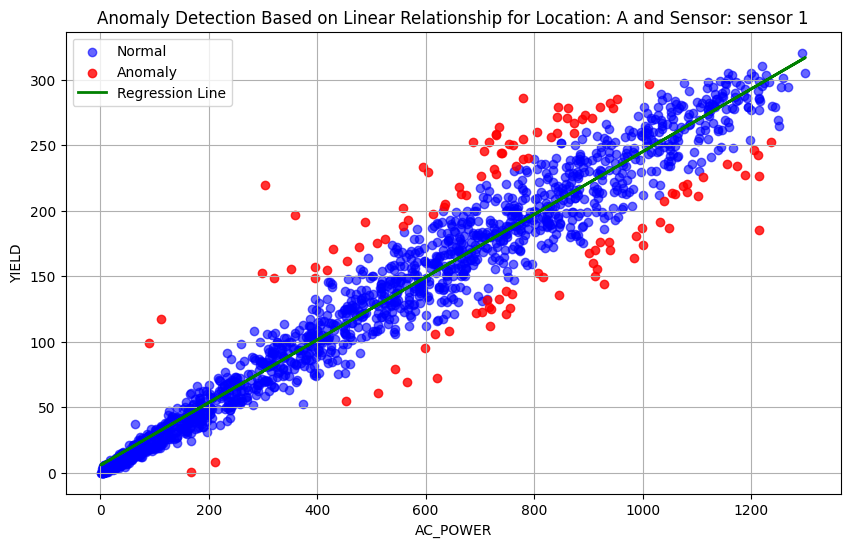

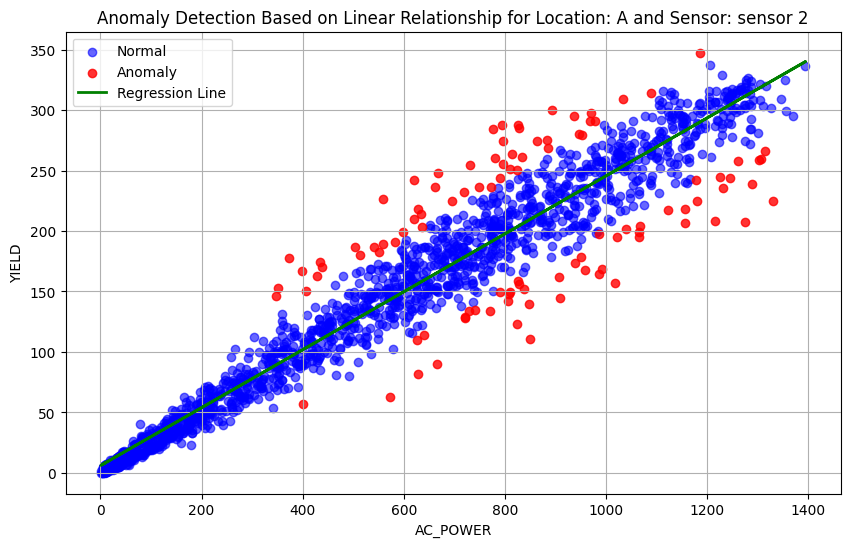

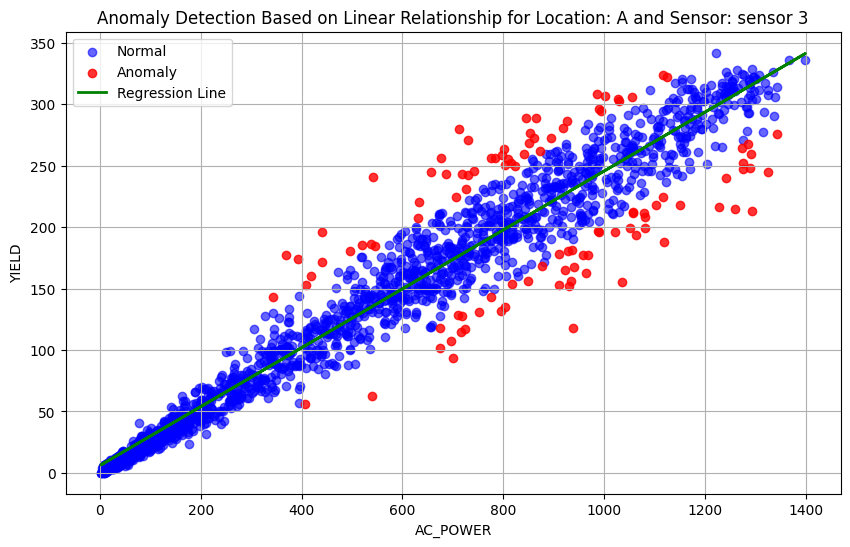

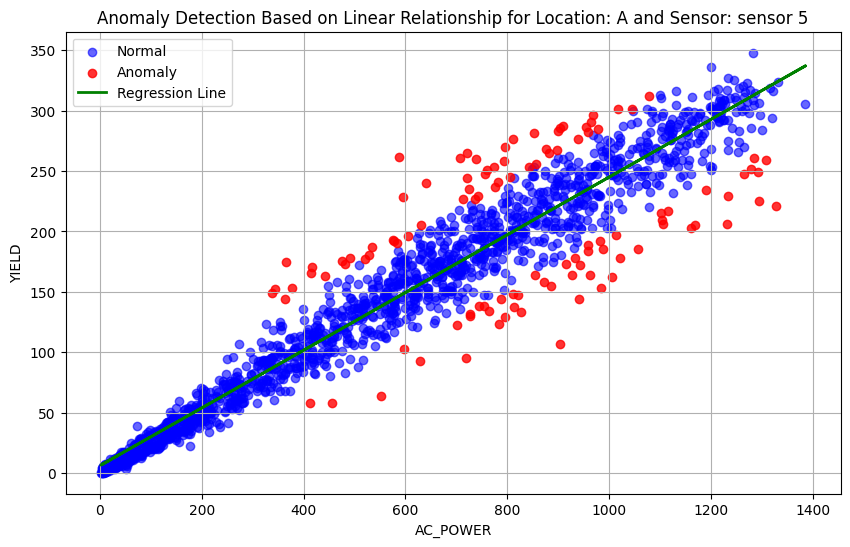

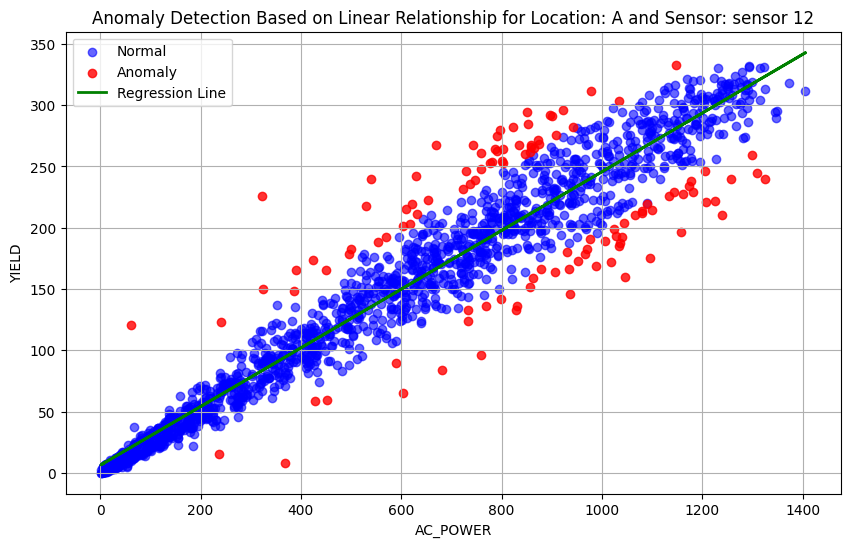

...

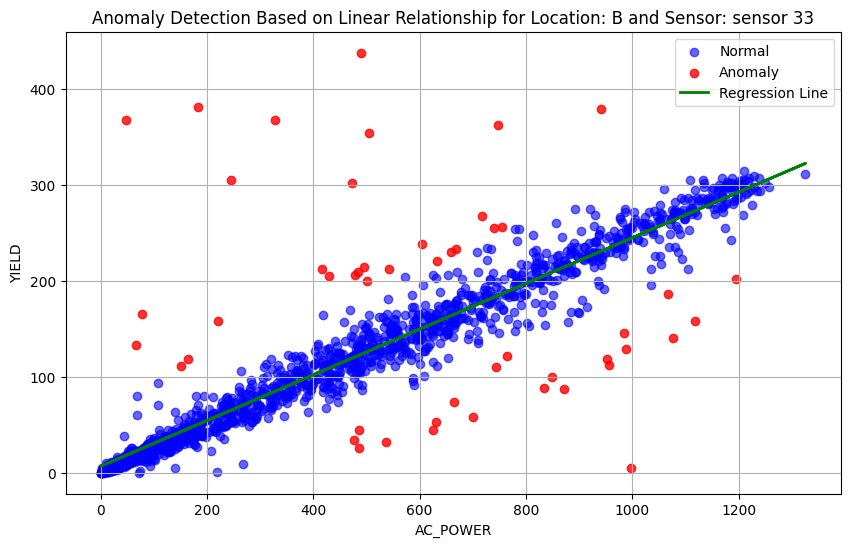

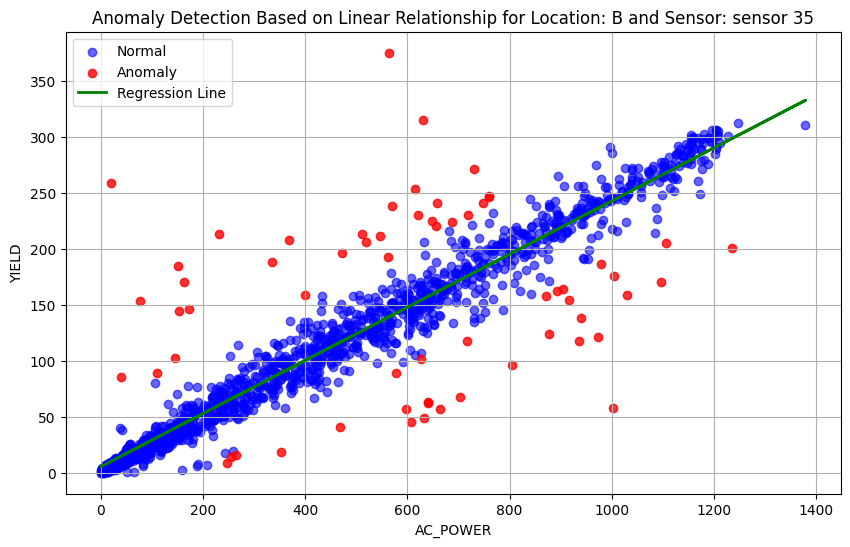

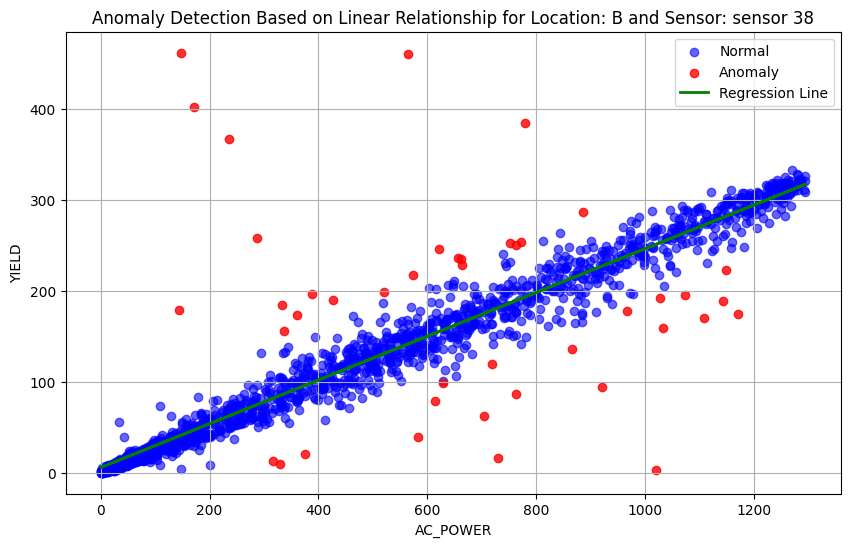

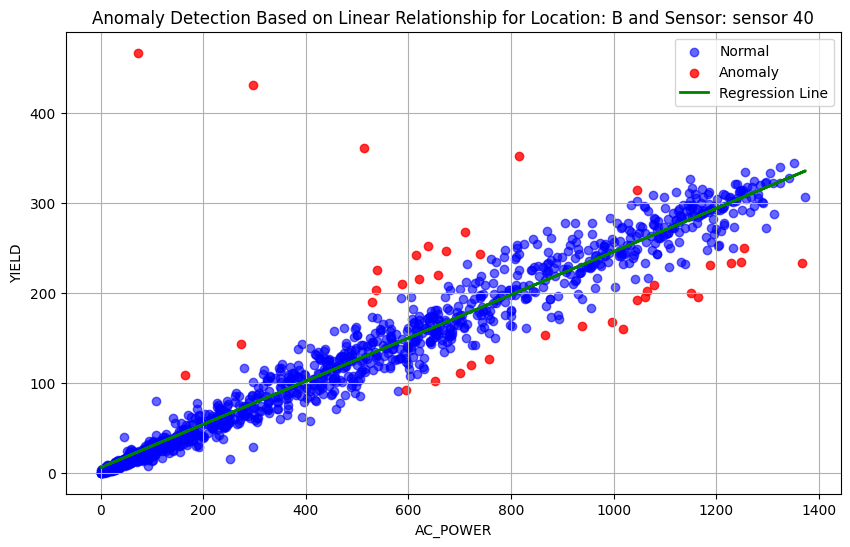

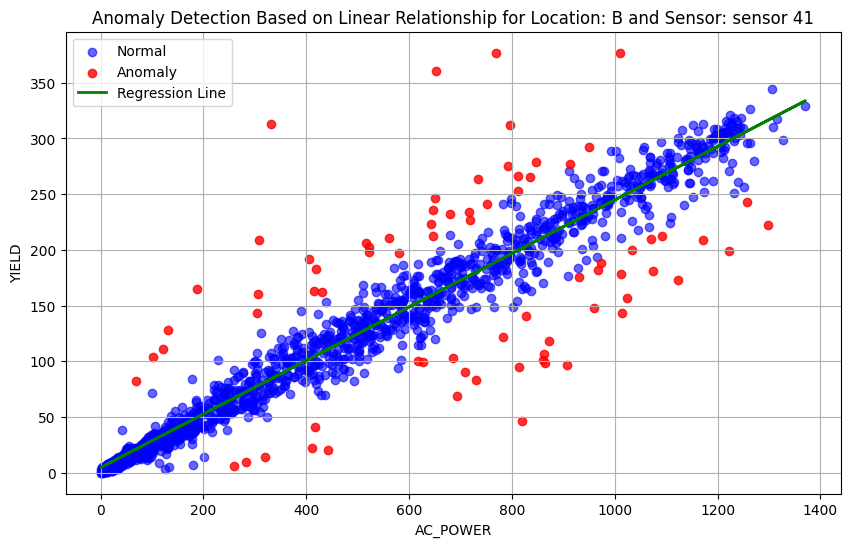

In [ ]:
def remove_outliers_using_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    filtered_df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return filtered_df

ac_power_to_yield_models_dict_linear_regression = {}

for location in ['A', 'B']:
    sensor_IDs = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
    ac_power_to_yield_models_dict_linear_regression[location] = {}
    for sensor_ID in sensor_IDs:
        data = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor_ID)]

        unique_dates = data['DATE'].unique()
        yield_data = None
        for date in unique_dates:
            x = data[data['DATE'] == date]
            x['DAILY_YIELD'] = x['DAILY_YIELD'].shift(-1).fillna(0)
            x['YIELD'] = x['DAILY_YIELD'].diff()
            x.loc[x['YIELD'] < 0, 'YIELD'] = 0

            if yield_data is None:
                yield_data = x
            else:
                yield_data = pd.concat([yield_data, x])

        # sns.scatterplot(x="AC_POWER", y="YIELD",data=yield_data)

        yield_data.dropna(inplace=True)

        yield_data = yield_data[yield_data['AC_POWER'] != 0]
        yield_data = yield_data[yield_data['YIELD'] != 0]
        yield_data = remove_outliers_using_iqr(yield_data, 'AC_POWER')
        yield_data = remove_outliers_using_iqr(yield_data, 'YIELD')

        X = yield_data['AC_POWER'].to_frame()
        y = yield_data['YIELD'].to_frame()

        model = LinearRegression()
        model.fit(X, y)

        y_pred = model.predict(X)

        yield_data['Residuals'] = y - y_pred

        std_residuals = np.std(yield_data['Residuals'])
        threshold = 2 * std_residuals

        yield_data['Anomaly'] = (np.abs(yield_data['Residuals']) > threshold).astype(int)

        normal = yield_data[yield_data['Anomaly'] == 0]
        anomalous = yield_data[yield_data['Anomaly'] == 1]

        plt.figure(figsize=(10, 6))
        plt.scatter(normal['AC_POWER'], normal['YIELD'], color='blue', label='Normal', alpha=0.6)
        plt.scatter(anomalous['AC_POWER'], anomalous['YIELD'], color='red', label='Anomaly', alpha=0.8)

        plt.plot(X, y_pred, color='green', linewidth=2, label='Regression Line')

        plt.title(f'Anomaly Detection Based on Linear Relationship for Location: {location} and Sensor: {sensor_ID}')
        plt.xlabel('AC_POWER')
        plt.ylabel('YIELD')
        plt.legend()
        plt.grid(True)
        plt.show()

        ac_power_to_yield_models_dict_linear_regression[location][sensor_ID] = {
             'intercept': model.intercept_,
             'slope': model.coef_,
             'std_residuals': std_residuals
         }

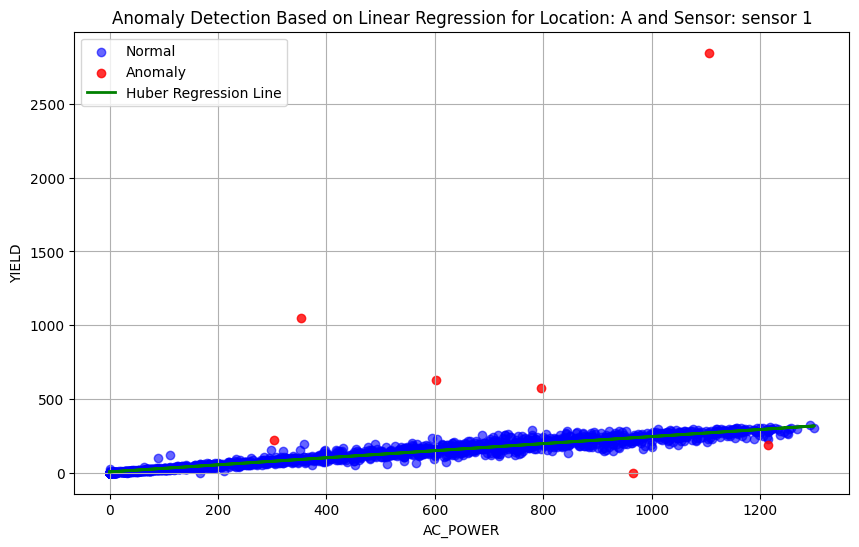

Location: A, Sensor ID: sensor 1
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



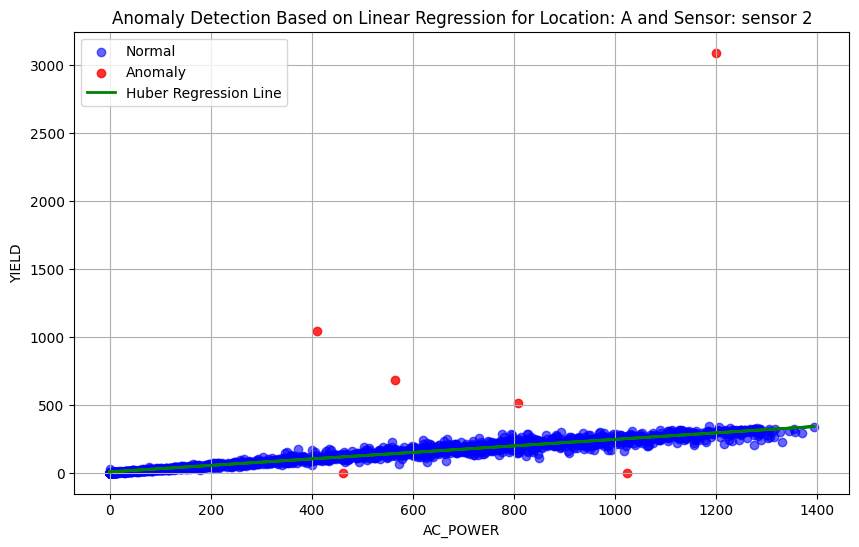

Location: A, Sensor ID: sensor 2
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



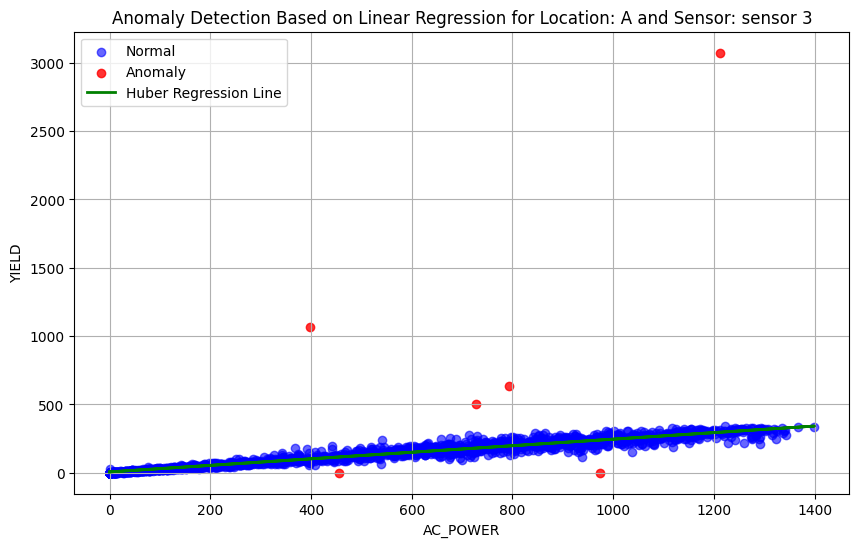

Location: A, Sensor ID: sensor 3
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



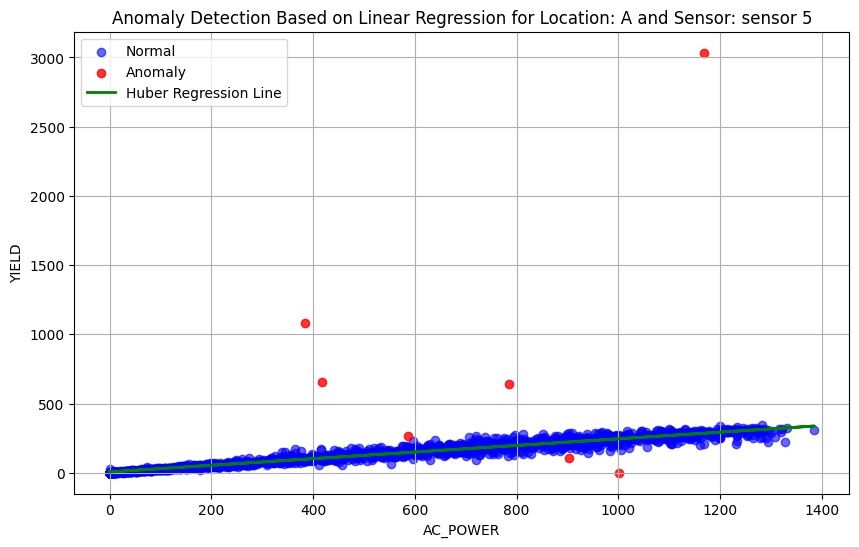

Location: A, Sensor ID: sensor 5
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



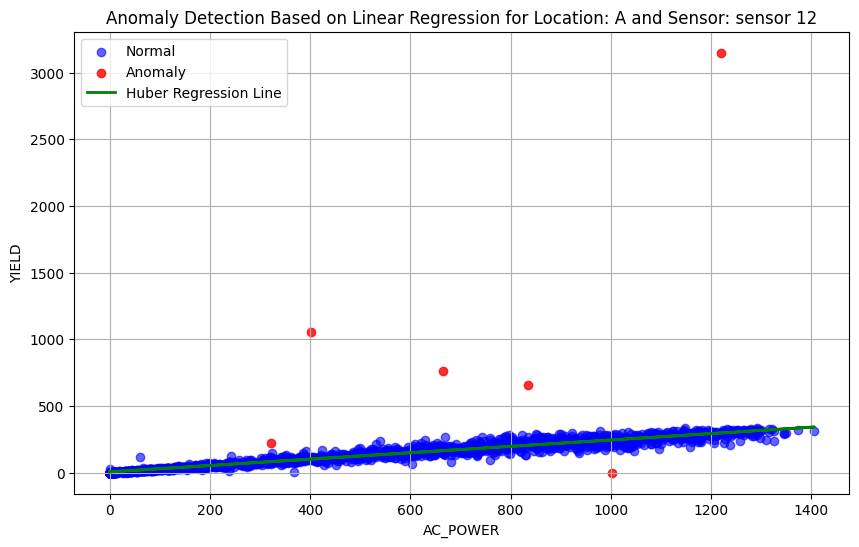

Location: A, Sensor ID: sensor 12
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



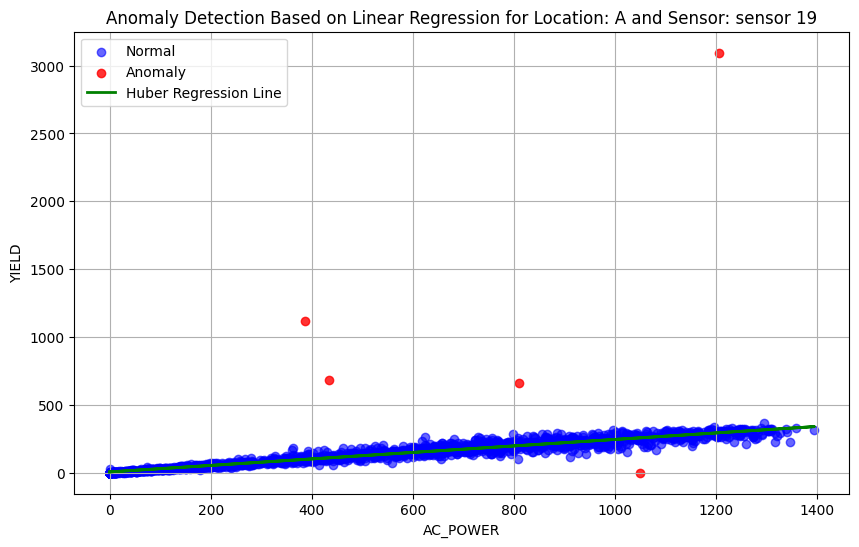

Location: A, Sensor ID: sensor 19
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



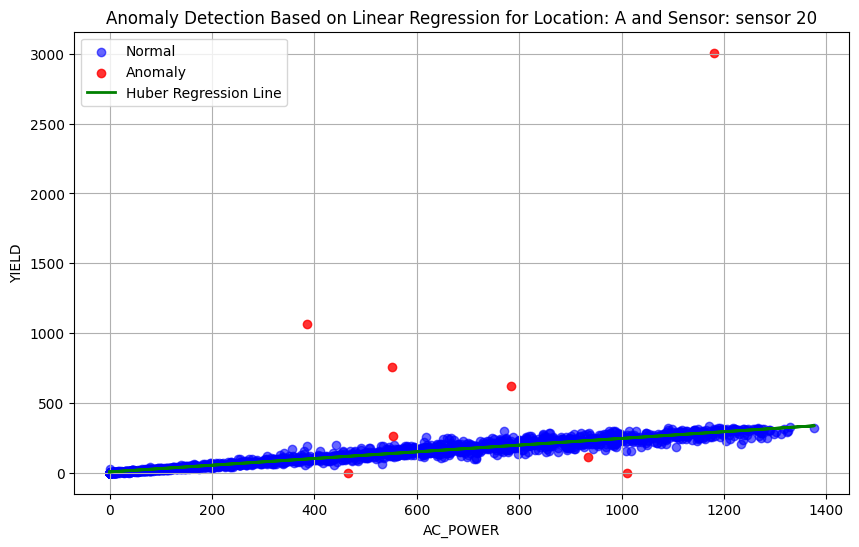

Location: A, Sensor ID: sensor 20
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



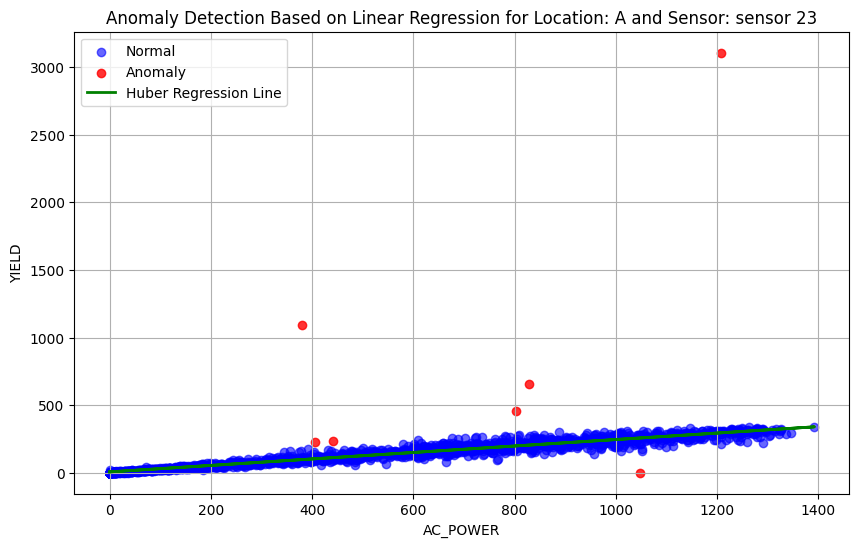

Location: A, Sensor ID: sensor 23
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



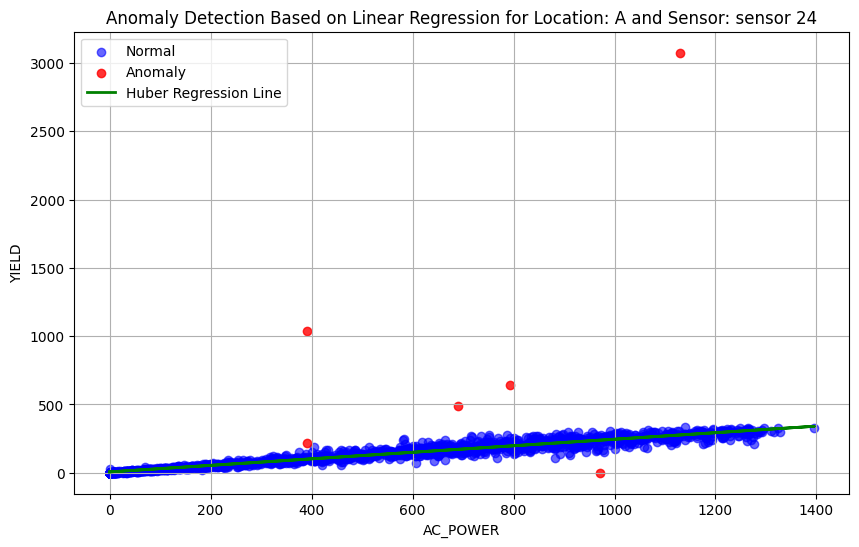

Location: A, Sensor ID: sensor 24
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



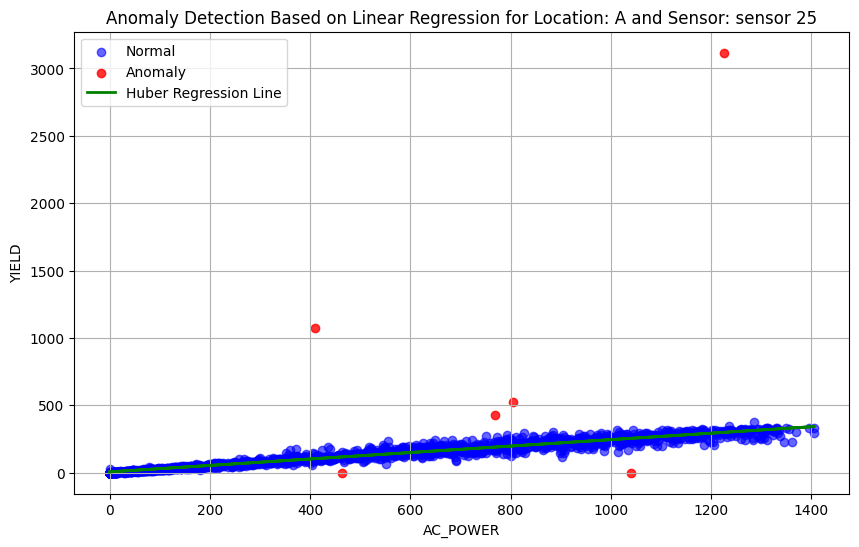

Location: A, Sensor ID: sensor 25
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



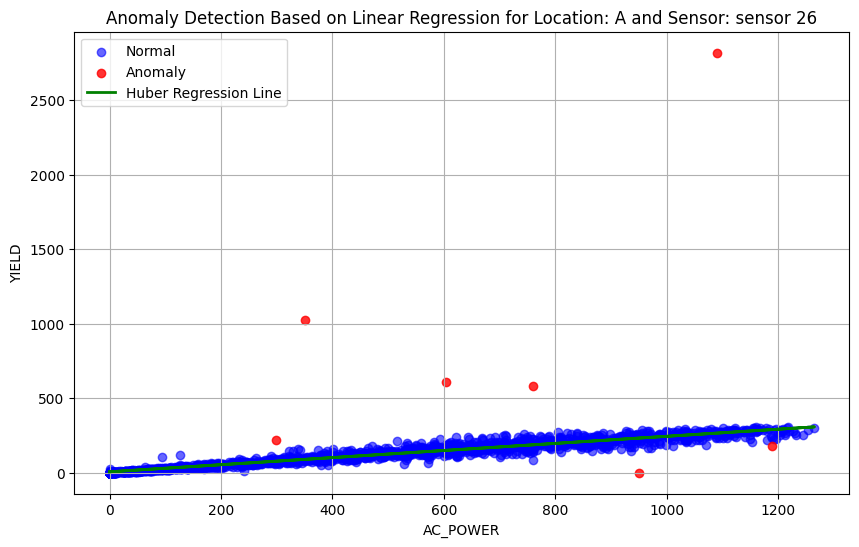

Location: A, Sensor ID: sensor 26
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



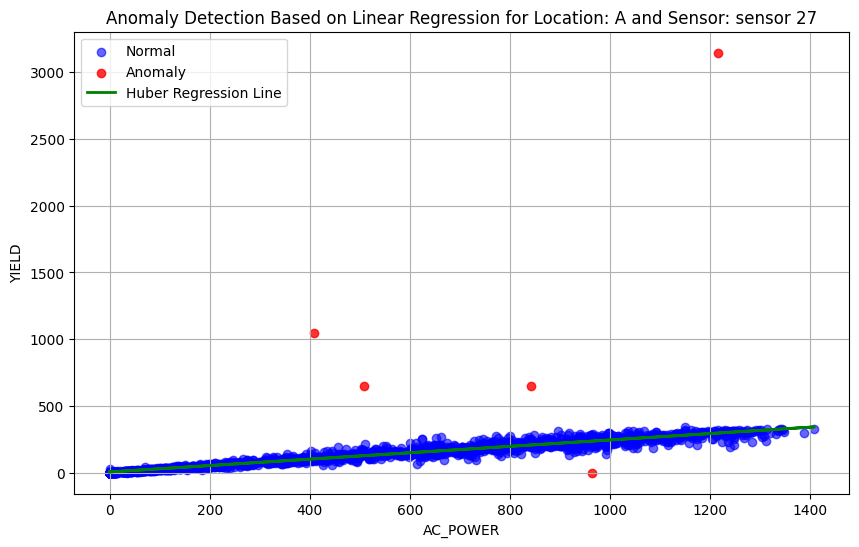

Location: A, Sensor ID: sensor 27
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



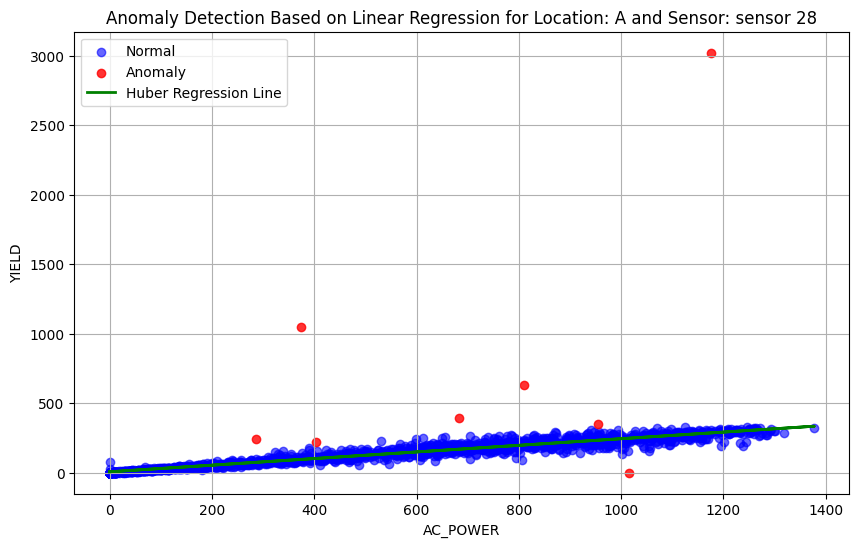

Location: A, Sensor ID: sensor 28
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



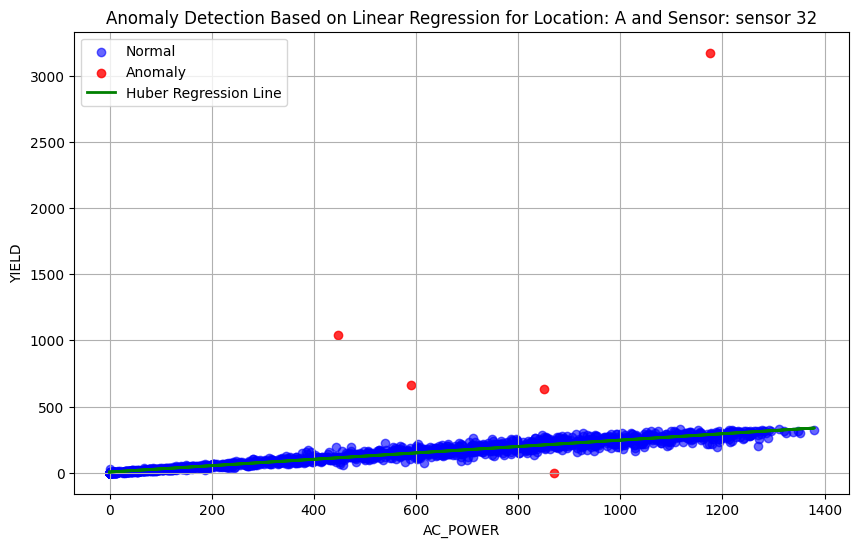

Location: A, Sensor ID: sensor 32
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



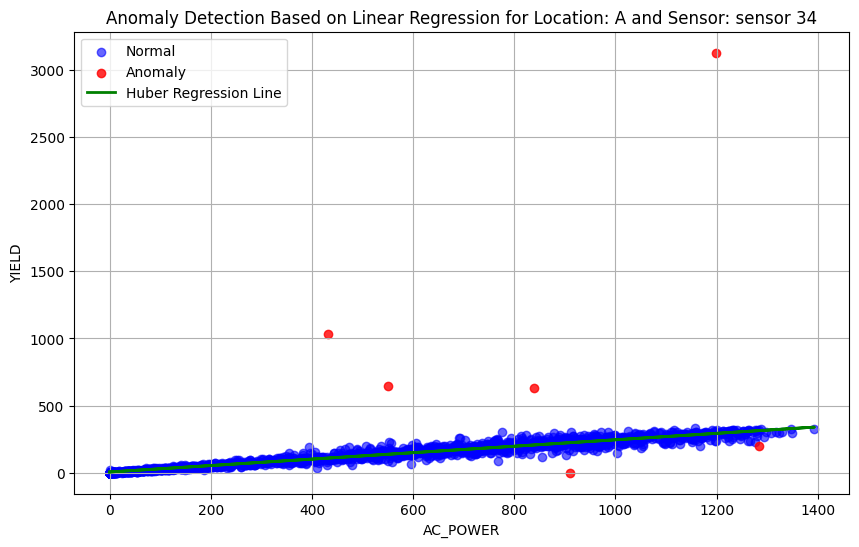

Location: A, Sensor ID: sensor 34
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



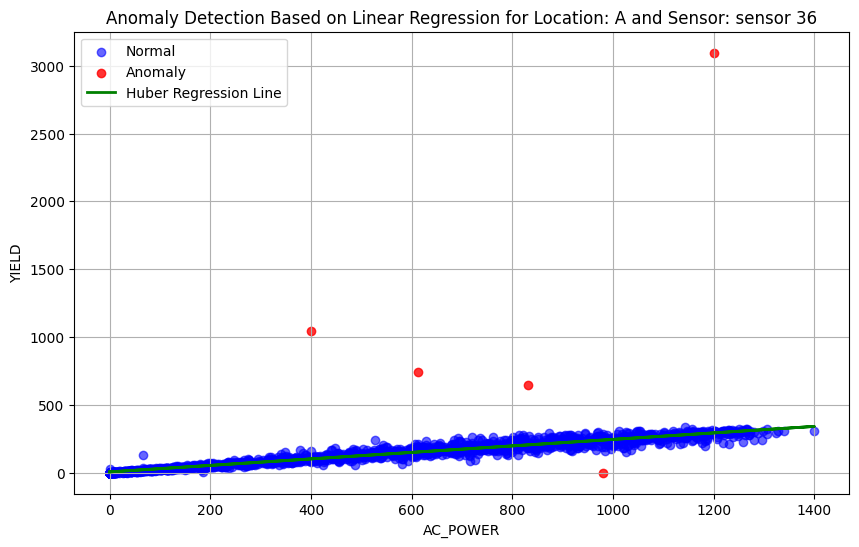

Location: A, Sensor ID: sensor 36
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



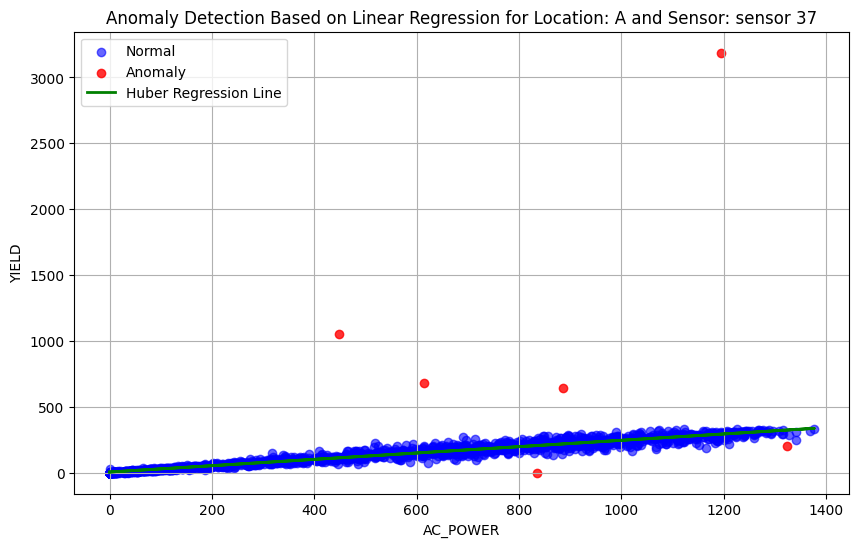

Location: A, Sensor ID: sensor 37
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



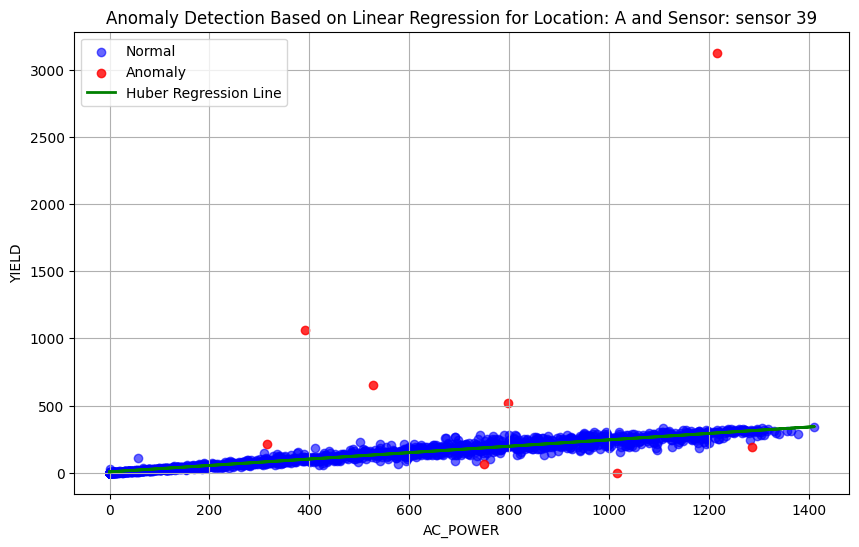

Location: A, Sensor ID: sensor 39
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



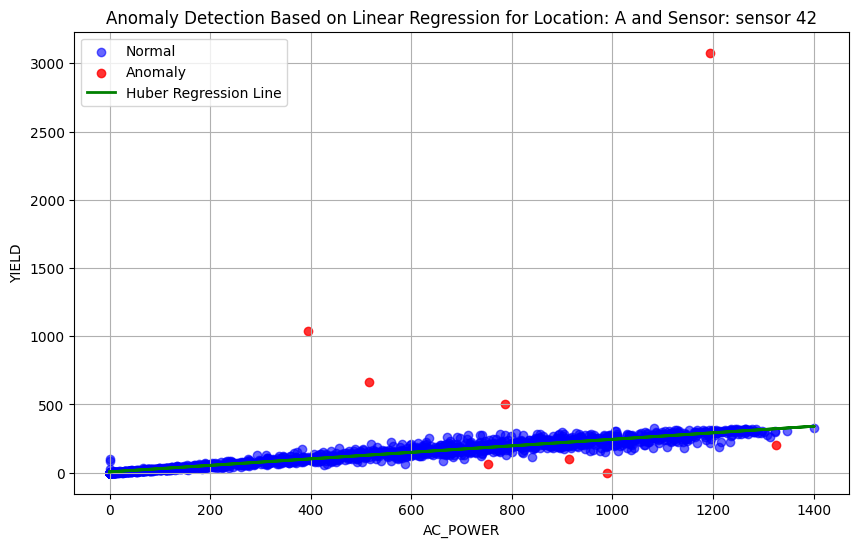

Location: A, Sensor ID: sensor 42
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



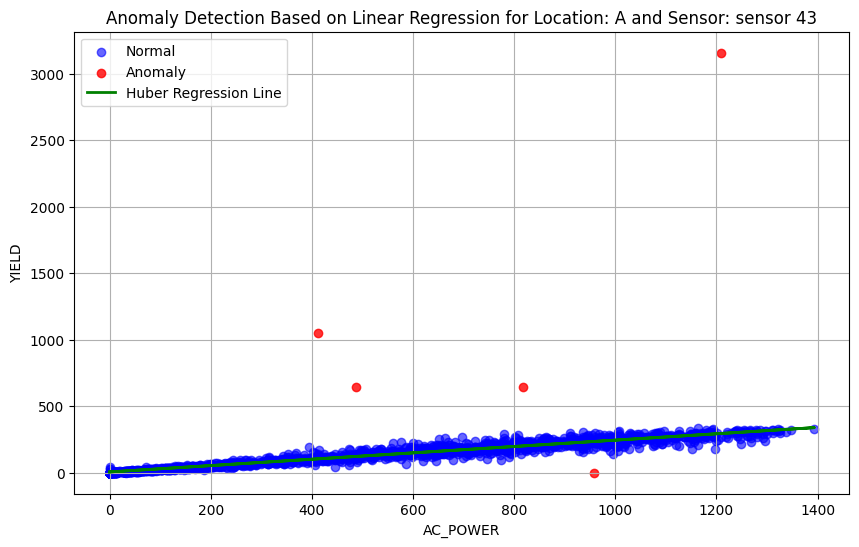

Location: A, Sensor ID: sensor 43
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



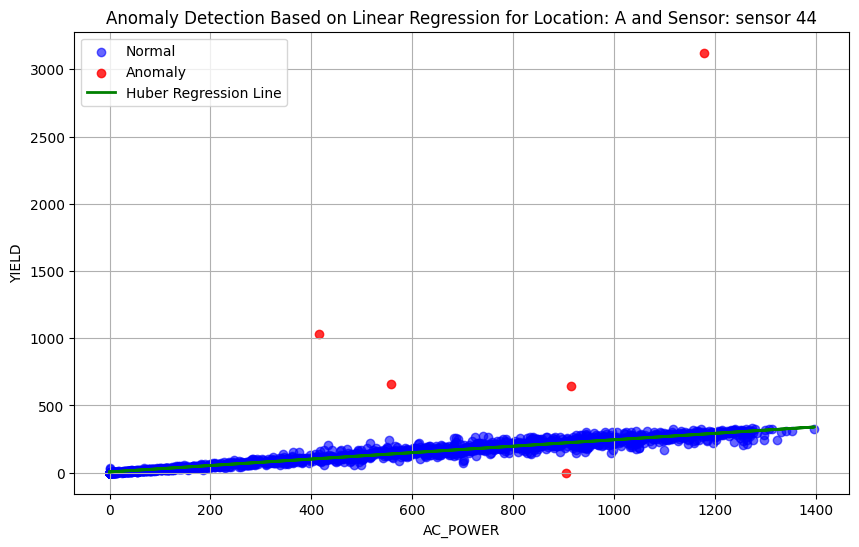

Location: A, Sensor ID: sensor 44
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



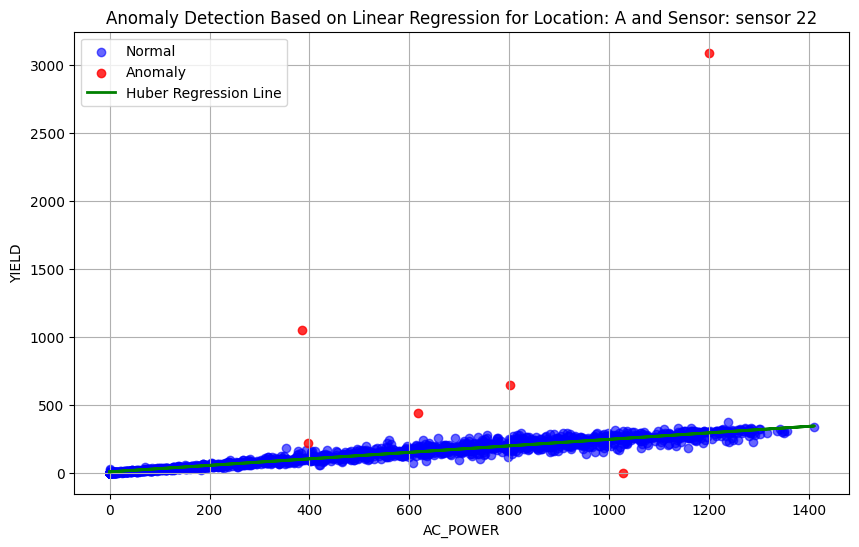

Location: A, Sensor ID: sensor 22
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



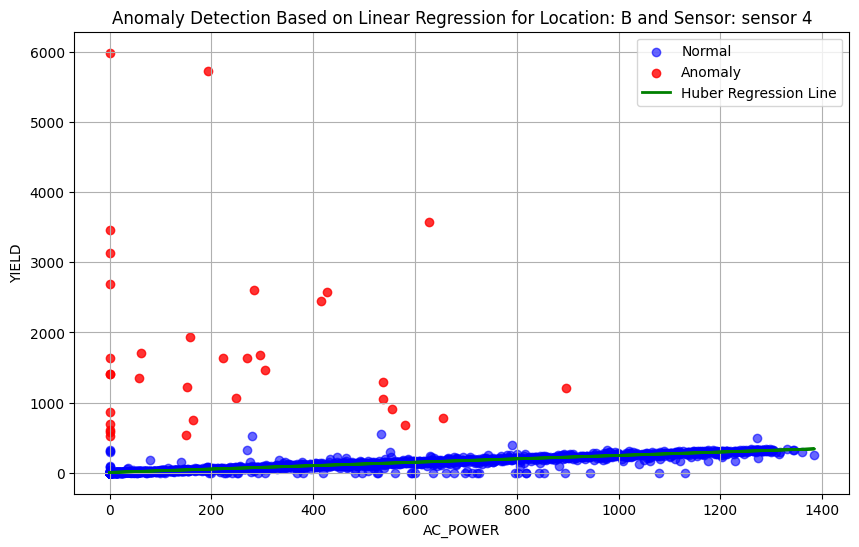

Location: B, Sensor ID: sensor 4
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



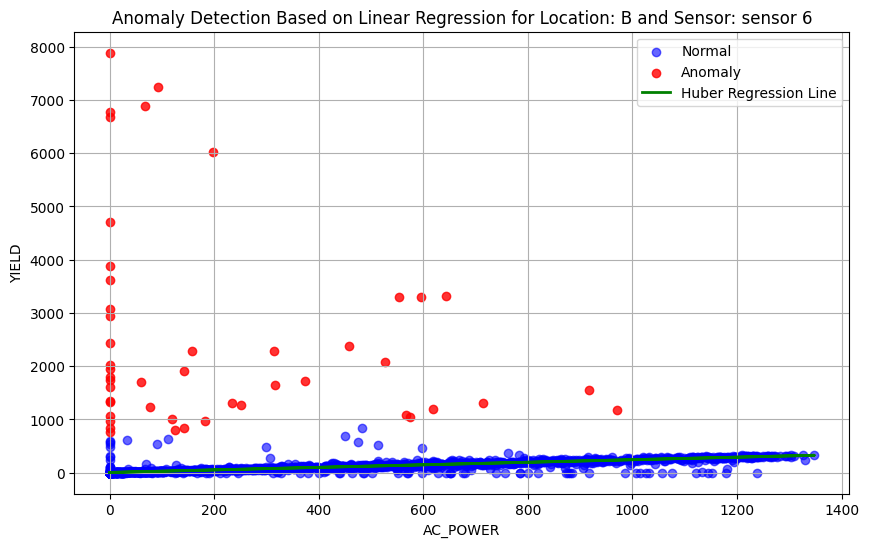

Location: B, Sensor ID: sensor 6
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



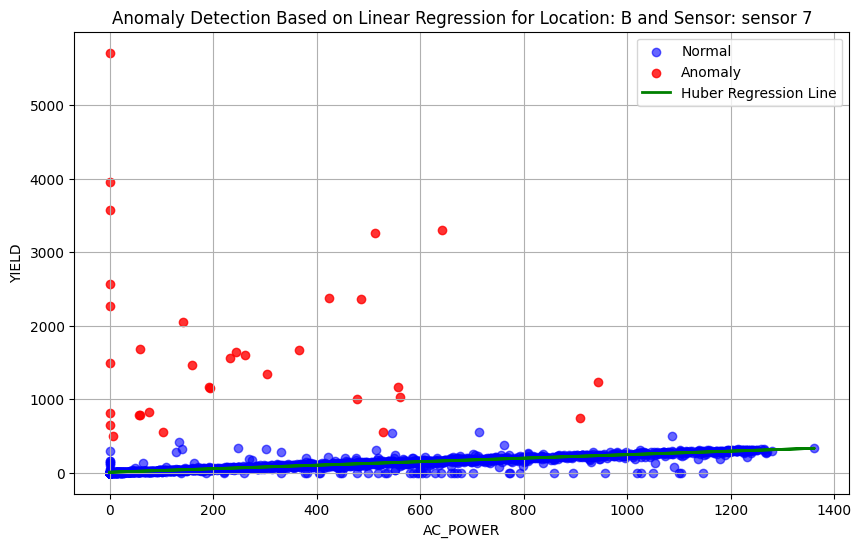

Location: B, Sensor ID: sensor 7
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



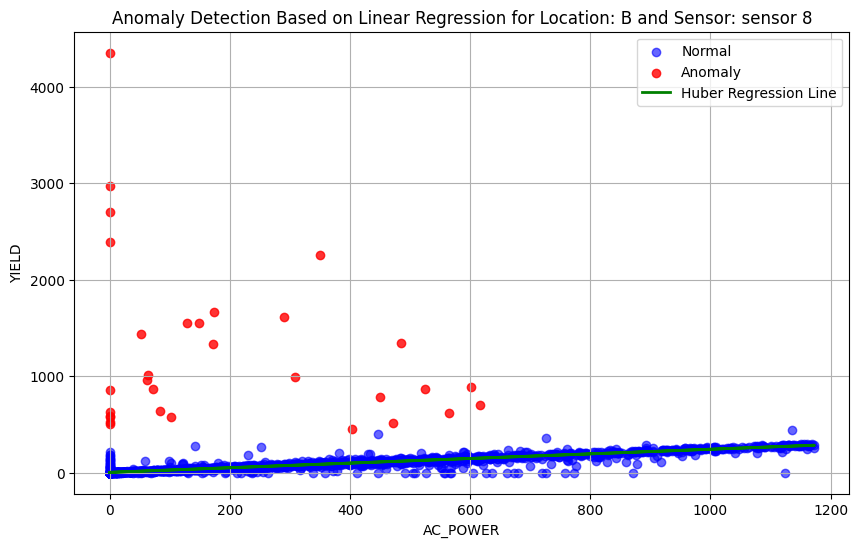

Location: B, Sensor ID: sensor 8
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



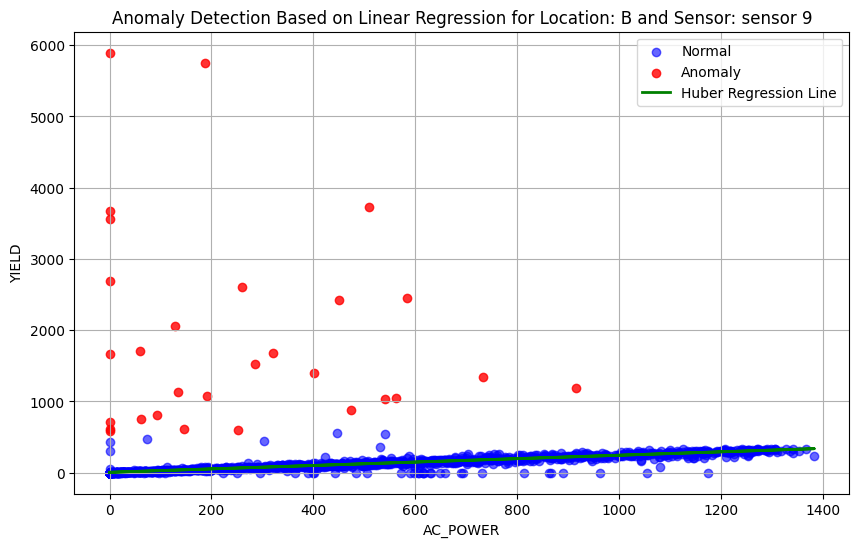

Location: B, Sensor ID: sensor 9
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



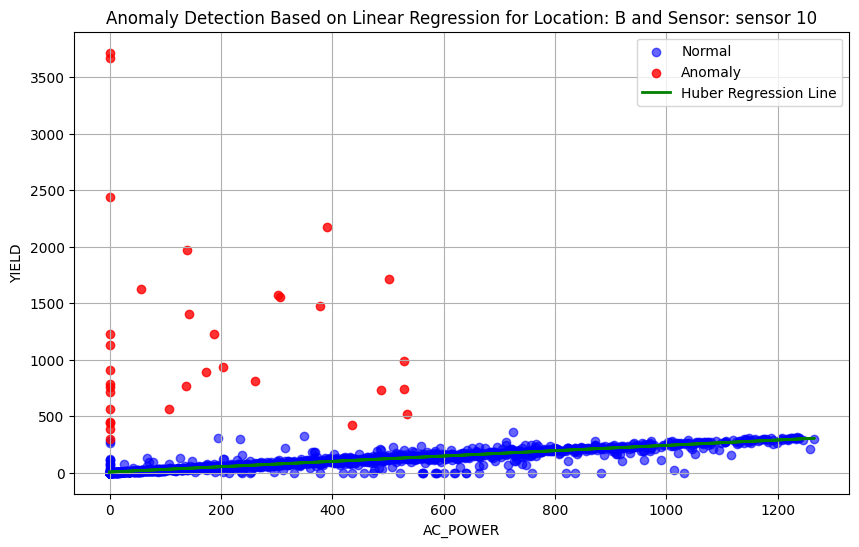

Location: B, Sensor ID: sensor 10
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



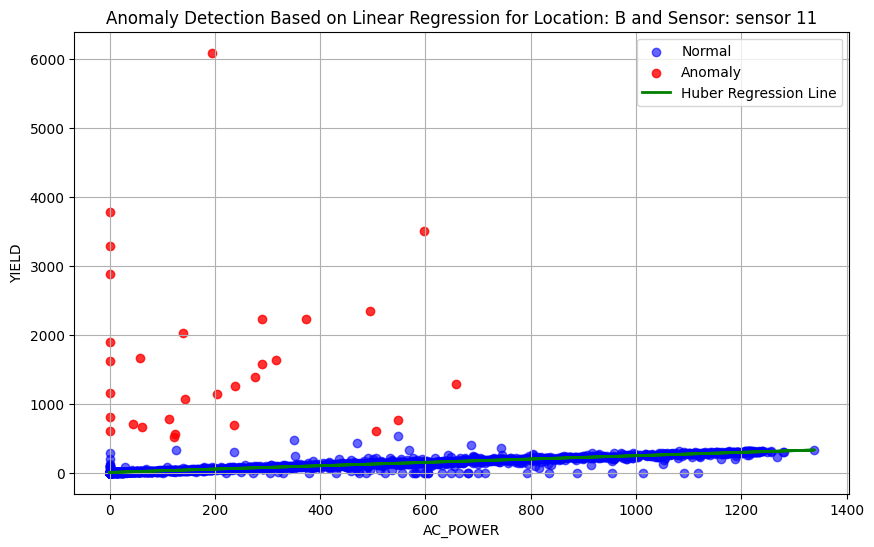

Location: B, Sensor ID: sensor 11
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



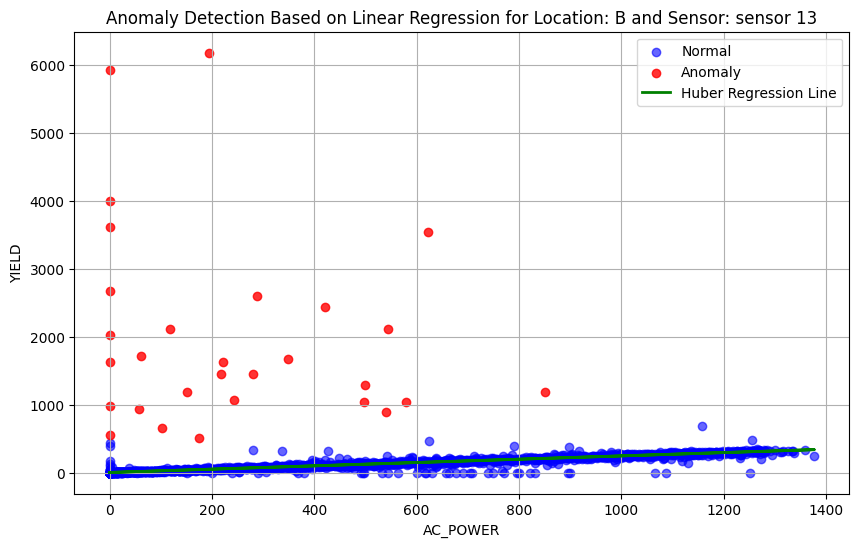

Location: B, Sensor ID: sensor 13
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



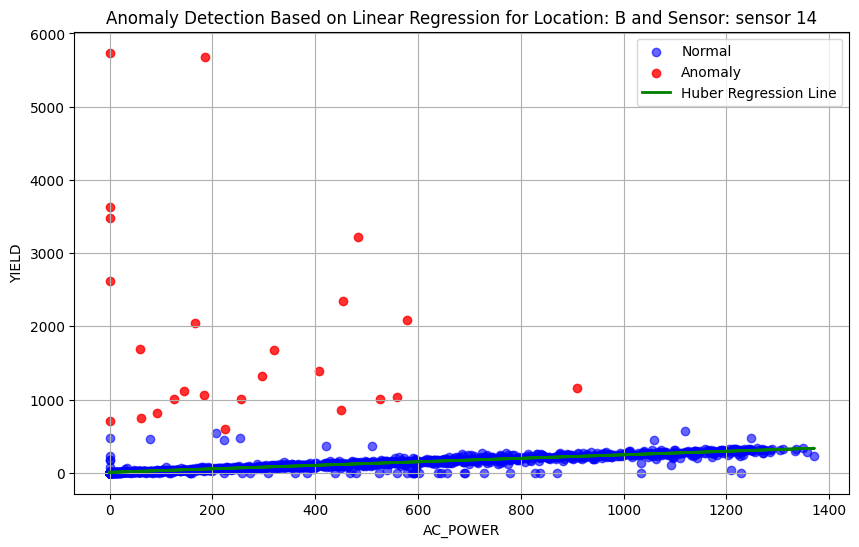

Location: B, Sensor ID: sensor 14
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



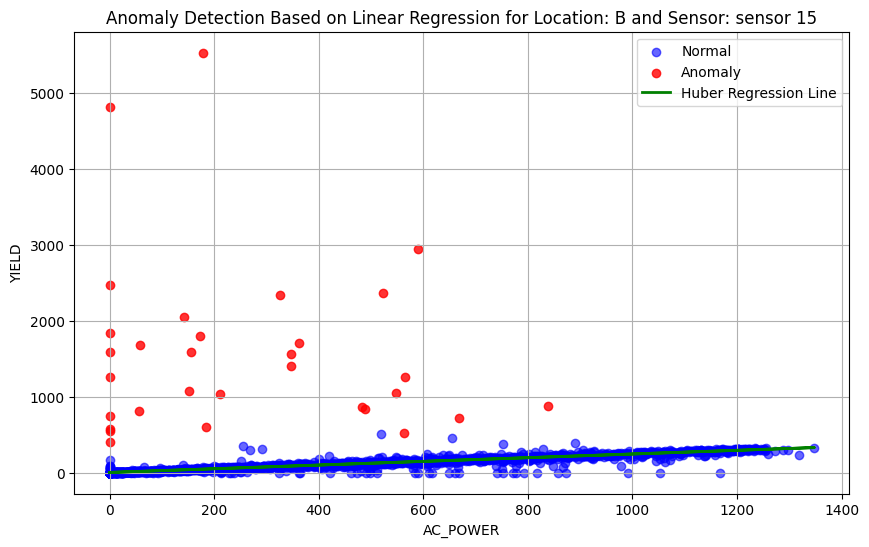

Location: B, Sensor ID: sensor 15
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



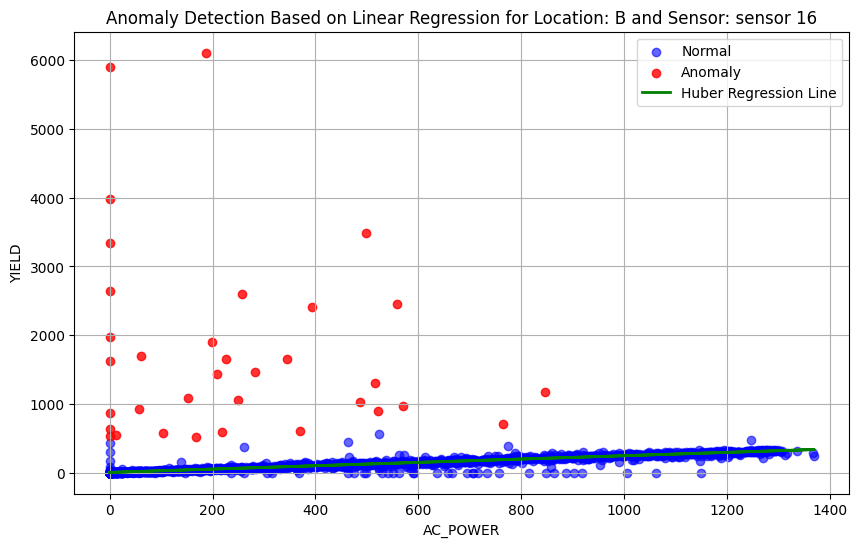

Location: B, Sensor ID: sensor 16
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



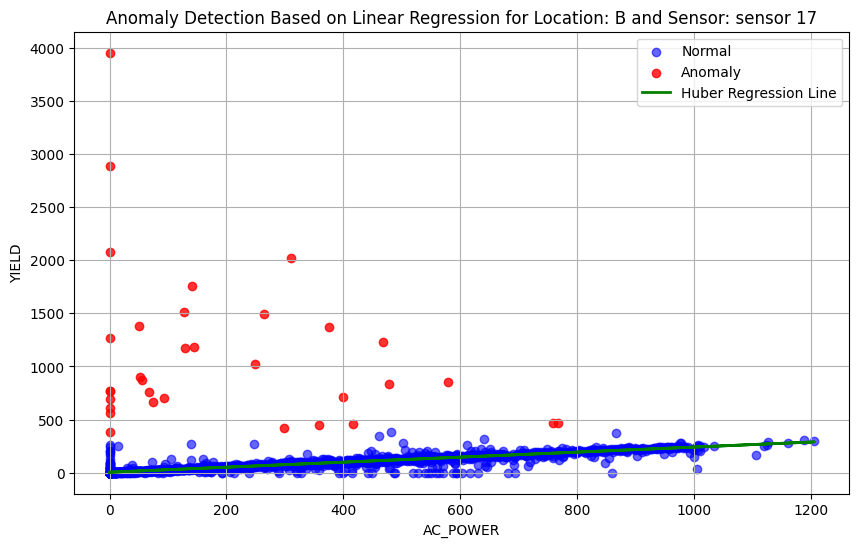

Location: B, Sensor ID: sensor 17
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



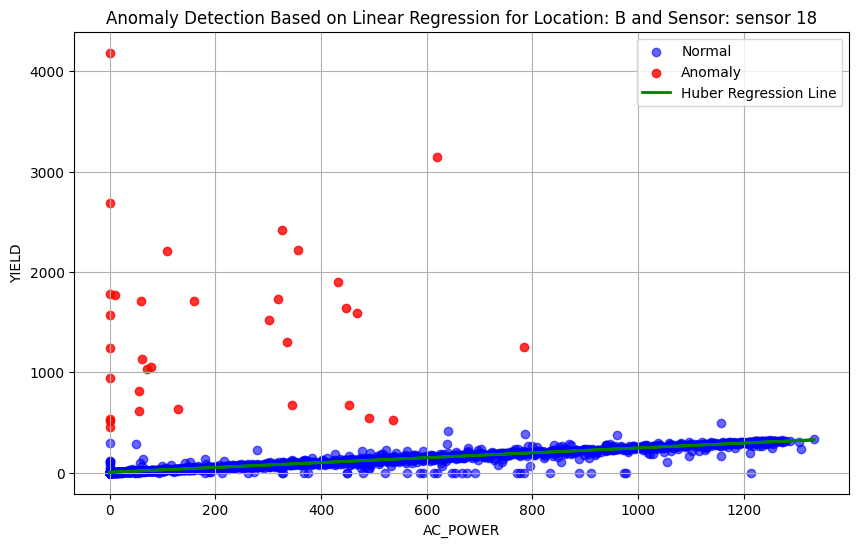

Location: B, Sensor ID: sensor 18
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



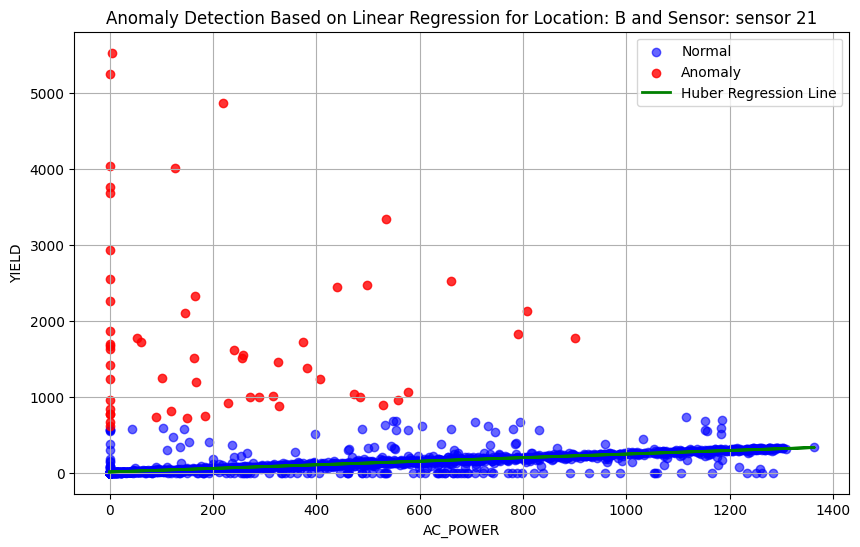

Location: B, Sensor ID: sensor 21
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



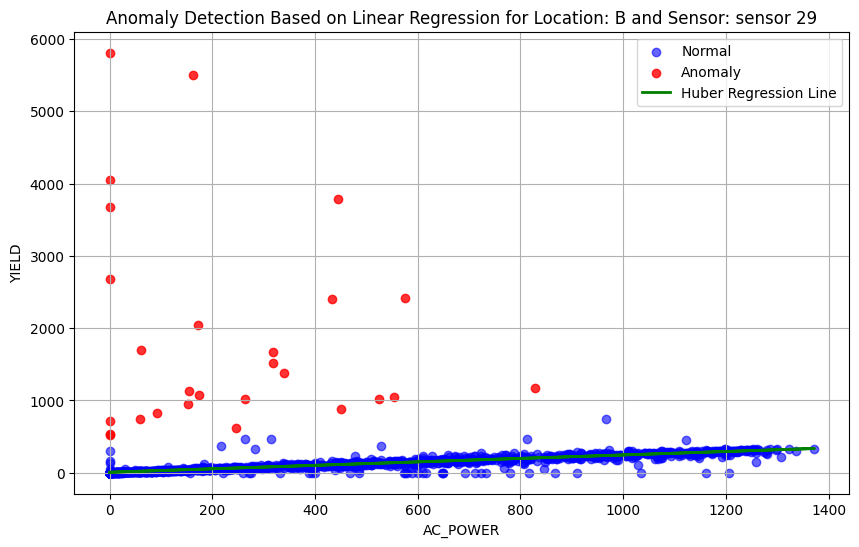

Location: B, Sensor ID: sensor 29
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



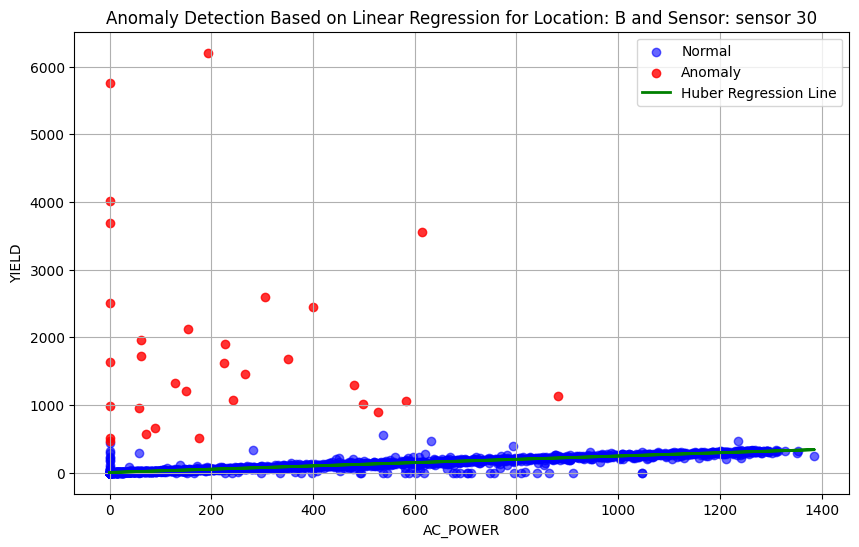

Location: B, Sensor ID: sensor 30
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



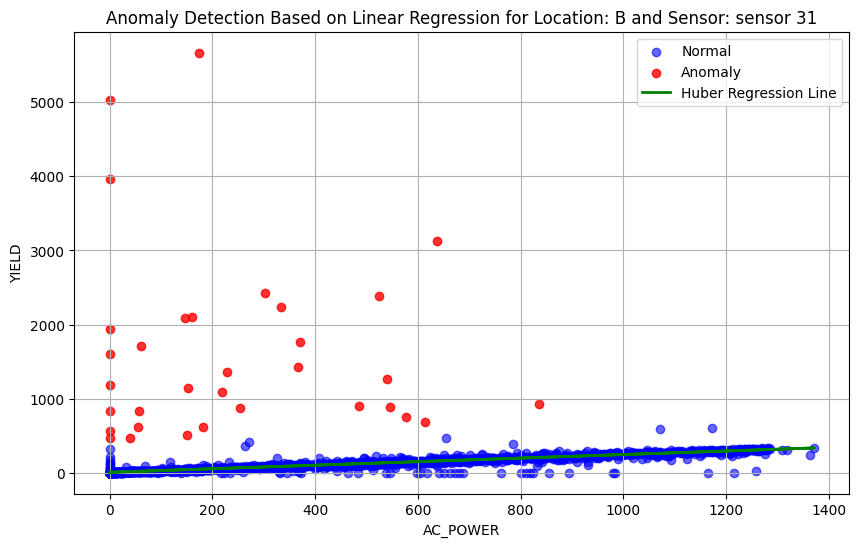

Location: B, Sensor ID: sensor 31
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



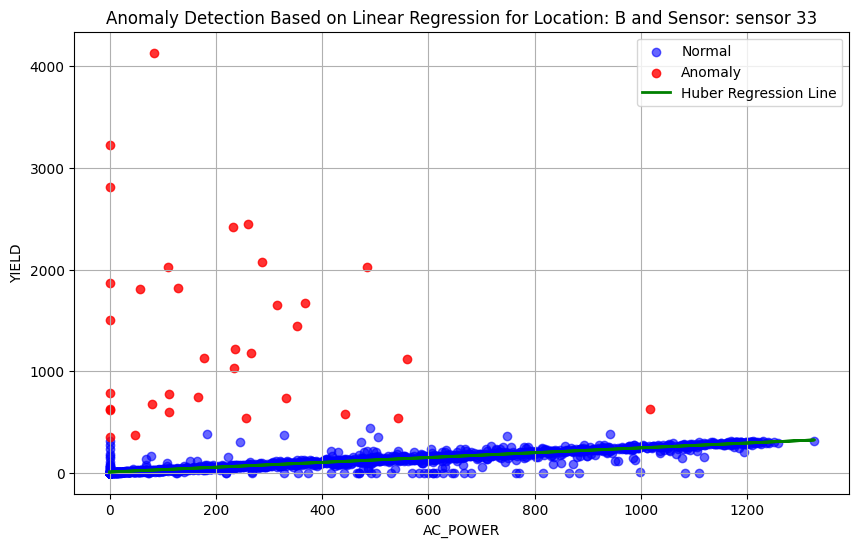

Location: B, Sensor ID: sensor 33
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



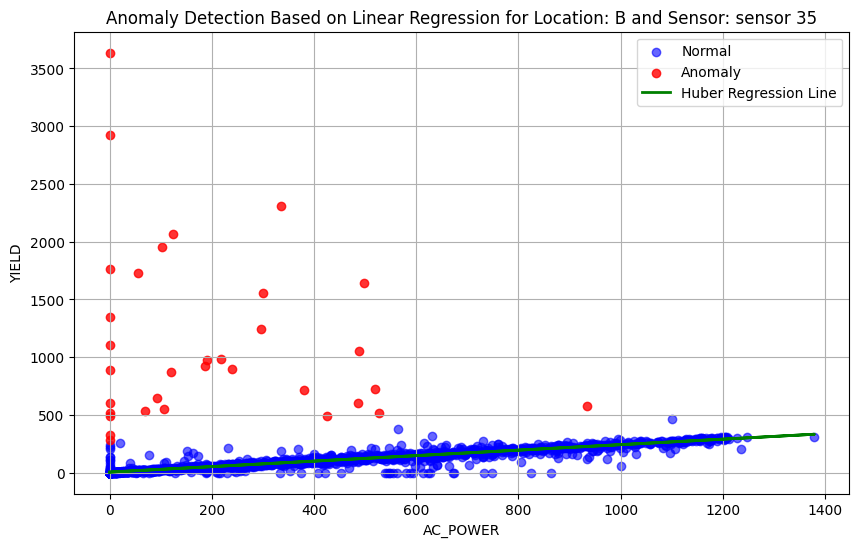

Location: B, Sensor ID: sensor 35
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



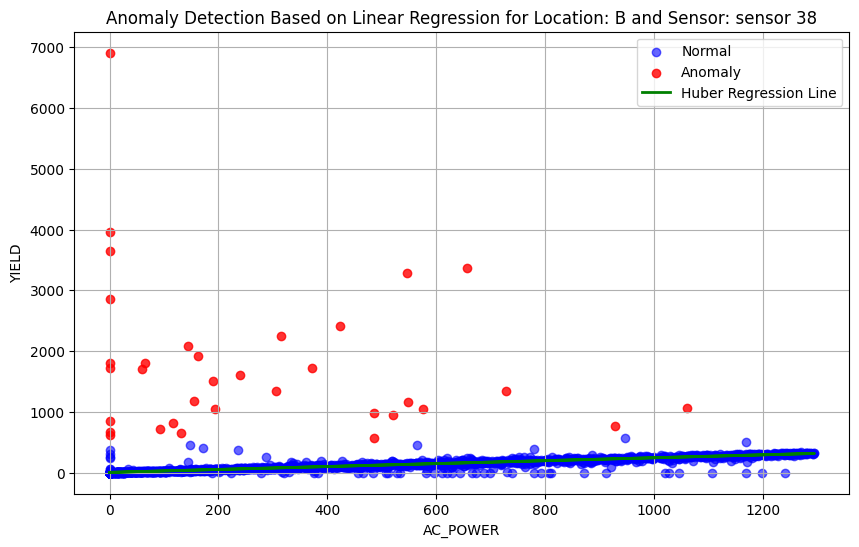

Location: B, Sensor ID: sensor 38
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



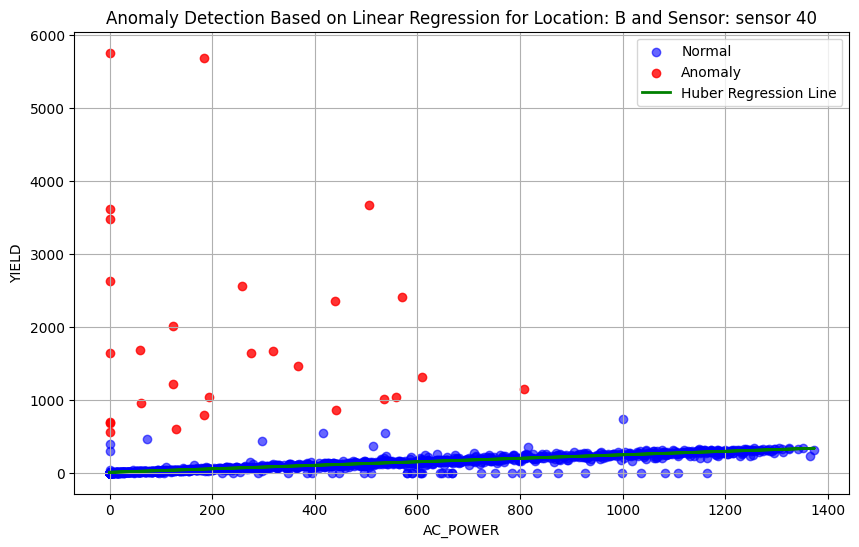

Location: B, Sensor ID: sensor 40
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



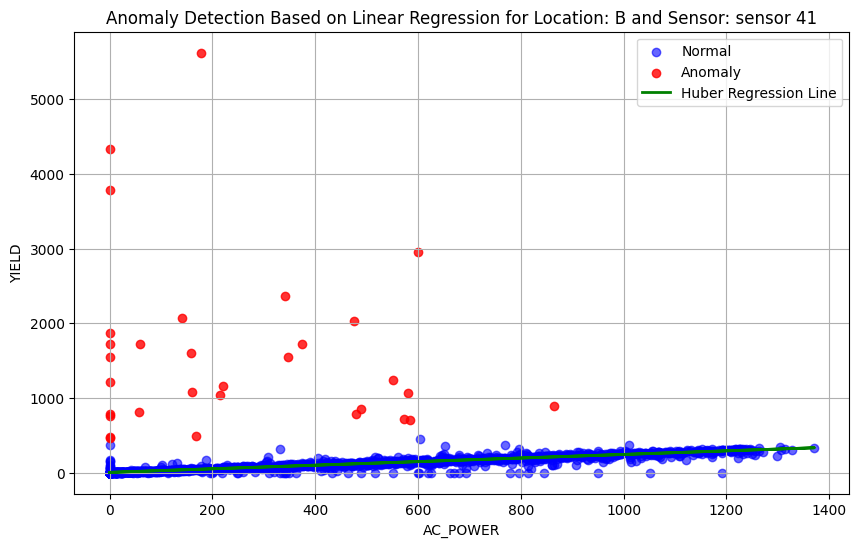

Location: B, Sensor ID: sensor 41
Mean Squared Error (All Points): 2829.0973691031922
Mean Absolute Error (All Points): 12.145937857666887
Mean Squared Error (Normal Points): 616.2765296409667
Mean Absolute Error (Normal Points): 9.362693340389724
Mean Squared Error (Anomalous Points): 3719686.434780541
Mean Absolute Error (Anomalous Points): 1532.6006457595838



In [ ]:
for location in ['A', 'B']:
    sensor_IDs = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
    for sensor_ID in sensor_IDs:
        data = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor_ID)]

        unique_dates = data['DATE'].unique()
        yield_data = None
        for date in unique_dates:
            x = data[data['DATE'] == date].copy()
            x['DAILY_YIELD'] = x['DAILY_YIELD'].shift(-1).fillna(0)
            x['YIELD'] = x['DAILY_YIELD'].diff()
            x.loc[x['YIELD'] < 0, 'YIELD'] = 0

            if yield_data is None:
                yield_data = x
            else:
                yield_data = pd.concat([yield_data, x])

        yield_data.dropna(inplace=True)

        X = yield_data['AC_POWER'].to_frame()
        y = yield_data['YIELD'].to_frame()

        # Linear Regression
        model = LinearRegression()
        model.intercept_ = ac_power_to_yield_models_dict_linear_regression[location][sensor_ID]['intercept']
        model.coef_ = np.array([ac_power_to_yield_models_dict_linear_regression[location][sensor_ID]['slope']])

        y_pred = model.predict(X).flatten()
        y = y.values.flatten()

        yield_data['Residuals'] = y - y_pred
        std_residuals = np.std(yield_data['Residuals'])
        threshold = 2 * std_residuals

        yield_data['Anomaly'] = (np.abs(yield_data['Residuals']) > threshold).astype(int)

        normal = yield_data[yield_data['Anomaly'] == 0]
        anomalous = yield_data[yield_data['Anomaly'] == 1]

        plt.figure(figsize=(10, 6))
        plt.scatter(normal['AC_POWER'], normal['YIELD'], color='blue', label='Normal', alpha=0.6)
        plt.scatter(anomalous['AC_POWER'], anomalous['YIELD'], color='red', label='Anomaly', alpha=0.8)

        plt.plot(X, y_pred, color='green', linewidth=2, label='Huber Regression Line')

        plt.title(f'Anomaly Detection Based on Linear Regression for Location: {location} and Sensor: {sensor_ID}')
        plt.xlabel('AC_POWER')
        plt.ylabel('YIELD')
        plt.legend()
        plt.grid(True)
        plt.show()

        print(f"Location: {location}, Sensor ID: {sensor_ID}")
        print(f"Mean Squared Error (All Points): {mse_all}")
        print(f"Mean Absolute Error (All Points): {mae_all}")
        print(f"Mean Squared Error (Normal Points): {mse_normal}")
        print(f"Mean Absolute Error (Normal Points): {mae_normal}")
        if mse_anomalous is not None:
            print(f"Mean Squared Error (Anomalous Points): {mse_anomalous}")
            print(f"Mean Absolute Error (Anomalous Points): {mae_anomalous}")
        else:
            print("No anomalous points detected.")
        print()

### Using Huber Regression

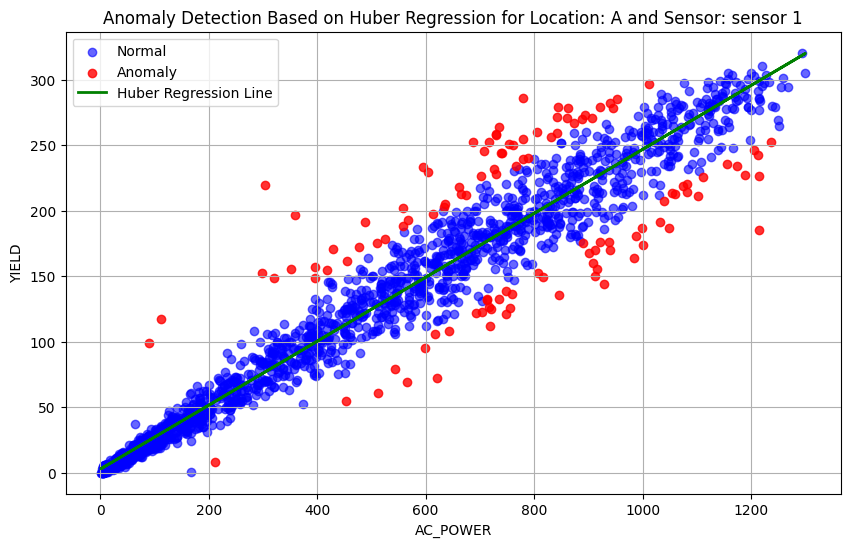

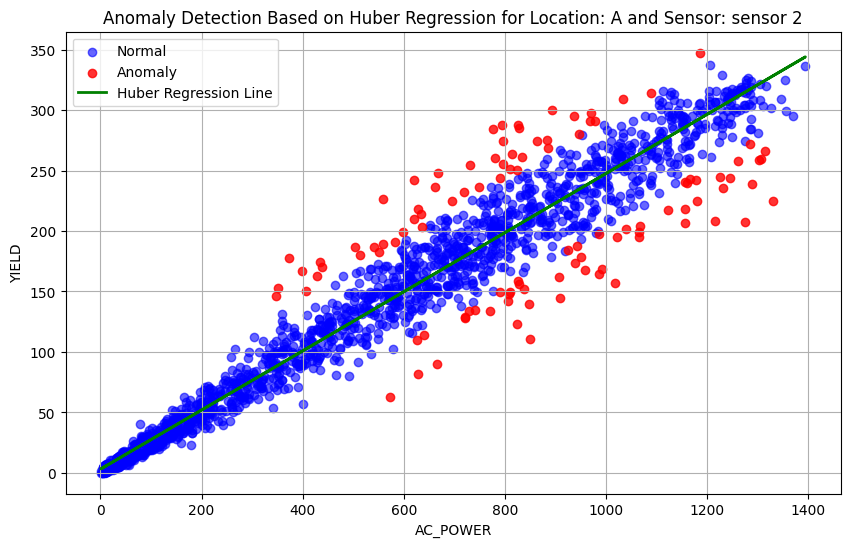

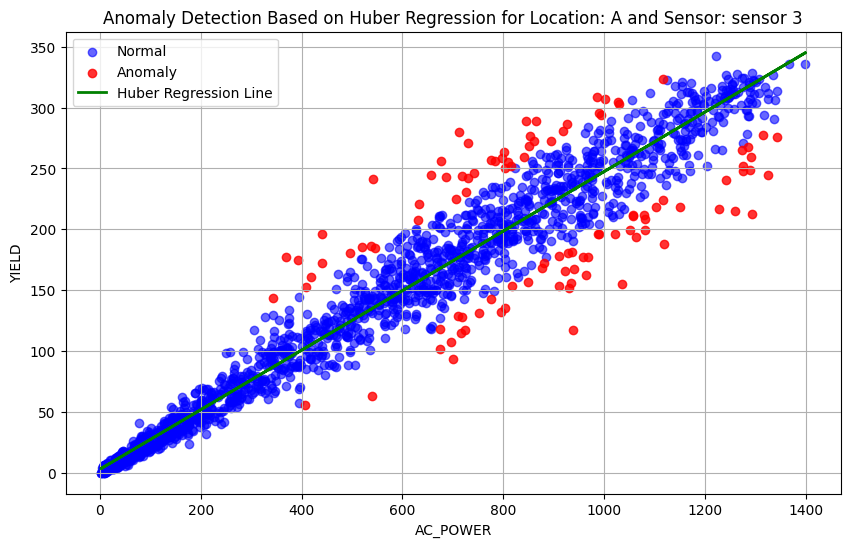

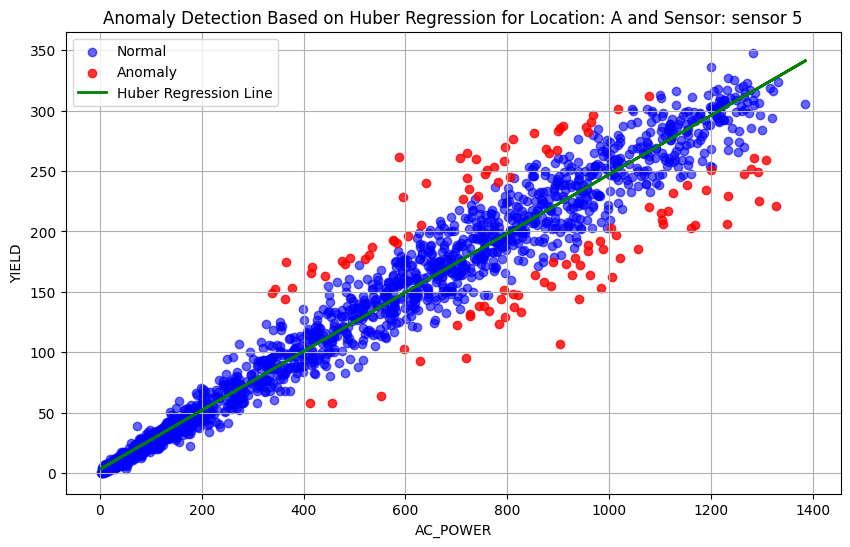

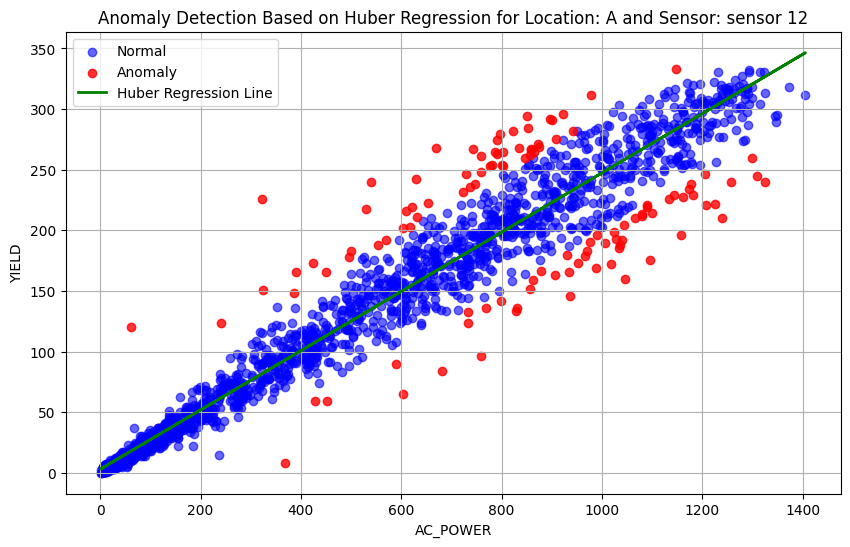

...

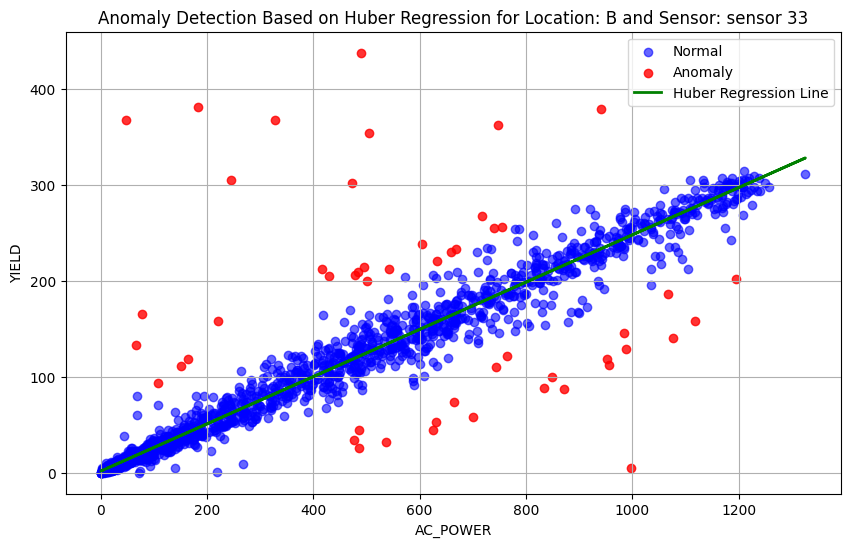

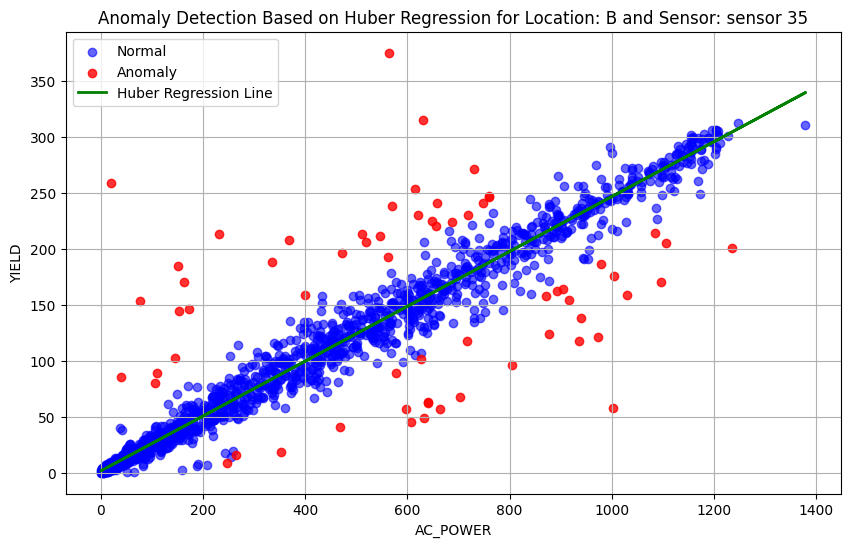

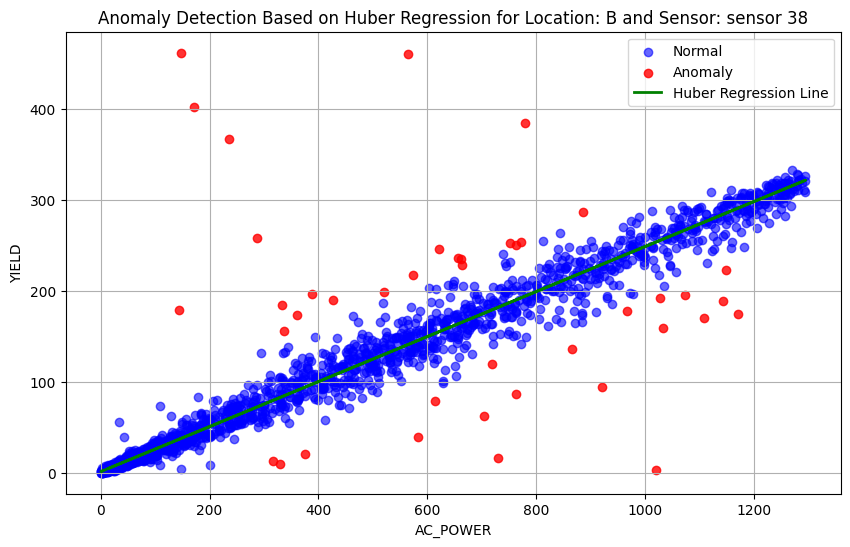

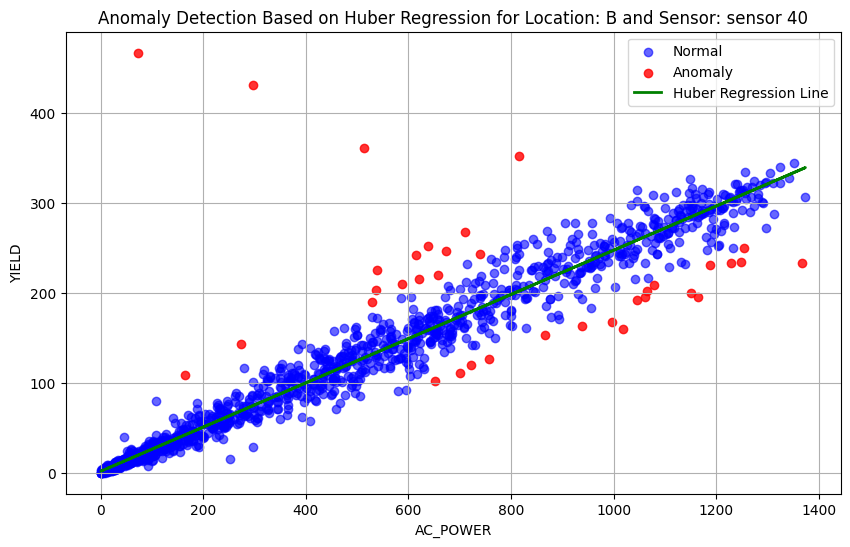

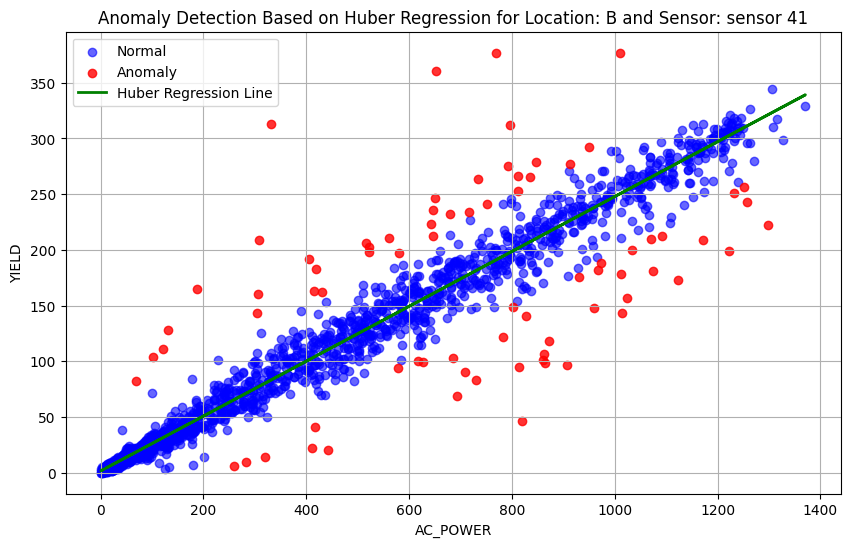

In [ ]:
from sklearn.linear_model import HuberRegressor
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

def remove_outliers_using_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    filtered_df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]
    return filtered_df

ac_power_to_yield_models_dict_huber_regression = {}

for location in ['A', 'B']:
    sensor_IDs = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
    ac_power_to_yield_models_dict_huber_regression[location] = {}
    for sensor_ID in sensor_IDs:
        data = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor_ID)]

        unique_dates = data['DATE'].unique()
        yield_data = None
        for date in unique_dates:
            x = data[data['DATE'] == date].copy()
            x['DAILY_YIELD'] = x['DAILY_YIELD'].shift(-1).fillna(0)
            x['YIELD'] = x['DAILY_YIELD'].diff()
            x.loc[x['YIELD'] < 0, 'YIELD'] = 0

            if yield_data is None:
                yield_data = x
            else:
                yield_data = pd.concat([yield_data, x])

        yield_data.dropna(inplace=True)
        yield_data = yield_data[(yield_data['AC_POWER'] != 0) & (yield_data['YIELD'] != 0)]
        yield_data = remove_outliers_using_iqr(yield_data, 'AC_POWER')
        yield_data = remove_outliers_using_iqr(yield_data, 'YIELD')

        X = yield_data['AC_POWER'].to_frame()
        y = yield_data['YIELD']

        # Huber Regression
        model = HuberRegressor()
        model.fit(X, y)

        y_pred = model.predict(X)

        yield_data['Residuals'] = y - y_pred
        std_residuals = np.std(yield_data['Residuals'])
        threshold = 2 * std_residuals

        yield_data['Anomaly'] = (np.abs(yield_data['Residuals']) > threshold).astype(int)

        normal = yield_data[yield_data['Anomaly'] == 0]
        anomalous = yield_data[yield_data['Anomaly'] == 1]

        plt.figure(figsize=(10, 6))
        plt.scatter(normal['AC_POWER'], normal['YIELD'], color='blue', label='Normal', alpha=0.6)
        plt.scatter(anomalous['AC_POWER'], anomalous['YIELD'], color='red', label='Anomaly', alpha=0.8)

        plt.plot(X, y_pred, color='green', linewidth=2, label='Huber Regression Line')

        plt.title(f'Anomaly Detection Based on Huber Regression for Location: {location} and Sensor: {sensor_ID}')
        plt.xlabel('AC_POWER')
        plt.ylabel('YIELD')
        plt.legend()
        plt.grid(True)
        plt.show()

        ac_power_to_yield_models_dict_huber_regression[location][sensor_ID] = {
            'intercept': model.intercept_,
            'slope': model.coef_[0],
            'std_residuals': std_residuals
        }

In [ ]:
# for location in ['A', 'B']:
#     sensor_IDs = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
#     for sensor_ID in sensor_IDs:
#         data = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor_ID)]

#         unique_dates = data['DATE'].unique()
#         yield_data = None
#         for date in unique_dates:
#             x = data[data['DATE'] == date].copy()
#             x['DAILY_YIELD'] = x['DAILY_YIELD'].shift(-1).fillna(0)
#             x['YIELD'] = x['DAILY_YIELD'].diff()
#             x.loc[x['YIELD'] < 0, 'YIELD'] = 0

#             if yield_data is None:
#                 yield_data = x
#             else:
#                 yield_data = pd.concat([yield_data, x])

#         yield_data.dropna(inplace=True)

#         X = yield_data['AC_POWER'].to_frame()
#         y = yield_data['YIELD']

#         # Huber Regression
#         model = HuberRegressor()
#         model.intercept_ = ac_power_to_yield_models_dict_huber_regression[location][sensor_ID]['intercept']
#         model.coef_ = np.array([ac_power_to_yield_models_dict_huber_regression[location][sensor_ID]['slope']])

#         y_pred = model.predict(X)

#         yield_data['Residuals'] = y - y_pred
#         std_residuals = ac_power_to_yield_models_dict_huber_regression[location][sensor_ID]['std_residuals']
#         threshold = 2 * std_residuals

#         yield_data['Anomaly'] = (np.abs(yield_data['Residuals']) > threshold).astype(int)

#         normal = yield_data[yield_data['Anomaly'] == 0]
#         anomalous = yield_data[yield_data['Anomaly'] == 1]

#         plt.figure(figsize=(10, 6))
#         plt.scatter(normal['AC_POWER'], normal['YIELD'], color='blue', label='Normal', alpha=0.6)
#         plt.scatter(anomalous['AC_POWER'], anomalous['YIELD'], color='red', label='Anomaly', alpha=0.8)

#         plt.plot(X, y_pred, color='green', linewidth=2, label='Huber Regression Line')

#         plt.title(f'Anomaly Detection Based on Huber Regression for Location: {location} and Sensor: {sensor_ID}')
#         plt.xlabel('AC_POWER')
#         plt.ylabel('YIELD')
#         plt.legend()
#         plt.grid(True)
#         plt.show()

#         # Metrics for all points
#         mse_all = mean_squared_error(y, y_pred)
#         mae_all = mean_absolute_error(y, y_pred)

#         # Metrics for non-outliers
#         normal = yield_data[yield_data['Anomaly'] == 0]
#         mse_normal = mean_squared_error(normal['YIELD'], model.predict(normal['AC_POWER'].to_frame()))
#         mae_normal = mean_absolute_error(normal['YIELD'], model.predict(normal['AC_POWER'].to_frame()))

#         # Metrics for outliers
#         anomalous = yield_data[yield_data['Anomaly'] == 1]
#         if not anomalous.empty:
#             mse_anomalous = mean_squared_error(anomalous['YIELD'], model.predict(anomalous['AC_POWER'].to_frame()))
#             mae_anomalous = mean_absolute_error(anomalous['YIELD'], model.predict(anomalous['AC_POWER'].to_frame()))
#         else:
#             mse_anomalous, mae_anomalous = None, None  # Handle cases with no outliers

#         print(f"Location: {location}, Sensor: {sensor_ID}")
#         print(f"MSE (All): {mse_all:.4f}, MAE (All): {mae_all:.4f}")
#         print(f"MSE (Normal): {mse_normal:.4f}, MAE (Normal): {mae_normal:.4f}")
#         if mse_anomalous is not None:
#             print(f"MSE (Anomalous): {mse_anomalous:.4f}, MAE (Anomalous): {mae_anomalous:.4f}")
#         else:
#             print("No anomalous data points detected.")
#         print()

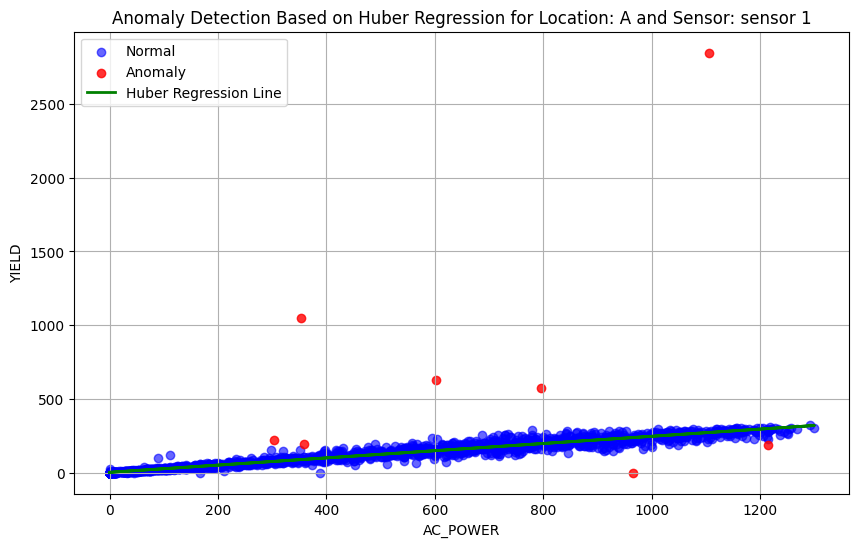

Location: A, Sensor: sensor 1
MSE (All): 2788.8289, MAE (All): 10.6249
MSE (Normal): 248.2977, MAE (Normal): 9.0668
MSE (Anomalous): 1001852.7390, MAE (Anomalous): 623.3519



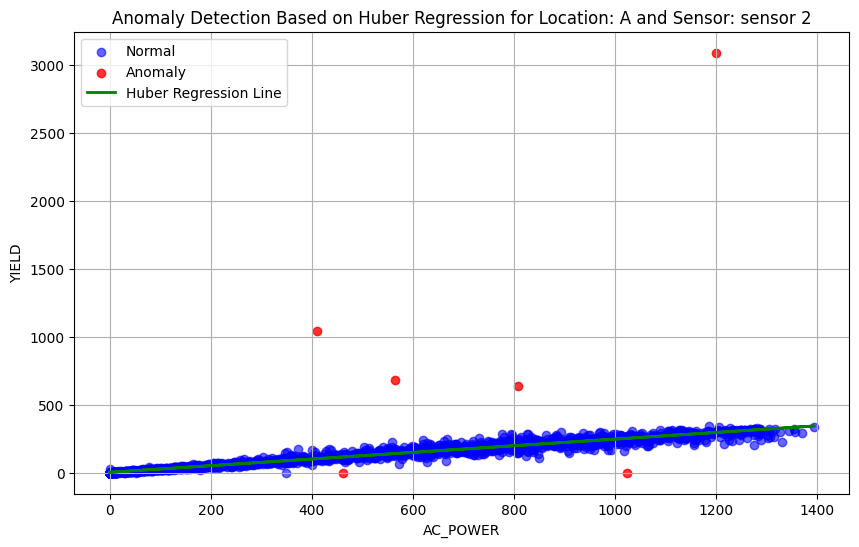

Location: A, Sensor: sensor 2
MSE (All): 3240.9339, MAE (All): 11.2194
MSE (Normal): 271.9984, MAE (Normal): 9.6083
MSE (Anomalous): 1543128.8024, MAE (Anomalous): 846.8317



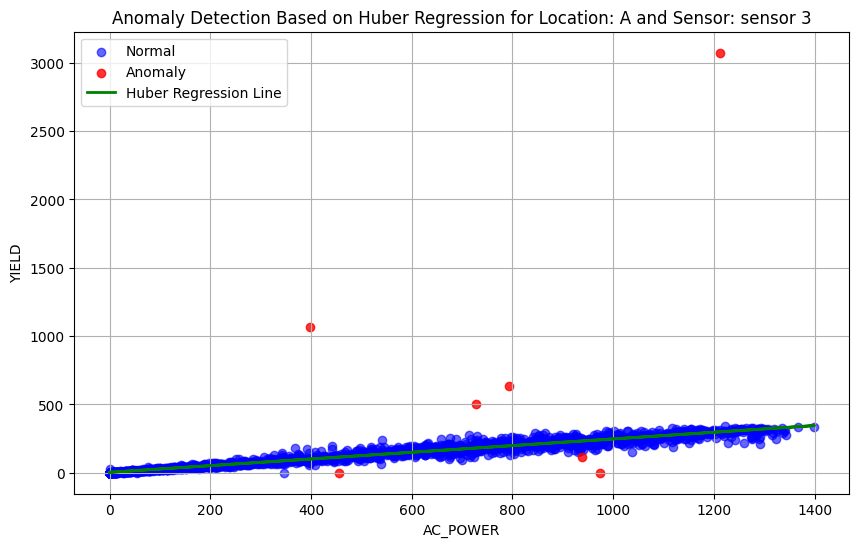

Location: A, Sensor: sensor 3
MSE (All): 3175.1319, MAE (All): 11.3662
MSE (Normal): 284.8608, MAE (Normal): 9.7930
MSE (Anomalous): 1287694.2003, MAE (Anomalous): 710.5276



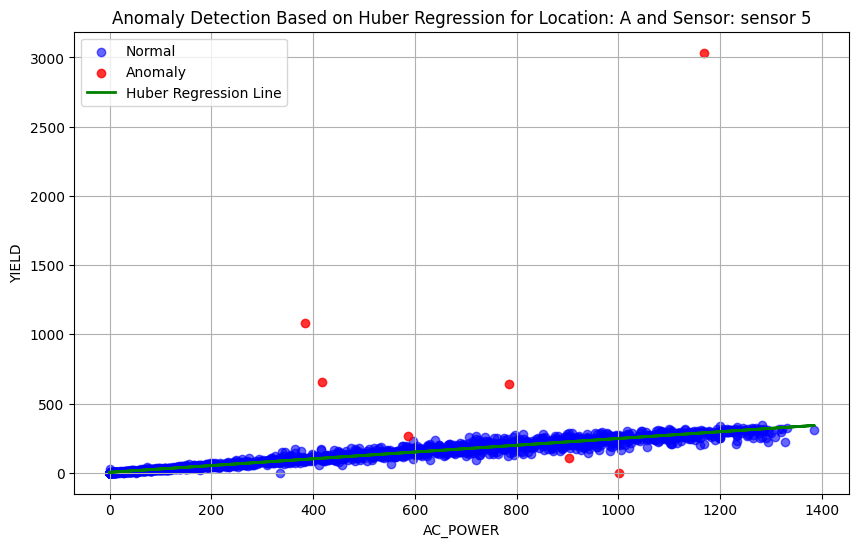

Location: A, Sensor: sensor 5
MSE (All): 3167.3390, MAE (All): 11.0878
MSE (Normal): 265.2059, MAE (Normal): 9.4477
MSE (Anomalous): 1299177.0572, MAE (Anomalous): 743.5174



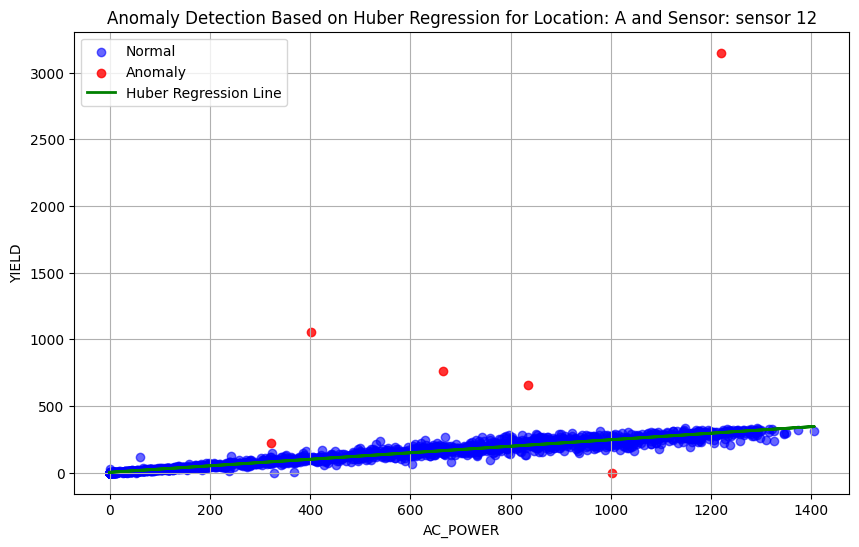

Location: A, Sensor: sensor 12
MSE (All): 3393.5065, MAE (All): 11.7417
MSE (Normal): 304.5429, MAE (Normal): 10.0857
MSE (Anomalous): 1608624.9046, MAE (Anomalous): 872.3180



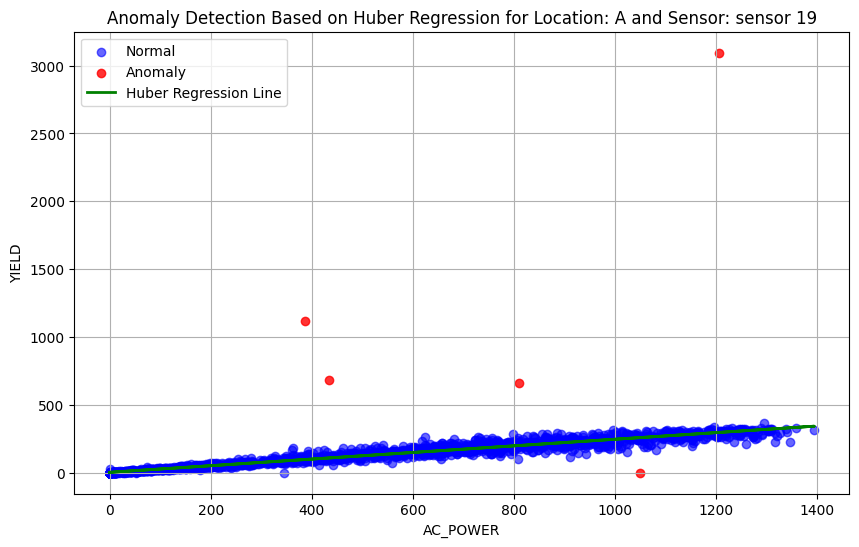

Location: A, Sensor: sensor 19
MSE (All): 3311.1255, MAE (All): 11.4506
MSE (Normal): 288.8202, MAE (Normal): 9.8367
MSE (Anomalous): 1894065.3034, MAE (Anomalous): 1021.0653



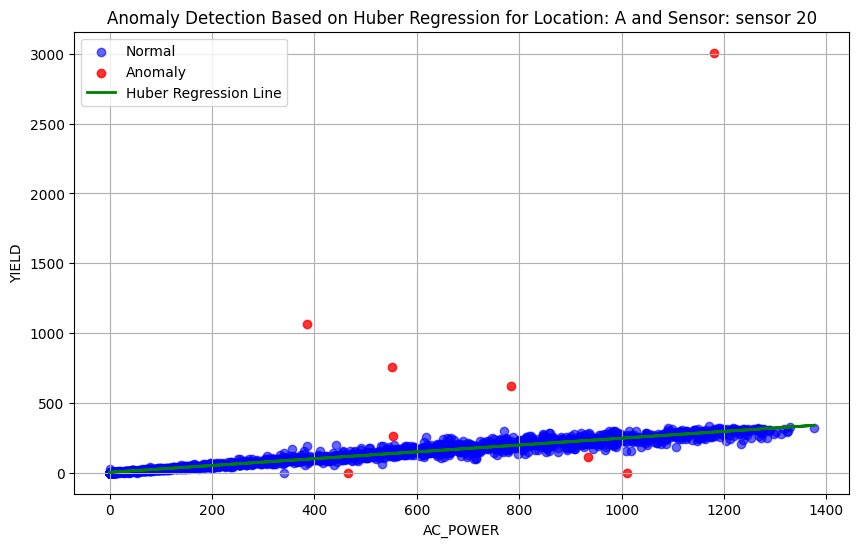

Location: A, Sensor: sensor 20
MSE (All): 3153.9183, MAE (All): 11.2955
MSE (Normal): 271.6848, MAE (Normal): 9.6088
MSE (Anomalous): 1123622.2030, MAE (Anomalous): 666.9942



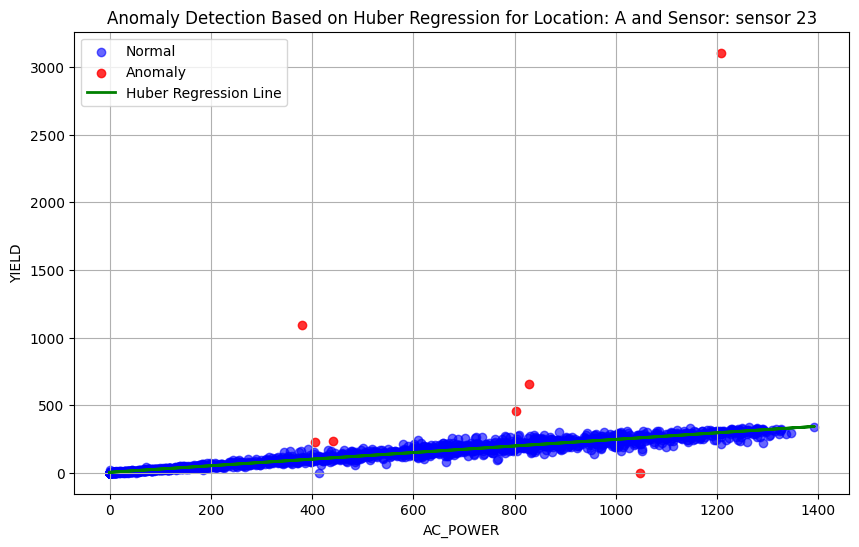

Location: A, Sensor: sensor 23
MSE (All): 3242.3054, MAE (All): 11.3829
MSE (Normal): 285.3491, MAE (Normal): 9.8006
MSE (Anomalous): 1322467.2552, MAE (Anomalous): 717.3147



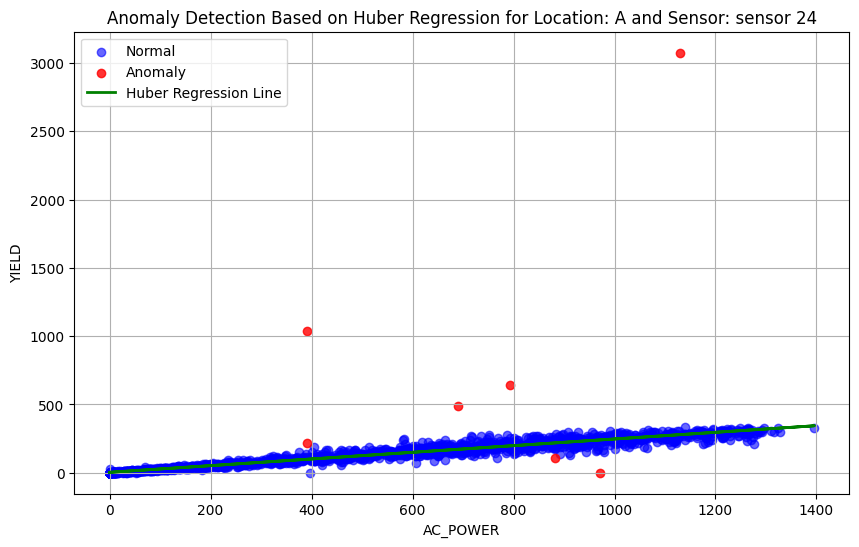

Location: A, Sensor: sensor 24
MSE (All): 3192.6825, MAE (All): 11.3528
MSE (Normal): 283.4587, MAE (Normal): 9.7827
MSE (Anomalous): 1298212.8833, MAE (Anomalous): 710.2568



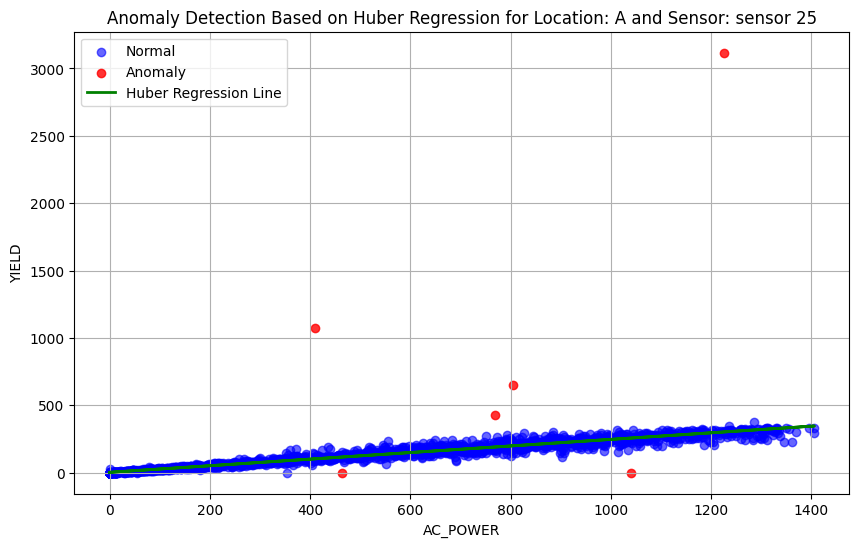

Location: A, Sensor: sensor 25
MSE (All): 3232.7504, MAE (All): 11.3493
MSE (Normal): 284.2890, MAE (Normal): 9.8160
MSE (Anomalous): 1532501.3719, MAE (Anomalous): 806.6234



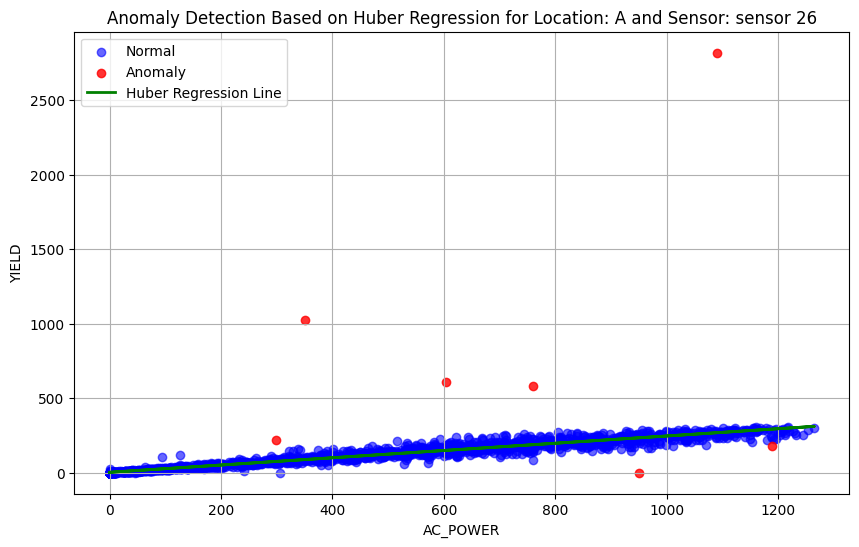

Location: A, Sensor: sensor 26
MSE (All): 2727.1685, MAE (All): 10.5611
MSE (Normal): 244.9807, MAE (Normal): 9.0511
MSE (Anomalous): 1119002.4808, MAE (Anomalous): 689.6067



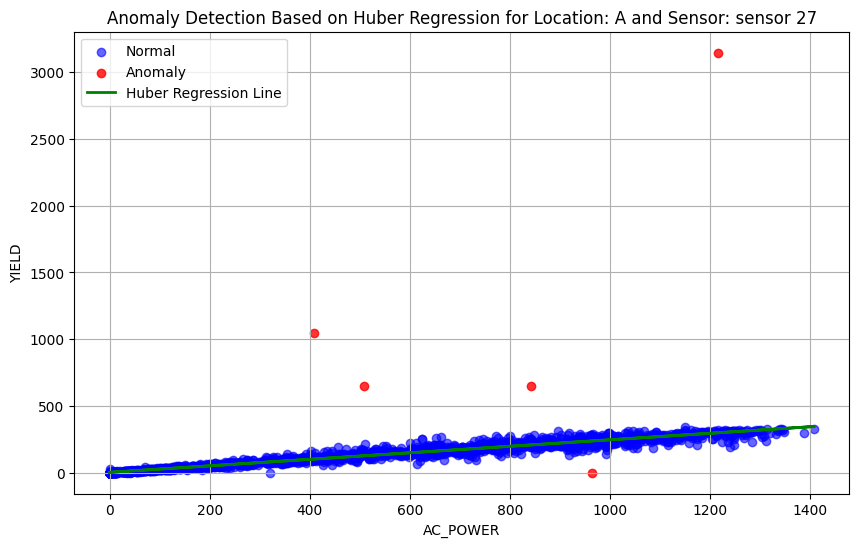

Location: A, Sensor: sensor 27
MSE (All): 3328.3540, MAE (All): 11.2649
MSE (Normal): 280.7033, MAE (Normal): 9.6815
MSE (Anomalous): 1905062.3825, MAE (Anomalous): 999.3288



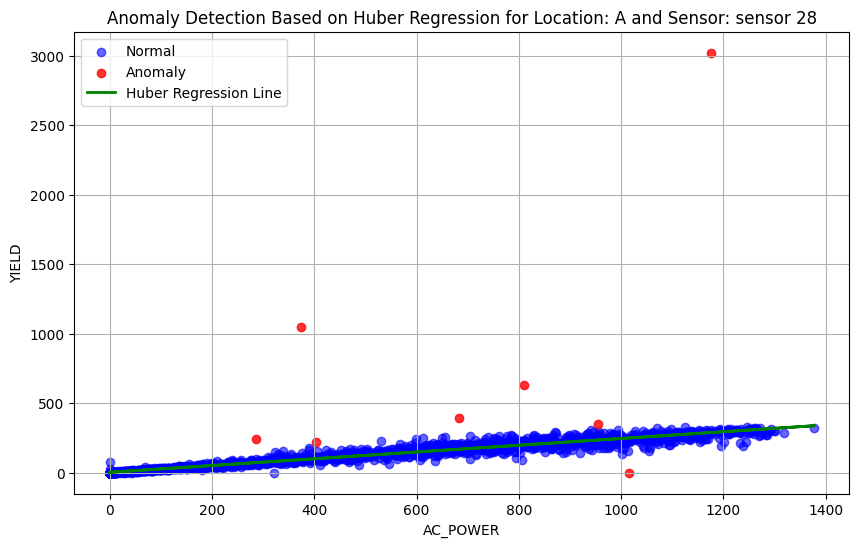

Location: A, Sensor: sensor 28
MSE (All): 3093.0760, MAE (All): 11.5282
MSE (Normal): 301.3054, MAE (Normal): 9.9548
MSE (Anomalous): 1092581.5594, MAE (Anomalous): 625.5334



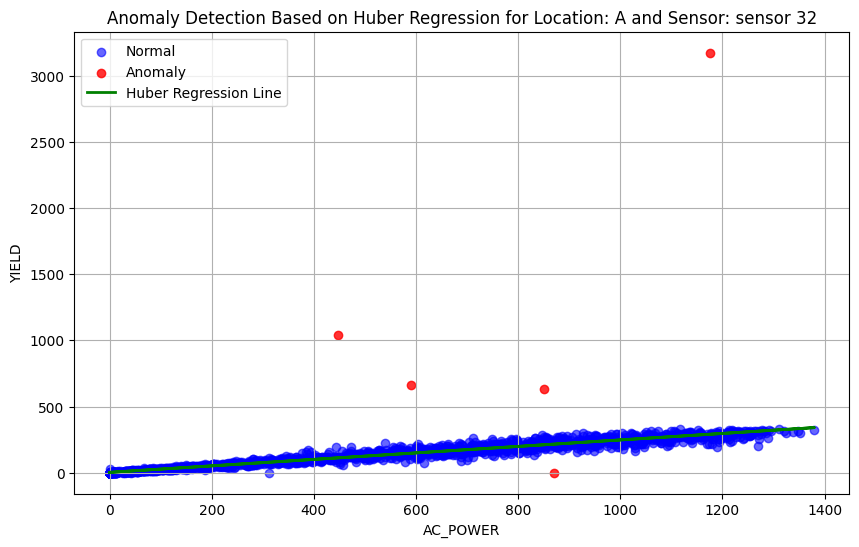

Location: A, Sensor: sensor 32
MSE (All): 3346.2637, MAE (All): 11.0553
MSE (Normal): 260.3678, MAE (Normal): 9.4853
MSE (Anomalous): 1928945.2987, MAE (Anomalous): 990.7134



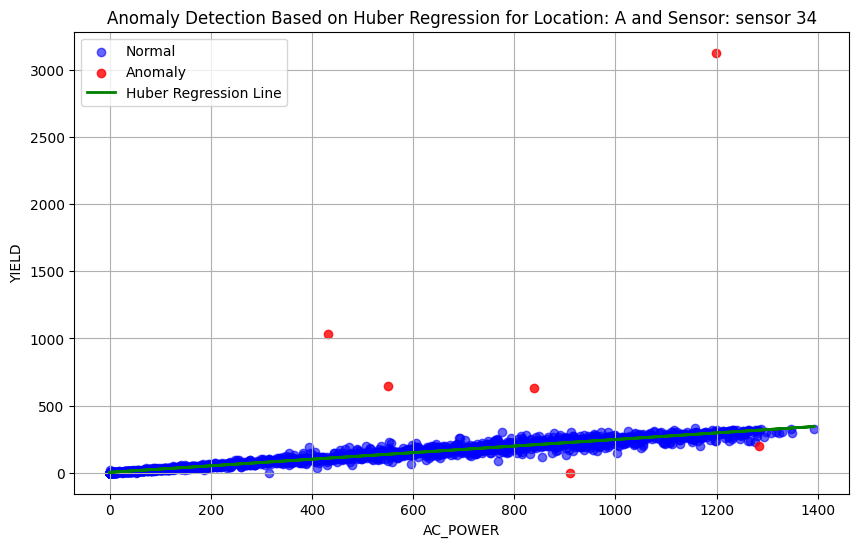

Location: A, Sensor: sensor 34
MSE (All): 3271.9652, MAE (All): 11.0703
MSE (Normal): 269.4002, MAE (Normal): 9.4767
MSE (Anomalous): 1563604.8948, MAE (Anomalous): 839.1785



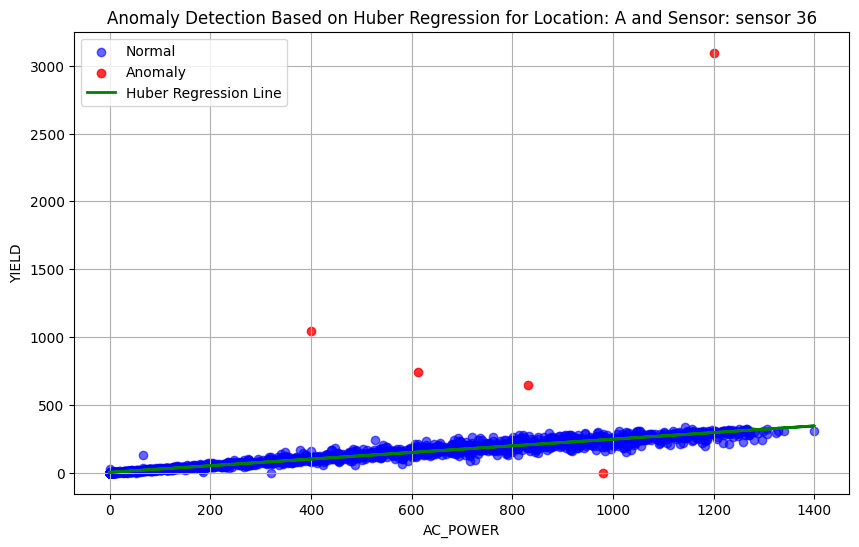

Location: A, Sensor: sensor 36
MSE (All): 3271.1807, MAE (All): 11.4150
MSE (Normal): 286.0381, MAE (Normal): 9.8253
MSE (Anomalous): 1865403.1434, MAE (Anomalous): 1003.0600



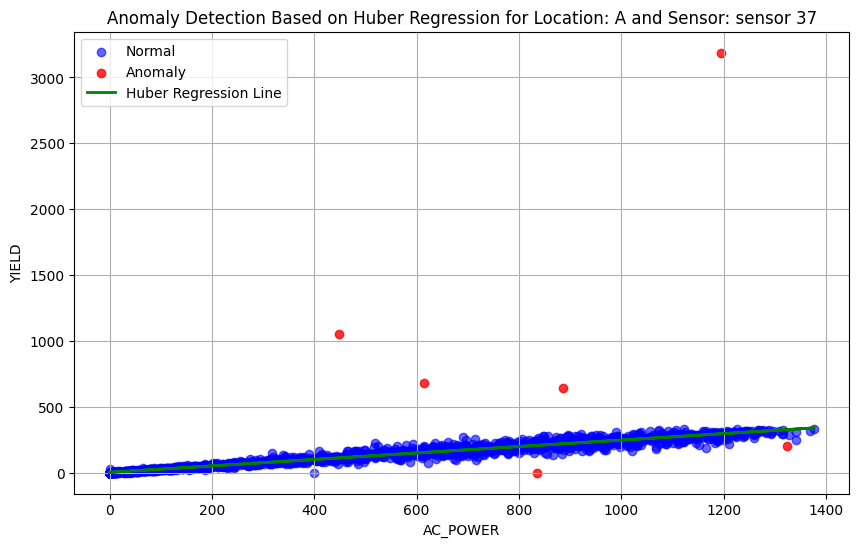

Location: A, Sensor: sensor 37
MSE (All): 3382.5764, MAE (All): 11.0040
MSE (Normal): 260.3896, MAE (Normal): 9.3867
MSE (Anomalous): 1626399.3470, MAE (Anomalous): 851.7327



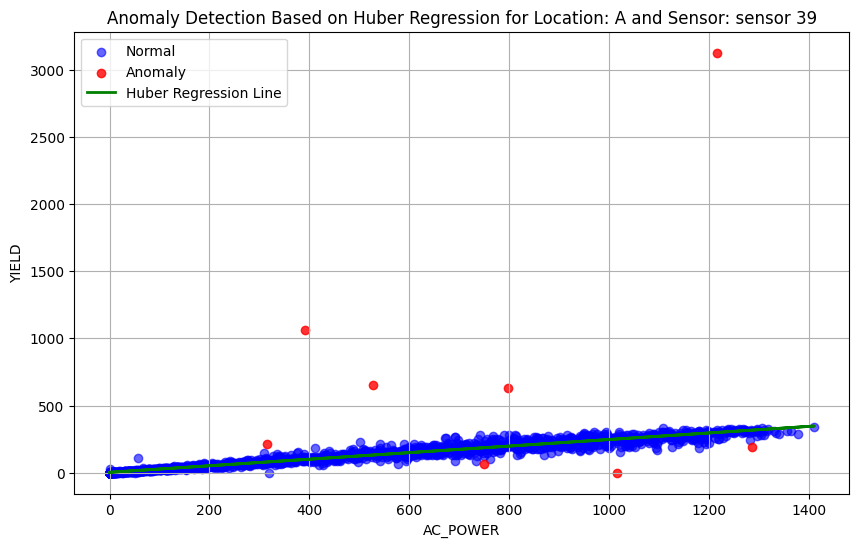

Location: A, Sensor: sensor 39
MSE (All): 3333.5623, MAE (All): 11.5568
MSE (Normal): 294.5223, MAE (Normal): 9.8577
MSE (Anomalous): 1187419.4924, MAE (Anomalous): 673.5746



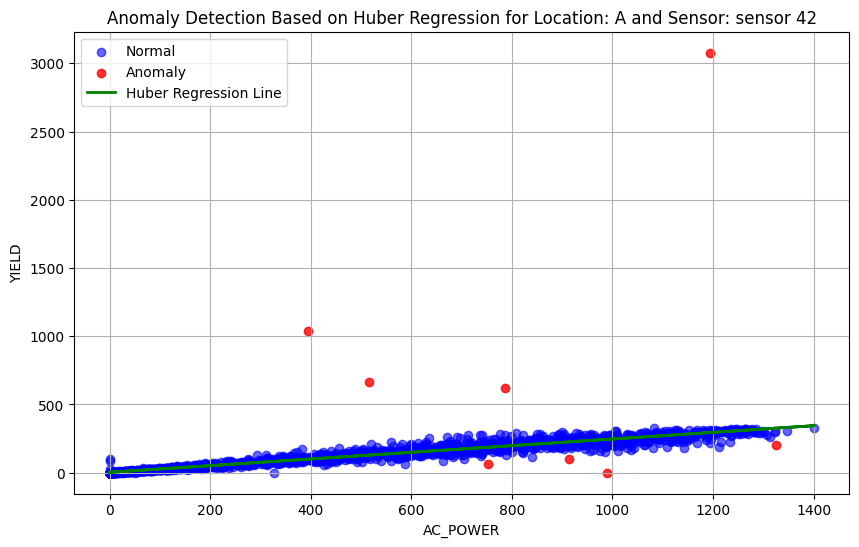

Location: A, Sensor: sensor 42
MSE (All): 3240.3381, MAE (All): 11.6204
MSE (Normal): 296.5615, MAE (Normal): 9.9508
MSE (Anomalous): 1150209.2756, MAE (Anomalous): 662.1428



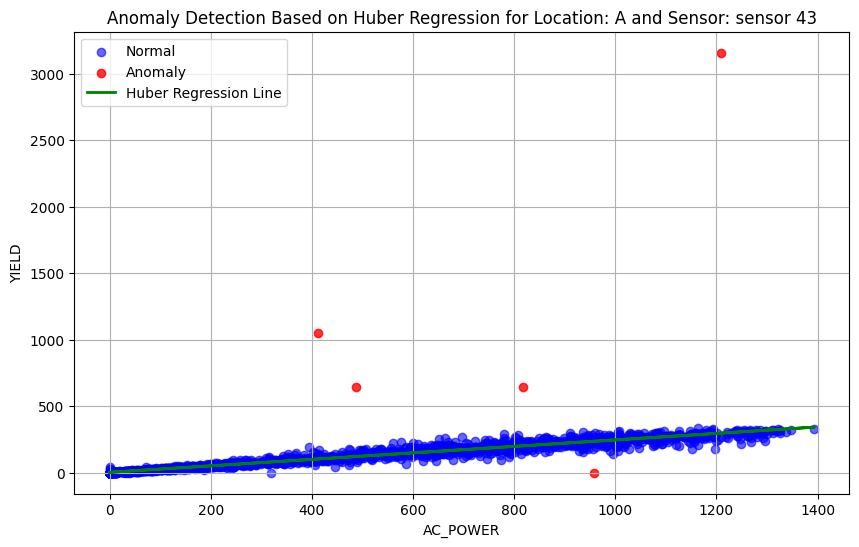

Location: A, Sensor: sensor 43
MSE (All): 3363.0902, MAE (All): 11.2800
MSE (Normal): 282.4239, MAE (Normal): 9.6886
MSE (Anomalous): 1922002.0307, MAE (Anomalous): 1002.3945



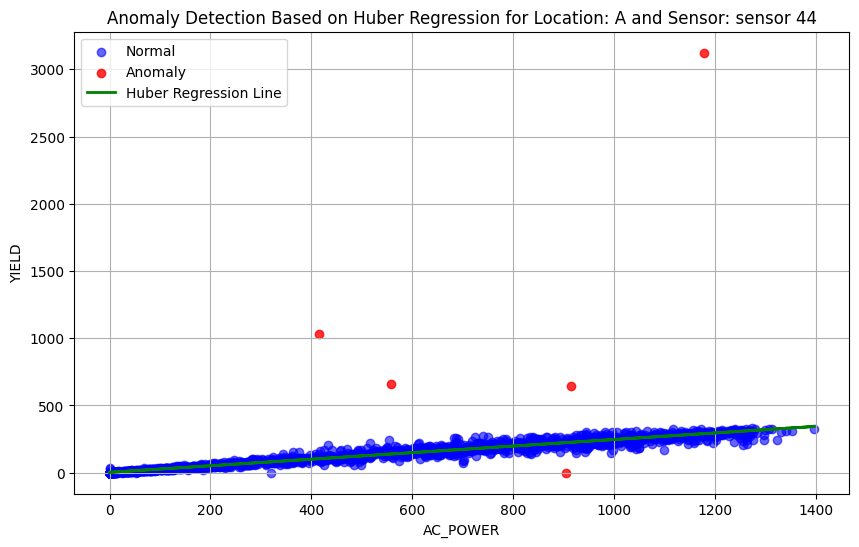

Location: A, Sensor: sensor 44
MSE (All): 3285.1720, MAE (All): 11.2665
MSE (Normal): 281.3467, MAE (Normal): 9.7055
MSE (Anomalous): 1877071.3913, MAE (Anomalous): 984.9856



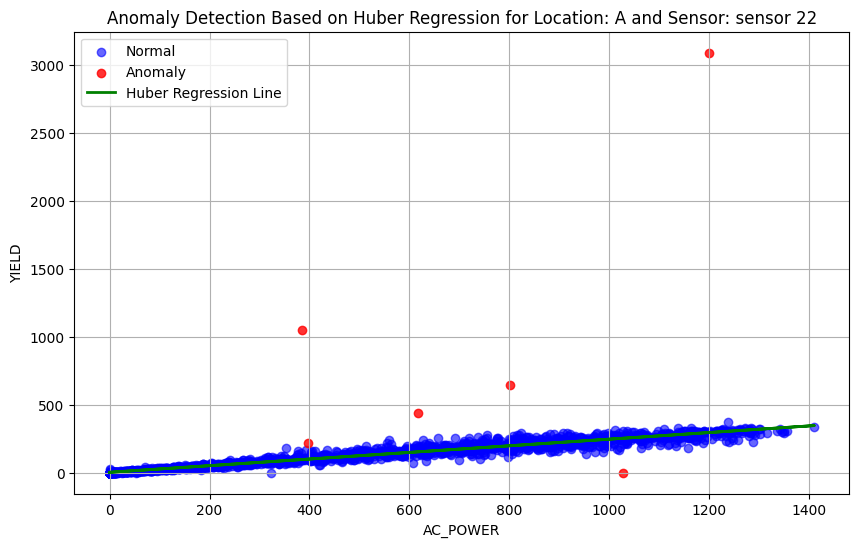

Location: A, Sensor: sensor 22
MSE (All): 3219.8454, MAE (All): 11.5758
MSE (Normal): 296.9192, MAE (Normal): 10.0302
MSE (Anomalous): 1512424.0967, MAE (Anomalous): 809.6547



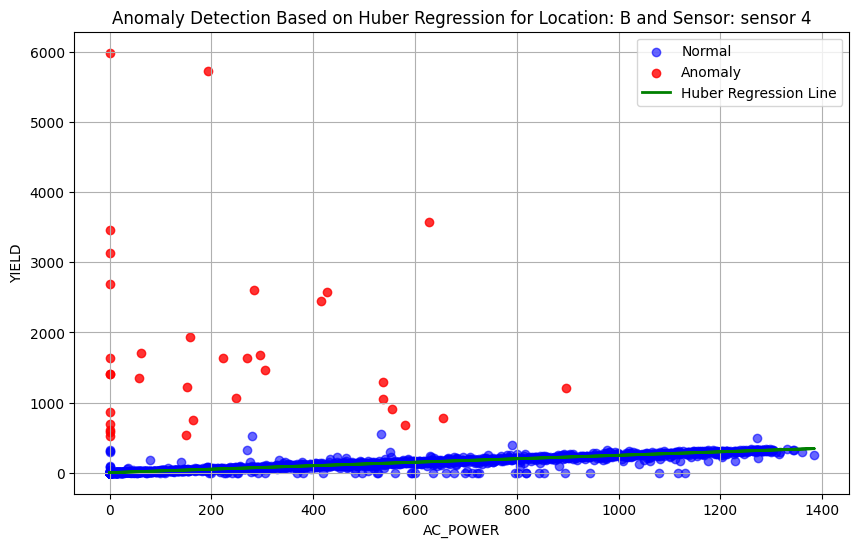

Location: B, Sensor: sensor 4
MSE (All): 51079.2884, MAE (All): 28.0889
MSE (Normal): 814.0961, MAE (Normal): 9.7883
MSE (Anomalous): 4724263.7878, MAE (Anomalous): 1729.5015



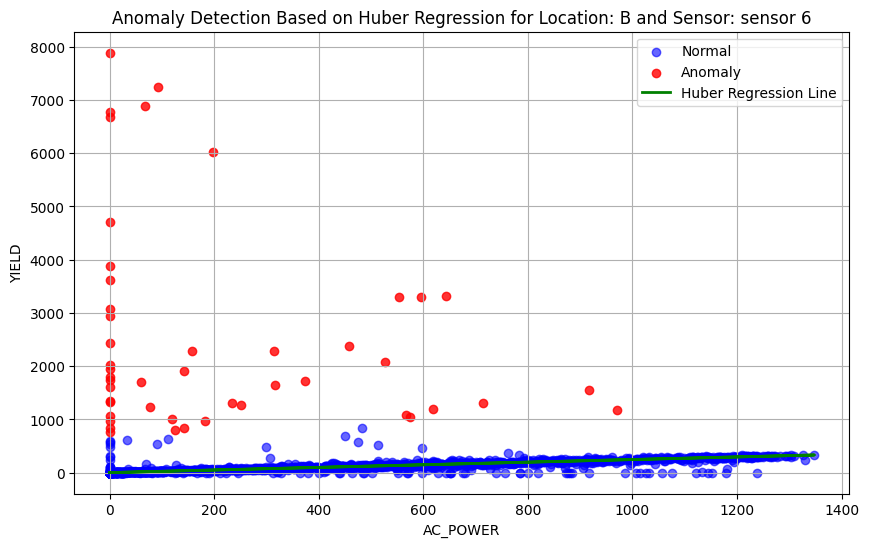

Location: B, Sensor: sensor 6
MSE (All): 143072.4758, MAE (All): 47.9551
MSE (Normal): 2062.3774, MAE (Normal): 12.6184
MSE (Anomalous): 9779762.6020, MAE (Anomalous): 2462.8791



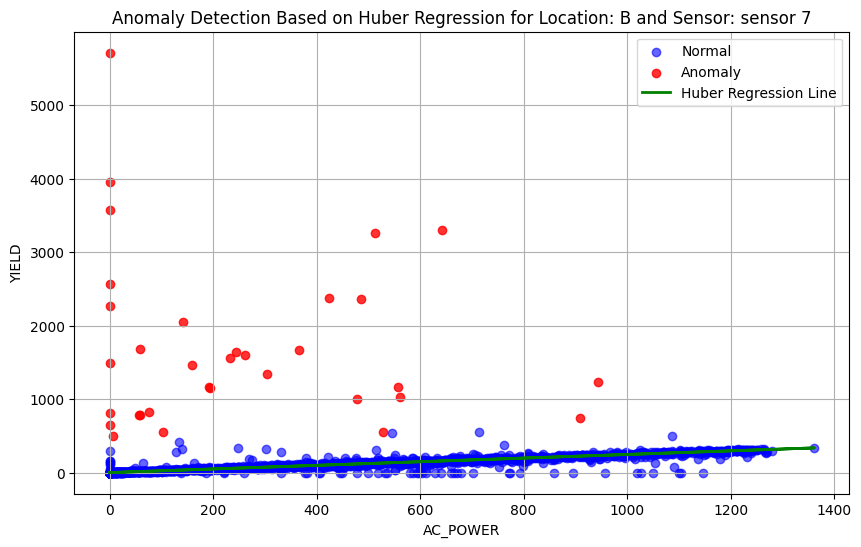

Location: B, Sensor: sensor 7
MSE (All): 42205.7038, MAE (All): 26.4259
MSE (Normal): 892.7178, MAE (Normal): 9.7498
MSE (Anomalous): 4080863.0589, MAE (Anomalous): 1656.6361



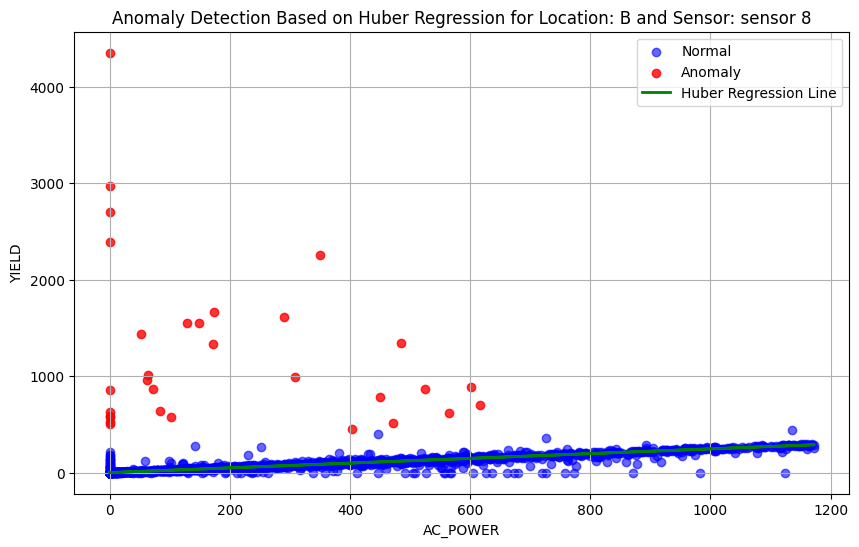

Location: B, Sensor: sensor 8
MSE (All): 22140.7405, MAE (All): 19.7125
MSE (Normal): 552.6245, MAE (Normal): 8.1602
MSE (Anomalous): 2225521.3494, MAE (Anomalous): 1198.7866



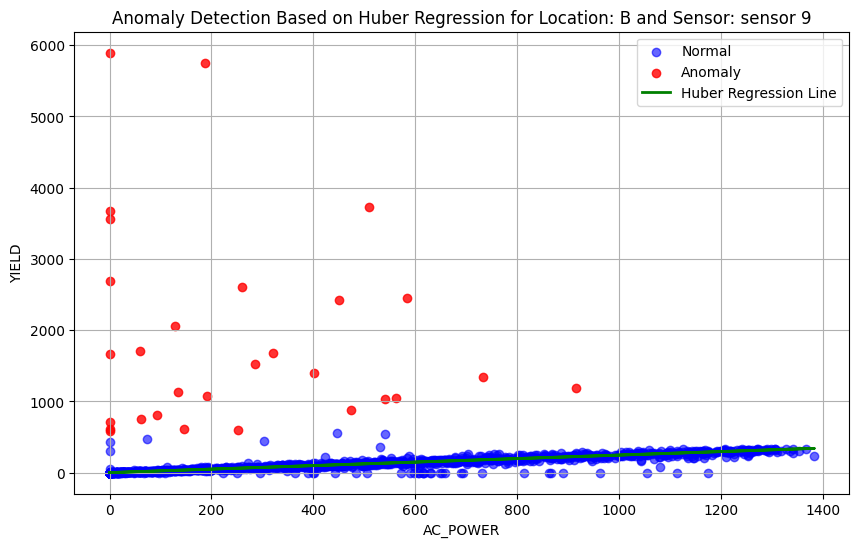

Location: B, Sensor: sensor 9
MSE (All): 67637.0922, MAE (All): 33.8163
MSE (Normal): 1095.6831, MAE (Normal): 11.2772
MSE (Anomalous): 5404717.0123, MAE (Anomalous): 1841.6112



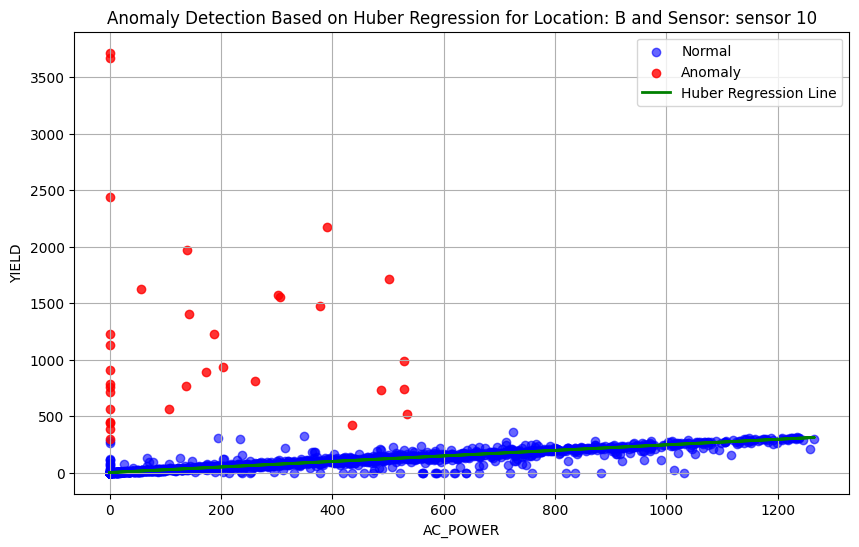

Location: B, Sensor: sensor 10
MSE (All): 21060.0627, MAE (All): 20.1679
MSE (Normal): 559.7473, MAE (Normal): 8.5669
MSE (Anomalous): 2025121.2008, MAE (Anomalous): 1154.2559



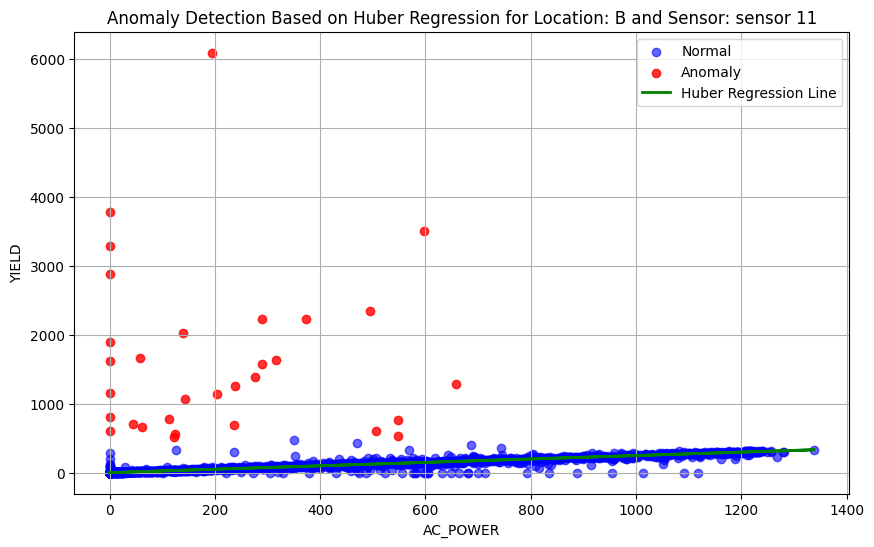

Location: B, Sensor: sensor 11
MSE (All): 38968.6248, MAE (All): 23.9256
MSE (Normal): 673.4928, MAE (Normal): 8.7915
MSE (Anomalous): 4026603.6599, MAE (Anomalous): 1599.8236



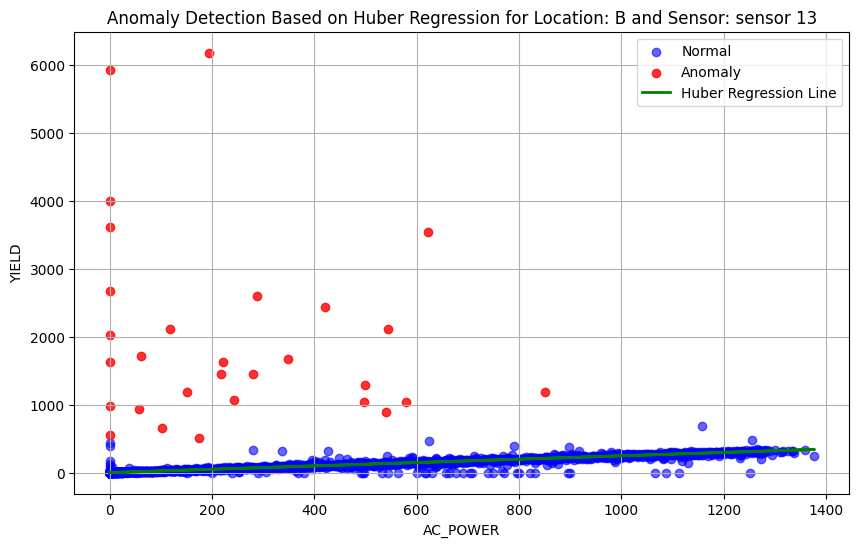

Location: B, Sensor: sensor 13
MSE (All): 53501.9267, MAE (All): 27.1333
MSE (Normal): 827.8810, MAE (Normal): 9.5875
MSE (Anomalous): 5804054.6454, MAE (Anomalous): 1942.6581



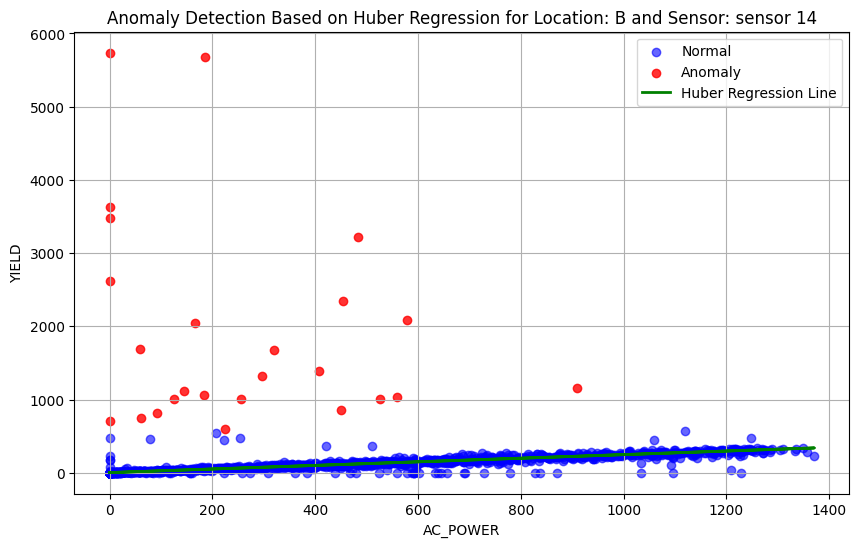

Location: B, Sensor: sensor 14
MSE (All): 59220.7987, MAE (All): 31.2854
MSE (Normal): 1197.2286, MAE (Normal): 11.7026
MSE (Anomalous): 5467017.5312, MAE (Anomalous): 1856.3997



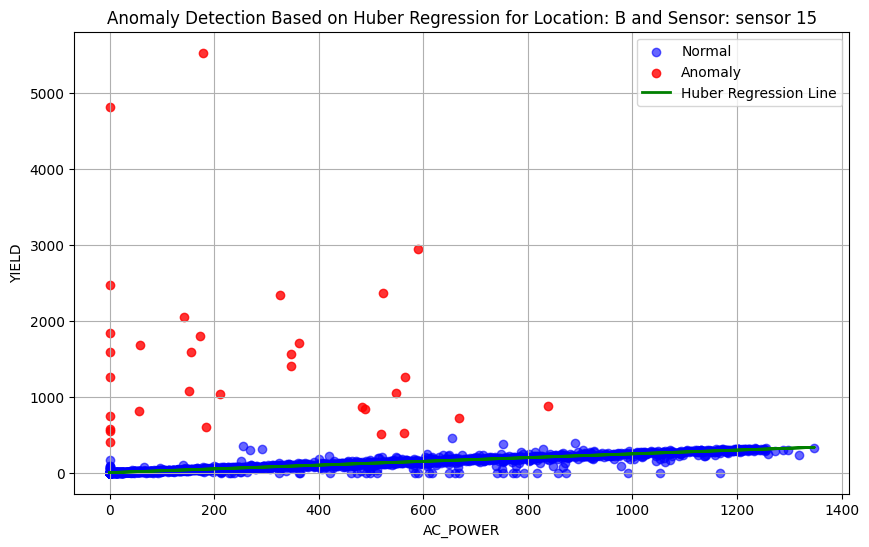

Location: B, Sensor: sensor 15
MSE (All): 34900.8743, MAE (All): 23.2554
MSE (Normal): 596.7596, MAE (Normal): 8.8611
MSE (Anomalous): 3494256.4482, MAE (Anomalous): 1474.8263



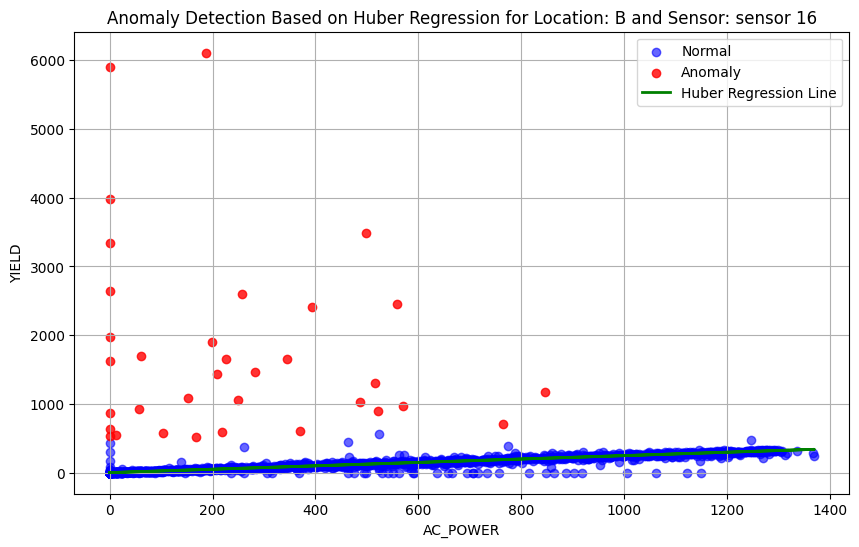

Location: B, Sensor: sensor 16
MSE (All): 52718.7874, MAE (All): 27.3661
MSE (Normal): 761.0354, MAE (Normal): 9.2146
MSE (Anomalous): 4883261.5504, MAE (Anomalous): 1714.9241



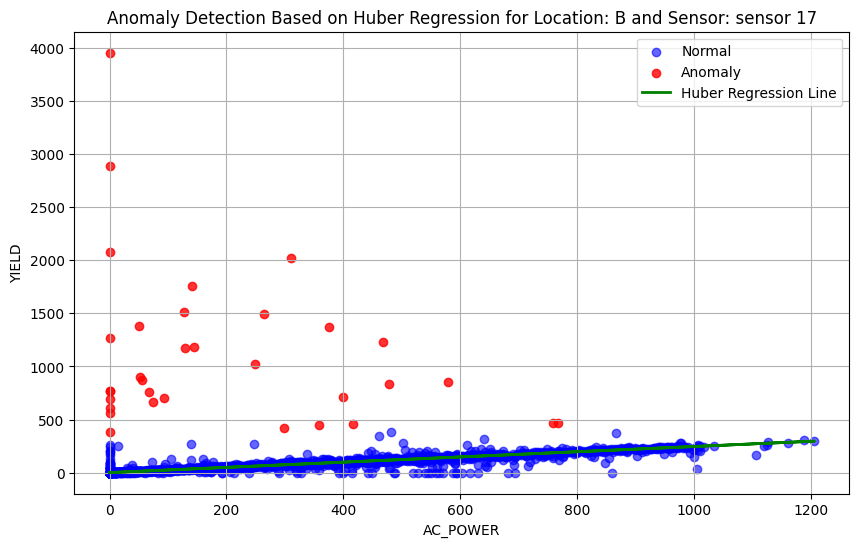

Location: B, Sensor: sensor 17
MSE (All): 18213.6774, MAE (All): 19.0394
MSE (Normal): 563.9842, MAE (Normal): 8.1758
MSE (Anomalous): 1709375.1933, MAE (Anomalous): 1059.9666



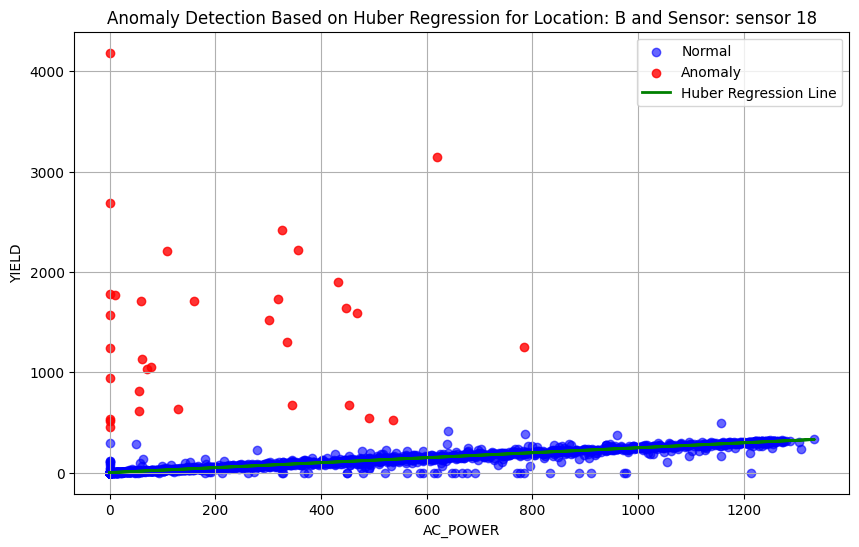

Location: B, Sensor: sensor 18
MSE (All): 27226.1172, MAE (All): 22.6156
MSE (Normal): 573.3894, MAE (Normal): 8.5938
MSE (Anomalous): 2632732.1781, MAE (Anomalous): 1393.3586



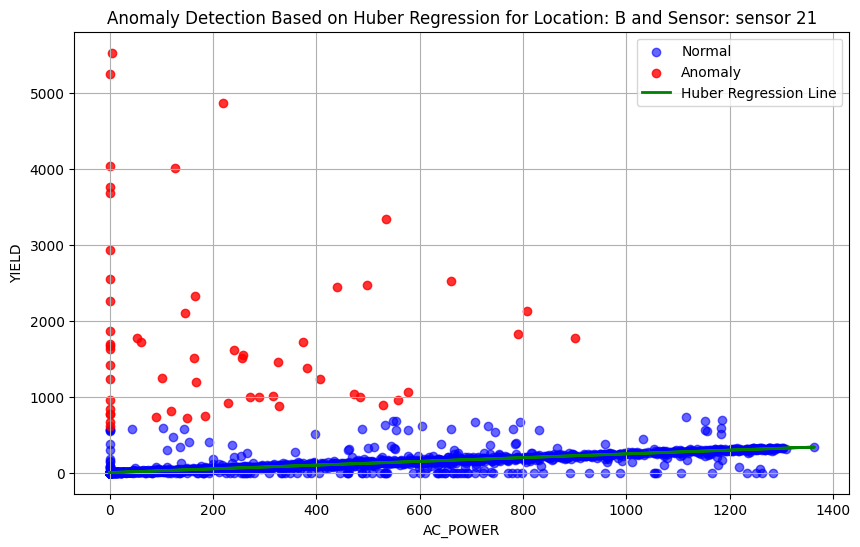

Location: B, Sensor: sensor 21
MSE (All): 82948.7843, MAE (All): 47.3620
MSE (Normal): 3287.3737, MAE (Normal): 16.5583
MSE (Anomalous): 4557963.4671, MAE (Anomalous): 1777.7715



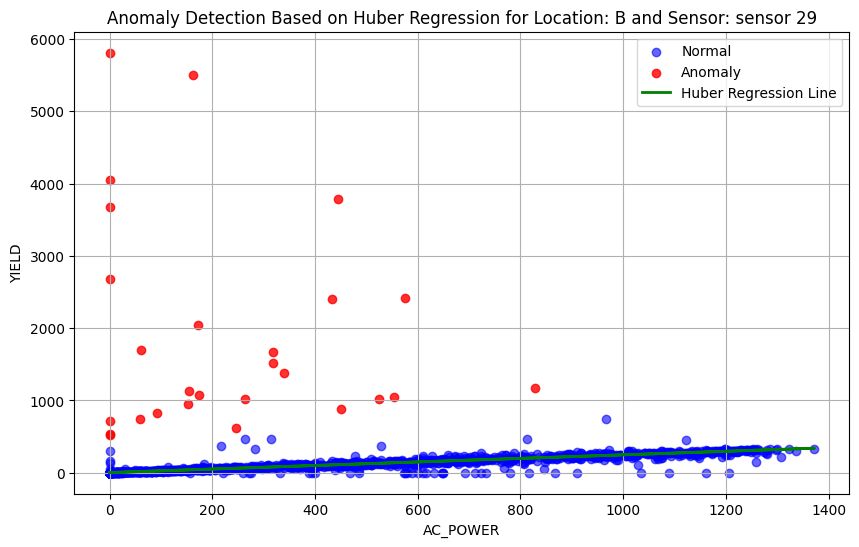

Location: B, Sensor: sensor 29
MSE (All): 63661.9438, MAE (All): 32.3897
MSE (Normal): 1097.2673, MAE (Normal): 11.5890
MSE (Anomalous): 5458127.3833, MAE (Anomalous): 1825.8685



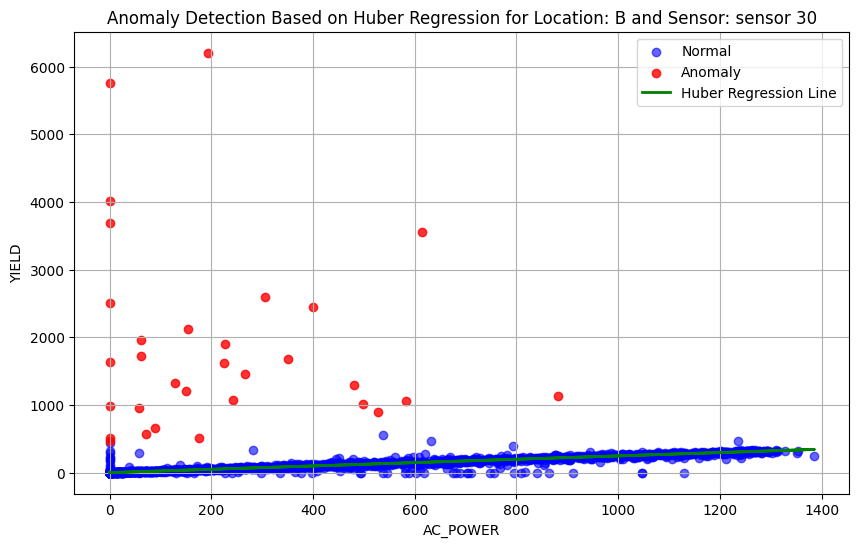

Location: B, Sensor: sensor 30
MSE (All): 52885.3042, MAE (All): 27.0849
MSE (Normal): 806.3969, MAE (Normal): 9.3736
MSE (Anomalous): 5368293.7770, MAE (Anomalous): 1834.7819



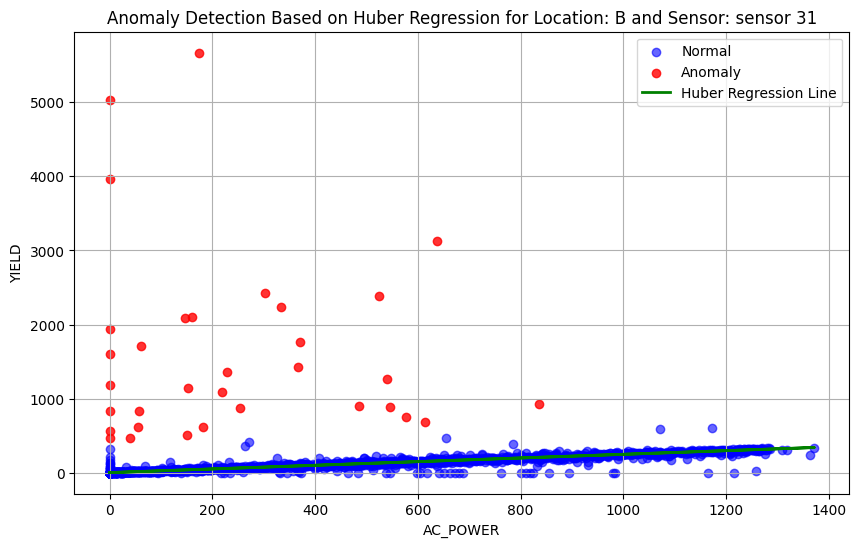

Location: B, Sensor: sensor 31
MSE (All): 41092.1298, MAE (All): 25.1312
MSE (Normal): 749.8803, MAE (Normal): 9.4500
MSE (Anomalous): 3984852.6334, MAE (Anomalous): 1558.0945



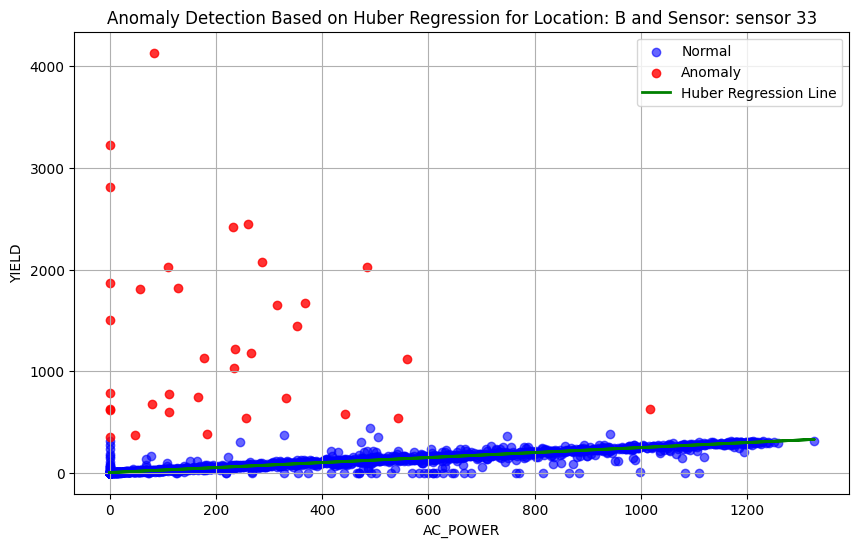

Location: B, Sensor: sensor 33
MSE (All): 27519.3458, MAE (All): 23.2907
MSE (Normal): 710.7445, MAE (Normal): 9.3793
MSE (Anomalous): 2496974.5065, MAE (Anomalous): 1304.7286



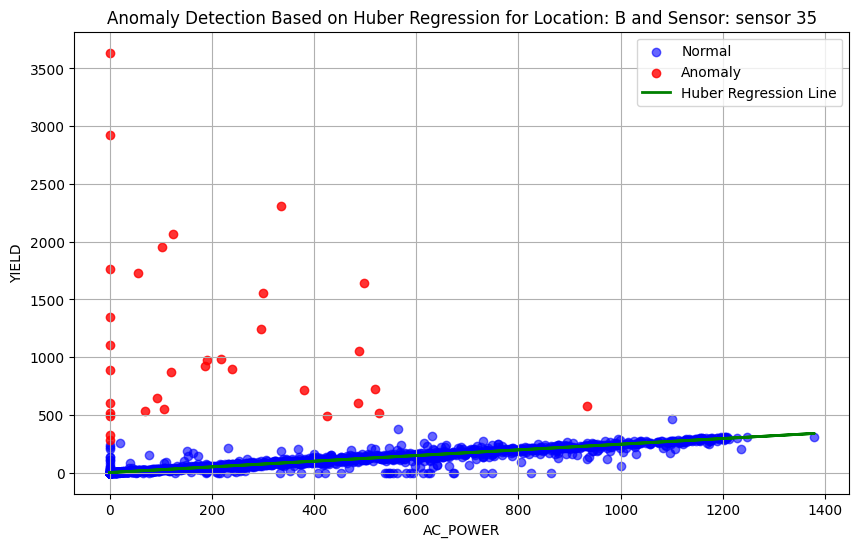

Location: B, Sensor: sensor 35
MSE (All): 18426.6656, MAE (All): 19.3285
MSE (Normal): 519.2981, MAE (Normal): 8.4478
MSE (Anomalous): 1769007.4975, MAE (Anomalous): 1083.0046



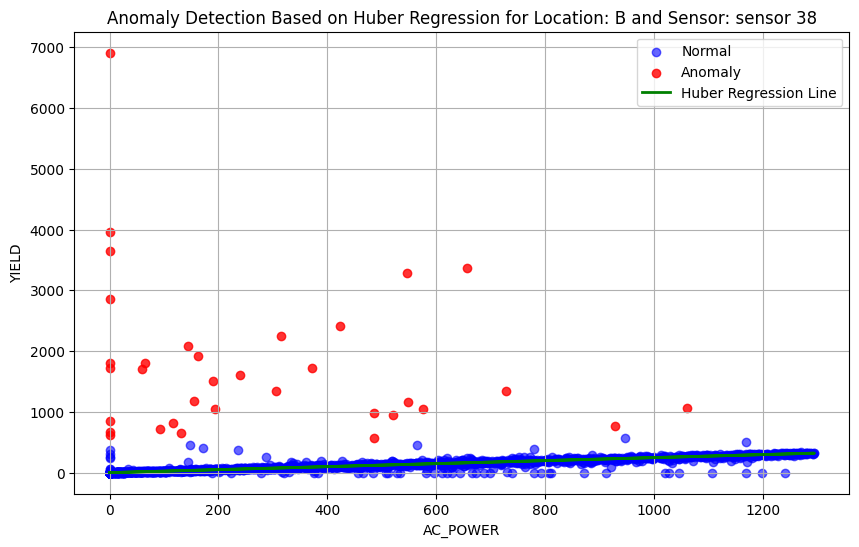

Location: B, Sensor: sensor 38
MSE (All): 48473.7371, MAE (All): 27.3585
MSE (Normal): 915.6504, MAE (Normal): 9.6645
MSE (Anomalous): 4559498.1332, MAE (Anomalous): 1705.6798



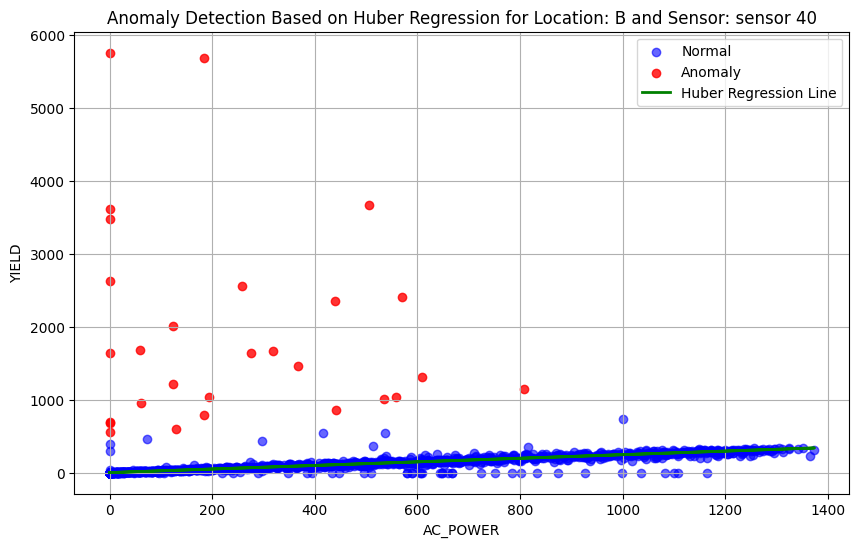

Location: B, Sensor: sensor 40
MSE (All): 65727.2869, MAE (All): 33.7575
MSE (Normal): 1230.9404, MAE (Normal): 11.6193
MSE (Anomalous): 5425834.3668, MAE (Anomalous): 1873.5941



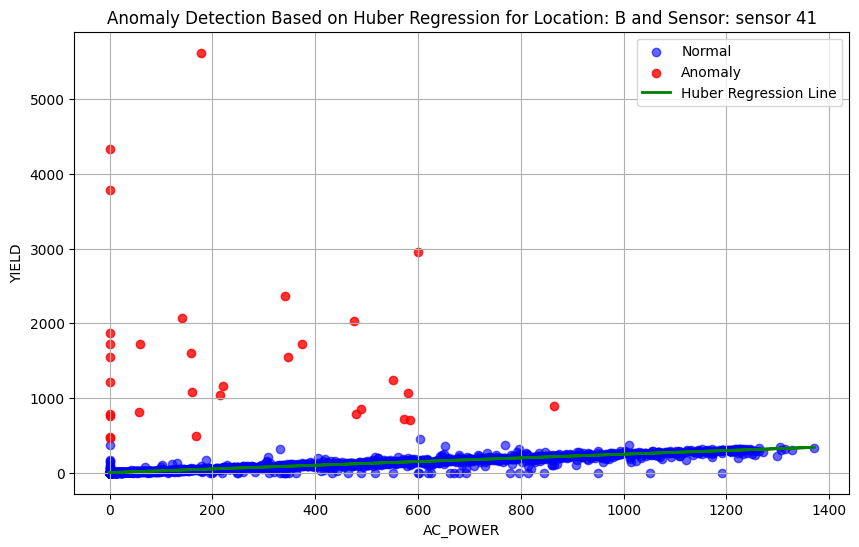

Location: B, Sensor: sensor 41
MSE (All): 35986.1178, MAE (All): 23.7713
MSE (Normal): 609.8137, MAE (Normal): 9.2813
MSE (Anomalous): 3719686.4348, MAE (Anomalous): 1532.6006



In [ ]:
# Initialize the new columns in merged_data
merged_data['yield_anomaly'] = np.nan
merged_data['yield_anomaly_res'] = np.nan
merged_data['yield_std_res'] = np.nan

for location in ['A', 'B']:
    sensor_IDs = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
    for sensor_ID in sensor_IDs:
        data = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor_ID)]

        unique_dates = data['DATE'].unique()
        yield_data = None
        for date in unique_dates:
            x = data[data['DATE'] == date].copy()
            x['DAILY_YIELD'] = x['DAILY_YIELD'].shift(-1).fillna(0)
            x['YIELD'] = x['DAILY_YIELD'].diff()
            x['YIELD'] = x['YIELD'].fillna(0).clip(lower=0)

            if yield_data is None:
                yield_data = x
            else:
                yield_data = pd.concat([yield_data, x])

        # yield_data.dropna(inplace=True)

        X = yield_data['AC_POWER'].to_frame()
        y = yield_data['YIELD']

        # Huber Regression
        model = HuberRegressor()
        model.intercept_ = ac_power_to_yield_models_dict_huber_regression[location][sensor_ID]['intercept']
        model.coef_ = np.array([ac_power_to_yield_models_dict_huber_regression[location][sensor_ID]['slope']])

        y_pred = model.predict(X)

        yield_data['Residuals'] = y - y_pred
        std_residuals = np.std(yield_data['Residuals'])
        threshold = 2 * std_residuals

        yield_data['Anomaly'] = (np.abs(yield_data['Residuals']) > threshold).astype(int)

        # Update the merged_data DataFrame
        indices = yield_data.index
        merged_data.loc[indices, 'yield_anomaly'] = yield_data['Anomaly']
        merged_data.loc[indices, 'yield_anomaly_res'] = yield_data['Residuals']
        merged_data.loc[indices, 'yield_std_res'] = std_residuals

        # Visualization
        normal = yield_data[yield_data['Anomaly'] == 0]
        anomalous = yield_data[yield_data['Anomaly'] == 1]

        plt.figure(figsize=(10, 6))
        plt.scatter(normal['AC_POWER'], normal['YIELD'], color='blue', label='Normal', alpha=0.6)
        plt.scatter(anomalous['AC_POWER'], anomalous['YIELD'], color='red', label='Anomaly', alpha=0.8)

        plt.plot(X, y_pred, color='green', linewidth=2, label='Huber Regression Line')

        plt.title(f'Anomaly Detection Based on Huber Regression for Location: {location} and Sensor: {sensor_ID}')
        plt.xlabel('AC_POWER')
        plt.ylabel('YIELD')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Metrics for all points
        mse_all = mean_squared_error(y, y_pred)
        mae_all = mean_absolute_error(y, y_pred)

        # Metrics for non-outliers
        mse_normal = mean_squared_error(normal['YIELD'], model.predict(normal['AC_POWER'].to_frame()))
        mae_normal = mean_absolute_error(normal['YIELD'], model.predict(normal['AC_POWER'].to_frame()))

        # Metrics for outliers
        if not anomalous.empty:
            mse_anomalous = mean_squared_error(anomalous['YIELD'], model.predict(anomalous['AC_POWER'].to_frame()))
            mae_anomalous = mean_absolute_error(anomalous['YIELD'], model.predict(anomalous['AC_POWER'].to_frame()))
        else:
            mse_anomalous, mae_anomalous = None, None

        print(f"Location: {location}, Sensor: {sensor_ID}")
        print(f"MSE (All): {mse_all:.4f}, MAE (All): {mae_all:.4f}")
        print(f"MSE (Normal): {mse_normal:.4f}, MAE (Normal): {mae_normal:.4f}")
        if mse_anomalous is not None:
            print(f"MSE (Anomalous): {mse_anomalous:.4f}, MAE (Anomalous): {mae_anomalous:.4f}")
        else:
            print("No anomalous data points detected.")
        print()


In [ ]:
merged_data.to_csv('merged_data.csv', index=False)

In [ ]:
merged_data[merged_data['yield_anomaly'] == 1]

,LOCATION,DATE_TIME,SENSOR_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE,MODULE_TEMPERATURE,IRRADIATION,...,TIME,power_gen_anomaly,power_gen_anomaly_res,power_gen_anomaly_std_res,yield_anomaly,yield_anomaly_res,yield_std_res,power_conv_anomaly,power_conv_anomaly_res,power_conv_anomaly_std_res
9124,A,2020-05-19 11:30:00,sensor 1,3586.750000,352.550000,2230.750000,6.285879e+06,28.081734,40.725124,0.283390,...,11:30:00,0.0,-163.448088,949.140928,1.0,959.383334,52.809129,1.0,1.430741,0.939180
9125,A,2020-05-19 11:30:00,sensor 2,4180.750000,410.725000,2513.250000,6.212319e+06,28.081734,40.725124,0.283390,...,11:30:00,0.0,96.583485,496.885862,1.0,939.779819,56.929181,0.0,1.561889,1.157881
9126,A,2020-05-19 11:30:00,sensor 3,4041.250000,397.075000,2467.000000,7.016385e+06,28.081734,40.725124,0.283390,...,11:30:00,0.0,-47.895942,584.326035,1.0,963.321493,56.348296,NaN,NaN,NaN
9127,A,2020-05-19 11:30:00,sensor 5,3901.250000,383.375000,2421.250000,7.630793e+06,28.081734,40.725124,0.283390,...,11:30:00,0.0,-68.758390,469.439007,1.0,982.147349,56.279089,NaN,NaN,NaN
9128,A,2020-05-19 11:30:00,sensor 12,4099.250000,402.775000,2490.500000,7.187582e+06,28.081734,40.725124,0.283390,...,11:30:00,0.0,12.421857,660.017860,1.0,950.044382,58.253542,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135613,B,2020-06-17 14:00:00,sensor 33,321.933333,315.293333,1344.066667,3.463129e+05,29.044236,42.326256,0.480736,...,14:00:00,0.0,-304.318028,275.019077,1.0,1569.443179,165.414404,NaN,NaN,NaN
135614,B,2020-06-17 14:00:00,sensor 35,306.540000,300.266667,1265.733333,8.075342e+07,29.044236,42.326256,0.480736,...,14:00:00,0.0,-276.186792,272.485651,1.0,1478.475685,135.400191,NaN,NaN,NaN
135615,B,2020-06-17 14:00:00,sensor 38,379.306667,371.353333,1408.600000,1.779338e+06,29.044236,42.326256,0.480736,...,14:00:00,0.0,-282.756252,247.628526,1.0,1633.528334,219.562436,NaN,NaN,NaN
135616,B,2020-06-17 14:00:00,sensor 40,325.480000,318.760000,1361.933333,7.126339e+07,29.044236,42.326256,0.480736,...,14:00:00,1.0,-331.299281,118.891034,1.0,1591.499819,255.565582,NaN,NaN,NaN


## DC POWER vs AC POWER Model

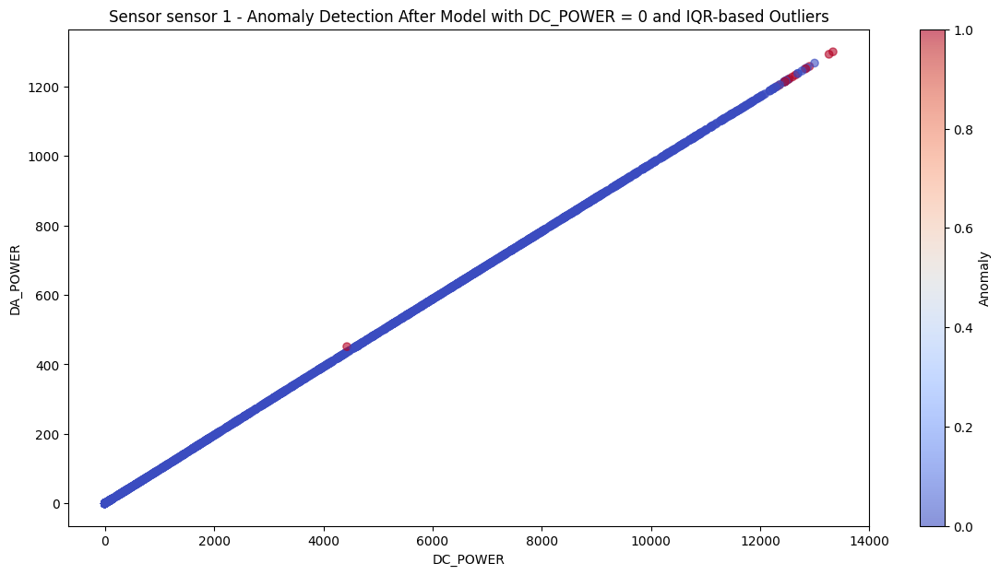

Sensor sensor 1 - Anomalies detected: 15
          DC_POWER     AC_POWER  Residuals
14154  13335.14286  1300.171429  -3.991323
16050  12360.00000  1205.100000  -3.708862
16116  12904.62500  1258.187500  -3.877264
18140  12591.75000  1227.712500  -3.757928
22268  12465.37500  1215.387500  -3.725407
22378  12465.85714  1215.428571  -3.731482
26480  12451.00000  1214.000000  -3.707255
26502  12647.33333  1233.116667  -3.788951
31996  12313.28571  1200.557143  -3.683784
32018  12462.62500  1215.100000  -3.744000
34102  13262.62500  1293.087500  -3.984127
42668  12519.14286  1220.642857  -3.727715
46646  12455.62500  1214.412500  -3.747008
59318  12836.14286  1251.528571  -3.839699
61122   4431.00000   451.285714  17.810416


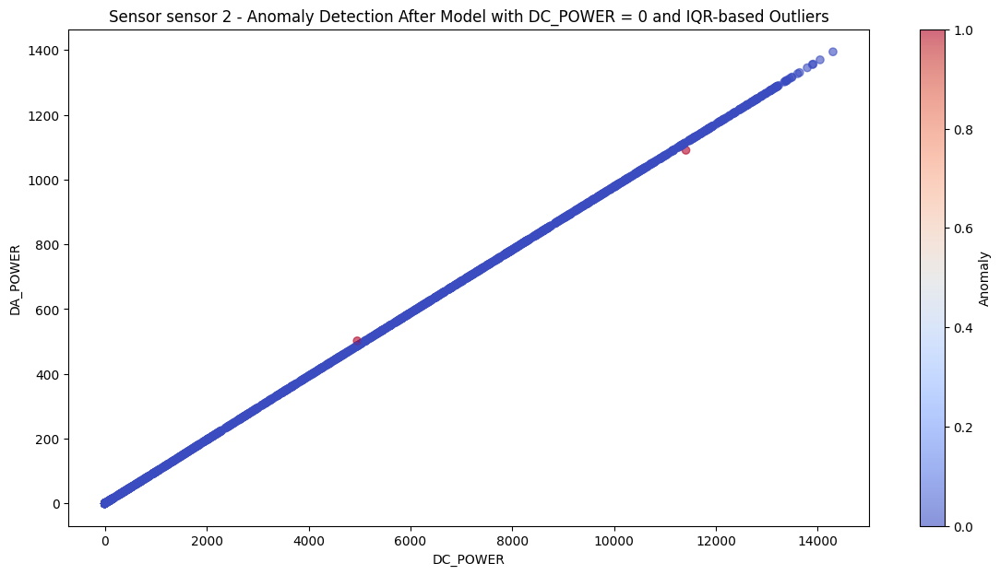

Sensor sensor 2 - Anomalies detected: 2
       DC_POWER     AC_POWER  Residuals
14287  11413.25  1090.557143 -25.086546
61123   4955.75   501.742857  17.178350


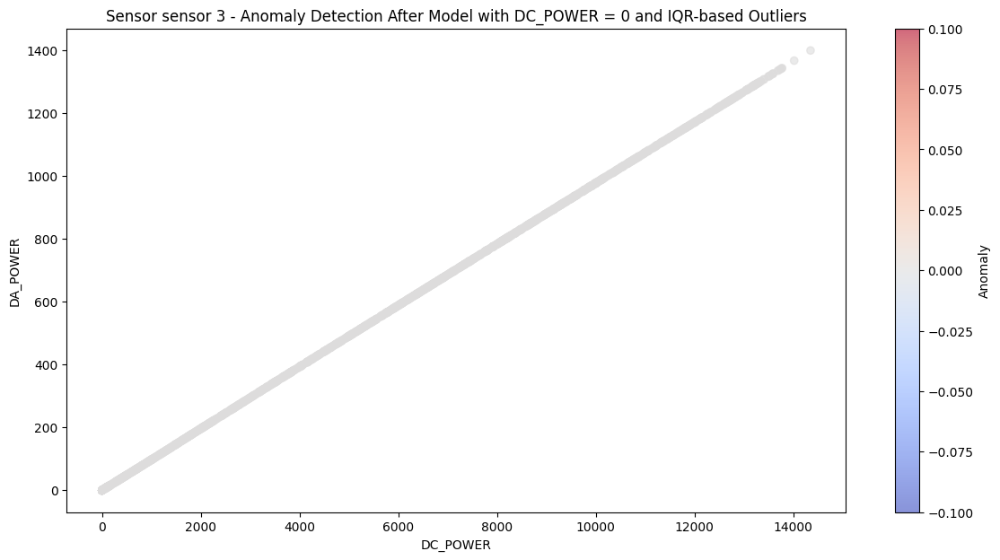

Sensor sensor 3 - Anomalies detected: 0
Empty DataFrame
Columns: [DC_POWER, AC_POWER, Residuals]
Index: []


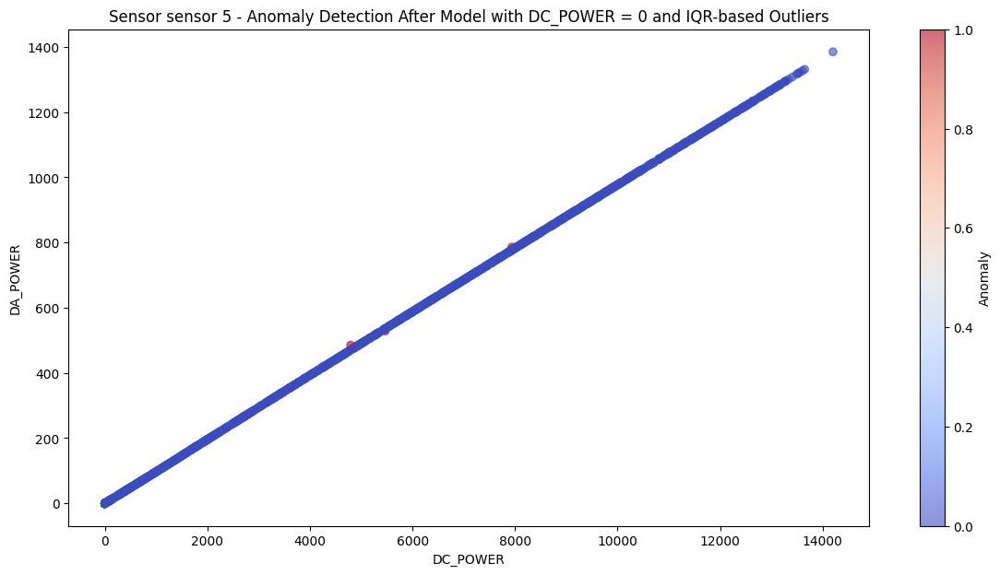

Sensor sensor 5 - Anomalies detected: 3
          DC_POWER    AC_POWER  Residuals
24673  5465.571429  528.375000  -6.071343
38525  7940.000000  785.700000   9.400194
61125  4792.500000  484.928571  16.268995


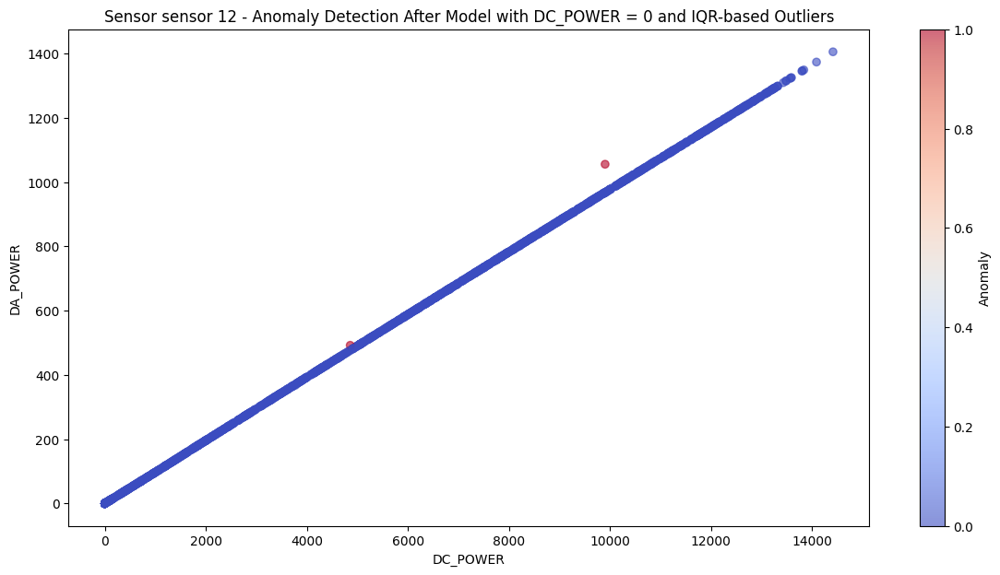

Sensor sensor 12 - Anomalies detected: 2
          DC_POWER     AC_POWER  Residuals
14290  9904.571429  1055.750000  87.598272
61126  4856.250000   492.114286  17.299213


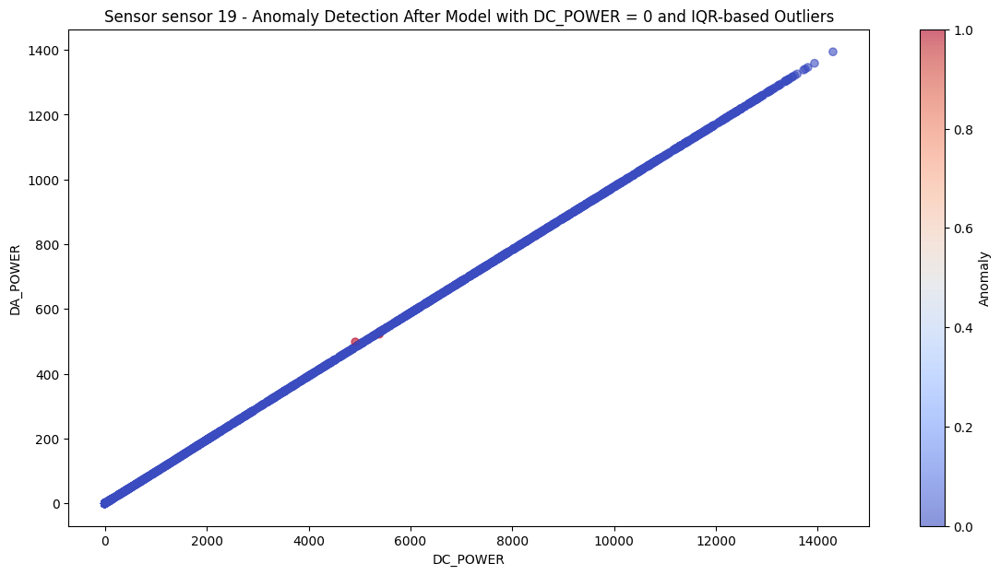

Sensor sensor 19 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
24675  5388.714286  522.562500  -4.294769
61127  4917.500000  498.242857  17.434714


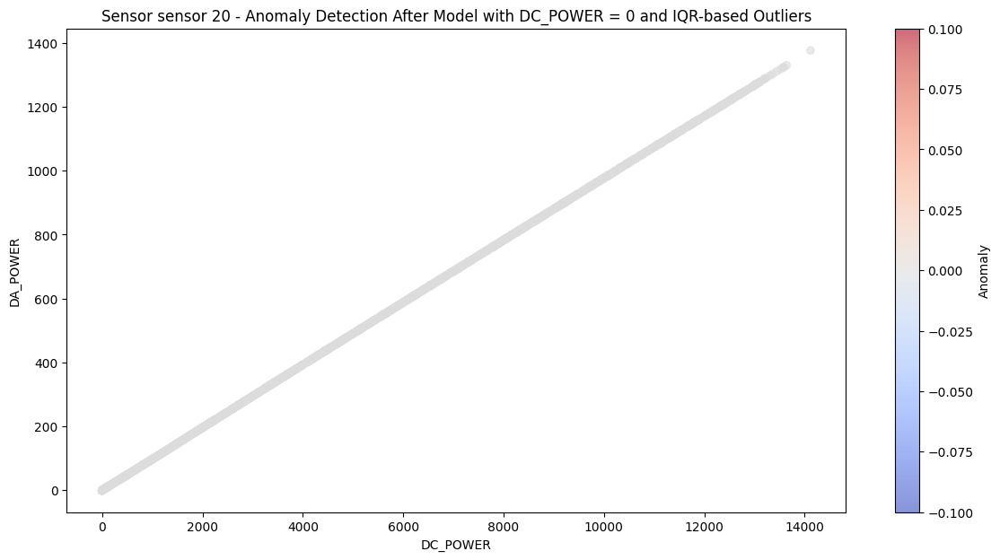

Sensor sensor 20 - Anomalies detected: 0
Empty DataFrame
Columns: [DC_POWER, AC_POWER, Residuals]
Index: []


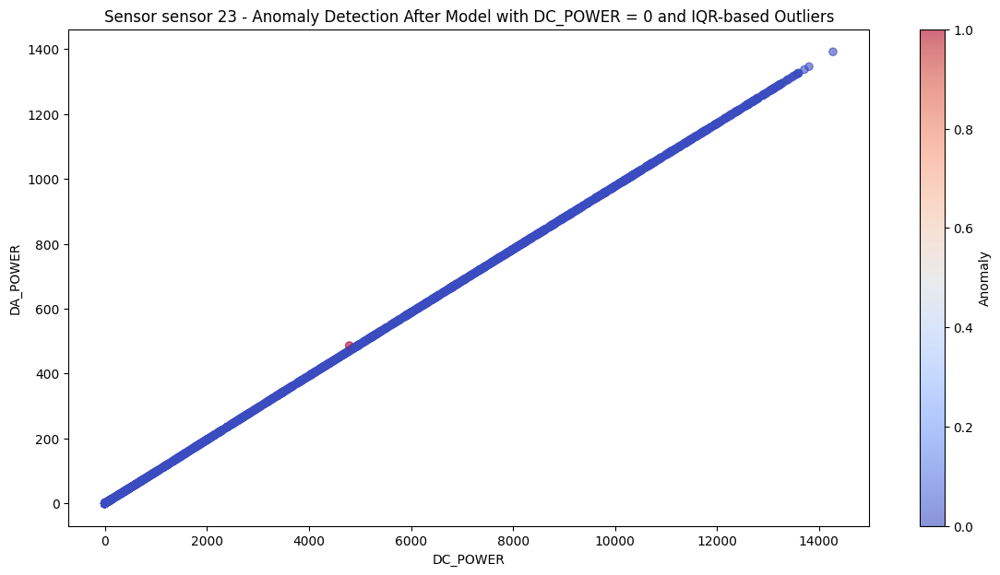

Sensor sensor 23 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61130  4791.625  486.114286  17.581262


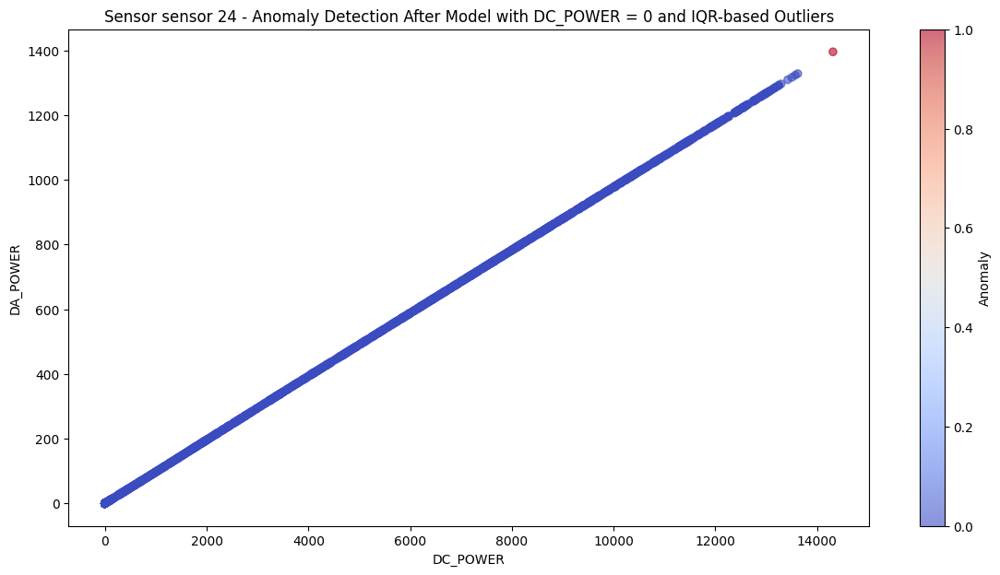

Sensor sensor 24 - Anomalies detected: 1
          DC_POWER     AC_POWER  Residuals
61615  14312.71429  1395.485714  -3.703568


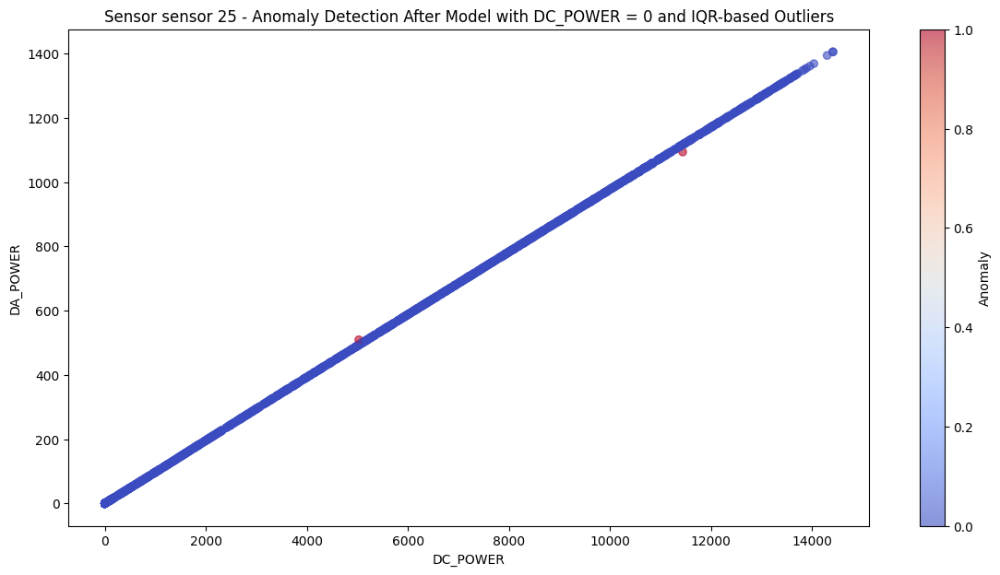

Sensor sensor 25 - Anomalies detected: 2
       DC_POWER     AC_POWER  Residuals
14296  11439.50  1093.771429 -24.321018
61132   5025.75   509.042857  17.682903


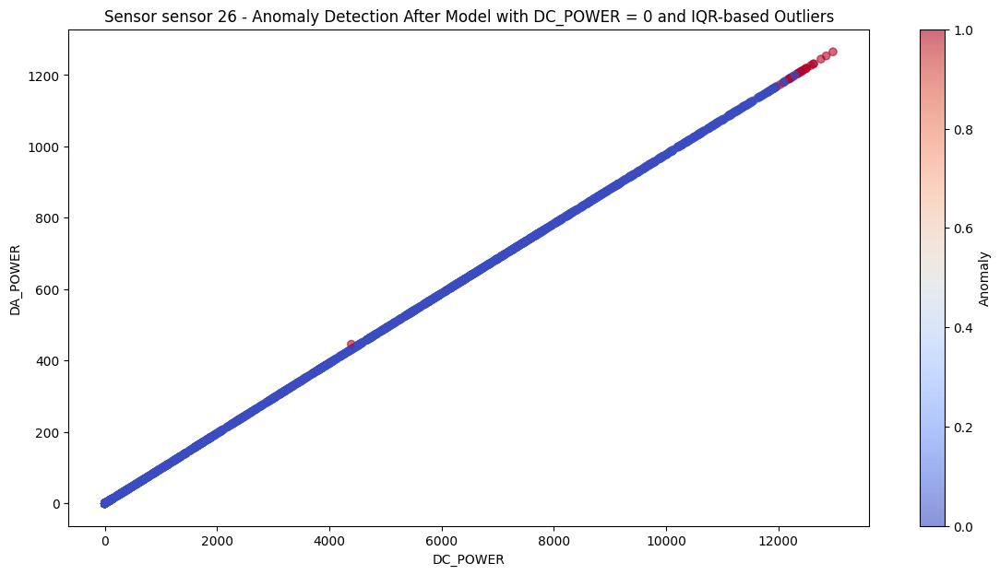

Sensor sensor 26 - Anomalies detected: 24
          DC_POWER     AC_POWER  Residuals
12093  12273.12500  1196.612500  -3.857324
14165  12976.00000  1265.157143  -4.052520
14209  12353.42857  1204.642857  -3.680504
16061  12090.28571  1178.814286  -3.774203
16083  12375.12500  1206.887500  -3.557730
16127  12499.75000  1218.750000  -3.883318
18085  11818.85714  1152.514286  -3.529005
26447  12031.57143  1173.085714  -3.760630
26513  12408.33333  1209.800000  -3.892942
26579  11950.14286  1165.142857  -3.739928
29961  12855.57143  1253.785714  -3.646264
32029  12579.50000  1226.487500  -3.945217
32139  12623.28571  1230.757143  -3.957733
34113  12477.37500  1216.825000  -3.620086
38357  12762.42857  1244.714286  -3.608497
40583  12436.42857  1212.557143  -3.883460
42679  12233.57143  1192.757143  -3.844417
42701  12201.00000  1189.575000  -3.841136
46547  12397.85714  1209.142857  -3.525533
46591  12502.57143  1219.342857  -3.566392
46657  12198.37500  1189.637500  -3.521916
52993  12337

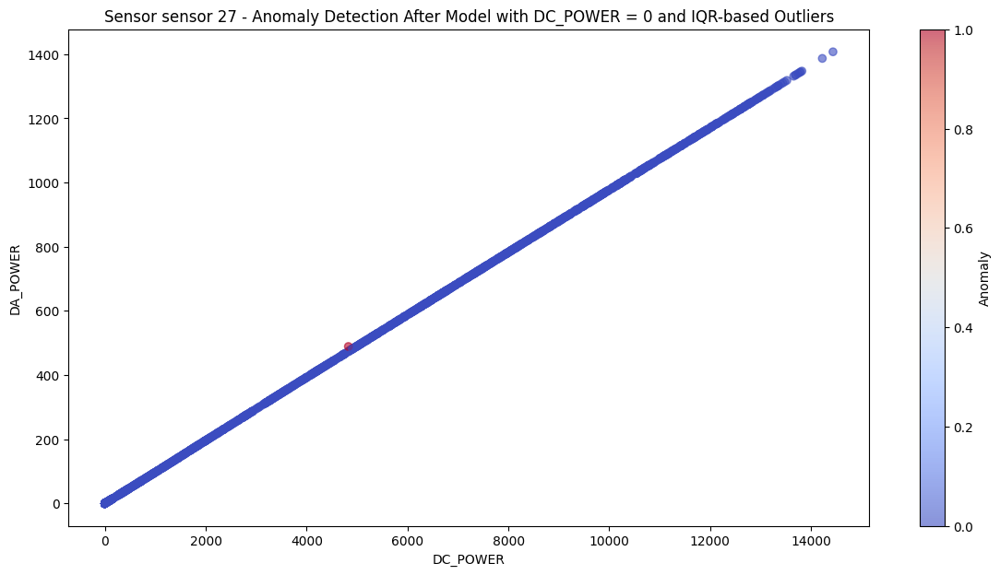

Sensor sensor 27 - Anomalies detected: 1
       DC_POWER  AC_POWER  Residuals
61134  4825.875     489.0  17.129329


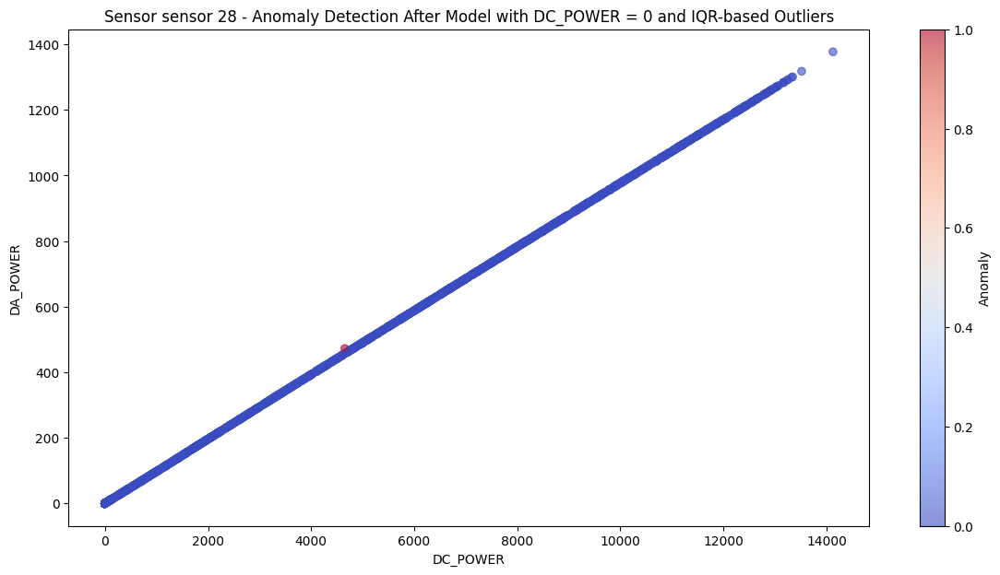

Sensor sensor 28 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61135  4653.375  472.085714  17.002157


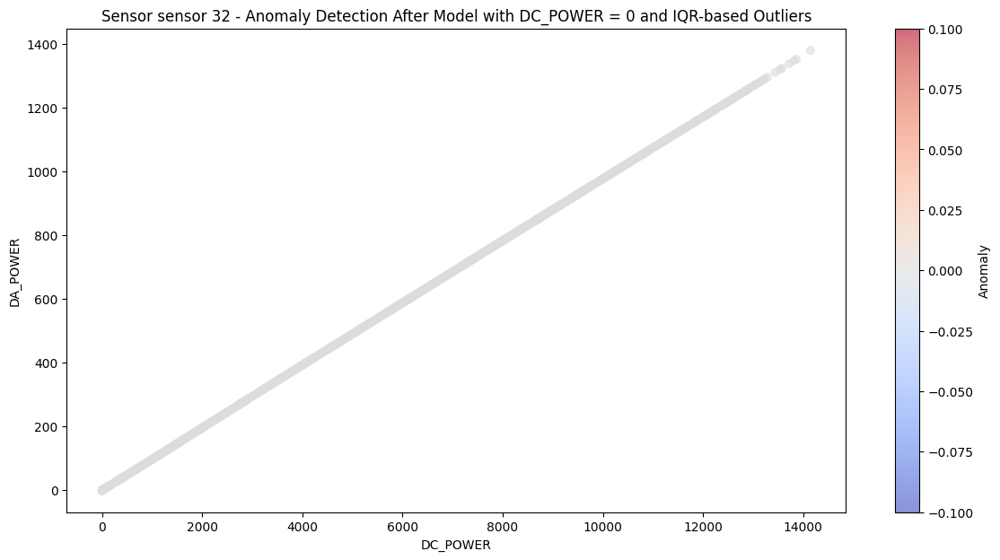

Sensor sensor 32 - Anomalies detected: 0
Empty DataFrame
Columns: [DC_POWER, AC_POWER, Residuals]
Index: []


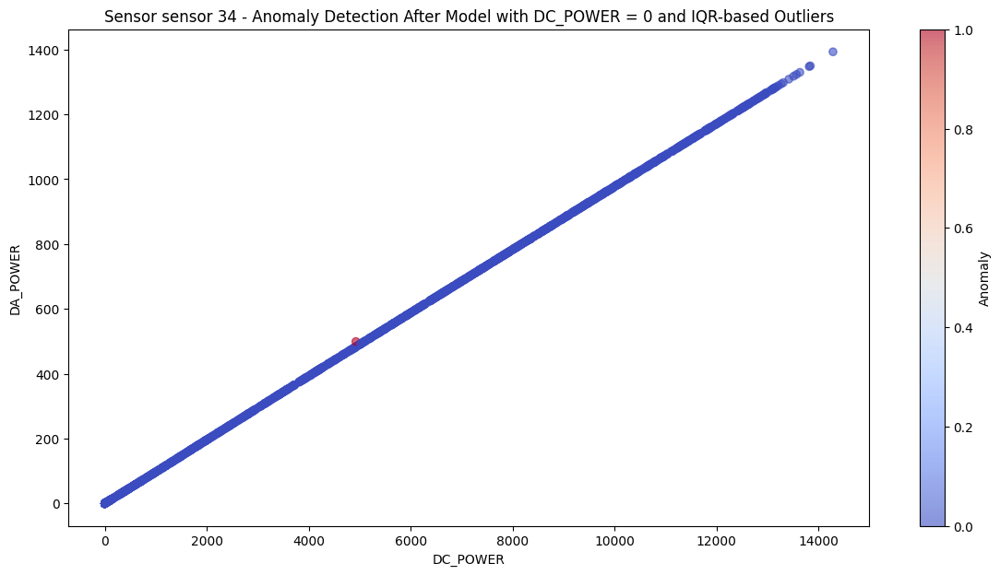

Sensor sensor 34 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61137    4923.0  499.114286  17.725235


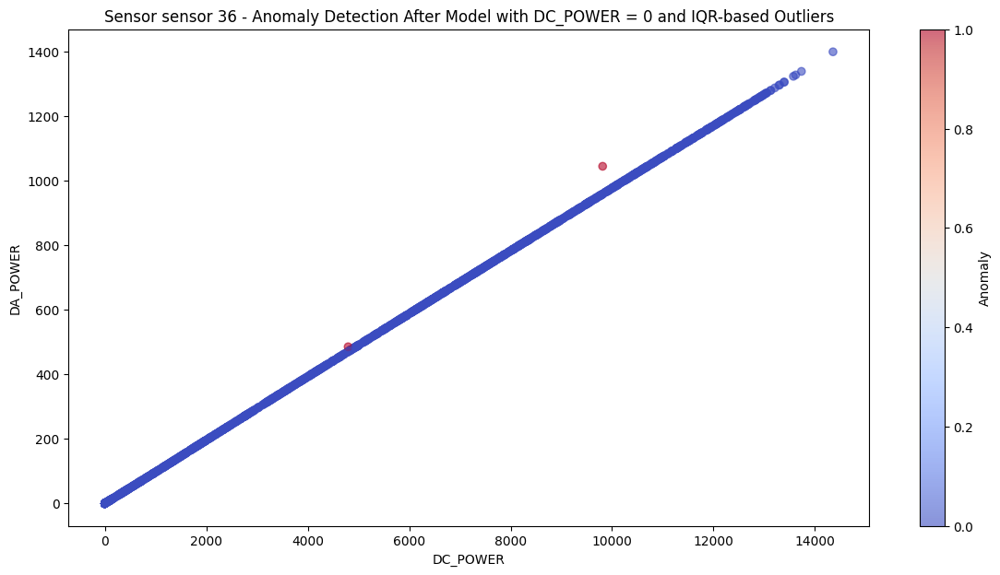

Sensor sensor 36 - Anomalies detected: 2
          DC_POWER  AC_POWER  Residuals
14302  9814.285714    1044.9  85.442715
61138  4795.125000     485.4  16.502550


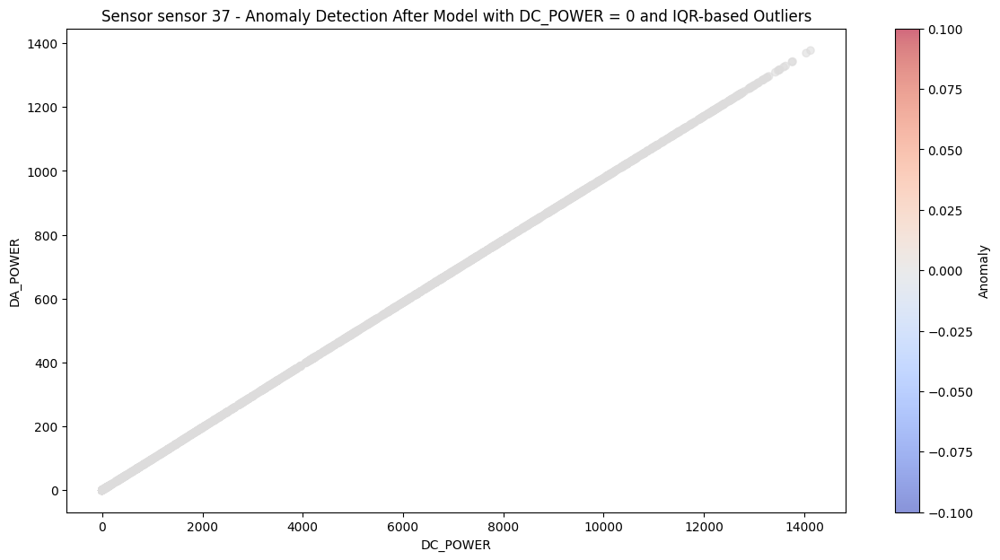

Sensor sensor 37 - Anomalies detected: 0
Empty DataFrame
Columns: [DC_POWER, AC_POWER, Residuals]
Index: []


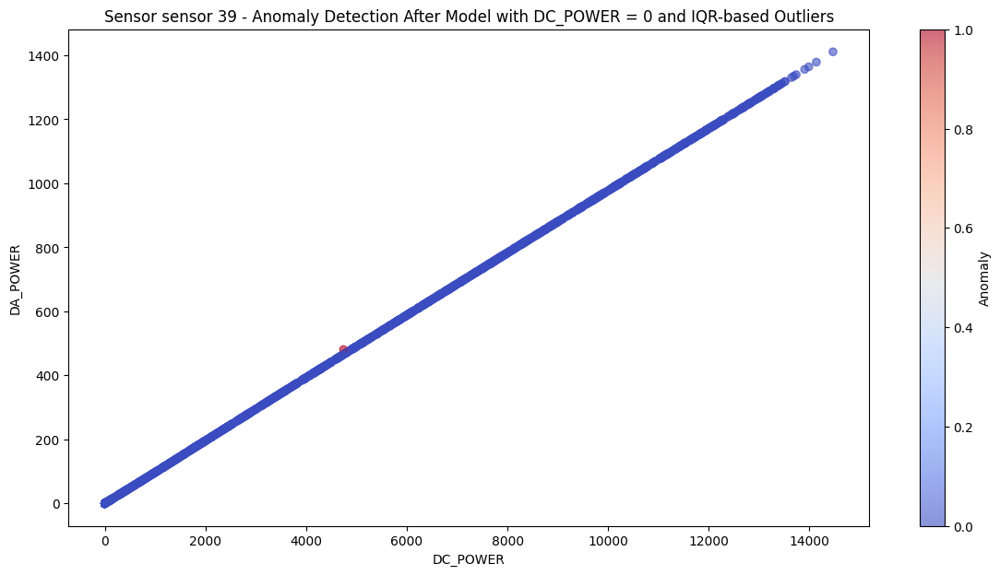

Sensor sensor 39 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61140    4740.5  480.485714  16.950208


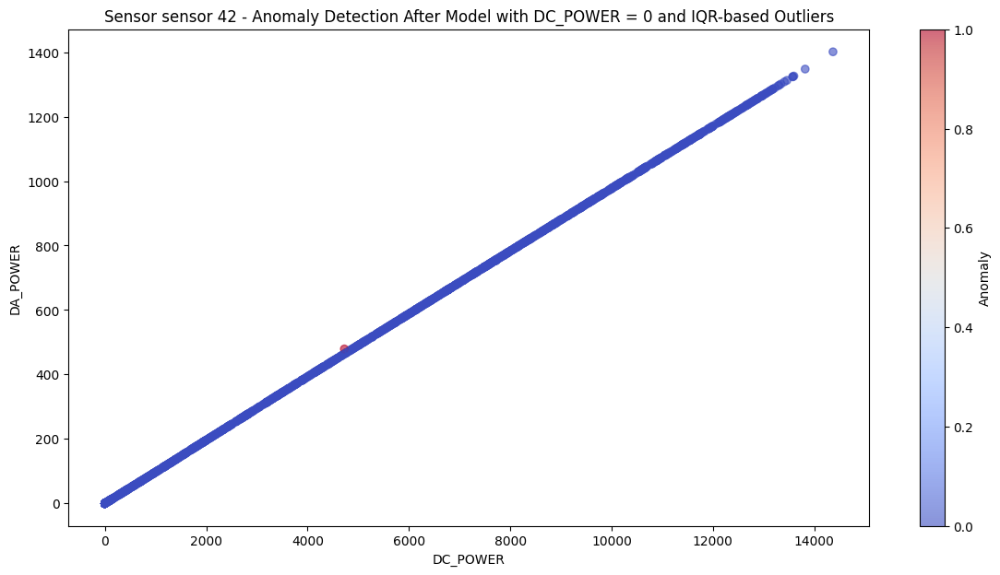

Sensor sensor 42 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61141  4724.375  479.185714  17.203136


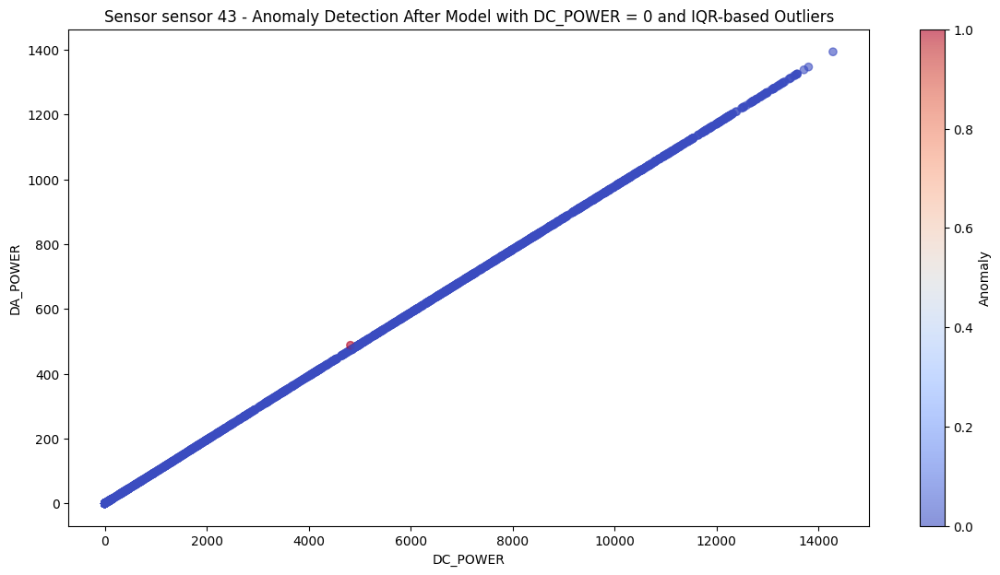

Sensor sensor 43 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61142   4818.25  487.728571  16.547174


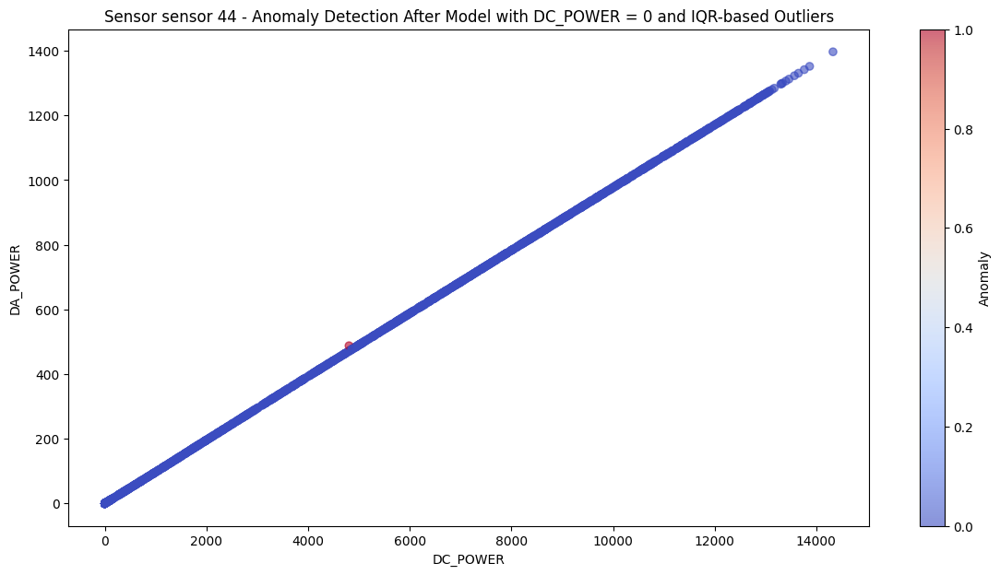

Sensor sensor 44 - Anomalies detected: 1
       DC_POWER    AC_POWER  Residuals
61143  4802.875  487.671429  18.049165


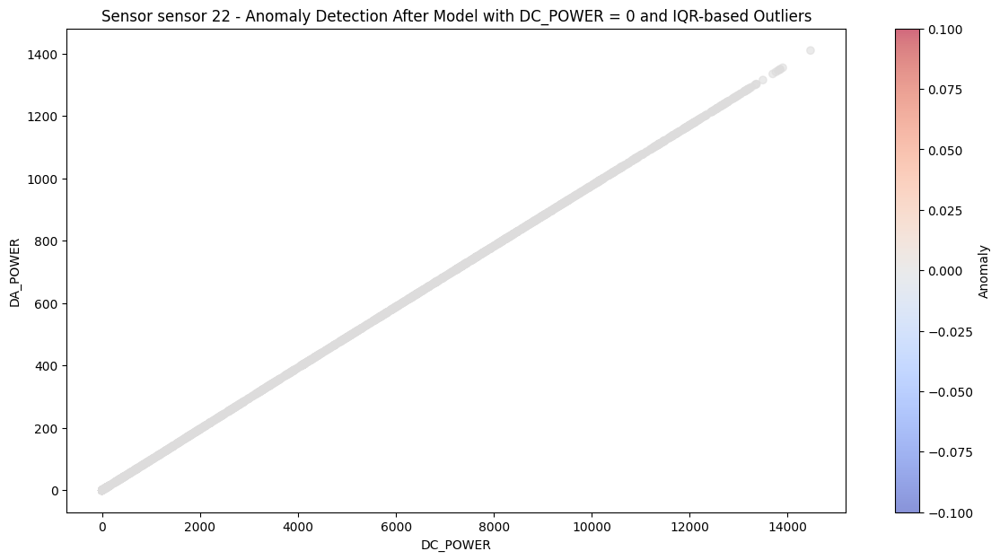

Sensor sensor 22 - Anomalies detected: 0
Empty DataFrame
Columns: [DC_POWER, AC_POWER, Residuals]
Index: []


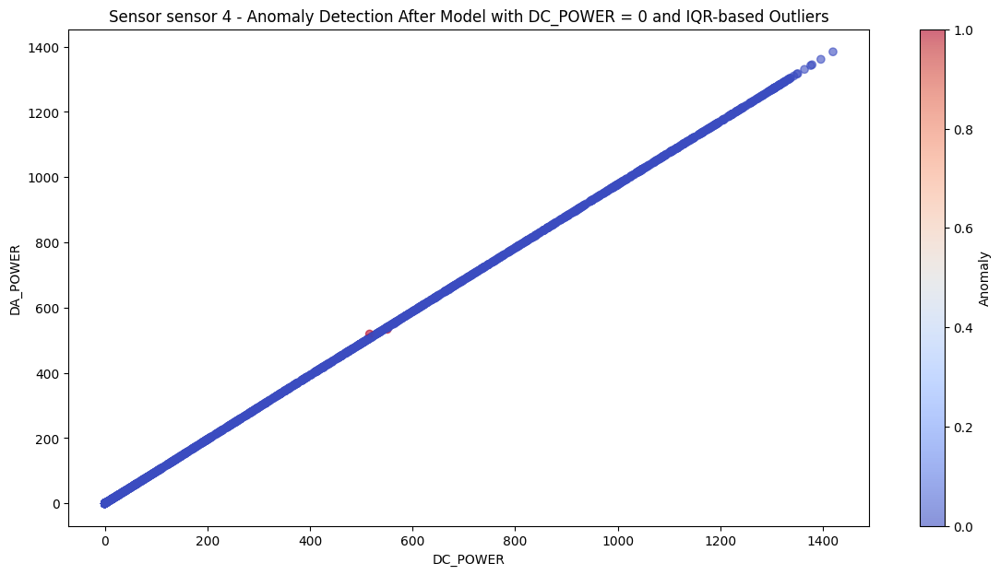

Sensor sensor 4 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
106028  550.500000  533.450000  -4.720557
128776  516.046667  519.185714  14.685245


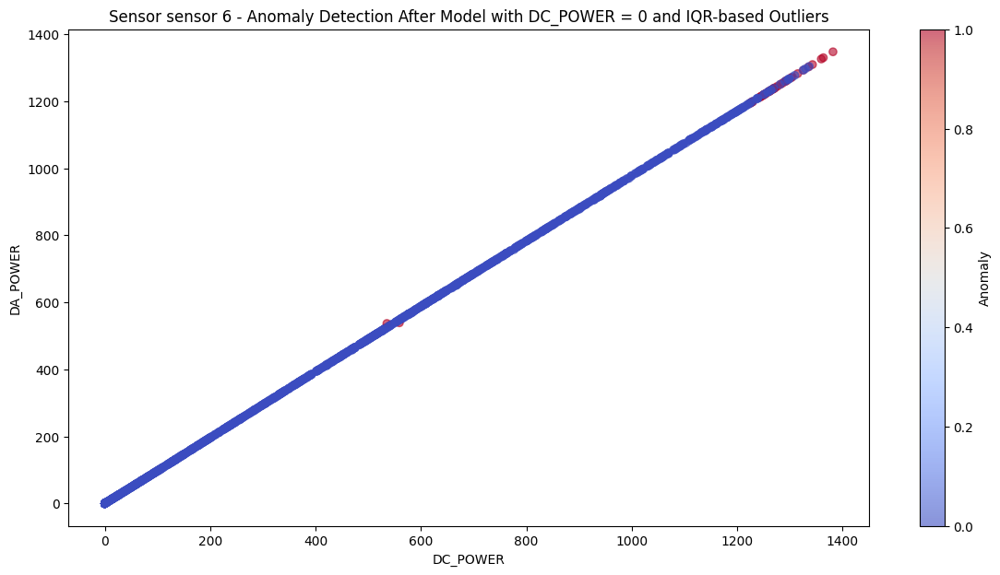

Sensor sensor 6 - Anomalies detected: 40
           DC_POWER     AC_POWER  Residuals
78173   1343.250000  1309.664286  -4.064140
78217   1294.740000  1262.566667  -3.721394
78239   1326.073333  1293.013333  -3.917167
78261   1335.600000  1302.386667  -3.860440
78371   1315.271429  1282.600000  -3.766775
81545   1292.113333  1259.813333  -3.905978
81563   1242.220000  1211.160000  -3.766115
81581   1245.893333  1214.733333  -3.785118
81599   1282.786667  1250.726667  -3.871629
81617   1302.592857  1270.021429  -3.946335
81635   1292.340000  1260.026667  -3.914313
81653   1286.986667  1254.800000  -3.905686
81671   1269.193333  1237.446667  -3.858025
81689   1227.380000  1196.693333  -3.720000
81707   1230.028571  1199.257143  -3.746362
85001   1254.566667  1223.206667  -3.793873
85019   1260.666667  1229.146667  -3.819370
85037   1272.433333  1240.606667  -3.866584
85055   1269.664286  1237.928571  -3.836689
88493   1246.240000  1215.066667  -3.790808
88511   1249.880000  1218.660000  -

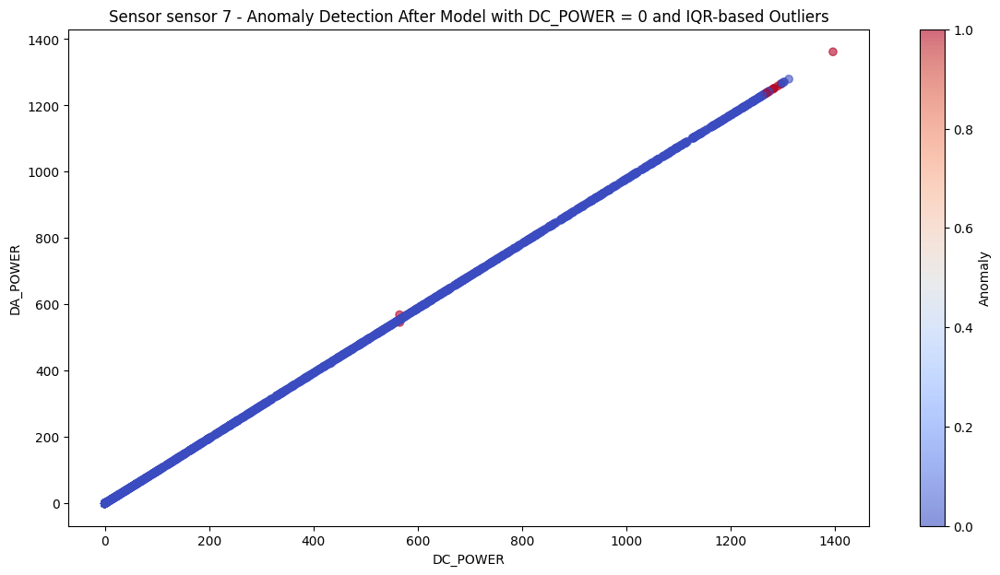

Sensor sensor 7 - Anomalies detected: 14
           DC_POWER     AC_POWER  Residuals
69792   1273.593333  1241.766667  -3.828970
78196   1296.946667  1264.580000  -3.853668
81546   1283.213333  1251.140000  -3.863367
81600   1280.060000  1248.060000  -3.859614
81618   1296.528571  1264.114286  -3.910512
81636   1290.320000  1258.060000  -3.893222
81654   1283.580000  1251.486667  -3.875276
81672   1269.340000  1237.600000  -3.836155
90240   1265.340000  1233.693333  -3.831084
93714   1273.321429  1241.478571  -3.851160
103720  1269.371429  1237.628571  -3.838319
106030   565.580000   545.550000  -7.654958
112212  1396.586667  1361.666667  -4.208397
128778   565.013333   568.764286  16.113491


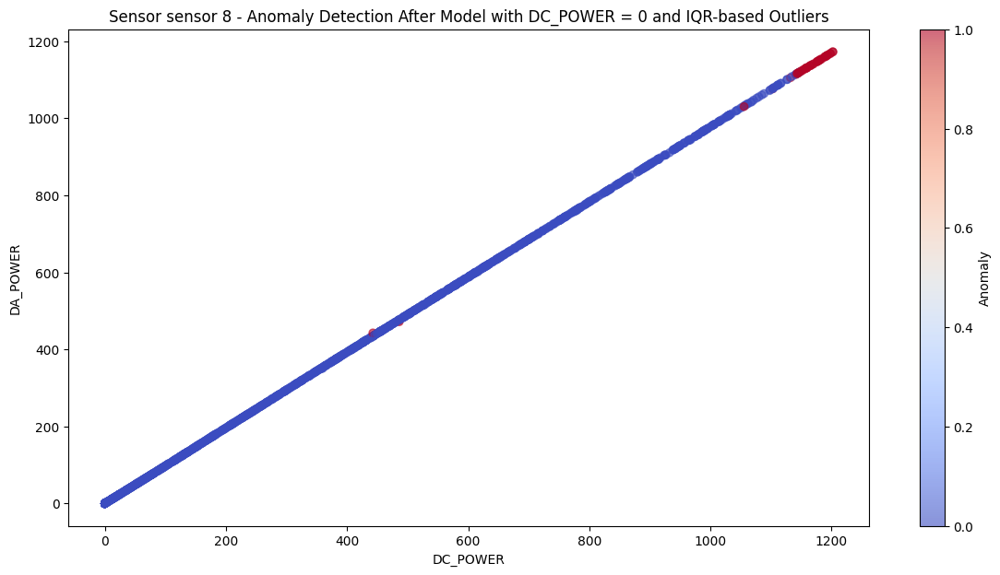

Sensor sensor 8 - Anomalies detected: 44
           DC_POWER     AC_POWER  Residuals
71883   1158.866667  1130.920000  -3.375999
71905   1181.140000  1151.920000  -4.176551
71927   1189.686667  1160.400000  -4.061804
81547   1103.100000  1076.460000  -3.253052
81601   1156.493333  1128.526667  -3.446376
81619   1176.971429  1147.635714  -4.380749
81637   1165.840000  1137.100000  -4.021314
81655   1160.033333  1131.740000  -3.697901
81673   1145.120000  1117.906667  -2.934456
90259   1175.650000  1146.414286  -4.308798
90277   1141.280000  1113.600000  -3.482632
90313   1149.706667  1122.006667  -3.323765
90331   1132.313333  1105.326667  -2.979628
91915   1157.786667  1129.766667  -3.472256
91933   1177.066667  1147.653333  -4.456347
91951   1179.233333  1149.760000  -4.470356
91969   1192.171429  1162.364286  -4.529538
91987   1189.440000  1159.686667  -4.533706
92005   1184.793333  1155.193333  -4.479005
92023   1170.720000  1141.526667  -4.371063
92041   1165.473333  1137.033333  -

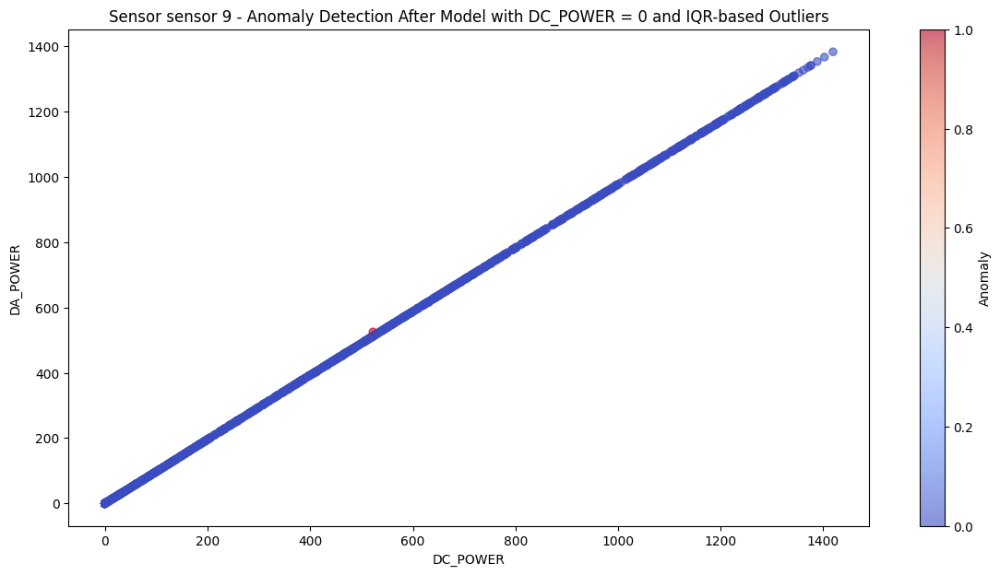

Sensor sensor 9 - Anomalies detected: 1
          DC_POWER    AC_POWER  Residuals
128780  522.166667  525.235714  14.763441


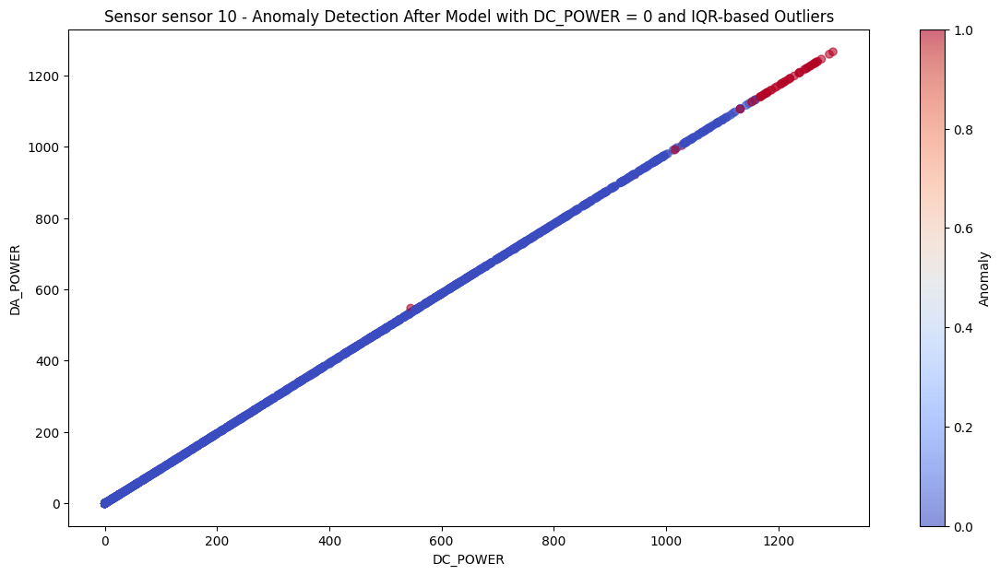

Sensor sensor 10 - Anomalies detected: 48
           DC_POWER     AC_POWER  Residuals
69707   1188.420000  1158.713333  -4.414539
69729   1236.613333  1205.700000  -4.594406
69751   1250.264286  1219.014286  -4.640228
69773   1257.740000  1226.300000  -4.670951
69795   1277.140000  1245.206667  -4.750951
69861   1270.378571  1238.614286  -4.725962
69883   1253.473333  1222.146667  -4.648523
69905    944.780000   921.160000  -3.518827
69949   1194.293333  1164.900000  -3.976069
69971   1198.100000  1168.478571  -4.123060
69993   1180.933333  1152.046667  -3.754048
81710   1028.160000  1002.613333  -3.669013
83222   1169.846667  1140.760000  -4.190259
83240   1204.386667  1174.273333  -4.481022
83258   1217.673333  1187.213333  -4.544605
83276   1238.780000  1207.793333  -4.621577
83294   1257.686667  1226.240000  -4.678754
83312   1264.500000  1232.885714  -4.701209
83330   1262.726667  1231.146667  -4.704706
83348   1266.720000  1235.053333  -4.706291
83366   1269.346667  1237.626667  

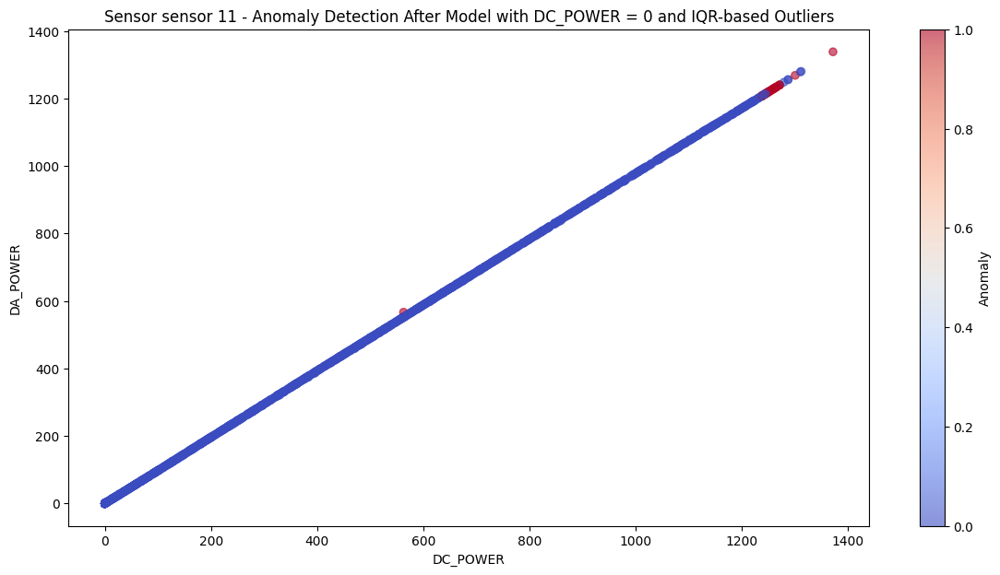

Sensor sensor 11 - Anomalies detected: 37
           DC_POWER     AC_POWER  Residuals
69752   1246.300000  1215.121429  -3.817708
69774   1251.740000  1220.446667  -3.812593
69796   1271.626667  1239.853333  -3.854365
69862   1266.035714  1234.378571  -3.861379
69884   1249.353333  1218.106667  -3.818520
69906   1272.233333  1240.446667  -3.854330
71886   1265.833333  1234.193333  -3.848695
71908   1254.086667  1222.720000  -3.834215
86769   1237.873333  1206.913333  -3.784829
86787   1238.080000  1207.113333  -3.786942
86805   1244.446667  1213.333333  -3.793311
86823   1239.593333  1208.593333  -3.786927
88515   1243.660000  1212.566667  -3.790646
88533   1250.146667  1218.893333  -3.807704
88551   1244.007143  1212.907143  -3.789663
88569   1244.913333  1213.773333  -3.809694
90225   1249.873333  1218.626667  -3.807061
90243   1261.133333  1229.593333  -3.852266
90261   1260.207143  1228.735714  -3.804104
90279   1258.346667  1226.886667  -3.833674
90297   1246.093333  1214.953333  

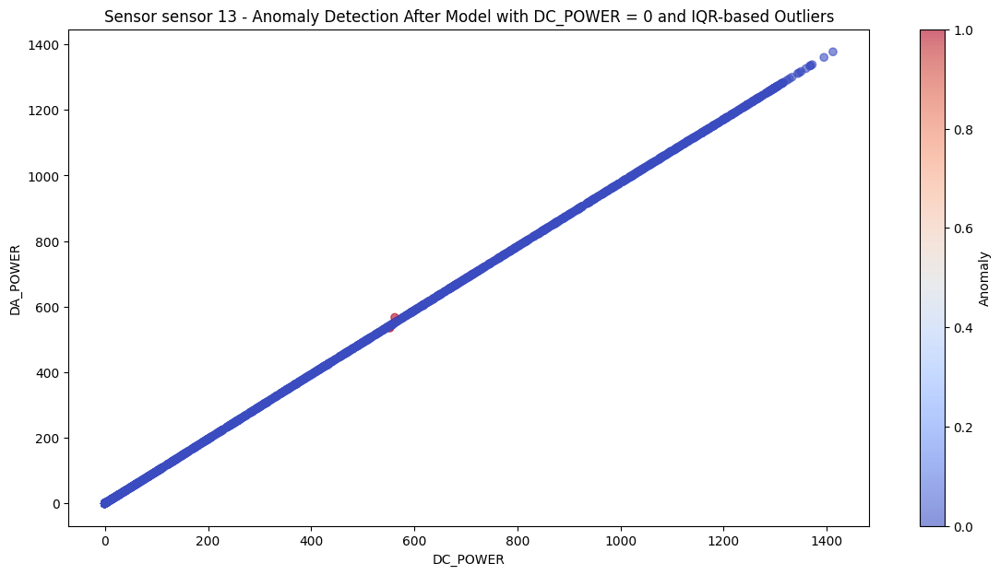

Sensor sensor 13 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
106035  552.640000  534.633333  -5.612547
128783  562.293333  566.971429  17.292104


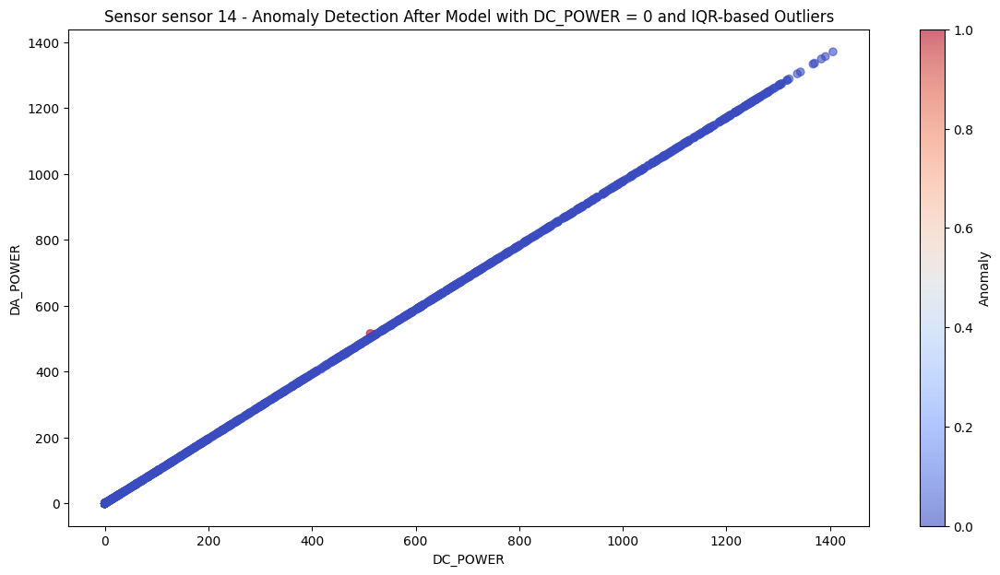

Sensor sensor 14 - Anomalies detected: 1
          DC_POWER    AC_POWER  Residuals
128784  512.513333  515.471429   14.33613


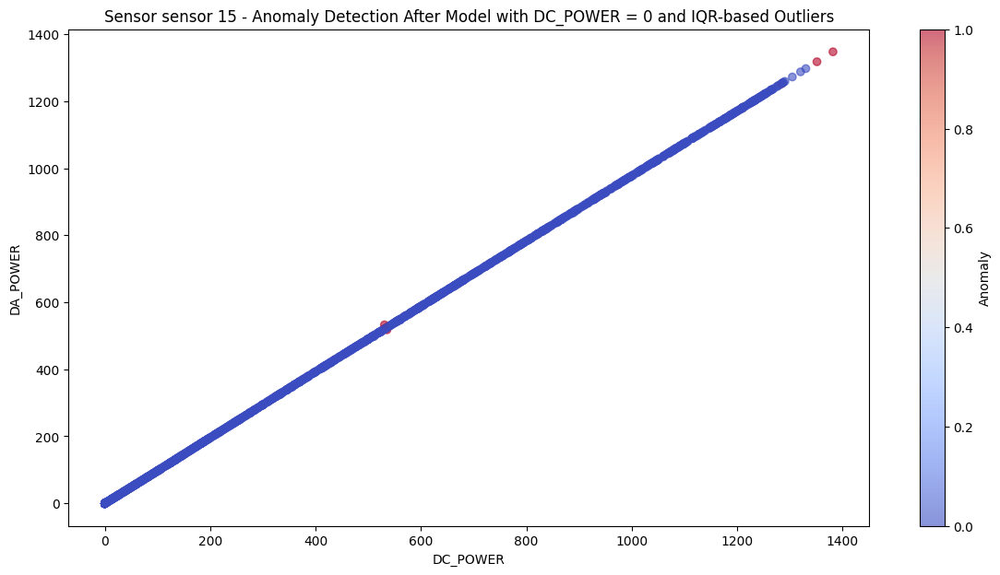

Sensor sensor 15 - Anomalies detected: 5
           DC_POWER     AC_POWER  Residuals
83351   1284.486667  1252.380000  -3.752325
106037   535.200000   517.833333  -5.620894
110195  1351.646667  1317.853333  -3.950334
114331  1382.086667  1347.526667  -4.042273
128785   530.480000   532.728571  13.889721


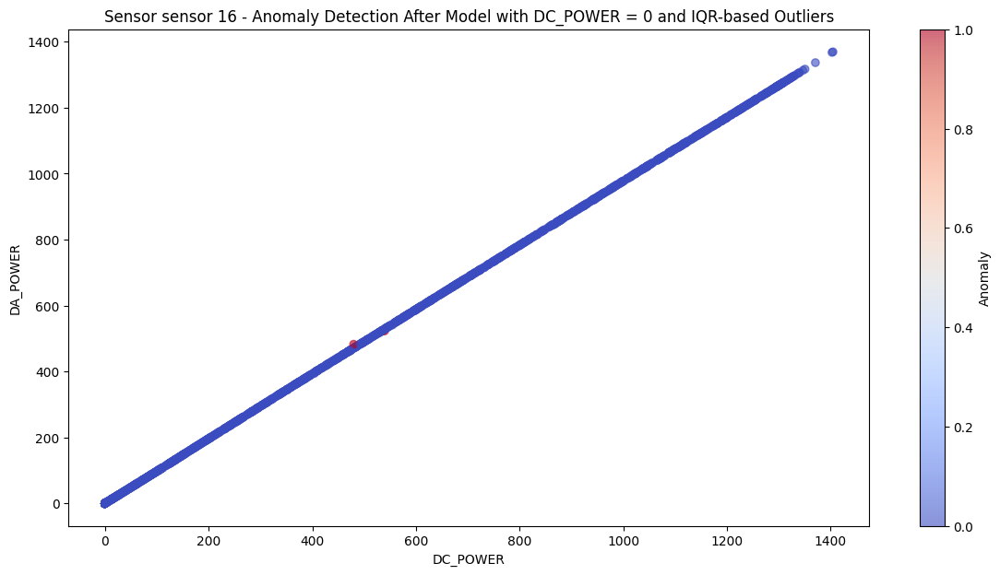

Sensor sensor 16 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
106038  539.340000  522.833333  -4.429569
128786  479.713333  482.428571  13.436501


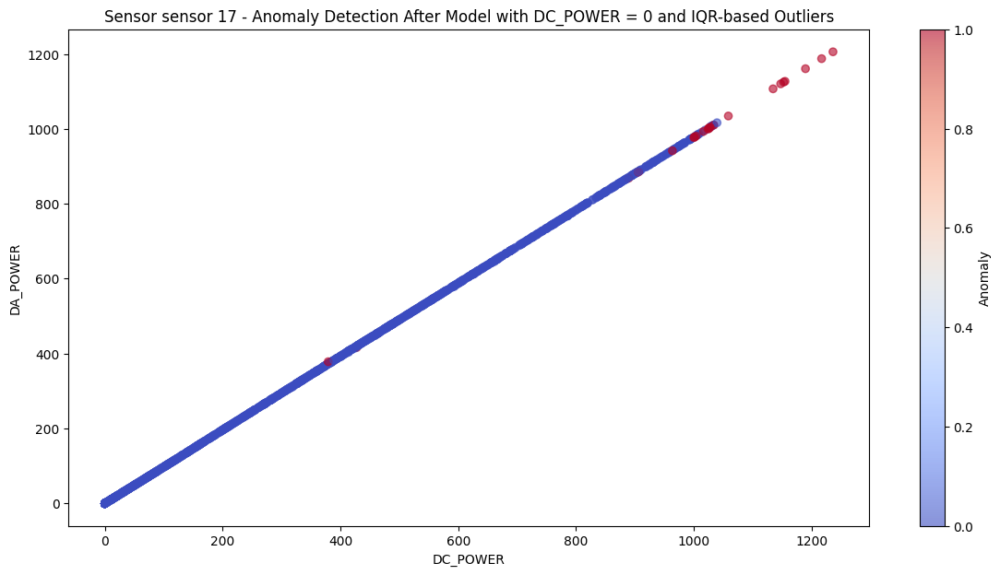

Sensor sensor 17 - Anomalies detected: 22
           DC_POWER     AC_POWER  Residuals
99637   1034.393333  1010.126667  -2.740140
101705   889.606667   868.326667  -2.766947
101727  1147.780000  1120.120000  -3.773534
103949  1026.293333  1002.660000  -2.275393
106039   427.500000   416.133333  -2.471533
106061  1028.107143  1004.428571  -2.282880
108019  1217.313333  1187.466667  -4.512989
108041  1152.780000  1124.760000  -4.029468
108085  1000.246667   976.800000  -2.630841
108107  1024.260000   999.813333  -3.131047
110087  1001.553333   977.853333  -2.856979
110109  1155.166667  1126.873333  -4.253127
110131  1189.906667  1160.600000  -4.543410
110153   906.106667   884.626667  -2.623529
112221  1236.633333  1205.706667  -5.190878
112243  1134.860000  1106.886667  -4.355774
112353  1025.720000  1000.426667  -3.947326
127005  1058.866667  1034.313333  -2.517438
127027  1004.006667   980.840000  -2.272584
127071   963.864286   941.492857  -2.312837
127203  1016.633333   993.086667  

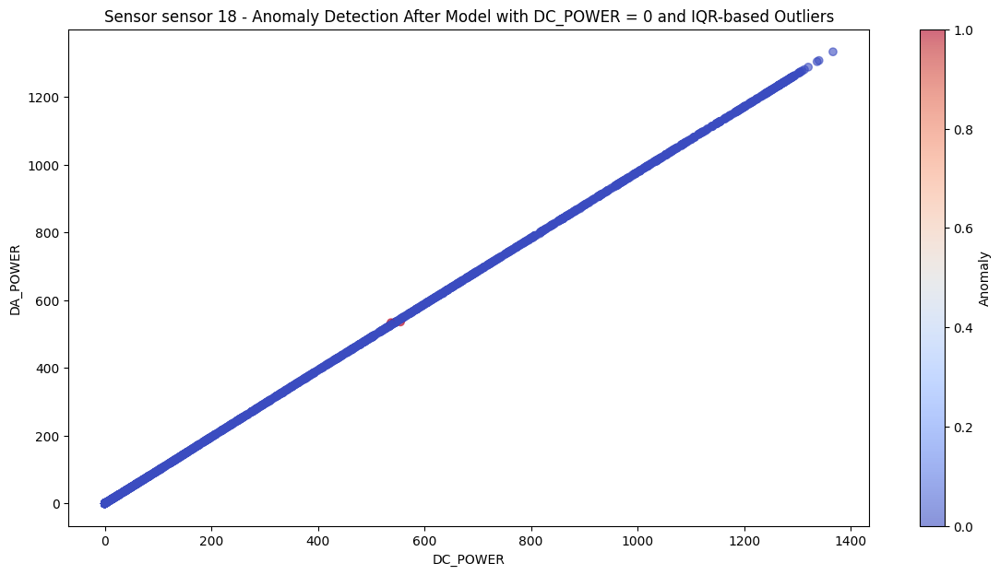

Sensor sensor 18 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
106040  554.800000  535.616667  -6.911478
128788  537.166667  533.421429   8.132080


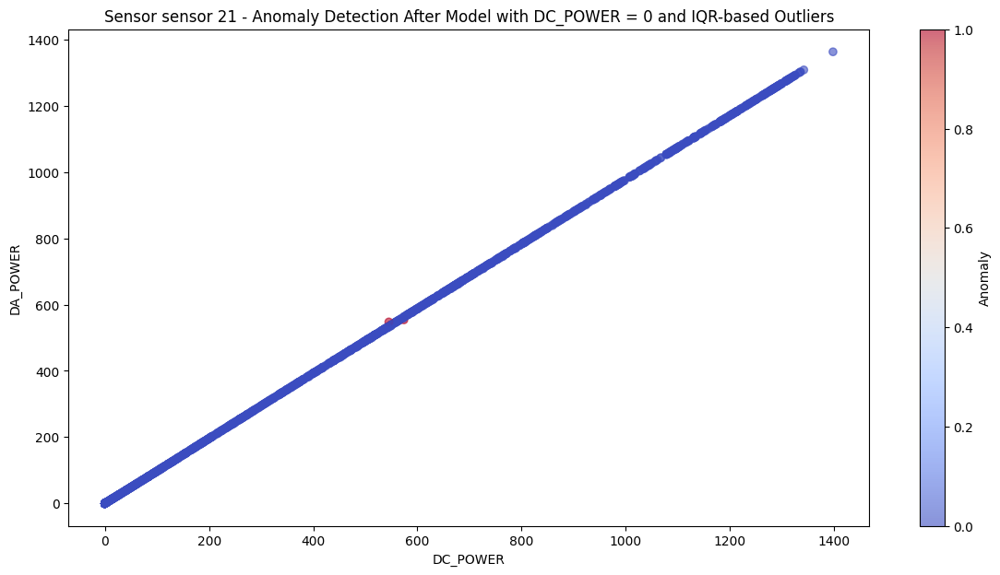

Sensor sensor 21 - Anomalies detected: 2
        DC_POWER    AC_POWER  Residuals
106041    574.16  554.033333  -7.396374
128789    545.24  547.750000  14.592757


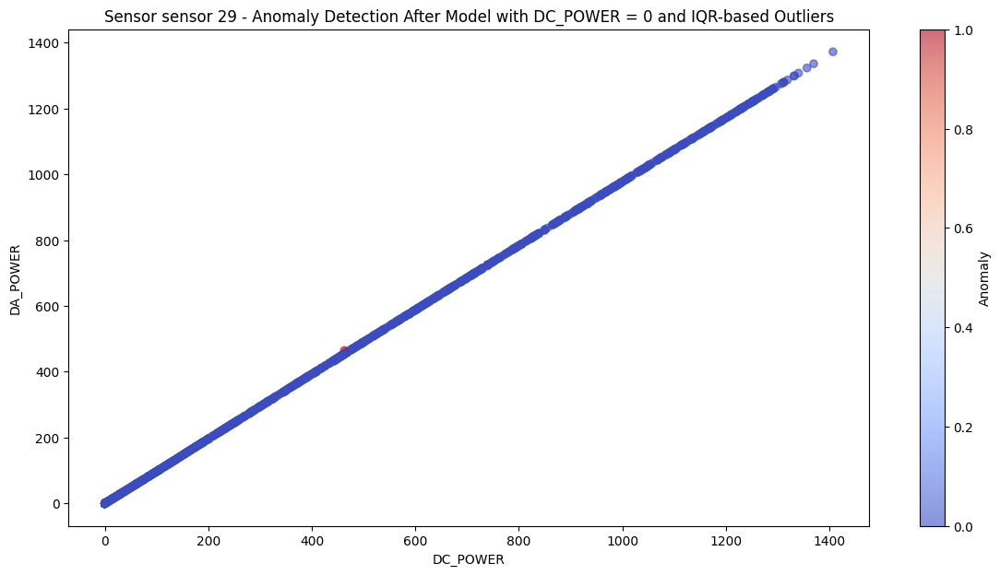

Sensor sensor 29 - Anomalies detected: 1
          DC_POWER    AC_POWER  Residuals
128790  462.746667  464.514286   12.02575


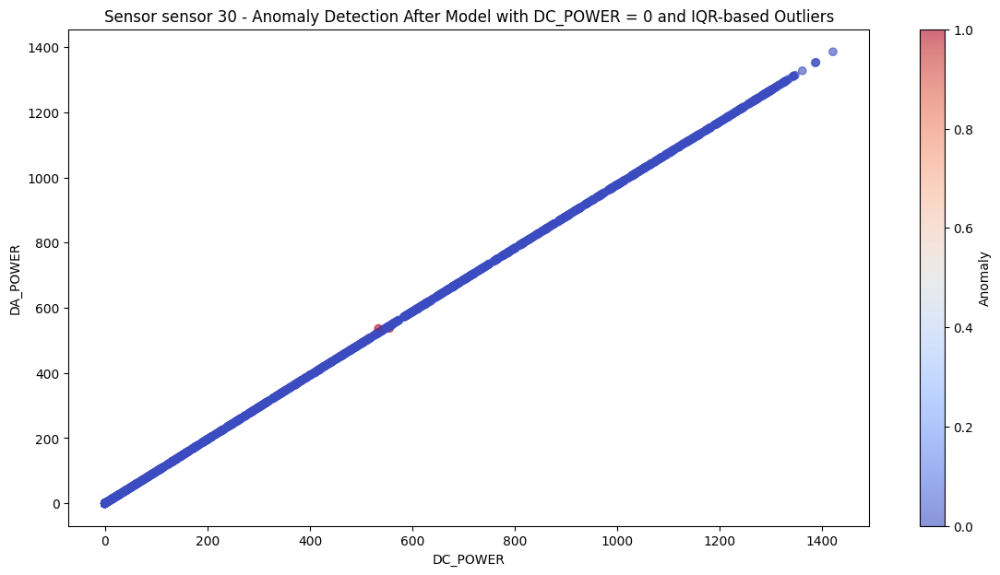

Sensor sensor 30 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
106043  555.100000  537.000000  -5.676830
128791  533.773333  536.321429  14.486994


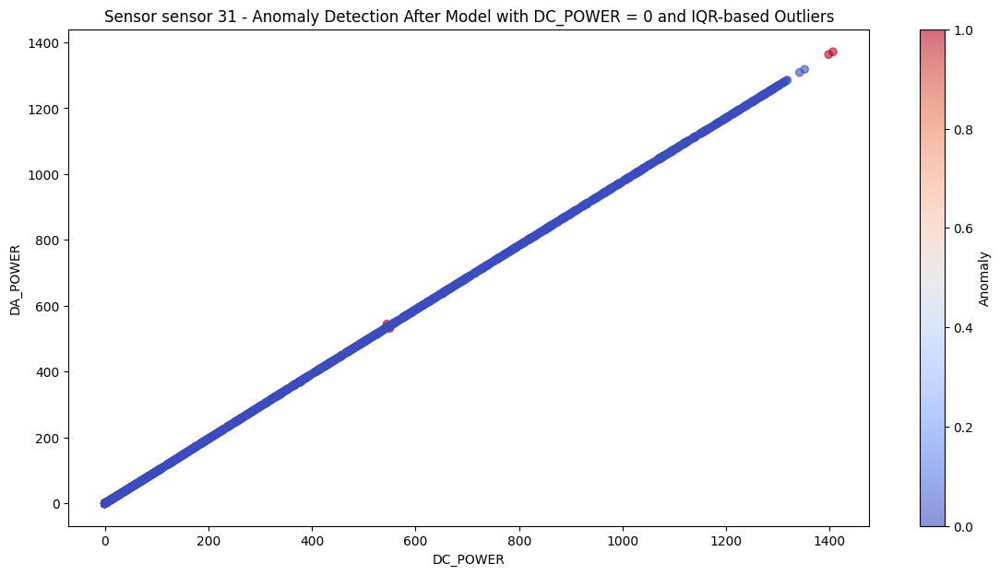

Sensor sensor 31 - Anomalies detected: 4
           DC_POWER     AC_POWER  Residuals
106044   550.140000   531.383333  -6.631112
110202  1397.993333  1363.046667  -3.938673
114338  1406.433333  1371.280000  -3.957373
128792   544.693333   544.521429  11.832348


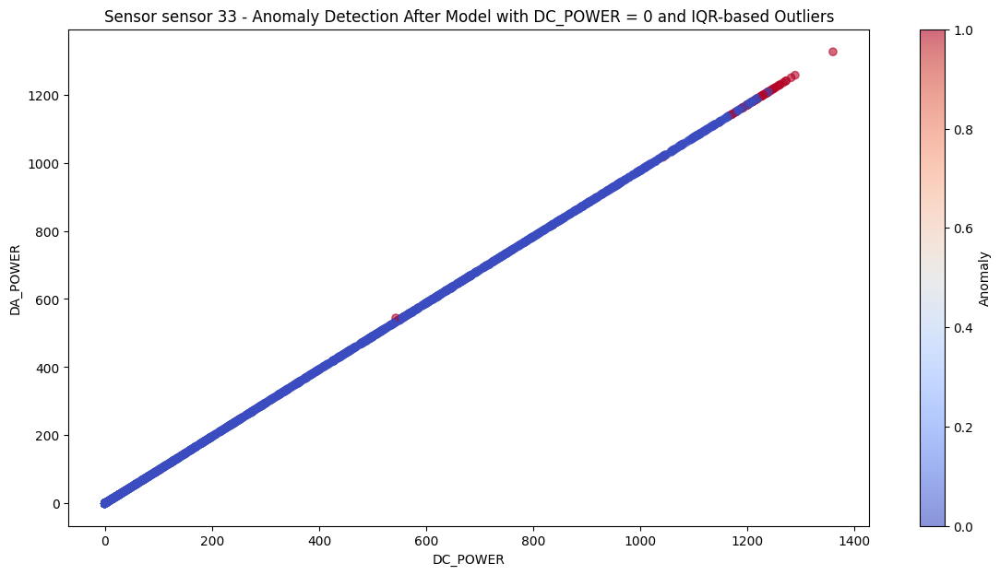

Sensor sensor 33 - Anomalies detected: 58
           DC_POWER     AC_POWER  Residuals
69719   1179.840000  1150.486667  -3.773213
69741   1200.453333  1170.633333  -3.791736
69763   1226.485714  1195.821429  -4.070064
69785   1208.000000  1178.160000  -3.647667
69807   1235.913333  1205.226667  -3.887484
69829   1233.286667  1202.453333  -4.091256
69851   1146.760000  1118.080000  -3.819056
69873   1266.571429  1234.878571  -4.227152
69895   1241.180000  1210.160000  -4.106317
69917   1253.773333  1222.620000  -3.965865
81720   1042.586667  1016.506667  -3.483837
83250   1212.966667  1182.633333  -4.033023
83268   1218.300000  1188.000000  -3.883740
83286   1198.653333  1169.066667  -3.597535
83304   1248.186667  1217.146667  -3.973989
83322   1238.142857  1207.585714  -3.709489
83340   1237.226667  1206.500000  -3.898932
83358   1239.413333  1208.766667  -3.771392
83376   1270.780000  1239.180000  -4.042798
83412   1235.842857  1204.392308  -4.652899
83430   1191.966667  1162.533333  

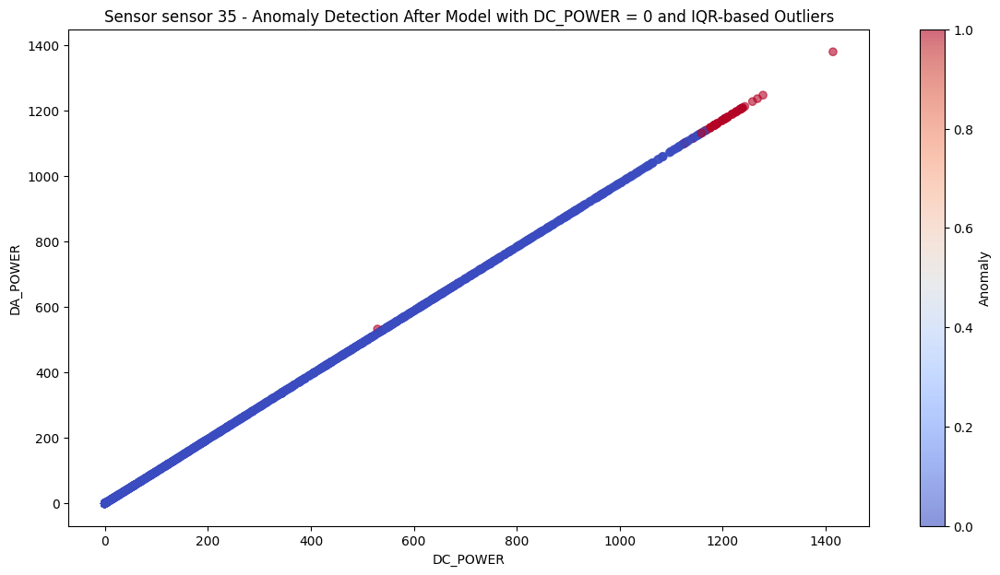

Sensor sensor 35 - Anomalies detected: 54
           DC_POWER     AC_POWER  Residuals
69984   1182.835714  1153.850000  -3.634276
71854   1159.921429  1131.507143  -3.554865
71876   1184.753333  1155.286667  -4.074053
71898   1238.146667  1207.193333  -4.414252
71920   1232.673333  1201.873333  -4.378443
78366   1189.726667  1160.880000  -3.347265
78388   1226.840000  1196.573333  -3.970364
79809   1189.566667  1159.833333  -4.237367
79821   1242.853333  1211.780000  -4.433190
79833   1223.742857  1193.135714  -4.377342
79845   1225.586667  1194.960000  -4.357275
79857   1209.913333  1179.653333  -4.327148
79869   1203.813333  1173.713333  -4.298128
83251   1174.780000  1145.413333  -4.188202
83269   1184.380000  1154.766667  -4.228736
83287   1206.513333  1176.366667  -4.286820
83305   1227.873333  1197.193333  -4.361509
83323   1233.850000  1202.985714  -4.417463
83341   1235.160000  1204.280000  -4.405049
83359   1235.520000  1204.640000  -4.397319
83377   1238.826667  1207.846667  

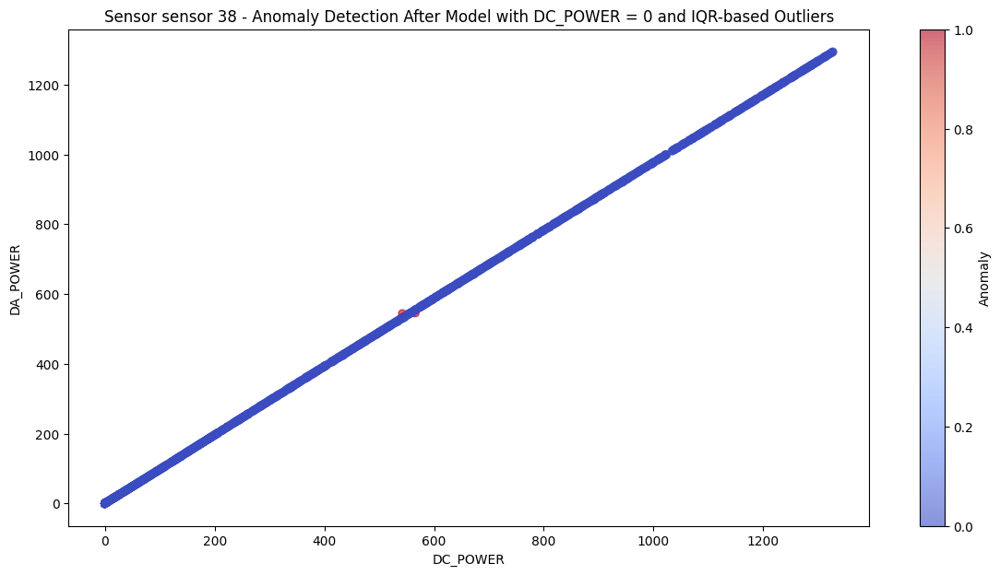

Sensor sensor 38 - Anomalies detected: 2
          DC_POWER    AC_POWER  Residuals
106047  565.720000  545.583333  -7.309888
128795  542.133333  544.071429  14.221683


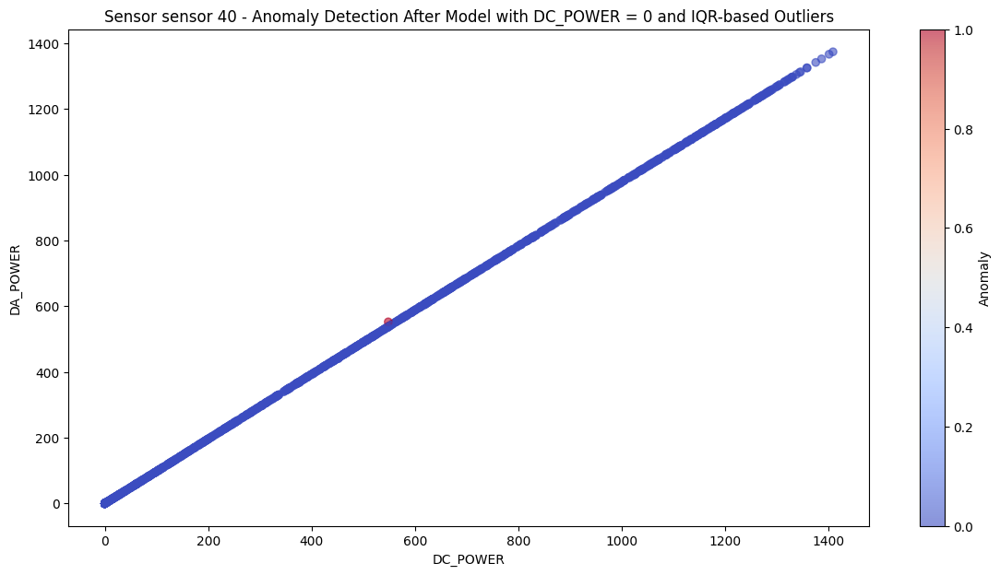

Sensor sensor 40 - Anomalies detected: 1
        DC_POWER    AC_POWER  Residuals
128796    548.18  552.057143  16.111953


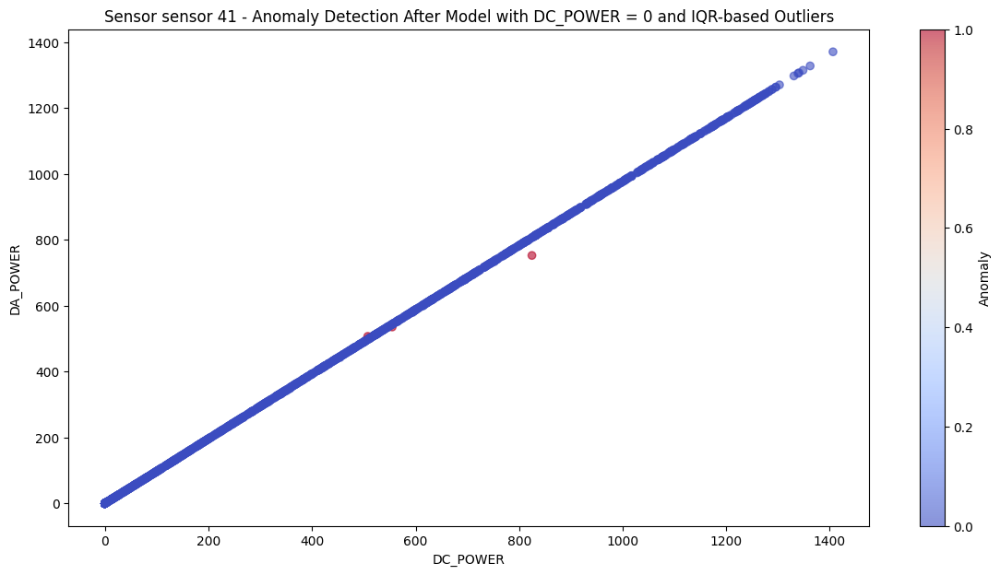

Sensor sensor 41 - Anomalies detected: 3
          DC_POWER    AC_POWER  Residuals
92181   824.585714  752.673333 -53.857726
106049  554.680000  535.416667  -7.151248
128797  507.540000  507.114286  10.648480
  LOCATION  DATE_TIME  SENSOR_ID  DC_POWER  AC_POWER  DAILY_YIELD  \
0        A 2020-05-15   sensor 1       0.0       0.0          0.0   
1        A 2020-05-15   sensor 2       0.0       0.0          0.0   
2        A 2020-05-15   sensor 3       0.0       0.0          0.0   
3        A 2020-05-15   sensor 5       0.0       0.0          0.0   
4        A 2020-05-15  sensor 12       0.0       0.0          0.0   

   TOTAL_YIELD  AMBIENT_TEMPERATURE  MODULE_TEMPERATURE  IRRADIATION  \
0    6259559.0            25.184316           22.857507          0.0   
1    6183645.0            25.184316           22.857507          0.0   
2    6987759.0            25.184316           22.857507          0.0   
3    7602960.0            25.184316           22.857507          0.0   
4    7158964.0  

In [ ]:
# Initialize the new columns with default values
merged_data['power_conv_anomaly'] = np.nan
merged_data['power_conv_anomaly_res'] = np.nan
merged_data['power_conv_anomaly_std_res'] = np.nan

for location in ['A', 'B']:
    Location_SENSORS = merged_data[merged_data['LOCATION'] == location]['SENSOR_ID'].unique()
    irridiation_vs_dc_pwer_model_dict[location] = {}

    for sensor in Location_SENSORS:
        x = merged_data[(merged_data['LOCATION'] == location) & (merged_data['SENSOR_ID'] == sensor)]
        # x.dropna(inplace=True)

        # Step 1: Train model with all data (including DC_POWER = 0)
        X_full = x[['DC_POWER']].values
        y_full = x['AC_POWER'].values

        # Perform grid search for optimal hyperparameters
        huber = HuberRegressor()
        grid_search = GridSearchCV(estimator=huber, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')
        grid_search.fit(X_full, y_full)
        best_params = grid_search.best_params_

        # Train the Huber regression model with the best parameters
        tuned_huber = HuberRegressor(epsilon=best_params['epsilon'],
                                    alpha=best_params['alpha'],
                                    max_iter=best_params['max_iter'])
        tuned_huber.fit(X_full, y_full)


        # Step 5: Predict and detect anomalies (using residuals)
        y_pred_full = tuned_huber.predict(X_full)
        residuals = y_full - y_pred_full
        std_residuals_full = np.std(residuals)
        threshold_full = 4 * std_residuals_full
        anomalies_full = np.abs(residuals) > threshold_full

        x['Residuals'] = residuals
        x['Anomaly'] = anomalies_full.astype(int)

        # Update the merged_data DataFrame
        indices = x.index
        merged_data.loc[indices, 'power_conv_anomaly'] = x['Anomaly']
        merged_data.loc[indices, 'power_conv_anomaly_res'] = x['Residuals']
        merged_data.loc[indices, 'power_conv_anomaly_std_res'] = std_residuals_full

        # Plotting: Comparison of anomalies detected
        plt.figure(figsize=(14, 7))
        plt.scatter(x['DC_POWER'], x['AC_POWER'], c=x['Anomaly'], cmap='coolwarm', label='Anomalies', alpha=0.6)
        plt.title(f'Sensor {sensor} - Anomaly Detection After Model with DC_POWER = 0 and IQR-based Outliers')
        plt.xlabel('DC_POWER')
        plt.ylabel('DA_POWER')
        plt.colorbar(label='Anomaly')
        plt.show()

        # Output anomalies detected
        print(f"Sensor {sensor} - Anomalies detected: {x['Anomaly'].sum()}")
        print(x[x['Anomaly'] == 1][['DC_POWER', 'AC_POWER', 'Residuals']])

        irridiation_vs_dc_pwer_model_dict[location][sensor] = {
            'intercept': tuned_huber.intercept_,
            'slope': tuned_huber.coef_,
            'std_residuals': std_residuals_full
        }

# Check updated merged_data
print(merged_data.head())


## Univariate Time Series for Weather Anomaly Detection

**If we consder the weather data only the irridation vs module temperature has a parallel region relationship. Other data does not have any strong correlations. Since the irradiation, ambient temperature and module temperature depend on the time. **

**We use univariate time series to predict the outliers in module temperature, ambient temperature and irradiation.**

**Since these time series are stationary, Exponential smoothning is used to model the time series.**
**We get the fitted values and get the difference between the actual values to calcuate the residuals.**
**Same as before, if the residual is greater than a specific multiple of the stanadard deviation, we mark that point as a outlier.**

### MODULE TEMPERATURE Model

#### Exponential Smoothning

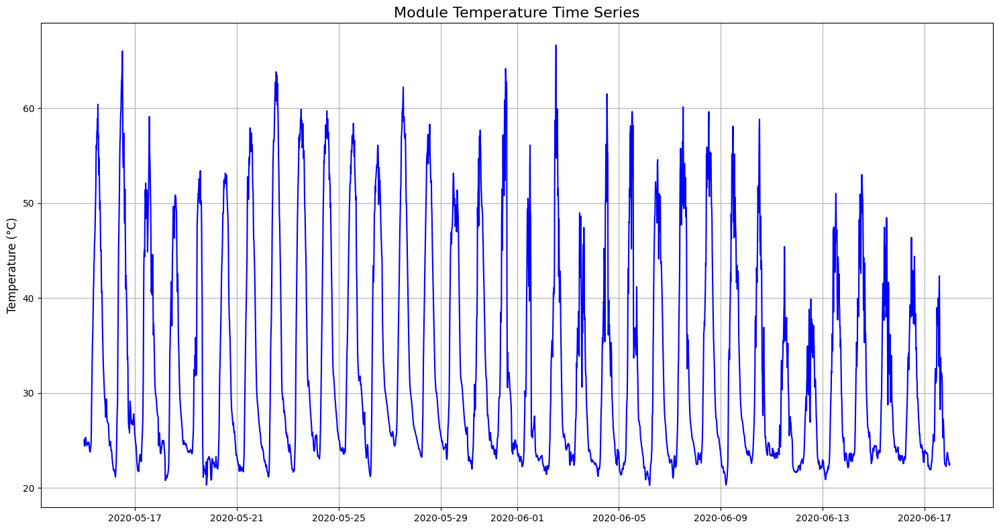

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

location = 'B'

# Set datetime as index (optional but useful for time series data)
x = weather_data[weather_data['LOCATION'] == location].set_index('DATE_TIME')

# Plot the time series
plt.figure(figsize=(15, 8))
plt.plot(x.index, x['MODULE_TEMPERATURE'], linestyle='-', color='b')
plt.title('Module Temperature Time Series', fontsize=16)
#plt.xlabel('Datetime', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
rows_with_nan = merged_data[merged_data[['IRRADIATION', 'MODULE_TEMPERATURE', 'AMBIENT_TEMPERATURE']].isna().any(axis=1)]
print("Rows with NaN values:")
print(rows_with_nan)

Rows with NaN values:
      LOCATION           DATE_TIME  SENSOR_ID  DC_POWER  AC_POWER  \
38544        A 2020-06-03 14:00:00   sensor 2    7003.0     685.8   
38545        A 2020-06-03 14:00:00  sensor 25    7204.0     705.4   
38546        A 2020-06-03 14:00:00  sensor 39    7545.0     738.7   
38547        A 2020-06-03 14:00:00  sensor 42    7946.0     777.8   

       DAILY_YIELD  TOTAL_YIELD  AMBIENT_TEMPERATURE  MODULE_TEMPERATURE  \
38544       5601.0    6330385.0                  NaN                 NaN   
38545       5685.0    6419961.0                  NaN                 NaN   
38546       5579.0    6928448.0                  NaN                 NaN   
38547       5541.0    7152815.0                  NaN                 NaN   

       IRRADIATION        DATE      TIME  
38544          NaN  2020-06-03  14:00:00  
38545          NaN  2020-06-03  14:00:00  
38546          NaN  2020-06-03  14:00:00  
38547          NaN  2020-06-03  14:00:00  


In [ ]:
# module_temp_data = weather_data[(weather_data['LOCATION'] == location) & (weather_data['DATE_TIME'] < pd.to_datetime('2020-06-03 14:00:00'))]
# module_temp_test_data = weather_data[(weather_data['LOCATION'] == location) & (weather_data['DATE_TIME'] > pd.to_datetime('2020-06-03 14:00:00'))]
# num_rows_to_predict = module_temp_test_data.shape[0]

# result = adfuller(module_temp_data['MODULE_TEMPERATURE'])

# print("ADF Statistic:", result[0])
# print("p-value:", result[1])
# print("Critical Values:", result[4])

# if result[1] <= 0.05:
#     print("Reject the null hypothesis: The time series is stationary.")
# else:
#     print("Fail to reject the null hypothesis: The time series is non-stationary.")


In [ ]:
module_temp_data = weather_data[(weather_data['LOCATION'] == location)]

result = adfuller(module_temp_data['MODULE_TEMPERATURE'])

print("ADF Statistic:", result[0])
print("p-value:", result[1])
print("Critical Values:", result[4])

if result[1] <= 0.05:
    print("Reject the null hypothesis: The time series is stationary.")
else:
    print("Fail to reject the null hypothesis: The time series is non-stationary.")


ADF Statistic: -13.429176414544216
p-value: 4.0454497713619387e-25
Critical Values: {'1%': -3.43236865676297, '5%': -2.8624319215895935, '10%': -2.567244789154987}
Reject the null hypothesis: The time series is stationary.


[0 0 0 ... 0 0 0]


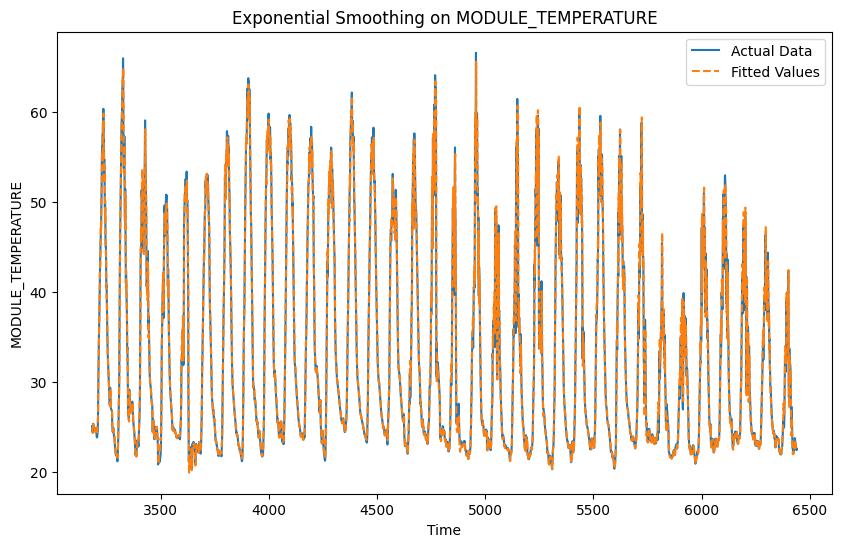

Mean Squared Error of Exponential Smoothing: 3.060996251898632
Mean Absolute Error of Exponential Smoothing: 0.9204739206138725
Detected Outliers:
3327   -5.504419
3606    7.754392
3607    5.689682
3627   -9.736001
4662    6.789395
          ...   
6295    6.035538
6392    5.313361
6400    8.048453
6403   -7.527454
6406    5.270167
Length: 85, dtype: float64


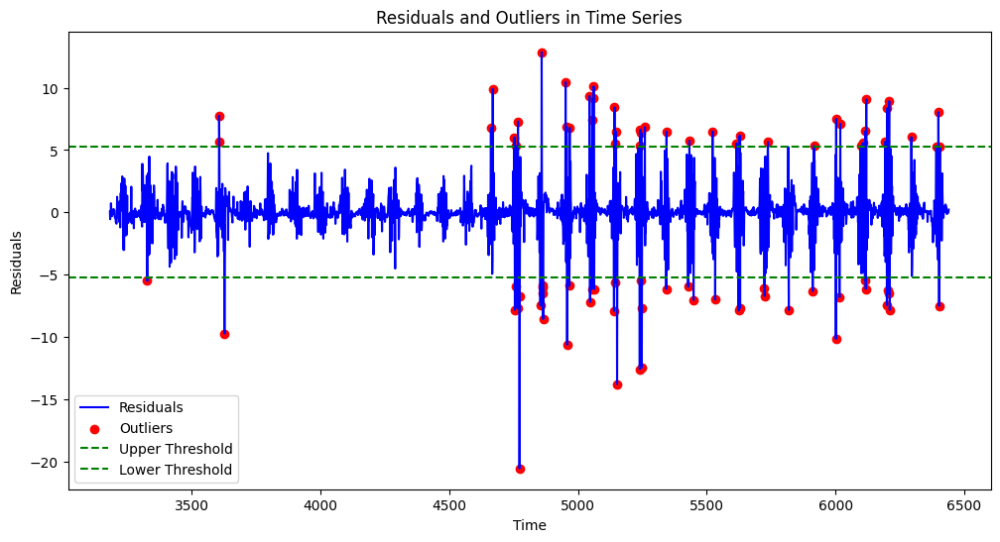

In [ ]:
ts = module_temp_data['MODULE_TEMPERATURE']

# Perform Exponential Smoothing
model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
fitted_model = model.fit()

# Calculate residuals
predicted_values = fitted_model.fittedvalues
actual_values = ts
residuals = actual_values - predicted_values

# Calculate standard deviation of residuals
std_dev_residuals = np.std(residuals)

# Outlier detection using 3 standard deviations
outlier_threshold = 3 * std_dev_residuals
outliers = residuals[np.abs(residuals) > outlier_threshold]
_outliers = np.where(np.abs(residuals) > outlier_threshold, 1, 0)
print(_outliers)

# Add new columns to weather_data
# weather_data['module_temp_anomaly'] = np.nan
# weather_data['module_temp_res'] = np.nan
# weather_data['module_temp_std_res'] = np.nan

# Store residuals, anomalies and std residuals in respective columns
# Find the indices where the time series for "MODULE_TEMPERATURE" exists
for idx in range(len(module_temp_data)):
    date_time = module_temp_data.iloc[idx]['DATE_TIME']

    if date_time in weather_data['DATE_TIME'].values:
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'module_temp_res'] = residuals.iloc[idx]
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'module_temp_std_res'] = std_dev_residuals
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'module_temp_anomaly'] = _outliers[idx]


# Plot the actual data and the forecast
plt.figure(figsize=(10, 6))
plt.plot(ts, label='Actual Data')
plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
#plt.plot(forecast, label='Forecast', linestyle=':', color='red')
plt.title("Exponential Smoothing on MODULE_TEMPERATURE")
plt.xlabel("Time")
plt.ylabel("MODULE_TEMPERATURE")
plt.legend()
plt.show()

# Calculate and print the error (Mean Squared Error as an example)
mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
mae = mean_absolute_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
print(f'Mean Squared Error of Exponential Smoothing: {mse}')
print(f'Mean Absolute Error of Exponential Smoothing: {mae}')

# # Validation
# remaining_values = module_temp_test_data['MODULE_TEMPERATURE'][:100]
# forecast_values = forecast[:100]
# mse_remaining = mean_squared_error(remaining_values, forecast_values)
# mae_remaining = mean_absolute_error(remaining_values, forecast_values)

# print(f'Mean Squared Error on Validation Values: {mse_remaining}')
# print(f'Mean Absolute Error on Validation Values: {mae_remaining}')

# Print outliers
print("Detected Outliers:")
print(outliers)

plt.figure(figsize=(12, 6))
plt.plot(residuals, label='Residuals', color='blue')
plt.scatter(outliers.index, outliers, color='red', label='Outliers')
plt.axhline(y=outlier_threshold, color='green', linestyle='--', label='Upper Threshold')
plt.axhline(y=-outlier_threshold, color='green', linestyle='--', label='Lower Threshold')
plt.title("Residuals and Outliers in Time Series")
plt.xlabel("Time")
plt.ylabel("Residuals")
plt.legend()
plt.show()

In [ ]:
# ts = module_temp_data['MODULE_TEMPERATURE']
# ts1 = module_temp_test_data['MODULE_TEMPERATURE'][:num_rows_to_predict - 100]

# # Perform Exponential Smoothing
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# # Forecast the next value
# forecast = fitted_model.forecast(steps=1)

# # Combine the forecast with the training data
# ts = pd.concat([ts, forecast], ignore_index=True)
# ts = pd.concat([ts, ts1], ignore_index=True)
# ts = ts.reset_index(drop=True)

# # Refit the model with the combined time series
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# # Forecast the next 1000 steps
# forecast = fitted_model.forecast(steps=1000)

# # Calculate residuals
# predicted_values = fitted_model.fittedvalues
# actual_values = ts[:len(predicted_values)]
# residuals = actual_values - predicted_values

# # Calculate standard deviation of residuals
# std_dev_residuals = np.std(residuals)

# # Outlier detection using 3 standard deviations
# outlier_threshold = 3 * std_dev_residuals
# outliers = residuals[np.abs(residuals) > outlier_threshold]
# _outliers = np.where(np.abs(residuals) > outlier_threshold, 1, 0)
# print(_outliers)

# # Add new columns to weather_data
# # weather_data['module_temp_anomaly'] = np.nan
# # weather_data['module_temp_res'] = np.nan
# # weather_data['module_temp_std_res'] = np.nan

# # Store residuals, anomalies and std residuals in respective columns
# # Find the indices where the time series for "MODULE_TEMPERATURE" exists
# for idx in range(len(module_temp_data)):
#     date_time = module_temp_data.iloc[idx]['DATE_TIME']

#     if date_time in weather_data['DATE_TIME'].values:
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'module_temp_res'] = residuals.iloc[idx]
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'module_temp_std_res'] = std_dev_residuals
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'module_temp_anomaly'] = _outliers[idx]


# # Plot the actual data and the forecast
# plt.figure(figsize=(10, 6))
# plt.plot(ts, label='Actual Data')
# plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
# plt.plot(forecast, label='Forecast', linestyle=':', color='red')
# plt.title("Exponential Smoothing on MODULE_TEMPERATURE")
# plt.xlabel("Time")
# plt.ylabel("MODULE_TEMPERATURE")
# plt.legend()
# plt.show()

# # Calculate and print the error (Mean Squared Error as an example)
# mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# mae = mean_absolute_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# print(f'Mean Squared Error of Exponential Smoothing: {mse}')
# print(f'Mean Absolute Error of Exponential Smoothing: {mae}')

# # Validation
# remaining_values = module_temp_test_data['MODULE_TEMPERATURE'][:100]
# forecast_values = forecast[:100]
# mse_remaining = mean_squared_error(remaining_values, forecast_values)
# mae_remaining = mean_absolute_error(remaining_values, forecast_values)

# print(f'Mean Squared Error on Validation Values: {mse_remaining}')
# print(f'Mean Absolute Error on Validation Values: {mae_remaining}')

# # Print outliers
# print("Detected Outliers:")
# print(outliers)

# plt.figure(figsize=(12, 6))
# plt.plot(residuals, label='Residuals', color='blue')
# plt.scatter(outliers.index, outliers, color='red', label='Outliers')
# plt.axhline(y=outlier_threshold, color='green', linestyle='--', label='Upper Threshold')
# plt.axhline(y=-outlier_threshold, color='green', linestyle='--', label='Lower Threshold')
# plt.title("Residuals and Outliers in Time Series")
# plt.xlabel("Time")
# plt.ylabel("Residuals")
# plt.legend()
# plt.show()

In [ ]:
residuals

,0
3182,0.050671
3183,-0.551913
3184,0.118366
3185,0.133189
3186,0.731517
...,...
6436,-0.004732
6437,0.075102
6438,-0.040407
6439,-0.016683


In [ ]:
weather_data.isna().sum()

,0
LOCATION,0
DATE_TIME,0
AMBIENT_TEMPERATURE,0
MODULE_TEMPERATURE,0
IRRADIATION,0
module_temp_anomaly,0
module_temp_res,0
module_temp_std_res,0


#### MODULE TEMPERATURE Model - Seasonal Decomposition & SARIMA

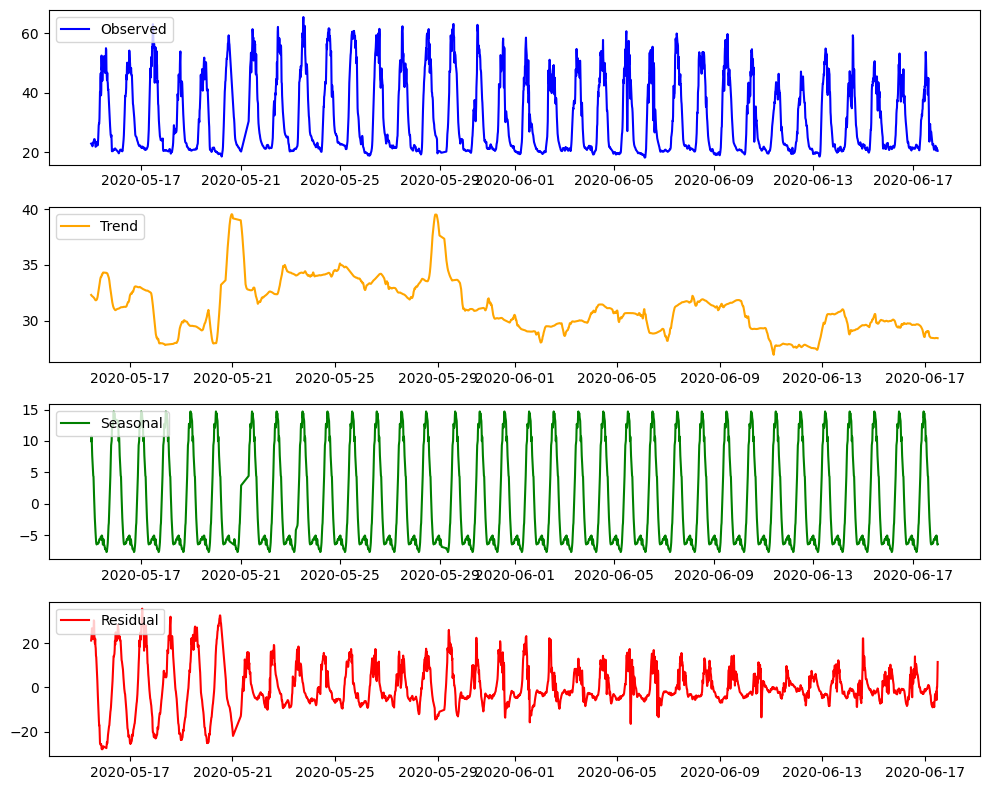

Trend Component:
DATE_TIME
2020-05-15 00:00:00   NaN
2020-05-15 00:15:00   NaN
2020-05-15 00:30:00   NaN
2020-05-15 00:45:00   NaN
2020-05-15 01:00:00   NaN
                       ..
2020-06-17 22:45:00   NaN
2020-06-17 23:00:00   NaN
2020-06-17 23:15:00   NaN
2020-06-17 23:30:00   NaN
2020-06-17 23:45:00   NaN
Name: trend, Length: 3182, dtype: float64

Seasonal Component:
DATE_TIME
2020-05-15 00:00:00     9.960399
2020-05-15 00:15:00    10.706787
2020-05-15 00:30:00    10.465328
2020-05-15 00:45:00     8.877891
2020-05-15 01:00:00     7.674986
                         ...    
2020-06-17 22:45:00    -5.107851
2020-06-17 23:00:00    -5.386620
2020-06-17 23:15:00    -5.968233
2020-06-17 23:30:00    -6.507807
2020-06-17 23:45:00    -6.450421
Name: seasonal, Length: 3182, dtype: float64

Residual Component:
DATE_TIME
2020-05-15 00:00:00   NaN
2020-05-15 00:15:00   NaN
2020-05-15 00:30:00   NaN
2020-05-15 00:45:00   NaN
2020-05-15 01:00:00   NaN
                       ..
2020-06-17 22:45:00

In [ ]:
import pandas as pd
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt

# Filter the data
mo = weather_data[weather_data['LOCATION'] == 'A']

# Ensure the DATE_TIME column is in datetime format and set as the index
mo['DATE_TIME'] = pd.to_datetime(mo['DATE_TIME'])
mo.set_index('DATE_TIME', inplace=True)

# Set the time series for MODULE_TEMPERATURE
ts = mo['MODULE_TEMPERATURE']

# Handle missing values using interpolation
ts = ts.interpolate(method='time')

# Perform seasonal decomposition
result = seasonal_decompose(ts, model='additive', period=95)  # Adjust period as needed

# Plot the decomposed components
plt.figure(figsize=(10, 8))

plt.subplot(411)
plt.plot(result.observed, label='Observed', color='blue')
plt.legend(loc='upper left')

plt.subplot(412)
plt.plot(result.trend, label='Trend', color='orange')
plt.legend(loc='upper left')

plt.subplot(413)
plt.plot(result.seasonal, label='Seasonal', color='green')
plt.legend(loc='upper left')

plt.subplot(414)
plt.plot(result.resid, label='Residual', color='red')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

# Optional: Analyze the components
print("Trend Component:")
print(result.trend)
print("\nSeasonal Component:")
print(result.seasonal)
print("\nResidual Component:")
print(result.resid)

In [ ]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# Prepare the data (Example for MODULE_TEMPERATURE)
mo = weather_data[weather_data['LOCATION'] == 'A']
mo['DATE_TIME'] = pd.to_datetime(mo['DATE_TIME'])
mo.set_index('DATE_TIME', inplace=True)

mo = mo.asfreq('T')

# Interpolate missing values
ts = mo['MODULE_TEMPERATURE'].interpolate(method='time')

train_size = int(len(ts) * 0.8)
train_ts, test_ts = ts[:train_size], ts[train_size:]

print(train_ts.index.dtype)
print(test_ts.index.dtype)
print(train_ts.index)
print(test_ts.index)

# Define SARIMA model (replace with your parameters)
model = SARIMAX(train_ts,
                order=(1, 1, 1),  # Non-seasonal (p, d, q)
                seasonal_order=(1, 1, 1, 96))  # Seasonal (P, D, Q, S)

# Fit the model
fitted_model = model.fit(disp=False)
print(fitted_model.summary())

# In-sample predictions (train)
train_pred = fitted_model.predict(start=train_ts.index[0], end=train_ts.index[-1])

# Out-of-sample predictions (test)
test_pred = fitted_model.predict(start=test_ts.index[0], end=test_ts.index[-1])

# Compute RMSE for training and testing data
train_rmse = np.sqrt(mean_squared_error(train_ts, train_pred))
test_rmse = np.sqrt(mean_squared_error(test_ts, test_pred))
print(f"Train RMSE: {train_rmse}")
print(f"Test RMSE: {test_rmse}")

# Plot actual vs predicted values
plt.figure(figsize=(12, 6))
plt.plot(train_ts, label='Training Data', color='blue')
plt.plot(test_ts, label='Testing Data', color='green')
plt.plot(test_pred, label='Predicted Data', color='red', linestyle='--')
plt.legend()
plt.show()

datetime64[ns]
datetime64[ns]
DatetimeIndex(['2020-05-15 00:00:00', '2020-05-15 00:01:00',
               '2020-05-15 00:02:00', '2020-05-15 00:03:00',
               '2020-05-15 00:04:00', '2020-05-15 00:05:00',
               '2020-05-15 00:06:00', '2020-05-15 00:07:00',
               '2020-05-15 00:08:00', '2020-05-15 00:09:00',
               ...
               '2020-06-11 04:26:00', '2020-06-11 04:27:00',
               '2020-06-11 04:28:00', '2020-06-11 04:29:00',
               '2020-06-11 04:30:00', '2020-06-11 04:31:00',
               '2020-06-11 04:32:00', '2020-06-11 04:33:00',
               '2020-06-11 04:34:00', '2020-06-11 04:35:00'],
              dtype='datetime64[ns]', name='DATE_TIME', length=39156, freq='min')
DatetimeIndex(['2020-06-11 04:36:00', '2020-06-11 04:37:00',
               '2020-06-11 04:38:00', '2020-06-11 04:39:00',
               '2020-06-11 04:40:00', '2020-06-11 04:41:00',
               '2020-06-11 04:42:00', '2020-06-11 04:43:00',
              

### AMBIENT TEMPERATURE Model

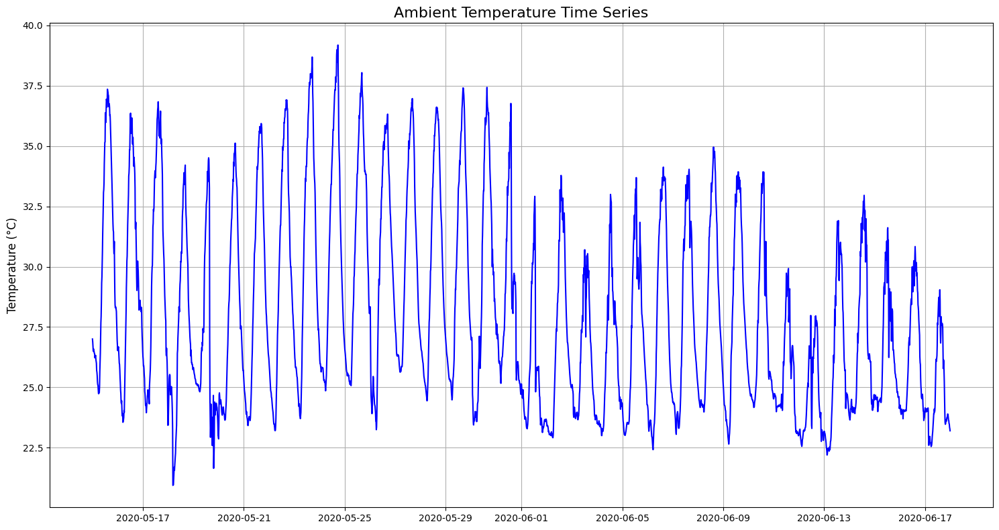

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

location = 'B'

# Set datetime as index (optional but useful for time series data)
x = merged_data[merged_data['LOCATION'] == location].set_index('DATE_TIME')

# Plot the time series
plt.figure(figsize=(15, 8))
plt.plot(x.index, x['AMBIENT_TEMPERATURE'], linestyle='-', color='b')
plt.title('Ambient Temperature Time Series', fontsize=16)
#plt.xlabel('Datetime', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
# ambient_temp_data = weather_data[(weather_data['LOCATION'] == location) & (weather_data['DATE_TIME'] < pd.to_datetime('2020-06-03 14:00:00'))]
# ambient_temp_test_data = weather_data[(weather_data['LOCATION'] == location) & (weather_data['DATE_TIME'] > pd.to_datetime('2020-06-03 14:00:00'))]
# num_rows_to_predict = module_temp_test_data.shape[0]

# result = adfuller(ambient_temp_data['AMBIENT_TEMPERATURE'])

# # Print results
# print("ADF Statistic:", result[0])
# print("p-value:", result[1])
# print("Critical Values:", result[4])

# if result[1] <= 0.05:
#     print("Reject the null hypothesis: The time series is stationary.")
# else:
#     print("Fail to reject the null hypothesis: The time series is non-stationary.")

In [ ]:
ambient_temp_data = weather_data[(weather_data['LOCATION'] == location)]

result = adfuller(ambient_temp_data['AMBIENT_TEMPERATURE'])

# Print results
print("ADF Statistic:", result[0])
print("p-value:", result[1])
print("Critical Values:", result[4])

if result[1] <= 0.05:
    print("Reject the null hypothesis: The time series is stationary.")
else:
    print("Fail to reject the null hypothesis: The time series is non-stationary.")

ADF Statistic: -12.47408851146313
p-value: 3.1968819534970174e-23
Critical Values: {'1%': -3.4323699038367206, '5%': -2.8624324724087438, '10%': -2.5672450823997868}
Reject the null hypothesis: The time series is stationary.


[0 0 0 ... 0 0 0]


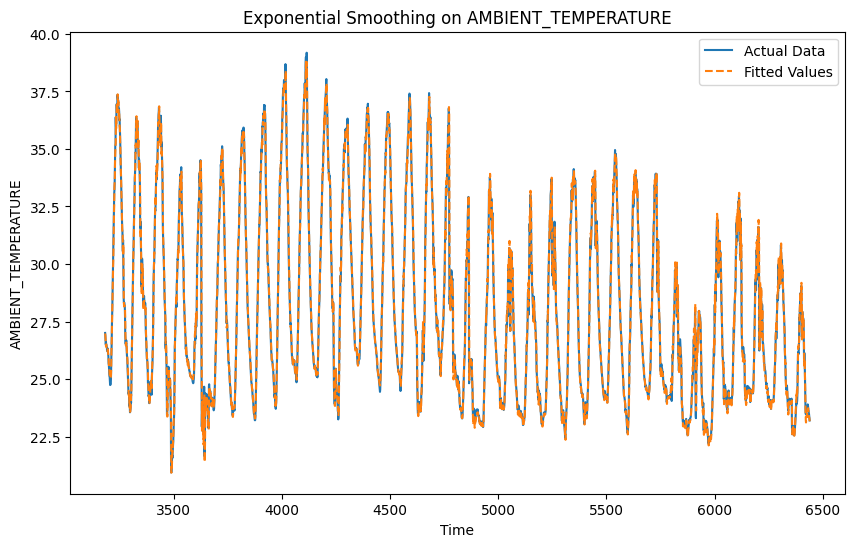

Mean Squared Error of Exponential Smoothing: 0.14911080930884005
Mean Absolute Error of Exponential Smoothing: 0.2265835063690445
Detected Outliers:
3344   -1.410437
3487   -2.243087
3627   -6.073349
3628   -2.446680
3629   -1.428556
3638    1.322040
3640    1.508682
3641   -2.699986
3644    1.416493
3662    1.255816
4117   -1.208008
4238   -1.306760
4239   -1.411592
4625   -1.266900
4773   -4.932629
4774   -2.408663
4780    1.372676
4791   -2.489972
4864   -2.571752
4865   -4.903078
5054   -2.020763
5056    1.500608
5058    1.565826
5140   -1.194331
5152   -1.753582
5248   -1.884717
5249   -1.365745
5260    1.752637
5449   -1.529376
5733   -1.890714
5735   -1.615117
5738    1.536454
5741   -1.418253
5826   -2.351555
5831   -1.948523
5911   -1.711581
5912   -2.206846
5913   -1.396185
6016   -1.319626
6118   -1.444930
6120    1.309558
6125   -1.882092
6200   -1.893164
6202    1.299849
6206   -2.261339
6207   -2.714544
6209    1.402561
6211   -1.181465
6215    1.224478
6403   -1.407101
d

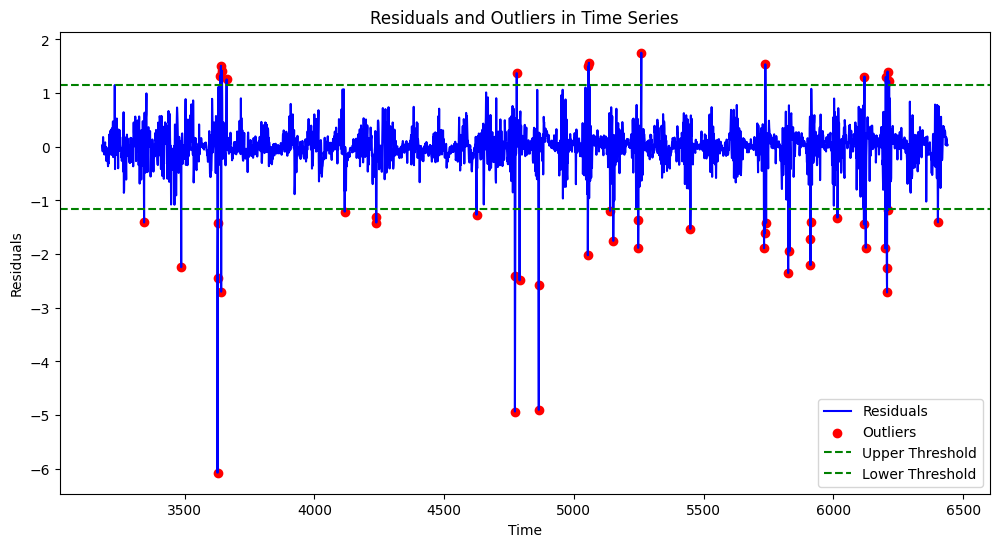

In [ ]:
ts = ambient_temp_data['AMBIENT_TEMPERATURE']

# Perform Exponential Smoothing
model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
fitted_model = model.fit()

# Calculate residuals
predicted_values = fitted_model.fittedvalues
actual_values = ts
residuals = actual_values - predicted_values

# Calculate standard deviation of residuals
std_dev_residuals = np.std(residuals)

# Outlier detection using 3 standard deviations
outlier_threshold = 3 * std_dev_residuals
outliers = residuals[np.abs(residuals) > outlier_threshold]
_outliers = np.where(np.abs(residuals) > outlier_threshold, 1, 0)
print(_outliers)

# Add new columns to weather_data
# weather_data['ambient_temp_anomaly'] = np.nan
# weather_data['ambient_temp_res'] = np.nan
# weather_data['ambient_temp_std_res'] = np.nan

# Store residuals, anomalies and std residuals in respective columns
# Find the indices where the time series for "MODULE_TEMPERATURE" exists
for idx in range(len(ambient_temp_data)):
    date_time = ambient_temp_data.iloc[idx]['DATE_TIME']

    if date_time in weather_data['DATE_TIME'].values:
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'ambient_temp_res'] = residuals.iloc[idx]
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'ambient_temp_std_res'] = std_dev_residuals
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'ambient_temp_anomaly'] = _outliers[idx]


# Plot the actual data and the forecast
plt.figure(figsize=(10, 6))
plt.plot(ts, label='Actual Data')
plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
#plt.plot(forecast, label='Forecast', linestyle=':', color='red')
plt.title("Exponential Smoothing on AMBIENT_TEMPERATURE")
plt.xlabel("Time")
plt.ylabel("AMBIENT_TEMPERATURE")
plt.legend()
plt.show()

# Calculate and print the error (Mean Squared Error as an example)
mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
mae = mean_absolute_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
print(f'Mean Squared Error of Exponential Smoothing: {mse}')
print(f'Mean Absolute Error of Exponential Smoothing: {mae}')

# # Validation
# remaining_values = module_temp_test_data['MODULE_TEMPERATURE'][:100]
# forecast_values = forecast[:100]
# mse_remaining = mean_squared_error(remaining_values, forecast_values)
# mae_remaining = mean_absolute_error(remaining_values, forecast_values)

# print(f'Mean Squared Error on Validation Values: {mse_remaining}')
# print(f'Mean Absolute Error on Validation Values: {mae_remaining}')

# Print outliers
print("Detected Outliers:")
print(outliers)

plt.figure(figsize=(12, 6))
plt.plot(residuals, label='Residuals', color='blue')
plt.scatter(outliers.index, outliers, color='red', label='Outliers')
plt.axhline(y=outlier_threshold, color='green', linestyle='--', label='Upper Threshold')
plt.axhline(y=-outlier_threshold, color='green', linestyle='--', label='Lower Threshold')
plt.title("Residuals and Outliers in Time Series")
plt.xlabel("Time")
plt.ylabel("Residuals")
plt.legend()
plt.show()

In [ ]:
# ts = module_temp_data['AMBIENT_TEMPERATURE']
# ts1 = module_temp_test_data['AMBIENT_TEMPERATURE'][:num_rows_to_predict - 100]

# # Perform Exponential Smoothing
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# # Forecast the next value
# forecast = fitted_model.forecast(steps=1)

# # Combine the forecast with the training data
# ts = pd.concat([ts, forecast], ignore_index=True)
# ts = pd.concat([ts, ts1], ignore_index=True)
# ts = ts.reset_index(drop=True)

# # Refit the model with the combined time series
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# # Forecast the next 1000 steps
# forecast = fitted_model.forecast(steps=1000)

# # Calculate residuals
# predicted_values = fitted_model.fittedvalues
# actual_values = ts[:len(predicted_values)]
# residuals = actual_values - predicted_values

# # Calculate standard deviation of residuals
# std_dev_residuals = np.std(residuals)

# # Outlier detection using 3 standard deviations
# outlier_threshold = 3 * std_dev_residuals
# outliers = residuals[np.abs(residuals) > outlier_threshold]
# _outliers = np.where(np.abs(residuals) > outlier_threshold, 1, 0)
# print(_outliers)

# # Add new columns to weather_data
# weather_data['ambient_temp_anomaly'] = np.nan
# weather_data['ambient_temp_res'] = np.nan
# weather_data['ambient_temp_std_res'] = np.nan

# # Store residuals, anomalies and std residuals in respective columns
# # Find the indices where the time series for "MODULE_TEMPERATURE" exists
# for idx in range(len(module_temp_data)):
#     date_time = module_temp_data.iloc[idx]['DATE_TIME']

#     if date_time in weather_data['DATE_TIME'].values:
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'ambient_temp_res'] = residuals.iloc[idx]
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'ambient_temp_std_res'] = std_dev_residuals
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'ambient_temp_anomaly'] = _outliers[idx]


# # Plot the actual data and the forecast
# plt.figure(figsize=(10, 6))
# plt.plot(ts, label='Actual Data')
# plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
# plt.plot(forecast, label='Forecast', linestyle=':', color='red')
# plt.title("Exponential Smoothing on AMBIENT_TEMPERATURE")
# plt.xlabel("Time")
# plt.ylabel("AMBIENT_TEMPERATURE")
# plt.legend()
# plt.show()

# # Calculate and print the error (Mean Squared Error as an example)
# mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# mae = mean_absolute_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# print(f'Mean Squared Error of Exponential Smoothing: {mse}')
# print(f'Mean Absolute Error of Exponential Smoothing: {mae}')

# # Validation
# remaining_values = module_temp_test_data['AMBIENT_TEMPERATURE'][:100]
# forecast_values = forecast[:100]
# mse_remaining = mean_squared_error(remaining_values, forecast_values)
# mae_remaining = mean_absolute_error(remaining_values, forecast_values)

# print(f'Mean Squared Error on Validation Values: {mse_remaining}')
# print(f'Mean Absolute Error on Validation Values: {mae_remaining}')

# # Print outliers
# print("Detected Outliers:")
# print(outliers)

# plt.figure(figsize=(12, 6))
# plt.plot(residuals, label='Residuals', color='blue')
# plt.scatter(outliers.index, outliers, color='red', label='Outliers')
# plt.axhline(y=outlier_threshold, color='green', linestyle='--', label='Upper Threshold')
# plt.axhline(y=-outlier_threshold, color='green', linestyle='--', label='Lower Threshold')
# plt.title("Residuals and Outliers in Time Series")
# plt.xlabel("Time")
# plt.ylabel("Residuals")
# plt.legend()
# plt.show()

In [ ]:
weather_data.isna().sum()

,0
LOCATION,0
DATE_TIME,0
AMBIENT_TEMPERATURE,0
MODULE_TEMPERATURE,0
IRRADIATION,0
module_temp_anomaly,0
module_temp_res,0
module_temp_std_res,0
ambient_temp_anomaly,0
ambient_temp_res,0


### IRRADIATION Model

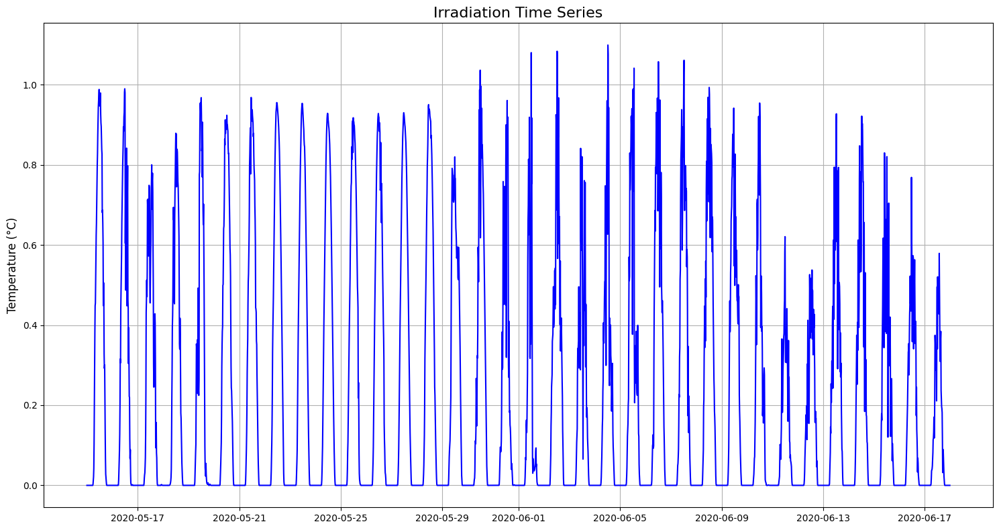

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

location = 'B'

# Set datetime as index (optional but useful for time series data)
x = merged_data[merged_data['LOCATION'] == location].set_index('DATE_TIME')

# Plot the time series
plt.figure(figsize=(15, 8))
plt.plot(x.index, x['IRRADIATION'], linestyle='-', color='b')
plt.title('Irradiation Time Series', fontsize=16)
#plt.xlabel('Datetime', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.grid(True)
#plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
irradiation_data = weather_data[(weather_data['LOCATION'] == location)]

result = adfuller(irradiation_data['IRRADIATION'])

# Print results
print("ADF Statistic:", result[0])
print("p-value:", result[1])
print("Critical Values:", result[4])

if result[1] <= 0.05:
    print("Reject the null hypothesis: The time series is stationary.")
else:
    print("Fail to reject the null hypothesis: The time series is non-stationary.")

ADF Statistic: -14.163040312087272
p-value: 2.0649962524180574e-26
Critical Values: {'1%': -3.432368033803368, '5%': -2.8624316464349073, '10%': -2.5672446426683}
Reject the null hypothesis: The time series is stationary.


In [ ]:
# ts = irradiation_data['IRRADIATION']
# ts1 = irradiation_test_data['IRRADIATION'][:num_rows_to_predict - 100]

# # Perform Exponential Smoothing
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# forecast = fitted_model.forecast(steps=1)

# ts = pd.concat([ts, forecast], ignore_index=True)
# ts = pd.concat([ts, ts1], ignore_index=True)
# ts = ts.reset_index(drop=True)

# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# forecast = fitted_model.forecast(steps=1000)

# # Plot the actual data and the forecast
# plt.figure(figsize=(10, 6))
# plt.plot(ts, label='Actual Data')
# plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
# plt.plot(forecast, label='Forecast', linestyle=':', color='red')
# plt.title("Exponential Smoothing on IRRADIATION")
# plt.xlabel("Time")
# plt.ylabel("IRRADIATION")
# plt.legend()
# plt.show()

# # Calculate and print the error (Mean Squared Error as an example)
# from sklearn.metrics import mean_squared_error
# mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# print(f'Mean Squared Error of Exponential Smoothing: {mse}')

In [ ]:
# ts = module_temp_data['IRRADIATION']
# ts1 = module_temp_test_data['IRRADIATION'][:num_rows_to_predict - 100]

# # Perform Exponential Smoothing
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# # Forecast the next value
# forecast = fitted_model.forecast(steps=1)

# # Combine the forecast with the training data
# ts = pd.concat([ts, forecast], ignore_index=True)
# ts = pd.concat([ts, ts1], ignore_index=True)
# ts = ts.reset_index(drop=True)

# # Refit the model with the combined time series
# model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
# fitted_model = model.fit()

# # Forecast the next 1000 steps
# forecast = fitted_model.forecast(steps=1000)

# # Calculate residuals
# predicted_values = fitted_model.fittedvalues
# actual_values = ts[:len(predicted_values)]
# residuals = actual_values - predicted_values

# # Calculate standard deviation of residuals
# std_dev_residuals = np.std(residuals)

# # Outlier detection using 3 standard deviations
# outlier_threshold = 3 * std_dev_residuals
# outliers = residuals[np.abs(residuals) > outlier_threshold]
# _outliers = np.where(np.abs(residuals) > outlier_threshold, 1, 0)
# print(_outliers)

# # Add new columns to weather_data
# weather_data['irradiation_anomaly'] = np.nan
# weather_data['irradiation_res'] = np.nan
# weather_data['irradiation_std_res'] = np.nan

# # Store residuals, anomalies and std residuals in respective columns
# # Find the indices where the time series for "MODULE_TEMPERATURE" exists
# for idx in range(len(module_temp_data)):
#     date_time = module_temp_data.iloc[idx]['DATE_TIME']

#     if date_time in weather_data['DATE_TIME'].values:
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'irradiation_res'] = residuals.iloc[idx]
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'irradiation_std_res'] = std_dev_residuals
#         weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'irradiation_anomaly'] = _outliers[idx]


# # Plot the actual data and the forecast
# plt.figure(figsize=(10, 6))
# plt.plot(ts, label='Actual Data')
# plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
# plt.plot(forecast, label='Forecast', linestyle=':', color='red')
# plt.title("Exponential Smoothing on IRRADIATION")
# plt.xlabel("Time")
# plt.ylabel("IRRADIATION")
# plt.legend()
# plt.show()

# # Calculate and print the error (Mean Squared Error as an example)
# mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# mae = mean_absolute_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
# print(f'Mean Squared Error of Exponential Smoothing: {mse}')
# print(f'Mean Absolute Error of Exponential Smoothing: {mae}')

# # Validation
# remaining_values = module_temp_test_data['IRRADIATION'][:100]
# forecast_values = forecast[:100]
# mse_remaining = mean_squared_error(remaining_values, forecast_values)
# mae_remaining = mean_absolute_error(remaining_values, forecast_values)

# print(f'Mean Squared Error on Validation Values: {mse_remaining}')
# print(f'Mean Absolute Error on Validation Values: {mae_remaining}')

# # Print outliers
# print("Detected Outliers:")
# print(outliers)

# plt.figure(figsize=(12, 6))
# plt.plot(residuals, label='Residuals', color='blue')
# plt.scatter(outliers.index, outliers, color='red', label='Outliers')
# plt.axhline(y=outlier_threshold, color='green', linestyle='--', label='Upper Threshold')
# plt.axhline(y=-outlier_threshold, color='green', linestyle='--', label='Lower Threshold')
# plt.title("Residuals and Outliers in Time Series")
# plt.xlabel("Time")
# plt.ylabel("Residuals")
# plt.legend()
# plt.show()

[0 0 0 ... 0 0 0]


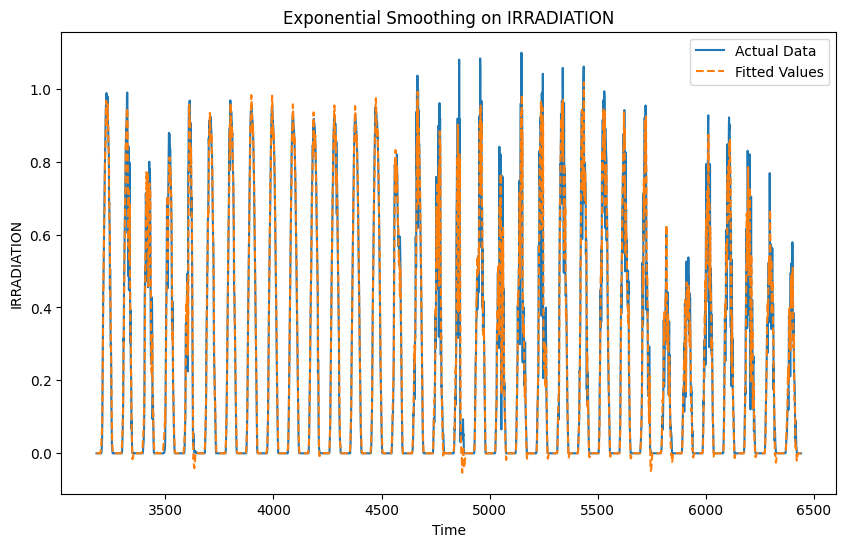

Mean Squared Error of Exponential Smoothing: 0.004781775537551331
Mean Absolute Error of Exponential Smoothing: 0.03230244954640806
Detected Outliers:
3326   -0.316284
3332   -0.273313
3336   -0.219281
3419   -0.227041
3438    0.212885
          ...   
6204   -0.219057
6206   -0.265181
6209    0.388726
6295    0.261137
6298   -0.246720
Length: 88, dtype: float64


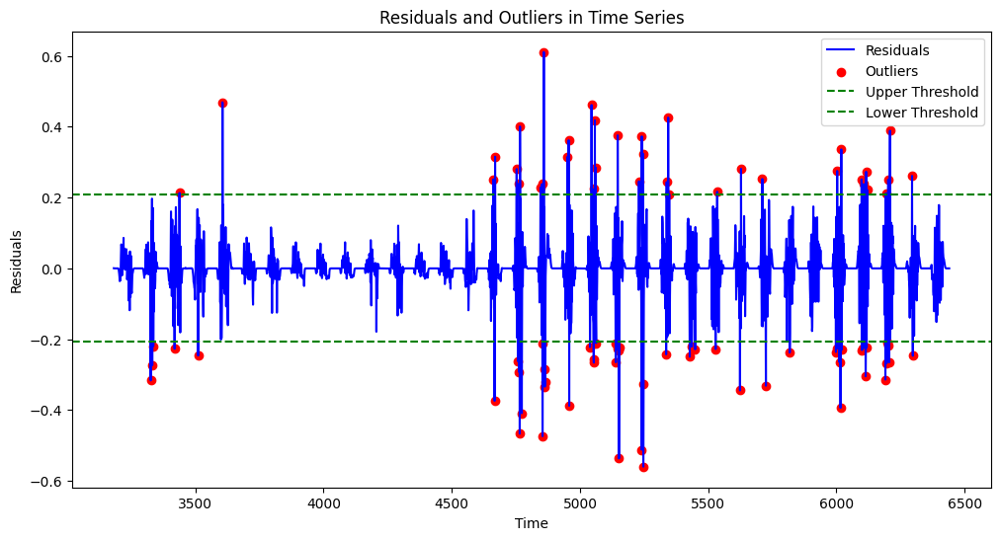

In [ ]:
ts = irradiation_data['IRRADIATION']

# Perform Exponential Smoothing
model = ExponentialSmoothing(ts, trend=None, seasonal='add', seasonal_periods=96, damped_trend=False)
fitted_model = model.fit()

# Calculate residuals
predicted_values = fitted_model.fittedvalues
actual_values = ts
residuals = actual_values - predicted_values

# Calculate standard deviation of residuals
std_dev_residuals = np.std(residuals)

# Outlier detection using 3 standard deviations
outlier_threshold = 3 * std_dev_residuals
outliers = residuals[np.abs(residuals) > outlier_threshold]
_outliers = np.where(np.abs(residuals) > outlier_threshold, 1, 0)
print(_outliers)

# Add new columns to weather_data
# weather_data['irradiation_anomaly'] = np.nan
# weather_data['irradiation_res'] = np.nan
# weather_data['irradiation_std_res'] = np.nan

# Store residuals, anomalies and std residuals in respective columns
# Find the indices where the time series for "MODULE_TEMPERATURE" exists
for idx in range(len(irradiation_data)):
    date_time = irradiation_data.iloc[idx]['DATE_TIME']

    if date_time in weather_data['DATE_TIME'].values:
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'irradiation_res'] = residuals.iloc[idx]
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'irradiation_std_res'] = std_dev_residuals
        weather_data.loc[(weather_data['DATE_TIME'] == date_time) & (weather_data['LOCATION'] == location), 'irradiation_anomaly'] = _outliers[idx]


# Plot the actual data and the forecast
plt.figure(figsize=(10, 6))
plt.plot(ts, label='Actual Data')
plt.plot(fitted_model.fittedvalues, label='Fitted Values', linestyle='--')
#plt.plot(forecast, label='Forecast', linestyle=':', color='red')
plt.title("Exponential Smoothing on IRRADIATION")
plt.xlabel("Time")
plt.ylabel("IRRADIATION")
plt.legend()
plt.show()

# Calculate and print the error (Mean Squared Error as an example)
mse = mean_squared_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
mae = mean_absolute_error(ts[-len(fitted_model.fittedvalues):], fitted_model.fittedvalues)
print(f'Mean Squared Error of Exponential Smoothing: {mse}')
print(f'Mean Absolute Error of Exponential Smoothing: {mae}')

# # Validation
# remaining_values = module_temp_test_data['MODULE_TEMPERATURE'][:100]
# forecast_values = forecast[:100]
# mse_remaining = mean_squared_error(remaining_values, forecast_values)
# mae_remaining = mean_absolute_error(remaining_values, forecast_values)

# print(f'Mean Squared Error on Validation Values: {mse_remaining}')
# print(f'Mean Absolute Error on Validation Values: {mae_remaining}')

# Print outliers
print("Detected Outliers:")
print(outliers)

plt.figure(figsize=(12, 6))
plt.plot(residuals, label='Residuals', color='blue')
plt.scatter(outliers.index, outliers, color='red', label='Outliers')
plt.axhline(y=outlier_threshold, color='green', linestyle='--', label='Upper Threshold')
plt.axhline(y=-outlier_threshold, color='green', linestyle='--', label='Lower Threshold')
plt.title("Residuals and Outliers in Time Series")
plt.xlabel("Time")
plt.ylabel("Residuals")
plt.legend()
plt.show()

In [ ]:
weather_data.isna().sum()

,0
LOCATION,0
DATE_TIME,0
AMBIENT_TEMPERATURE,0
MODULE_TEMPERATURE,0
IRRADIATION,0
module_temp_anomaly,0
module_temp_res,0
module_temp_std_res,0
ambient_temp_anomaly,0
ambient_temp_res,0


In [ ]:
weather_data.to_csv('weather_data.csv', index=False)

# Create Final Dataset with Anomalies

In [ ]:
sensor_data = pd.read_csv('merged_data.csv')
weather_data = pd.read_csv('weather_data.csv')

In [ ]:
merged_data = pd.merge(sensor_data, weather_data, how='left', on=['LOCATION', 'DATE_TIME'])
merged_data['DATE_TIME'] = pd.to_datetime(merged_data['DATE_TIME'])
merged_data['DATE'] = merged_data['DATE_TIME'].dt.strftime('%Y-%m-%d')
merged_data['TIME'] = merged_data['DATE_TIME'].dt.strftime('%H:%M:%S')

In [ ]:
merged_data.isna().sum()

,0
LOCATION,0
DATE_TIME,0
SENSOR_ID,0
DC_POWER,0
AC_POWER,0
DAILY_YIELD,0
TOTAL_YIELD,0
AMBIENT_TEMPERATURE_x,0
MODULE_TEMPERATURE_x,0
IRRADIATION_x,0


In [ ]:
merged_data

,LOCATION,DATE_TIME,SENSOR_ID,DC_POWER,AC_POWER,DAILY_YIELD,TOTAL_YIELD,AMBIENT_TEMPERATURE_x,MODULE_TEMPERATURE_x,IRRADIATION_x,...,IRRADIATION_y,module_temp_anomaly,module_temp_res,module_temp_std_res,ambient_temp_anomaly,ambient_temp_res,ambient_temp_std_res,irradiation_anomaly,irradiation_res,irradiation_std_res
0,A,2020-05-15 00:00:00,sensor 1,0.0,0.0,0.0,6259559.0,25.184316,22.857507,0.0,...,0.0,0.0,0.086541,2.320106,0.0,0.012393,0.381105,0.0,-0.001927,0.089604
1,A,2020-05-15 00:00:00,sensor 2,0.0,0.0,0.0,6183645.0,25.184316,22.857507,0.0,...,0.0,0.0,0.086541,2.320106,0.0,0.012393,0.381105,0.0,-0.001927,0.089604
2,A,2020-05-15 00:00:00,sensor 3,0.0,0.0,0.0,6987759.0,25.184316,22.857507,0.0,...,0.0,0.0,0.086541,2.320106,0.0,0.012393,0.381105,0.0,-0.001927,0.089604
3,A,2020-05-15 00:00:00,sensor 5,0.0,0.0,0.0,7602960.0,25.184316,22.857507,0.0,...,0.0,0.0,0.086541,2.320106,0.0,0.012393,0.381105,0.0,-0.001927,0.089604
4,A,2020-05-15 00:00:00,sensor 12,0.0,0.0,0.0,7158964.0,25.184316,22.857507,0.0,...,0.0,0.0,0.086541,2.320106,0.0,0.012393,0.381105,0.0,-0.001927,0.089604
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
136467,B,2020-06-17 23:45:00,sensor 33,0.0,0.0,4157.0,520758.0,23.202871,22.535908,0.0,...,0.0,0.0,0.223610,1.749570,0.0,0.035183,0.386146,0.0,0.000039,0.069150
136468,B,2020-06-17 23:45:00,sensor 35,0.0,0.0,3931.0,121131356.0,23.202871,22.535908,0.0,...,0.0,0.0,0.223610,1.749570,0.0,0.035183,0.386146,0.0,0.000039,0.069150
136469,B,2020-06-17 23:45:00,sensor 38,0.0,0.0,4322.0,2427691.0,23.202871,22.535908,0.0,...,0.0,0.0,0.223610,1.749570,0.0,0.035183,0.386146,0.0,0.000039,0.069150
136470,B,2020-06-17 23:45:00,sensor 40,0.0,0.0,4218.0,106896394.0,23.202871,22.535908,0.0,...,0.0,0.0,0.223610,1.749570,0.0,0.035183,0.386146,0.0,0.000039,0.069150


In [ ]:
merged_data.isna().sum()

,0
LOCATION,0
DATE_TIME,0
SENSOR_ID,0
DC_POWER,0
AC_POWER,0
DAILY_YIELD,0
TOTAL_YIELD,0
AMBIENT_TEMPERATURE_x,0
MODULE_TEMPERATURE_x,0
IRRADIATION_x,0


In [ ]:
merged_data.to_csv('final_merged_data.csv', index=False)